In [1]:
#Basic imports
import os
import uproot
import numpy as np
import awkward as ak
from tqdm import tqdm
import matplotlib.pyplot as plt

In [2]:
import pandas as pd

In [3]:
#Run through the ROOT files and return Info on the triggers
def create_dict(filelist):
    trigger_dict = {}
    for i, filename in enumerate(tqdm(filelist)):
        if i>9: break
        try:
            file = uproot.open(filename)
            for variable in file.keys():
                if 'L1_' not in variable: continue #Look for L1 triggers
                if '_L1_' in variable: continue    #Remove variables with L1 in the name but aren't triggers
                x = np.array(file[variable])
                x = np.multiply(x, 1)
                if i == 0:
                    trigger_dict[variable] = x
                else:
                    trigger_dict[variable] = np.append(trigger_dict[variable],x)
            file.close()
        except:
            print('File failed:{}'.format(filename))#Tell user which file is causing issues
    return trigger_dict

In [9]:
def create_dict_l1_hlt(filelist):
    trigger_dict = {}
    for i, filename in enumerate(tqdm(filelist)):
        if i>9: break
        try:
            file = uproot.open(filename)
            for variable in file.keys():
                if ('HLT_' not in variable) and (('L1_' not in variable) or ('_L1_' in variable)): continue #Look for L1 triggers
                x = np.array(file[variable])
                x = np.multiply(x, 1)
                if i == 0:
                    trigger_dict[variable] = x
                else:
                    trigger_dict[variable] = np.append(trigger_dict[variable],x)
            file.close()
        except:
            print('File failed:{}'.format(filename))#Tell user which file is causing issues
    return trigger_dict

In [6]:
decay = 'generic'
#decay='darkPhoHad'
#decay='darkPho'
#files_125 = os.popen('xrdfs root://xrootd.cmsaf.mit.edu ls /store/user/paus/nanosu/A01/SUEP-m125-{}+RunIIAutumn18-private+MINIAODSIM'.format(decay)).readlines()
#filelist_125 =  ['root://xrootd.cmsaf.mit.edu/{}:Events'.format(i.rstrip()) for i in files_125]
temp_list=['0.5','1','2','3','4']
dic_temp={}
for temp in temp_list:
    files=os.popen('xrdfs root://xrootd.cmsaf.mit.edu ls /store/user/paus/nanosu/A01/SUEP-m400-md2-t{0}-{1}+RunIIAutumn18-private+MINIAODSIM'.format(temp,decay)).readlines()
    dic_temp[temp]=['root://xrootd.cmsaf.mit.edu/{}:Events'.format(i.rstrip()) for i in files]


In [7]:
decay = 'generic'
m_md_t_list=['m400-md3-t1.5','m400-md3-t3','m400-md3-t6','m400-md5-t1','m400-md5-t5','m400-md5-t10']
dic_all={}
for m_md_t in m_md_t_list:
    files=os.popen('xrdfs root://xrootd.cmsaf.mit.edu ls /store/user/paus/nanosu/A01/SUEP-{0}-{1}+RunIIAutumn18-private+MINIAODSIM'.format(m_md_t,decay)).readlines()
    dic_all[m_md_t]=['root://xrootd.cmsaf.mit.edu/{}:Events'.format(i.rstrip()) for i in files]

In [8]:
decays=['generic','darkPho','darkPhoHad']
masses=['125','400','750','1000']
dic_decaymodes={}
for decay in decays:
    dic_decaymodes[decay]={}
    for mass in masses:
        files=os.popen('xrdfs root://xrootd.cmsaf.mit.edu ls /store/user/paus/nanosu/A01/SUEP-m{0}-{1}+RunIIAutumn18-private+MINIAODSIM'.format(mass,decay)).readlines()
        dic_decaymodes[decay][mass]=['root://xrootd.cmsaf.mit.edu/{}:Events'.format(i.rstrip()) for i in files]

In [3]:
os.system('xrdfs root://xrootd.cmsaf.mit.edu ls /store/user/paus/nanosu/A01/')

/store/user/paus/nanosu/A01//EGamma+Run2018A-UL2018_MiniAODv2-v1+MINIAOD
/store/user/paus/nanosu/A01//EGamma+Run2018B-UL2018_MiniAODv2-v1+MINIAOD
/store/user/paus/nanosu/A01//EGamma+Run2018C-UL2018_MiniAODv2-v1+MINIAOD
/store/user/paus/nanosu/A01//EGamma+Run2018D-UL2018_MiniAODv2-v2+MINIAOD
/store/user/paus/nanosu/A01//JetHT+Run2016B-ver1_HIPM_UL2016_MiniAODv2-v2+MINIAOD
/store/user/paus/nanosu/A01//JetHT+Run2016B-ver2_HIPM_UL2016_MiniAODv2-v2+MINIAOD
/store/user/paus/nanosu/A01//JetHT+Run2016C-HIPM_UL2016_MiniAODv2-v2+MINIAOD
/store/user/paus/nanosu/A01//JetHT+Run2016D-HIPM_UL2016_MiniAODv2-v2+MINIAOD
/store/user/paus/nanosu/A01//JetHT+Run2016E-HIPM_UL2016_MiniAODv2-v2+MINIAOD
/store/user/paus/nanosu/A01//JetHT+Run2016F-HIPM_UL2016_MiniAODv2-v2+MINIAOD
/store/user/paus/nanosu/A01//JetHT+Run2016F-UL2016_MiniAODv2-v2+MINIAOD
/store/user/paus/nanosu/A01//JetHT+Run2016G-UL2016_MiniAODv2-v2+MINIAOD
/store/user/paus/nanosu/A01//JetHT+Run2016H-UL2016_MiniAODv2-v2+MINIAOD
/store/user/paus/nan

0

In [10]:
#print('Processing m=125 GeV for the {} decay mode:'.format(decay))
#trigger_dict_125 = create_dict(filelist_125)
decay='generic'
dic_trigger={}
for temp in temp_list:
    print('Processing m=400 GeV for the {0} decay mode, {1} temperature:'.format(decay,temp))
    dic_trigger[temp]=create_dict_l1_hlt(dic_temp[temp])

Processing m=400 GeV for the generic decay mode, 0.5 temperature:


  2%|▏         | 10/500 [16:19<13:20:19, 98.00s/it]


Processing m=400 GeV for the generic decay mode, 1 temperature:


  2%|▏         | 10/500 [16:20<13:20:53, 98.07s/it]


Processing m=400 GeV for the generic decay mode, 2 temperature:


  2%|▏         | 10/500 [16:08<13:10:54, 96.85s/it]


Processing m=400 GeV for the generic decay mode, 3 temperature:


  2%|▏         | 10/500 [16:04<13:07:40, 96.45s/it]


Processing m=400 GeV for the generic decay mode, 4 temperature:


  2%|▏         | 10/500 [16:05<13:08:53, 96.60s/it]


In [11]:
decay='generic'
dic_trigger_others={}
for m_md_t in m_md_t_list:
    print('Processing {}'.format(m_md_t))
    dic_trigger_others[m_md_t]=create_dict_l1_hlt(dic_all[m_md_t])

Processing m400-md3-t1.5


  2%|▏         | 10/500 [16:04<13:07:29, 96.43s/it]


Processing m400-md3-t3


  2%|▏         | 10/500 [16:07<13:10:18, 96.77s/it]


Processing m400-md3-t6


  2%|▏         | 10/500 [16:04<13:07:21, 96.41s/it]


Processing m400-md5-t1


  2%|▏         | 10/500 [16:08<13:10:49, 96.84s/it]


Processing m400-md5-t5


  2%|▏         | 10/500 [16:09<13:11:53, 96.97s/it]


Processing m400-md5-t10


  2%|▏         | 10/498 [16:05<13:05:16, 96.55s/it]


In [12]:
dic_trigger_decaymodes={}
for decay in decays:
    dic_trigger_decaymodes[decay]={}
    for mass in masses:
        print('Processing m={0} GeV for the {1} decay mode'.format(mass,decay))
        dic_trigger_decaymodes[decay][mass]=create_dict_l1_hlt(dic_decaymodes[decay][mass])

Processing m=125 GeV for the generic decay mode


 10%|█         | 10/99 [16:06<2:23:26, 96.70s/it]


Processing m=400 GeV for the generic decay mode


 10%|█         | 10/99 [16:09<2:23:49, 96.96s/it]


Processing m=750 GeV for the generic decay mode


 10%|█         | 10/100 [16:07<2:25:06, 96.74s/it]


Processing m=1000 GeV for the generic decay mode


 10%|█         | 10/100 [16:09<2:25:27, 96.98s/it]


Processing m=125 GeV for the darkPho decay mode


 10%|█         | 10/100 [16:06<2:25:01, 96.69s/it]


Processing m=400 GeV for the darkPho decay mode


 10%|█         | 10/100 [16:10<2:25:32, 97.03s/it]


Processing m=750 GeV for the darkPho decay mode


 10%|█         | 10/100 [16:10<2:25:31, 97.02s/it]


Processing m=1000 GeV for the darkPho decay mode


 10%|█         | 10/100 [16:13<2:26:01, 97.35s/it]


Processing m=125 GeV for the darkPhoHad decay mode


 10%|█         | 10/100 [16:11<2:25:44, 97.17s/it]


Processing m=400 GeV for the darkPhoHad decay mode


 10%|█         | 10/100 [16:09<2:25:21, 96.90s/it]


Processing m=750 GeV for the darkPhoHad decay mode


 10%|█         | 10/100 [16:13<2:26:04, 97.38s/it]


Processing m=1000 GeV for the darkPhoHad decay mode


 10%|█         | 10/100 [16:13<2:25:57, 97.31s/it]


In [13]:
for temp in temp_list:
    np.savez('eff_temp_'+temp+'.npz', **dic_trigger[temp])

In [14]:
for m_md_t in m_md_t_list:
    np.savez('eff_genericpara_'+m_md_t+'.npz', **dic_trigger_others[m_md_t])

In [15]:
for decay in decays:
    for mass in masses:
        np.savez('eff_'+decay+'_'+mass+'.npz', **dic_trigger_decaymodes[decay][mass])

In [6]:
temp_list=['0.5','1','2','3','4']
m_md_t_list=['m400-md3-t1.5','m400-md3-t3','m400-md3-t6','m400-md5-t1','m400-md5-t5','m400-md5-t10']
decays=['generic','darkPho','darkPhoHad']
masses=['125','400','750','1000']

In [7]:
#dic_trigger={}
#for temp in temp_list:
#    dic_trigger[temp]=np.load('eff_temp_'+temp+'.npz',allow_pickle=True)

In [8]:
#dic_trigger_others={}
#for m_md_t in m_md_t_list:
#    dic_trigger_others[m_md_t]=np.load('eff_genericpara_'+m_md_t+'.npz',allow_pickle=True)

In [9]:
#dic_trigger_decaymodes={}
#for decay in decays:
#    dic_trigger_decaymodes[decay]={}
#    for mass in masses:
#        dic_trigger_decaymodes[decay][mass]=np.load('eff_'+decay+'_'+mass+'.npz',allow_pickle=True)

In [16]:
dic_trigger['0.5'].keys()

dict_keys(['L1_AlwaysTrue', 'L1_BPTX_AND_Ref1_VME', 'L1_BPTX_AND_Ref3_VME', 'L1_BPTX_AND_Ref4_VME', 'L1_BPTX_BeamGas_B1_VME', 'L1_BPTX_BeamGas_B2_VME', 'L1_BPTX_BeamGas_Ref1_VME', 'L1_BPTX_BeamGas_Ref2_VME', 'L1_BPTX_NotOR_VME', 'L1_BPTX_OR_Ref3_VME', 'L1_BPTX_OR_Ref4_VME', 'L1_BPTX_RefAND_VME', 'L1_BptxMinus', 'L1_BptxOR', 'L1_BptxPlus', 'L1_BptxXOR', 'L1_CDC_SingleMu_3_er1p2_TOP120_DPHI2p618_3p142', 'L1_DoubleEG8er2p5_HTT260er', 'L1_DoubleEG8er2p5_HTT280er', 'L1_DoubleEG8er2p5_HTT300er', 'L1_DoubleEG8er2p5_HTT320er', 'L1_DoubleEG8er2p5_HTT340er', 'L1_DoubleEG_15_10_er2p5', 'L1_DoubleEG_20_10_er2p5', 'L1_DoubleEG_22_10_er2p5', 'L1_DoubleEG_25_12_er2p5', 'L1_DoubleEG_25_14_er2p5', 'L1_DoubleEG_27_14_er2p5', 'L1_DoubleEG_LooseIso20_10_er2p5', 'L1_DoubleEG_LooseIso22_10_er2p5', 'L1_DoubleEG_LooseIso22_12_er2p5', 'L1_DoubleEG_LooseIso25_12_er2p5', 'L1_DoubleIsoTau32er2p1', 'L1_DoubleIsoTau34er2p1', 'L1_DoubleIsoTau36er2p1', 'L1_DoubleJet100er2p3_dEta_Max1p6', 'L1_DoubleJet100er2p5', 'L1_D

In [40]:
decay='generic'
for temp in temp_list:
    with open(decay+'_m400_t'+temp+'_L1eff_prescale.txt','w') as f:
        trigger_list=[]
        eff_list=[]
        eff_prescale_list=[]
        for trigger in tqdm(dic_trigger[temp]):
            #print(temp,trigger)
            if trigger in list(data['Name']):
                PS = data.loc[data['Name'] == trigger, '2p20E+34'].values[0]
            else:
                PS = 0.0
            is_triggered=dic_trigger[temp][trigger]
            ratio_triggered=is_triggered.sum() / len(is_triggered) * 100.0
            ratio_triggered_prescaled=ratio_triggered/PS if PS>0 else 0.0
            trigger_list.append(trigger)
            eff_list.append(ratio_triggered)
            eff_prescale_list.append(ratio_triggered_prescaled)
        #eff_list,trigger_list=zip(*sorted(zip(eff_list,trigger_list),reverse=True))
        eff_prescale_list,eff_list,trigger_list=zip(*sorted(zip(eff_prescale_list,eff_list,trigger_list),reverse=True))
        for i in range(len(trigger_list)):
            f.write(trigger_list[i]+' '+str(eff_list[i])+' '+str(eff_prescale_list[i])+'\n')

100%|██████████| 321/321 [00:00<00:00, 929.29it/s]


In [38]:
decay='generic'
for m_md_t in m_md_t_list:
    with open(decay+'_'+m_md_t+'_L1eff_prescale.txt','w') as f:
        trigger_list=[]
        eff_list=[]
        eff_prescale_list=[]
        for trigger in tqdm(dic_trigger_others[m_md_t]):
            if trigger in list(data['Name']):
                PS = data.loc[data['Name'] == trigger, '2p20E+34'].values[0]
                print(PS)
            else:
                PS = 0.0
            is_triggered=dic_trigger_others[m_md_t][trigger]
            ratio_triggered=is_triggered.sum() / len(is_triggered) * 100.0
            ratio_triggered_prescaled=ratio_triggered/PS if PS>0 else 0.0
            trigger_list.append(trigger)
            eff_list.append(ratio_triggered)
            eff_prescale_list.append(ratio_triggered_prescaled)
        #eff_list,trigger_list=zip(*sorted(zip(eff_list,trigger_list),reverse=True))
        eff_prescale_list,eff_list,trigger_list=zip(*sorted(zip(eff_prescale_list,eff_list,trigger_list),reverse=True))
        for i in range(len(trigger_list)):
            f.write(trigger_list[i]+' '+str(eff_list[i])+' '+str(eff_prescale_list[i])+'\n')

 33%|███▎      | 107/321 [00:00<00:00, 530.19it/s]

L1_AlwaysTrue ['L1_SingleMuCosmics', 'L1_SingleMuCosmics_BMTF', 'L1_SingleMuCosmics_OMTF', 'L1_SingleMuCosmics_EMTF', 'L1_SingleMuOpen', 'L1_SingleMu0_DQ', 'L1_SingleMu0_BMTF', 'L1_SingleMu0_OMTF', 'L1_SingleMu0_EMTF', 'L1_SingleMu3', 'L1_SingleMu5', 'L1_SingleMu7_DQ', 'L1_SingleMu7', 'L1_SingleMu12_DQ_BMTF', 'L1_SingleMu12_DQ_OMTF', 'L1_SingleMu12_DQ_EMTF', 'L1_SingleMu15_DQ', 'L1_SingleMu18', 'L1_SingleMu20', 'L1_SingleMu22_OQ', 'L1_SingleMu22_DQ', 'L1_SingleMu22', 'L1_SingleMu22_BMTF', 'L1_SingleMu22_OMTF', 'L1_SingleMu22_EMTF', 'L1_SingleMu25', 'L1_SingleMu6er1p5', 'L1_SingleMu7er1p5', 'L1_SingleMu8er1p5', 'L1_SingleMu9er1p5', 'L1_SingleMu10er1p5', 'L1_SingleMu12er1p5', 'L1_SingleMu14er1p5', 'L1_SingleMu16er1p5', 'L1_SingleMu18er1p5', 'L1_DoubleMu0_OQ', 'L1_DoubleMu0', 'L1_DoubleMu0_SQ', 'L1_DoubleMu0_SQ_OS', 'L1_DoubleMu0_Mass_Min1', 'L1_DoubleMu8_SQ', 'L1_DoubleMu9_SQ', 'L1_DoubleMu_12_5', 'L1_DoubleMu_15_5_SQ', 'L1_DoubleMu_15_7', 'L1_DoubleMu_15_7_SQ', 'L1_DoubleMu_15_7_Mass_Mi

 68%|██████▊   | 218/321 [00:00<00:00, 519.17it/s]

L1_ETMHF120_HTT60er ['L1_SingleMuCosmics', 'L1_SingleMuCosmics_BMTF', 'L1_SingleMuCosmics_OMTF', 'L1_SingleMuCosmics_EMTF', 'L1_SingleMuOpen', 'L1_SingleMu0_DQ', 'L1_SingleMu0_BMTF', 'L1_SingleMu0_OMTF', 'L1_SingleMu0_EMTF', 'L1_SingleMu3', 'L1_SingleMu5', 'L1_SingleMu7_DQ', 'L1_SingleMu7', 'L1_SingleMu12_DQ_BMTF', 'L1_SingleMu12_DQ_OMTF', 'L1_SingleMu12_DQ_EMTF', 'L1_SingleMu15_DQ', 'L1_SingleMu18', 'L1_SingleMu20', 'L1_SingleMu22_OQ', 'L1_SingleMu22_DQ', 'L1_SingleMu22', 'L1_SingleMu22_BMTF', 'L1_SingleMu22_OMTF', 'L1_SingleMu22_EMTF', 'L1_SingleMu25', 'L1_SingleMu6er1p5', 'L1_SingleMu7er1p5', 'L1_SingleMu8er1p5', 'L1_SingleMu9er1p5', 'L1_SingleMu10er1p5', 'L1_SingleMu12er1p5', 'L1_SingleMu14er1p5', 'L1_SingleMu16er1p5', 'L1_SingleMu18er1p5', 'L1_DoubleMu0_OQ', 'L1_DoubleMu0', 'L1_DoubleMu0_SQ', 'L1_DoubleMu0_SQ_OS', 'L1_DoubleMu0_Mass_Min1', 'L1_DoubleMu8_SQ', 'L1_DoubleMu9_SQ', 'L1_DoubleMu_12_5', 'L1_DoubleMu_15_5_SQ', 'L1_DoubleMu_15_7', 'L1_DoubleMu_15_7_SQ', 'L1_DoubleMu_15_7_M

100%|██████████| 321/321 [00:00<00:00, 509.05it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 71%|███████▏  | 229/321 [00:00<00:00, 528.62it/s]

L1_FirstBunchAfterTrain ['L1_SingleMuCosmics', 'L1_SingleMuCosmics_BMTF', 'L1_SingleMuCosmics_OMTF', 'L1_SingleMuCosmics_EMTF', 'L1_SingleMuOpen', 'L1_SingleMu0_DQ', 'L1_SingleMu0_BMTF', 'L1_SingleMu0_OMTF', 'L1_SingleMu0_EMTF', 'L1_SingleMu3', 'L1_SingleMu5', 'L1_SingleMu7_DQ', 'L1_SingleMu7', 'L1_SingleMu12_DQ_BMTF', 'L1_SingleMu12_DQ_OMTF', 'L1_SingleMu12_DQ_EMTF', 'L1_SingleMu15_DQ', 'L1_SingleMu18', 'L1_SingleMu20', 'L1_SingleMu22_OQ', 'L1_SingleMu22_DQ', 'L1_SingleMu22', 'L1_SingleMu22_BMTF', 'L1_SingleMu22_OMTF', 'L1_SingleMu22_EMTF', 'L1_SingleMu25', 'L1_SingleMu6er1p5', 'L1_SingleMu7er1p5', 'L1_SingleMu8er1p5', 'L1_SingleMu9er1p5', 'L1_SingleMu10er1p5', 'L1_SingleMu12er1p5', 'L1_SingleMu14er1p5', 'L1_SingleMu16er1p5', 'L1_SingleMu18er1p5', 'L1_DoubleMu0_OQ', 'L1_DoubleMu0', 'L1_DoubleMu0_SQ', 'L1_DoubleMu0_SQ_OS', 'L1_DoubleMu0_Mass_Min1', 'L1_DoubleMu8_SQ', 'L1_DoubleMu9_SQ', 'L1_DoubleMu_12_5', 'L1_DoubleMu_15_5_SQ', 'L1_DoubleMu_15_7', 'L1_DoubleMu_15_7_SQ', 'L1_DoubleMu_15

100%|██████████| 321/321 [00:00<00:00, 517.74it/s]


L1_SingleJet180er2p5 ['L1_SingleMuCosmics', 'L1_SingleMuCosmics_BMTF', 'L1_SingleMuCosmics_OMTF', 'L1_SingleMuCosmics_EMTF', 'L1_SingleMuOpen', 'L1_SingleMu0_DQ', 'L1_SingleMu0_BMTF', 'L1_SingleMu0_OMTF', 'L1_SingleMu0_EMTF', 'L1_SingleMu3', 'L1_SingleMu5', 'L1_SingleMu7_DQ', 'L1_SingleMu7', 'L1_SingleMu12_DQ_BMTF', 'L1_SingleMu12_DQ_OMTF', 'L1_SingleMu12_DQ_EMTF', 'L1_SingleMu15_DQ', 'L1_SingleMu18', 'L1_SingleMu20', 'L1_SingleMu22_OQ', 'L1_SingleMu22_DQ', 'L1_SingleMu22', 'L1_SingleMu22_BMTF', 'L1_SingleMu22_OMTF', 'L1_SingleMu22_EMTF', 'L1_SingleMu25', 'L1_SingleMu6er1p5', 'L1_SingleMu7er1p5', 'L1_SingleMu8er1p5', 'L1_SingleMu9er1p5', 'L1_SingleMu10er1p5', 'L1_SingleMu12er1p5', 'L1_SingleMu14er1p5', 'L1_SingleMu16er1p5', 'L1_SingleMu18er1p5', 'L1_DoubleMu0_OQ', 'L1_DoubleMu0', 'L1_DoubleMu0_SQ', 'L1_DoubleMu0_SQ_OS', 'L1_DoubleMu0_Mass_Min1', 'L1_DoubleMu8_SQ', 'L1_DoubleMu9_SQ', 'L1_DoubleMu_12_5', 'L1_DoubleMu_15_5_SQ', 'L1_DoubleMu_15_7', 'L1_DoubleMu_15_7_SQ', 'L1_DoubleMu_15_7_

  0%|          | 0/321 [00:00<?, ?it/s]

L1_AlwaysTrue ['L1_SingleMuCosmics', 'L1_SingleMuCosmics_BMTF', 'L1_SingleMuCosmics_OMTF', 'L1_SingleMuCosmics_EMTF', 'L1_SingleMuOpen', 'L1_SingleMu0_DQ', 'L1_SingleMu0_BMTF', 'L1_SingleMu0_OMTF', 'L1_SingleMu0_EMTF', 'L1_SingleMu3', 'L1_SingleMu5', 'L1_SingleMu7_DQ', 'L1_SingleMu7', 'L1_SingleMu12_DQ_BMTF', 'L1_SingleMu12_DQ_OMTF', 'L1_SingleMu12_DQ_EMTF', 'L1_SingleMu15_DQ', 'L1_SingleMu18', 'L1_SingleMu20', 'L1_SingleMu22_OQ', 'L1_SingleMu22_DQ', 'L1_SingleMu22', 'L1_SingleMu22_BMTF', 'L1_SingleMu22_OMTF', 'L1_SingleMu22_EMTF', 'L1_SingleMu25', 'L1_SingleMu6er1p5', 'L1_SingleMu7er1p5', 'L1_SingleMu8er1p5', 'L1_SingleMu9er1p5', 'L1_SingleMu10er1p5', 'L1_SingleMu12er1p5', 'L1_SingleMu14er1p5', 'L1_SingleMu16er1p5', 'L1_SingleMu18er1p5', 'L1_DoubleMu0_OQ', 'L1_DoubleMu0', 'L1_DoubleMu0_SQ', 'L1_DoubleMu0_SQ_OS', 'L1_DoubleMu0_Mass_Min1', 'L1_DoubleMu8_SQ', 'L1_DoubleMu9_SQ', 'L1_DoubleMu_12_5', 'L1_DoubleMu_15_5_SQ', 'L1_DoubleMu_15_7', 'L1_DoubleMu_15_7_SQ', 'L1_DoubleMu_15_7_Mass_Mi

 33%|███▎      | 107/321 [00:00<00:00, 532.82it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [37]:
list(data['Name'])

['L1_SingleMuCosmics',
 'L1_SingleMuCosmics_BMTF',
 'L1_SingleMuCosmics_OMTF',
 'L1_SingleMuCosmics_EMTF',
 'L1_SingleMuOpen',
 'L1_SingleMu0_DQ',
 'L1_SingleMu0_BMTF',
 'L1_SingleMu0_OMTF',
 'L1_SingleMu0_EMTF',
 'L1_SingleMu3',
 'L1_SingleMu5',
 'L1_SingleMu7_DQ',
 'L1_SingleMu7',
 'L1_SingleMu12_DQ_BMTF',
 'L1_SingleMu12_DQ_OMTF',
 'L1_SingleMu12_DQ_EMTF',
 'L1_SingleMu15_DQ',
 'L1_SingleMu18',
 'L1_SingleMu20',
 'L1_SingleMu22_OQ',
 'L1_SingleMu22_DQ',
 'L1_SingleMu22',
 'L1_SingleMu22_BMTF',
 'L1_SingleMu22_OMTF',
 'L1_SingleMu22_EMTF',
 'L1_SingleMu25',
 'L1_SingleMu6er1p5',
 'L1_SingleMu7er1p5',
 'L1_SingleMu8er1p5',
 'L1_SingleMu9er1p5',
 'L1_SingleMu10er1p5',
 'L1_SingleMu12er1p5',
 'L1_SingleMu14er1p5',
 'L1_SingleMu16er1p5',
 'L1_SingleMu18er1p5',
 'L1_DoubleMu0_OQ',
 'L1_DoubleMu0',
 'L1_DoubleMu0_SQ',
 'L1_DoubleMu0_SQ_OS',
 'L1_DoubleMu0_Mass_Min1',
 'L1_DoubleMu8_SQ',
 'L1_DoubleMu9_SQ',
 'L1_DoubleMu_12_5',
 'L1_DoubleMu_15_5_SQ',
 'L1_DoubleMu_15_7',
 'L1_DoubleMu_15_7

In [39]:
for decay in decays:
    for mass in masses:
        with open(decay+'_m'+mass+'_L1eff_prescale.txt','w') as f:
            trigger_list=[]
            eff_list=[]
            eff_prescale_list=[]
            for trigger in tqdm(dic_trigger_decaymodes[decay][mass]):
                if trigger in list(data['Name']):
                    PS = data.loc[data['Name'] == trigger, '2p20E+34'].values[0]
                else:
                    PS = 0.0
                is_triggered=dic_trigger_decaymodes[decay][mass][trigger]
                ratio_triggered=is_triggered.sum() / len(is_triggered) * 100.0
                ratio_triggered_prescaled=ratio_triggered/PS if PS>0 else 0.0
                trigger_list.append(trigger)
                eff_list.append(ratio_triggered)
                eff_prescale_list.append(ratio_triggered_prescaled)
            #eff_list,trigger_list=zip(*sorted(zip(eff_list,trigger_list),reverse=True))
            eff_prescale_list,eff_list,trigger_list=zip(*sorted(zip(eff_prescale_list,eff_list,trigger_list),reverse=True))
            for i in range(len(trigger_list)):
                f.write(trigger_list[i]+' '+str(eff_list[i])+' '+str(eff_prescale_list[i])+'\n')

100%|██████████| 321/321 [00:00<00:00, 890.56it/s]


In [10]:
data = pd.read_csv('https://raw.githubusercontent.com/cms-l1-dpg/L1MenuRun3/master/official/L1Menu_Collisions2022_v1_3_0/PrescaleTable/L1Menu_Collisions2022_v1_3_0-13.6TeV.csv')
PS = data.loc[data['Name'] == 'L1_SingleMuOpen', '2p20E+34'].values[0]

In [17]:
dic_trigger['0.5']['']

{'L1_AlwaysTrue': array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1

creating plots of trigger efficiencies.


  0%|          | 0/321 [00:00<?, ?it/s]

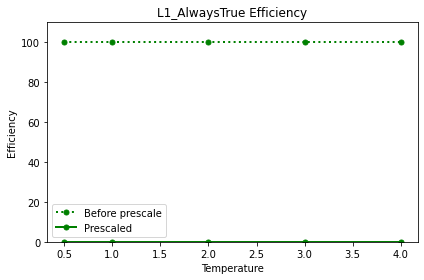

  0%|          | 1/321 [00:00<03:53,  1.37it/s]

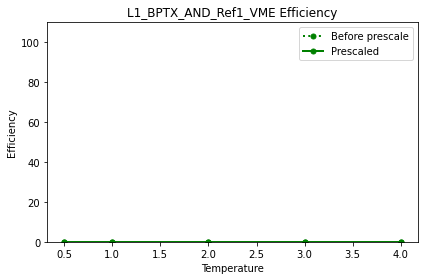

  1%|          | 2/321 [00:02<05:40,  1.07s/it]

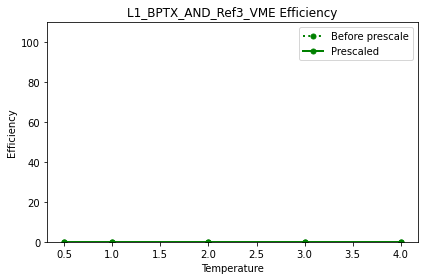

  1%|          | 3/321 [00:02<05:20,  1.01s/it]

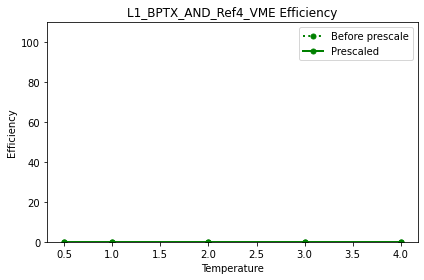

  1%|          | 4/321 [00:03<04:52,  1.08it/s]

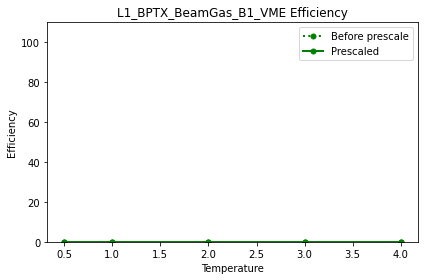

  2%|▏         | 5/321 [00:04<04:34,  1.15it/s]

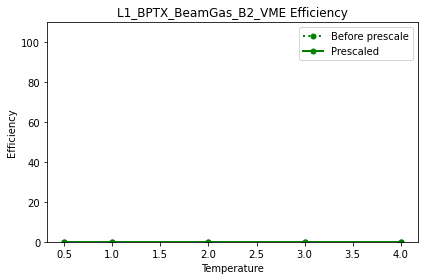

  2%|▏         | 6/321 [00:05<04:37,  1.13it/s]

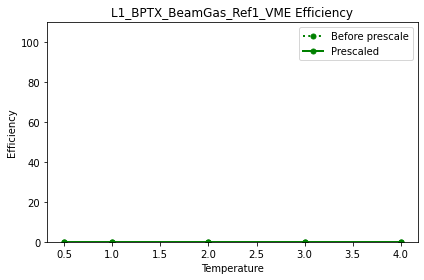

  2%|▏         | 7/321 [00:06<04:19,  1.21it/s]

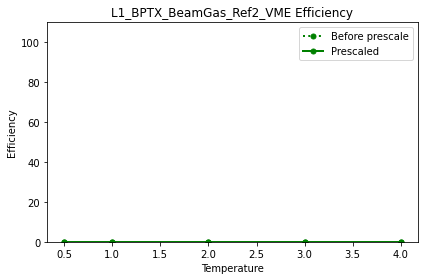

  2%|▏         | 8/321 [00:07<05:14,  1.00s/it]

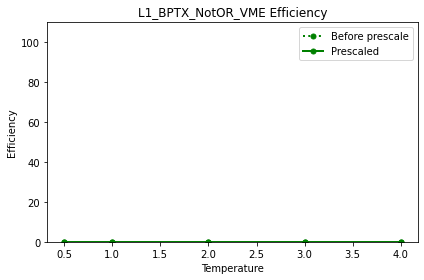

  3%|▎         | 9/321 [00:08<04:51,  1.07it/s]

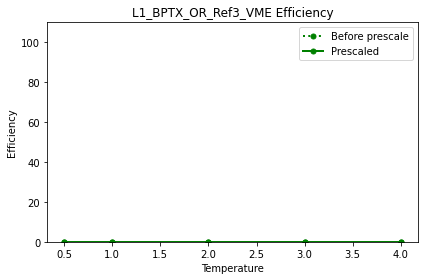

  3%|▎         | 10/321 [00:09<04:54,  1.06it/s]

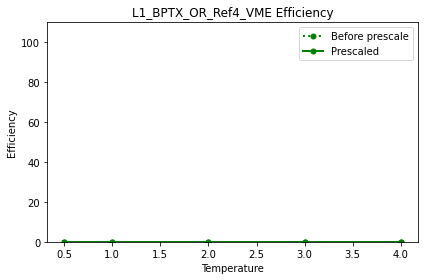

  3%|▎         | 11/321 [00:10<04:36,  1.12it/s]

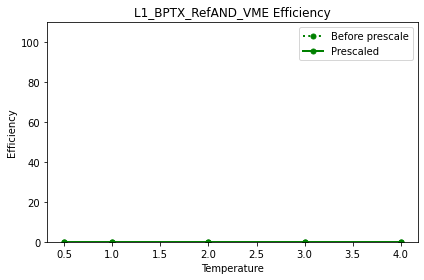

  4%|▎         | 12/321 [00:10<04:28,  1.15it/s]

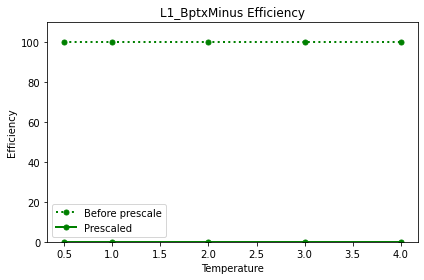

  4%|▍         | 13/321 [00:12<05:23,  1.05s/it]

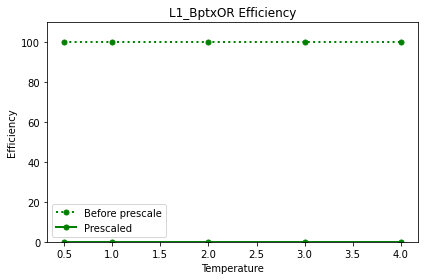

  4%|▍         | 14/321 [00:13<05:05,  1.01it/s]

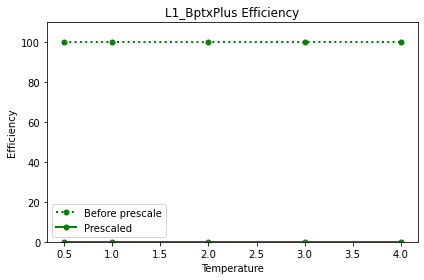

  5%|▍         | 15/321 [00:14<05:10,  1.01s/it]

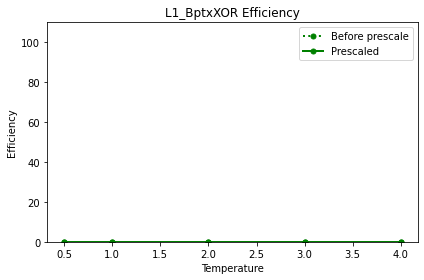

  5%|▍         | 16/321 [00:15<05:50,  1.15s/it]

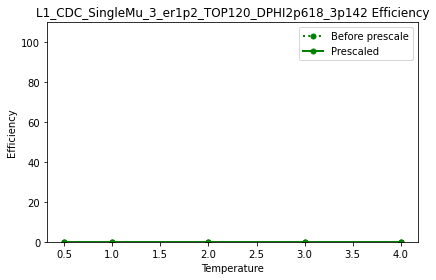

  5%|▌         | 17/321 [00:16<05:09,  1.02s/it]

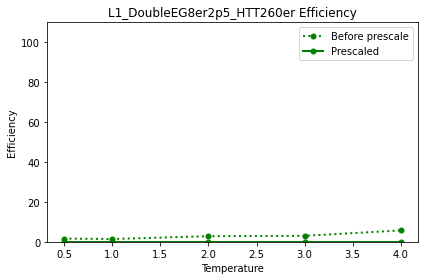

  6%|▌         | 18/321 [00:17<05:15,  1.04s/it]

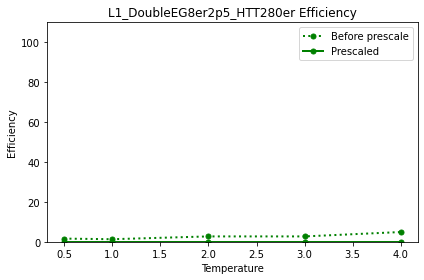

  6%|▌         | 19/321 [00:18<04:56,  1.02it/s]

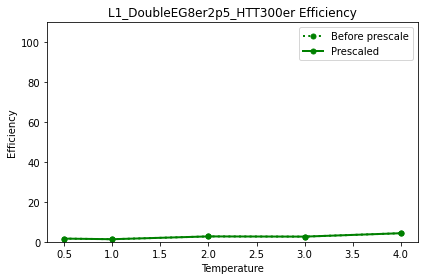

  6%|▌         | 20/321 [00:19<04:52,  1.03it/s]

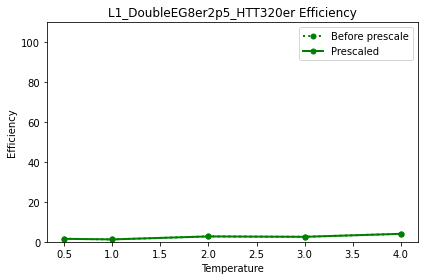

  7%|▋         | 21/321 [00:20<04:38,  1.08it/s]

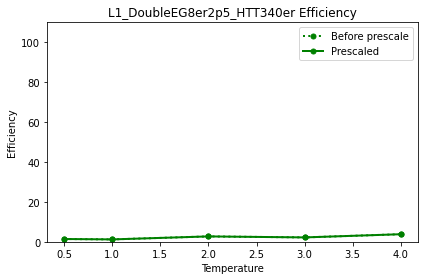

  7%|▋         | 22/321 [00:20<04:28,  1.12it/s]

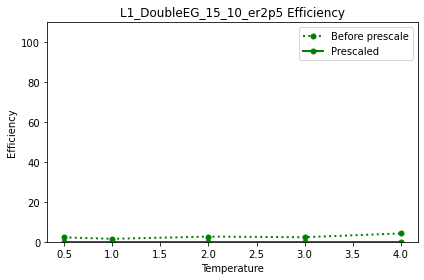

  7%|▋         | 23/321 [00:22<04:39,  1.07it/s]

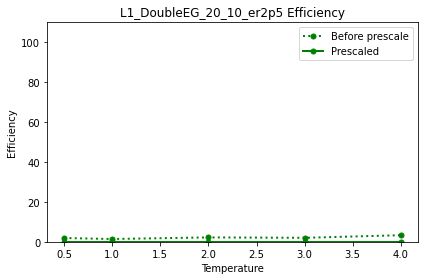

  7%|▋         | 24/321 [00:22<04:29,  1.10it/s]

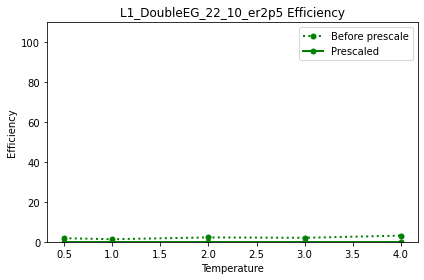

  8%|▊         | 25/321 [00:23<04:26,  1.11it/s]

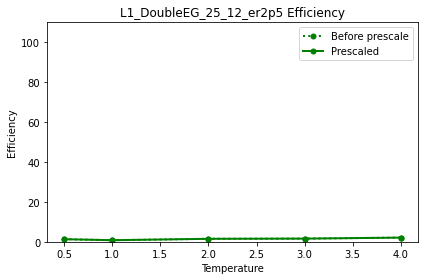

  8%|▊         | 26/321 [00:24<04:36,  1.07it/s]

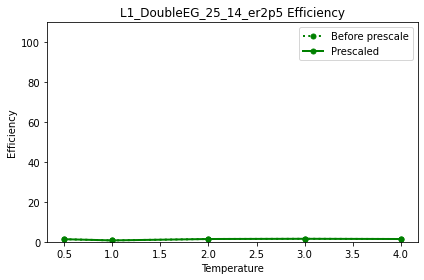

  8%|▊         | 27/321 [00:25<04:37,  1.06it/s]

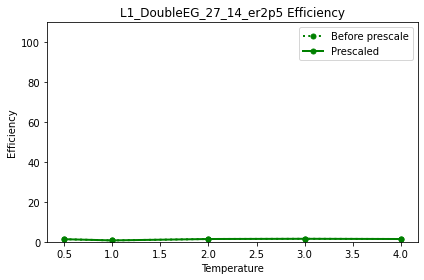

  9%|▊         | 28/321 [00:26<04:26,  1.10it/s]

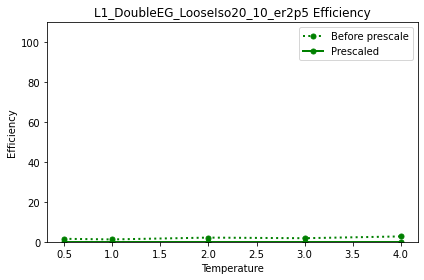

  9%|▉         | 29/321 [00:27<04:54,  1.01s/it]

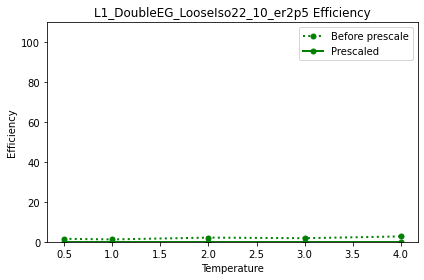

  9%|▉         | 30/321 [00:29<05:33,  1.15s/it]

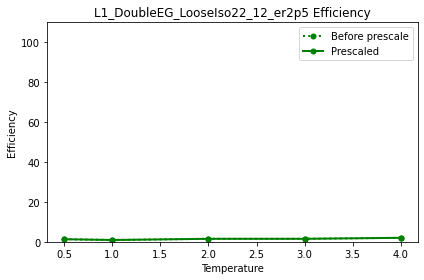

 10%|▉         | 31/321 [00:30<05:21,  1.11s/it]

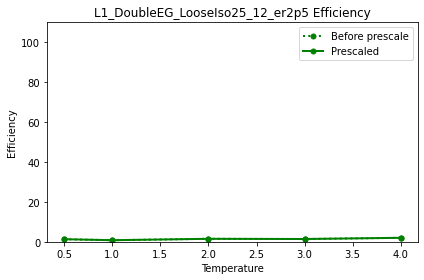

 10%|▉         | 32/321 [00:31<04:49,  1.00s/it]

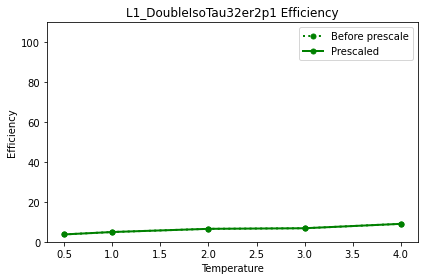

 10%|█         | 33/321 [00:32<04:48,  1.00s/it]

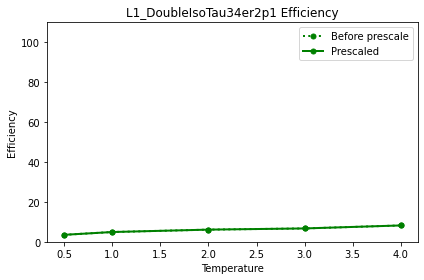

 11%|█         | 34/321 [00:32<04:14,  1.13it/s]

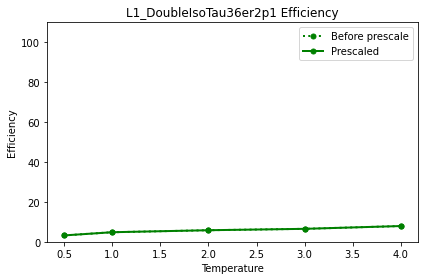

 11%|█         | 35/321 [00:33<04:05,  1.17it/s]

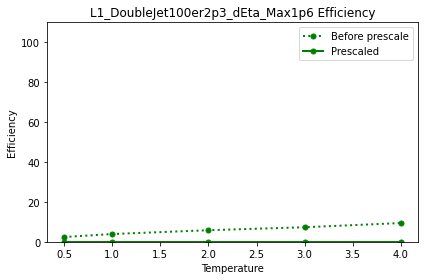

 11%|█         | 36/321 [00:34<04:13,  1.12it/s]

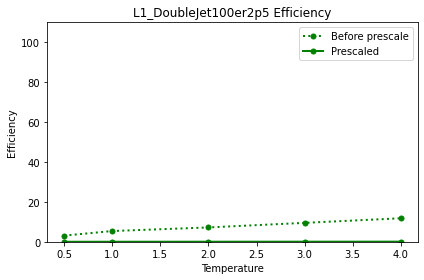

 12%|█▏        | 37/321 [00:35<04:09,  1.14it/s]

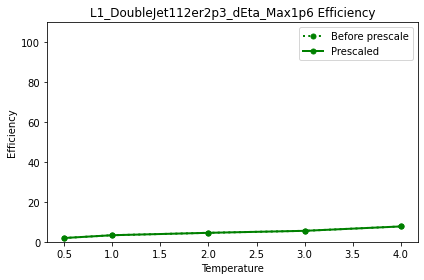

 12%|█▏        | 38/321 [00:36<04:09,  1.13it/s]

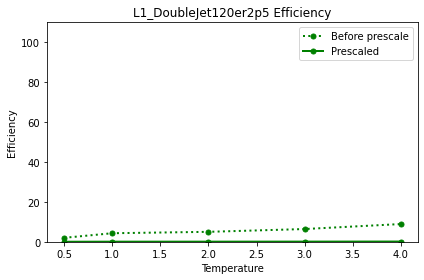

 12%|█▏        | 39/321 [00:36<03:53,  1.21it/s]

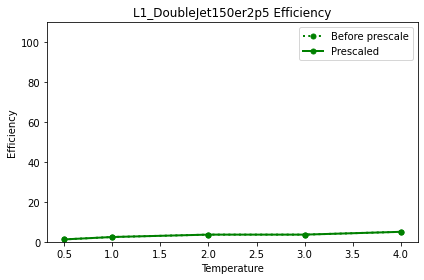

 12%|█▏        | 40/321 [00:37<04:06,  1.14it/s]

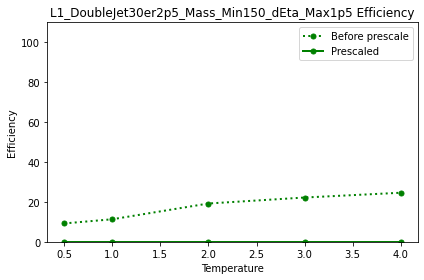

 13%|█▎        | 41/321 [00:38<03:42,  1.26it/s]

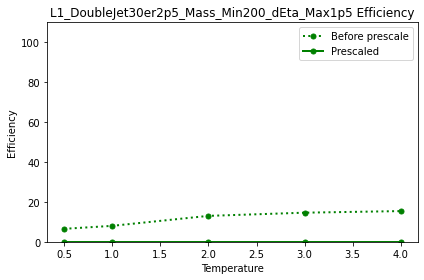

 13%|█▎        | 42/321 [00:39<03:28,  1.34it/s]

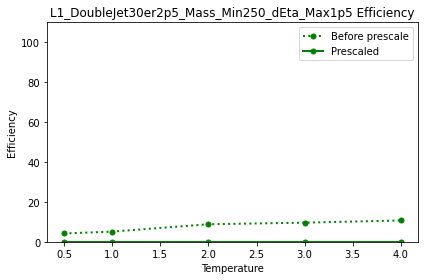

 13%|█▎        | 43/321 [00:40<03:59,  1.16it/s]

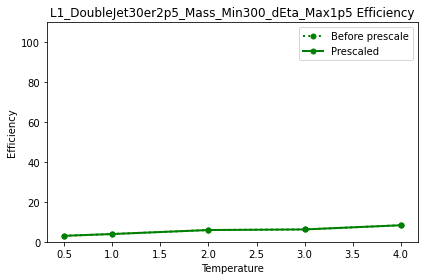

 14%|█▎        | 44/321 [00:41<04:53,  1.06s/it]

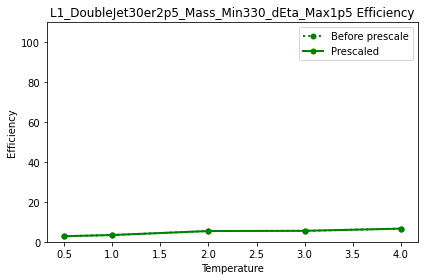

 14%|█▍        | 45/321 [00:42<04:27,  1.03it/s]

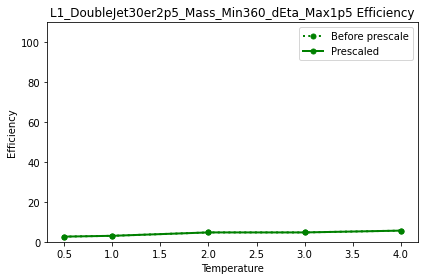

 14%|█▍        | 46/321 [00:43<04:20,  1.06it/s]

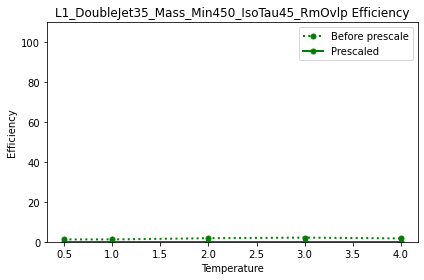

 15%|█▍        | 47/321 [00:43<03:52,  1.18it/s]

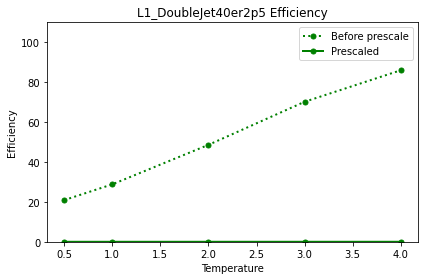

 15%|█▍        | 48/321 [00:44<03:53,  1.17it/s]

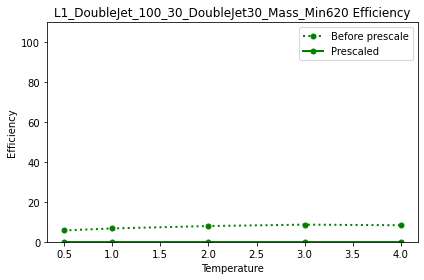

 15%|█▌        | 49/321 [00:46<04:18,  1.05it/s]

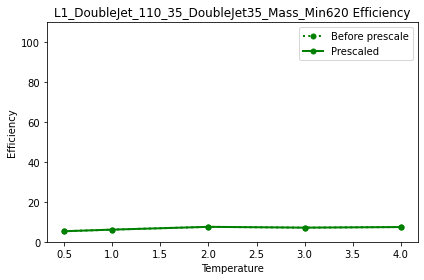

 16%|█▌        | 50/321 [00:47<04:22,  1.03it/s]

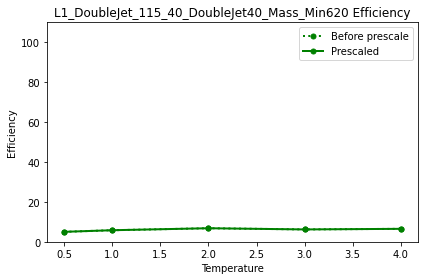

 16%|█▌        | 51/321 [00:47<04:01,  1.12it/s]

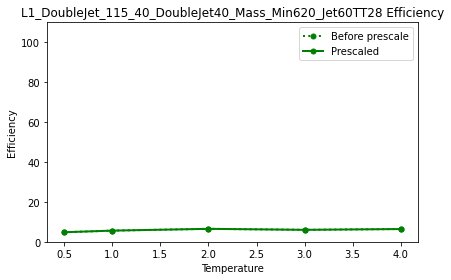

 16%|█▌        | 52/321 [00:48<03:42,  1.21it/s]

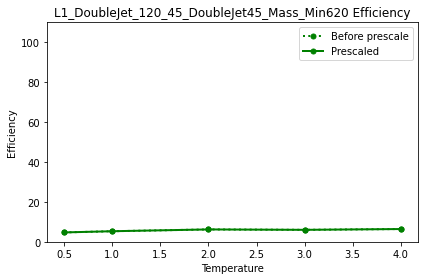

 17%|█▋        | 53/321 [00:49<03:43,  1.20it/s]

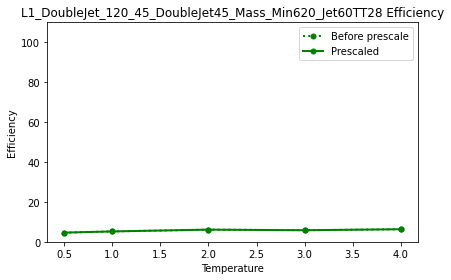

 17%|█▋        | 54/321 [00:49<03:24,  1.31it/s]

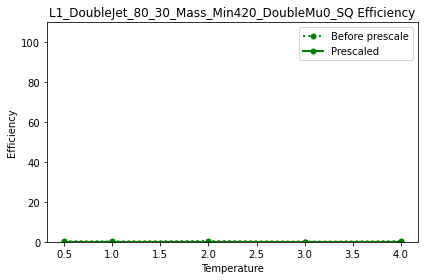

 17%|█▋        | 55/321 [00:50<03:20,  1.33it/s]

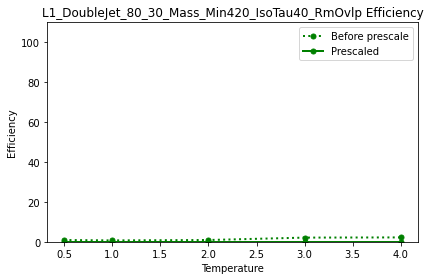

 17%|█▋        | 56/321 [00:51<03:19,  1.33it/s]

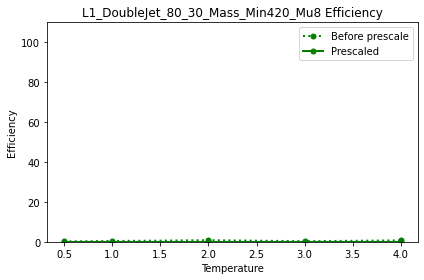

 18%|█▊        | 57/321 [00:52<03:28,  1.27it/s]

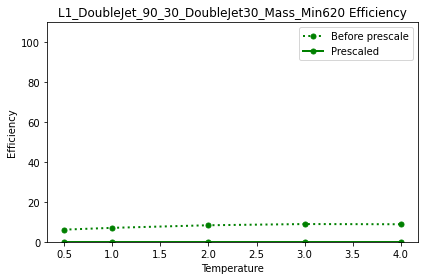

 18%|█▊        | 58/321 [00:53<03:32,  1.24it/s]

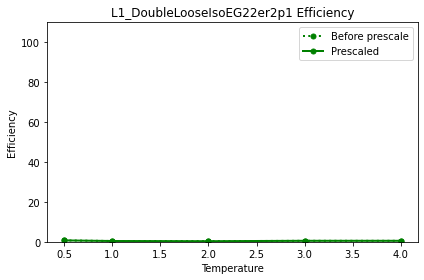

 18%|█▊        | 59/321 [00:53<03:23,  1.29it/s]

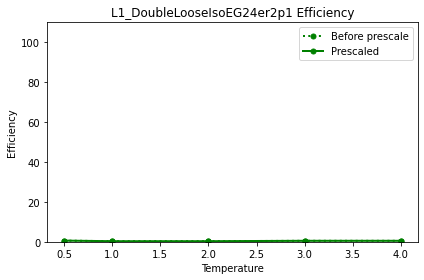

 19%|█▊        | 60/321 [00:54<03:24,  1.28it/s]

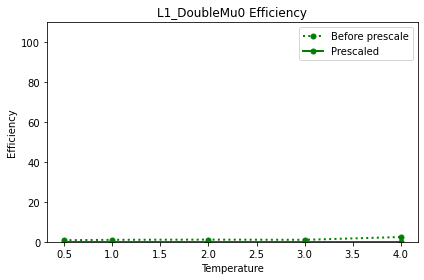

 19%|█▉        | 61/321 [00:55<03:09,  1.37it/s]

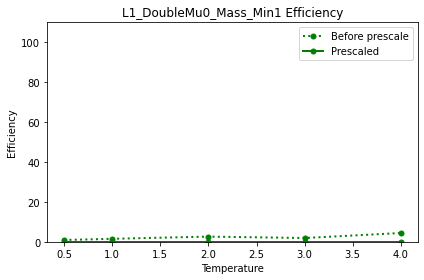

 19%|█▉        | 62/321 [00:55<03:01,  1.43it/s]

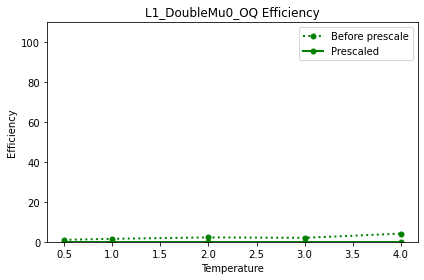

 20%|█▉        | 63/321 [00:56<03:15,  1.32it/s]

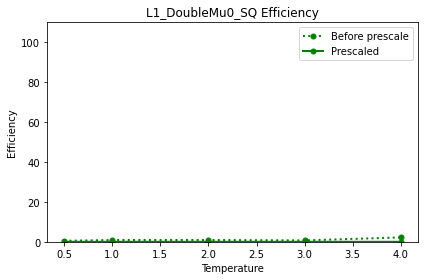

 20%|█▉        | 64/321 [00:57<02:58,  1.44it/s]

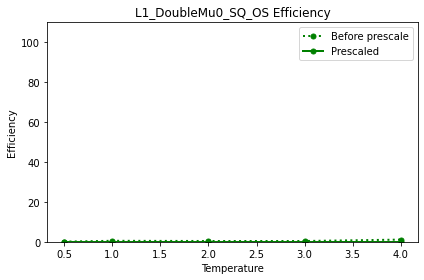

 20%|██        | 65/321 [00:57<02:53,  1.47it/s]

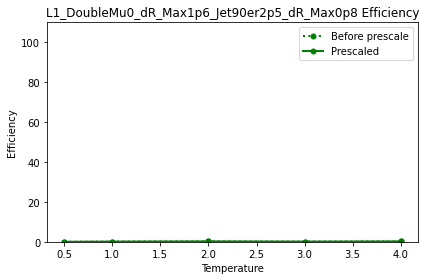

 21%|██        | 66/321 [00:58<03:01,  1.40it/s]

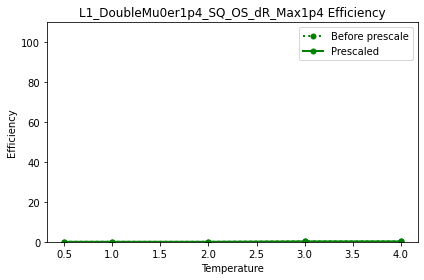

 21%|██        | 67/321 [00:59<03:13,  1.32it/s]

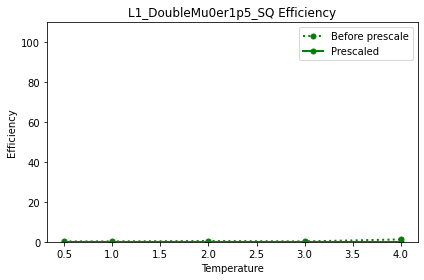

 21%|██        | 68/321 [01:00<03:14,  1.30it/s]

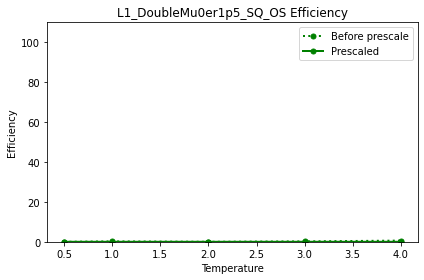

 21%|██▏       | 69/321 [01:01<03:06,  1.35it/s]

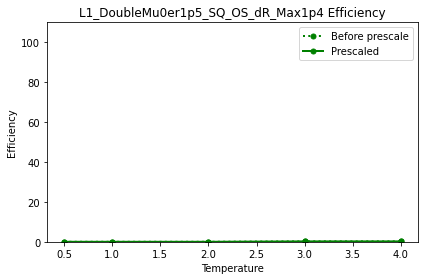

 22%|██▏       | 70/321 [01:01<03:04,  1.36it/s]

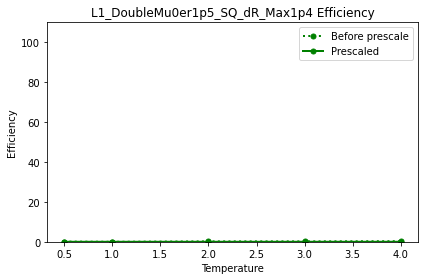

 22%|██▏       | 71/321 [01:02<02:52,  1.45it/s]

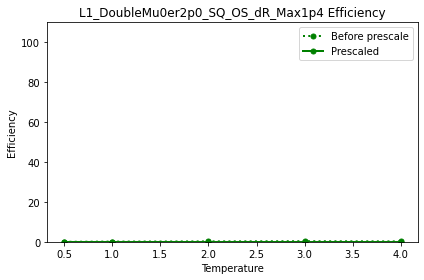

 22%|██▏       | 72/321 [01:02<02:47,  1.49it/s]

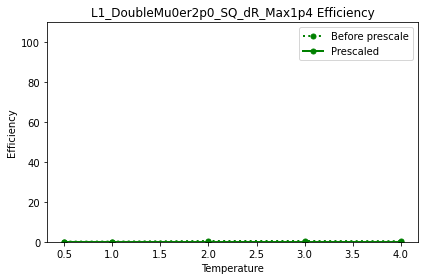

 23%|██▎       | 73/321 [01:03<02:45,  1.49it/s]

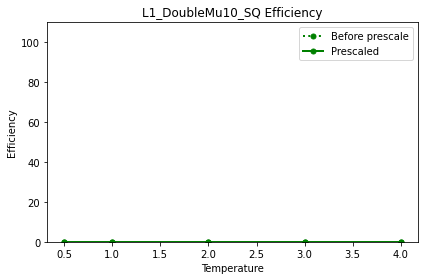

 23%|██▎       | 74/321 [01:04<03:14,  1.27it/s]

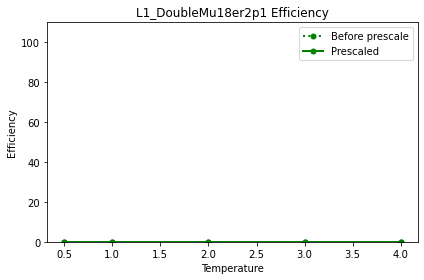

 23%|██▎       | 75/321 [01:05<03:21,  1.22it/s]

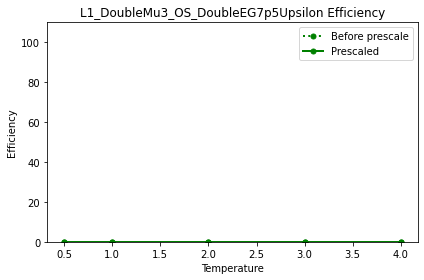

 24%|██▎       | 76/321 [01:06<03:14,  1.26it/s]

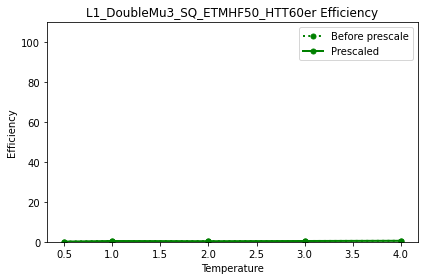

 24%|██▍       | 77/321 [01:07<03:13,  1.26it/s]

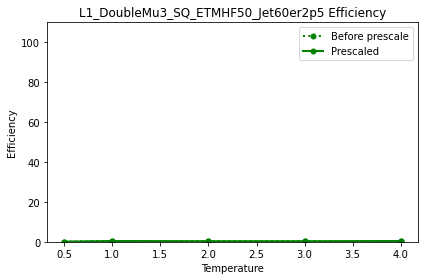

 24%|██▍       | 78/321 [01:08<03:45,  1.08it/s]

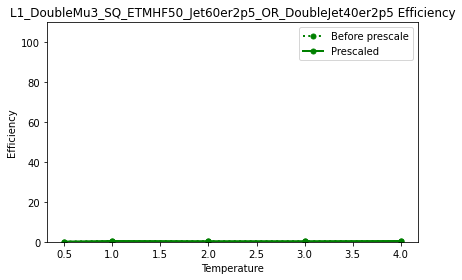

 25%|██▍       | 79/321 [01:09<03:38,  1.11it/s]

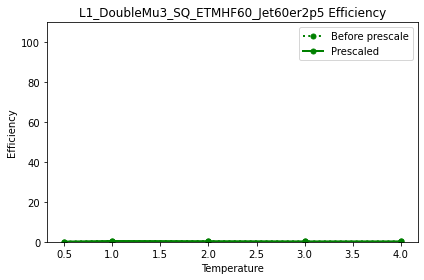

 25%|██▍       | 80/321 [01:10<03:36,  1.11it/s]

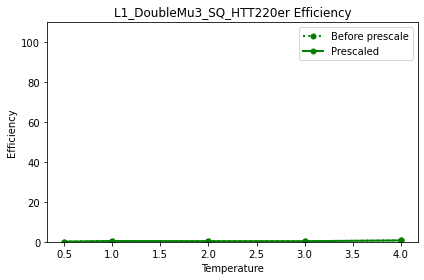

 25%|██▌       | 81/321 [01:10<03:30,  1.14it/s]

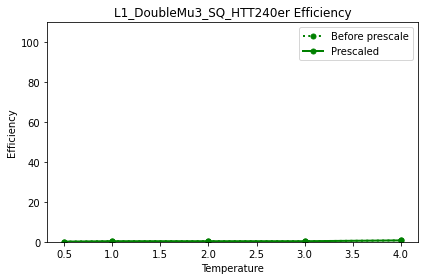

 26%|██▌       | 82/321 [01:11<03:13,  1.24it/s]

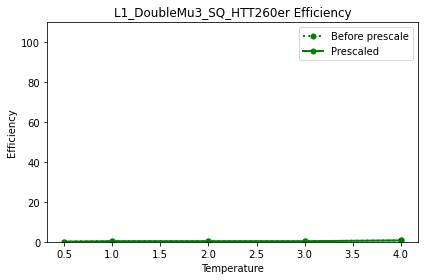

 26%|██▌       | 83/321 [01:12<03:16,  1.21it/s]

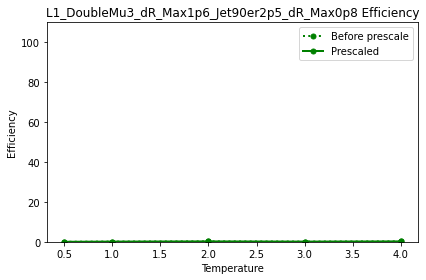

 26%|██▌       | 84/321 [01:13<03:48,  1.04it/s]

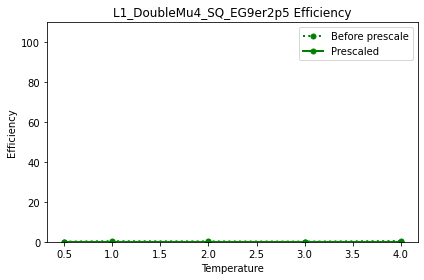

 26%|██▋       | 85/321 [01:14<03:27,  1.14it/s]

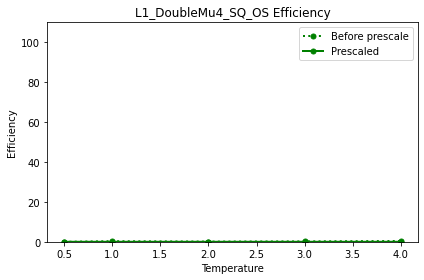

 27%|██▋       | 86/321 [01:15<03:18,  1.18it/s]

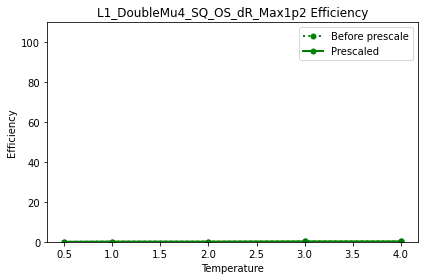

 27%|██▋       | 87/321 [01:15<03:00,  1.30it/s]

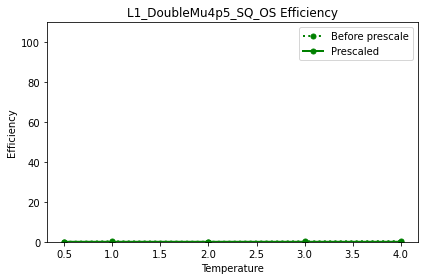

 27%|██▋       | 88/321 [01:16<03:16,  1.19it/s]

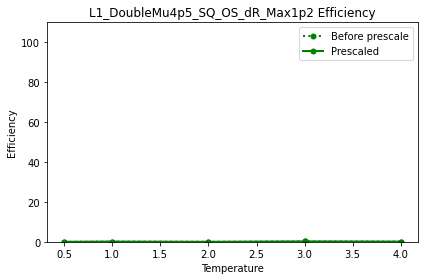

 28%|██▊       | 89/321 [01:17<03:13,  1.20it/s]

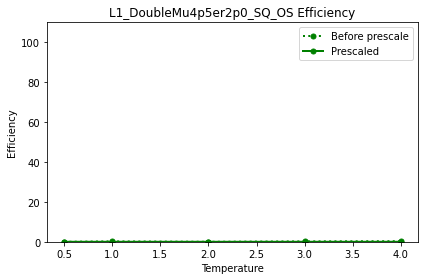

 28%|██▊       | 90/321 [01:19<03:58,  1.03s/it]

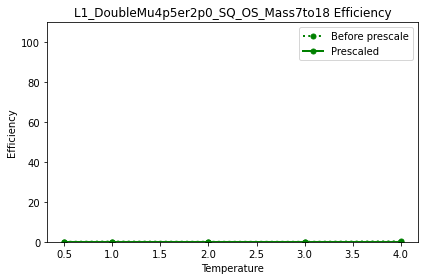

 28%|██▊       | 91/321 [01:20<03:52,  1.01s/it]

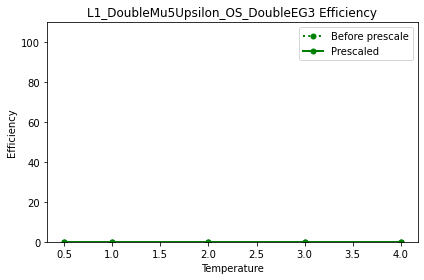

 29%|██▊       | 92/321 [01:20<03:39,  1.04it/s]

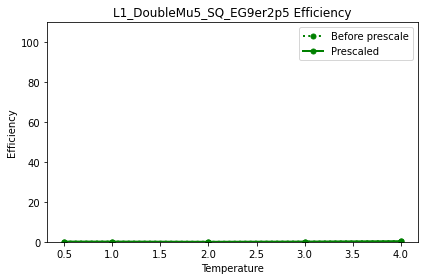

 29%|██▉       | 93/321 [01:21<03:14,  1.17it/s]

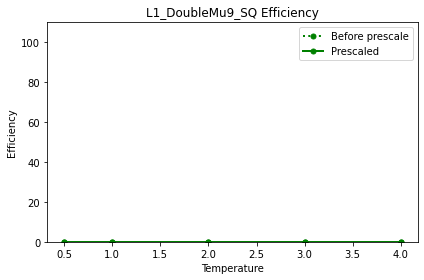

 29%|██▉       | 94/321 [01:22<03:12,  1.18it/s]

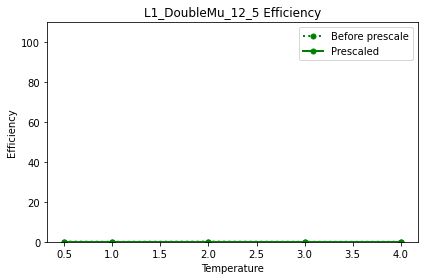

 30%|██▉       | 95/321 [01:22<02:56,  1.28it/s]

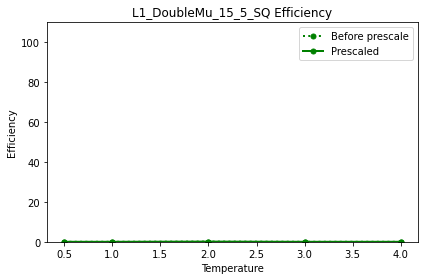

 30%|██▉       | 96/321 [01:23<02:43,  1.38it/s]

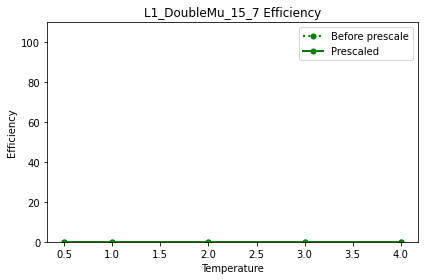

 30%|███       | 97/321 [01:24<02:33,  1.46it/s]

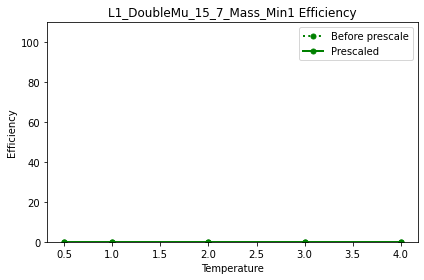

 31%|███       | 98/321 [01:25<02:56,  1.26it/s]

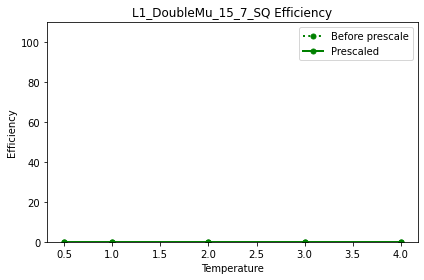

 31%|███       | 99/321 [01:26<03:00,  1.23it/s]

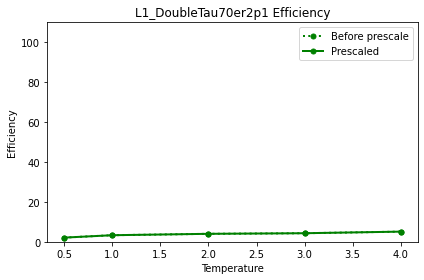

 31%|███       | 100/321 [01:26<02:38,  1.39it/s]

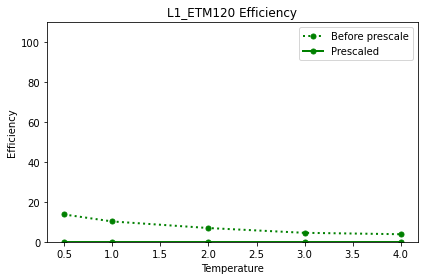

 31%|███▏      | 101/321 [01:28<03:57,  1.08s/it]

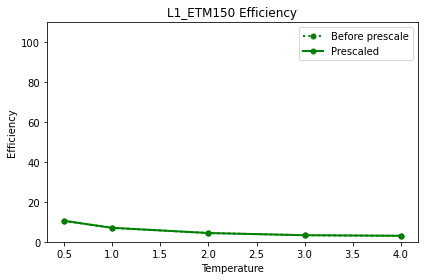

 32%|███▏      | 102/321 [01:29<03:36,  1.01it/s]

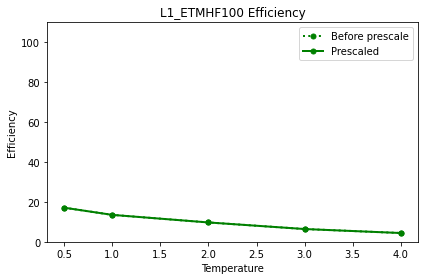

 32%|███▏      | 103/321 [01:29<03:15,  1.12it/s]

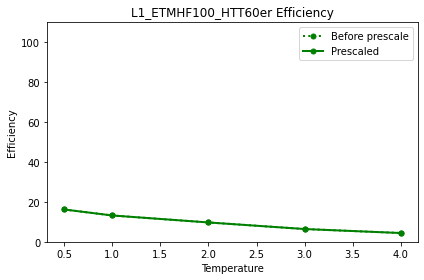

 32%|███▏      | 104/321 [01:30<03:04,  1.18it/s]

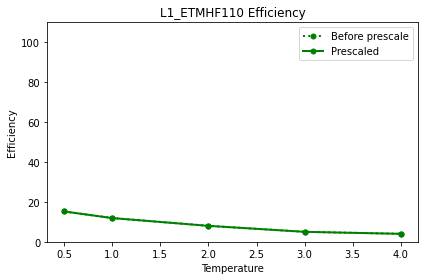

 33%|███▎      | 105/321 [01:31<02:45,  1.30it/s]

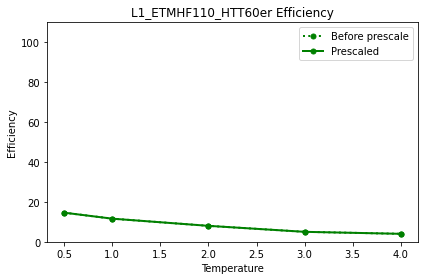

 33%|███▎      | 106/321 [01:32<02:47,  1.28it/s]

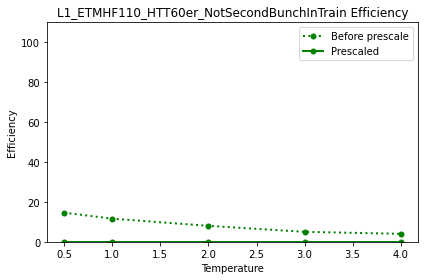

 33%|███▎      | 107/321 [01:32<02:38,  1.35it/s]

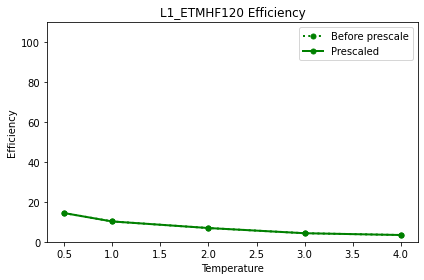

 34%|███▎      | 108/321 [01:33<02:34,  1.38it/s]

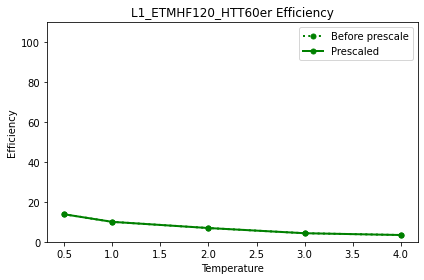

 34%|███▍      | 109/321 [01:57<27:51,  7.88s/it]

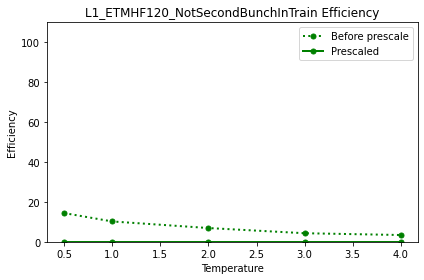

 34%|███▍      | 110/321 [01:58<20:18,  5.77s/it]

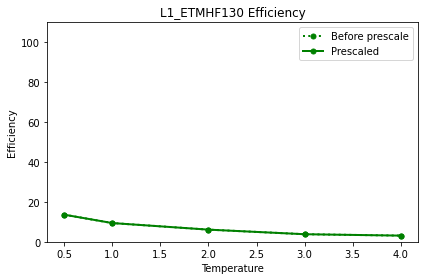

 35%|███▍      | 111/321 [01:59<14:59,  4.28s/it]

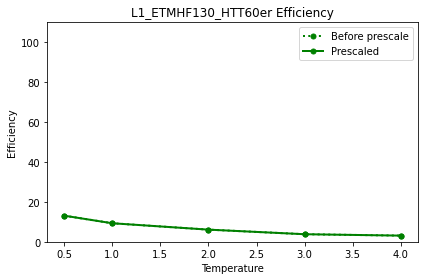

 35%|███▍      | 112/321 [02:00<11:18,  3.25s/it]

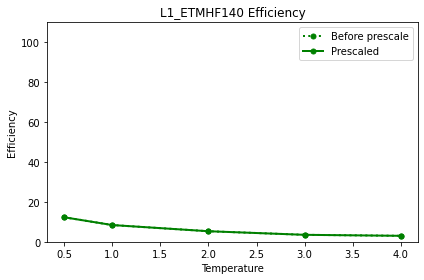

 35%|███▌      | 113/321 [02:01<08:29,  2.45s/it]

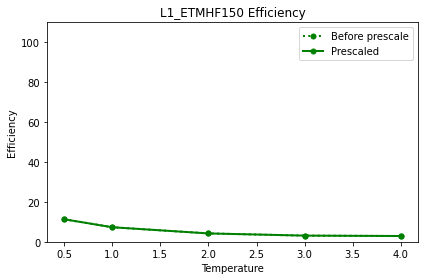

 36%|███▌      | 114/321 [02:01<06:37,  1.92s/it]

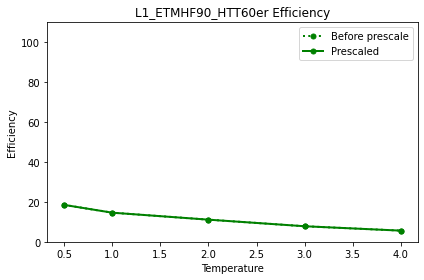

 36%|███▌      | 115/321 [02:02<05:23,  1.57s/it]

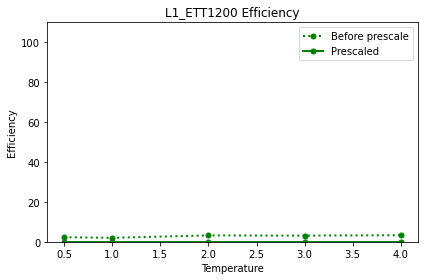

 36%|███▌      | 116/321 [02:03<04:20,  1.27s/it]

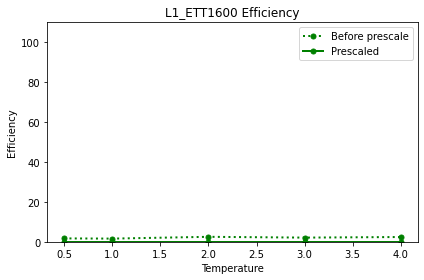

 36%|███▋      | 117/321 [02:03<03:46,  1.11s/it]

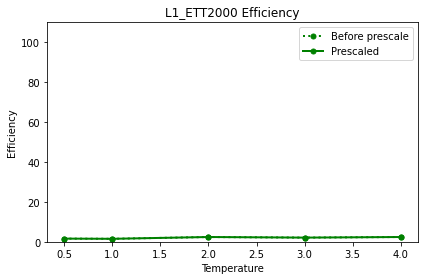

 37%|███▋      | 118/321 [02:04<03:23,  1.00s/it]

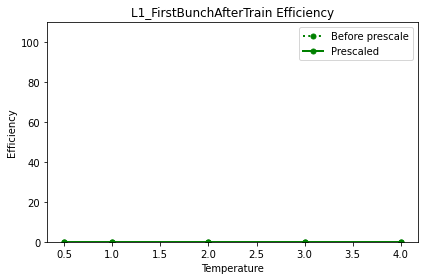

 37%|███▋      | 119/321 [02:05<02:59,  1.13it/s]

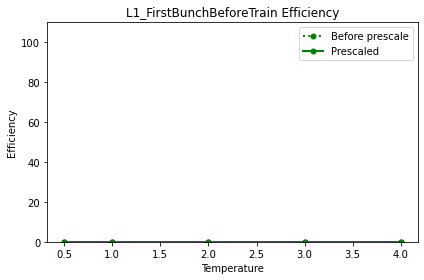

 37%|███▋      | 120/321 [02:05<02:44,  1.22it/s]

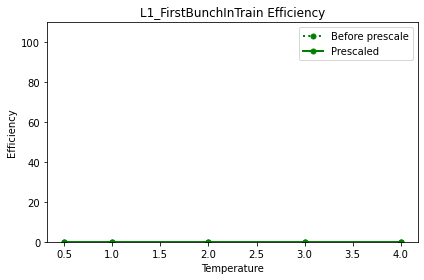

 38%|███▊      | 121/321 [02:06<02:39,  1.25it/s]

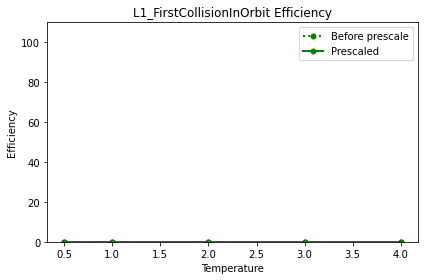

 38%|███▊      | 122/321 [02:07<02:34,  1.29it/s]

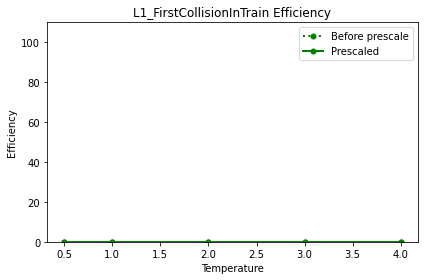

 38%|███▊      | 123/321 [02:08<02:29,  1.33it/s]

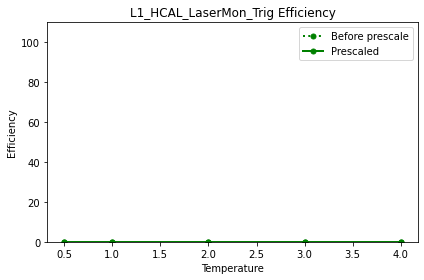

 39%|███▊      | 124/321 [02:08<02:35,  1.26it/s]

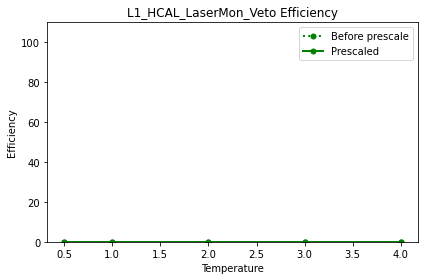

 39%|███▉      | 125/321 [02:09<02:33,  1.28it/s]

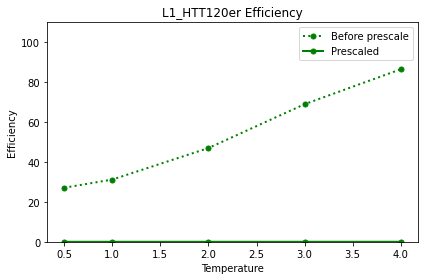

 39%|███▉      | 126/321 [02:10<02:24,  1.35it/s]

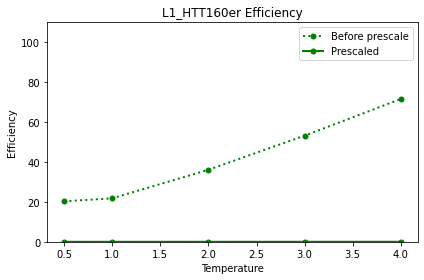

 40%|███▉      | 127/321 [02:10<02:14,  1.45it/s]

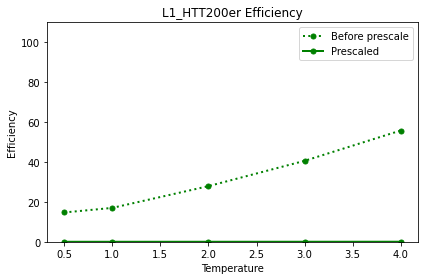

 40%|███▉      | 128/321 [02:11<02:14,  1.44it/s]

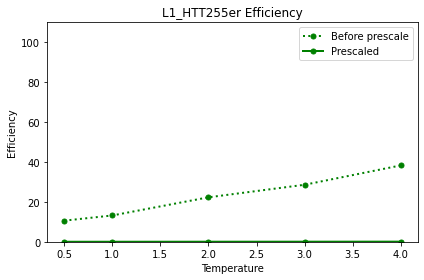

 40%|████      | 129/321 [02:12<02:05,  1.53it/s]

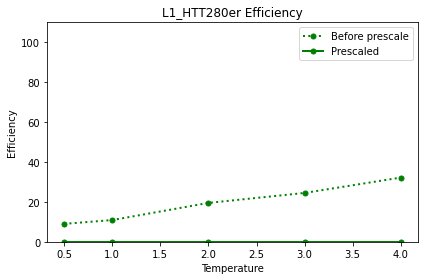

 40%|████      | 130/321 [02:12<02:09,  1.47it/s]

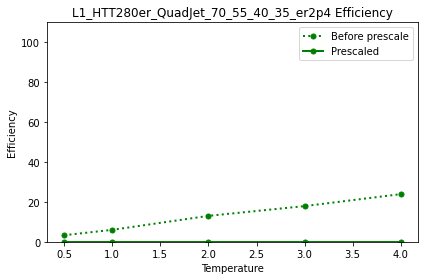

 41%|████      | 131/321 [02:13<02:06,  1.50it/s]

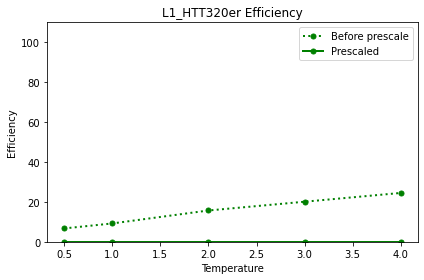

 41%|████      | 132/321 [02:14<02:03,  1.53it/s]

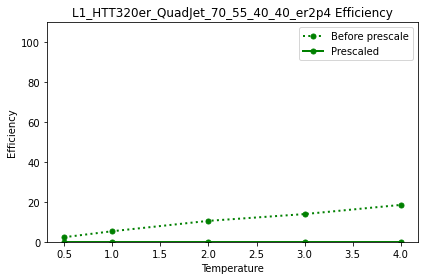

 41%|████▏     | 133/321 [02:14<02:00,  1.56it/s]

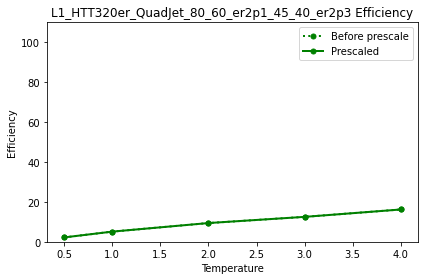

 42%|████▏     | 134/321 [02:15<02:22,  1.31it/s]

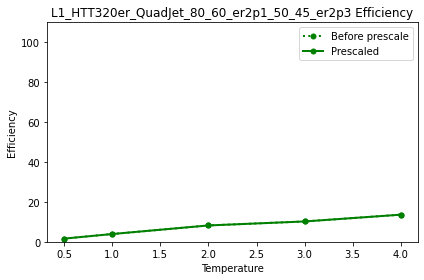

 42%|████▏     | 135/321 [02:16<02:21,  1.32it/s]

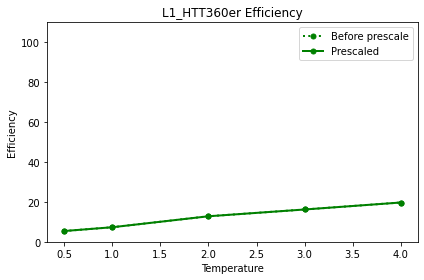

 42%|████▏     | 136/321 [02:17<02:45,  1.12it/s]

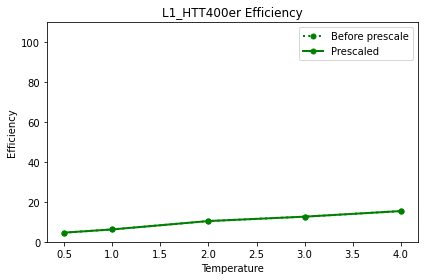

 43%|████▎     | 137/321 [02:18<02:36,  1.17it/s]

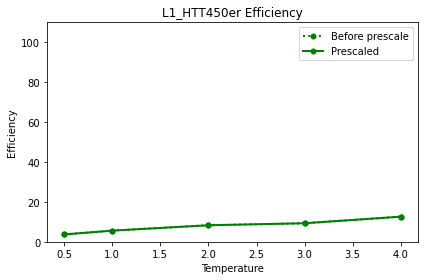

 43%|████▎     | 138/321 [02:25<08:20,  2.73s/it]

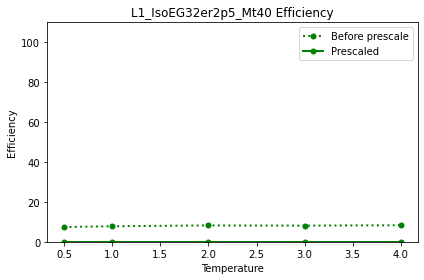

 43%|████▎     | 139/321 [02:26<06:22,  2.10s/it]

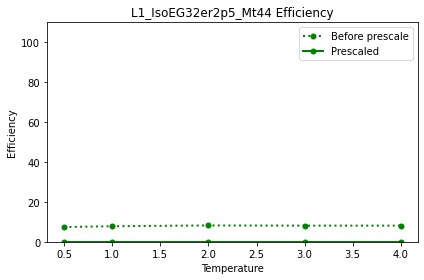

 44%|████▎     | 140/321 [02:26<05:01,  1.67s/it]

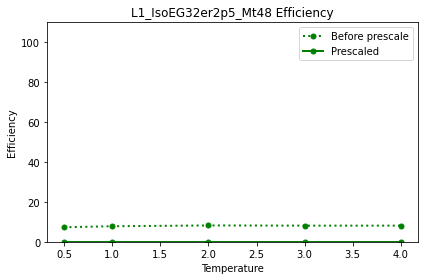

 44%|████▍     | 141/321 [02:27<04:21,  1.45s/it]

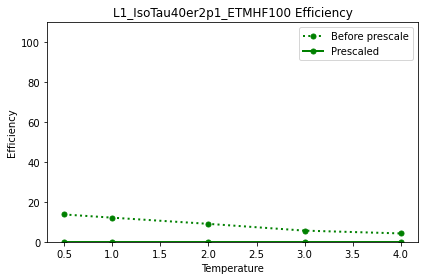

 44%|████▍     | 142/321 [02:28<03:31,  1.18s/it]

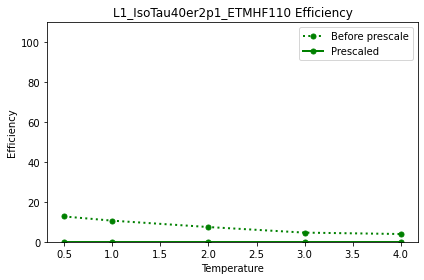

 45%|████▍     | 143/321 [02:29<03:15,  1.10s/it]

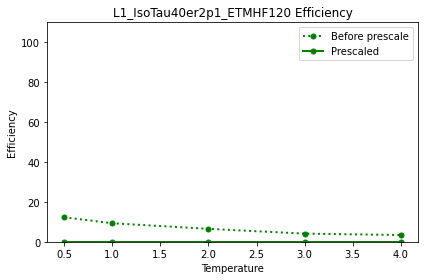

 45%|████▍     | 144/321 [02:30<03:00,  1.02s/it]

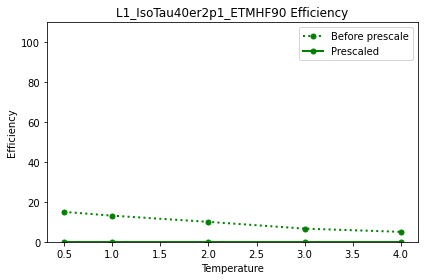

 45%|████▌     | 145/321 [02:30<02:40,  1.10it/s]

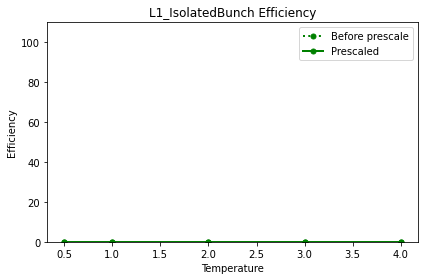

 45%|████▌     | 146/321 [02:31<02:32,  1.15it/s]

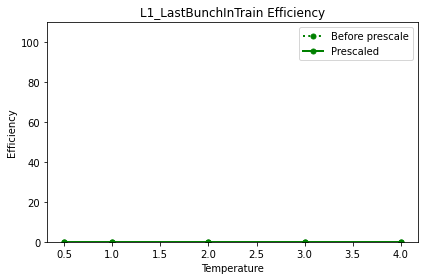

 46%|████▌     | 147/321 [02:32<02:24,  1.20it/s]

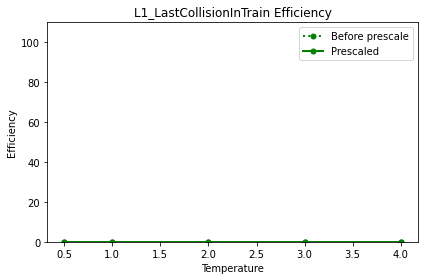

 46%|████▌     | 148/321 [02:33<02:46,  1.04it/s]

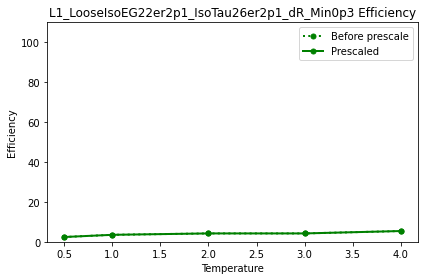

 46%|████▋     | 149/321 [02:34<02:31,  1.14it/s]

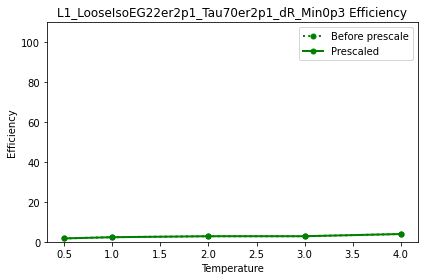

 47%|████▋     | 150/321 [02:35<02:37,  1.09it/s]

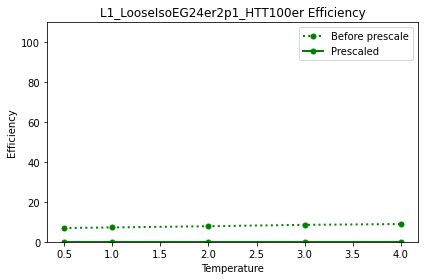

 47%|████▋     | 151/321 [02:35<02:25,  1.17it/s]

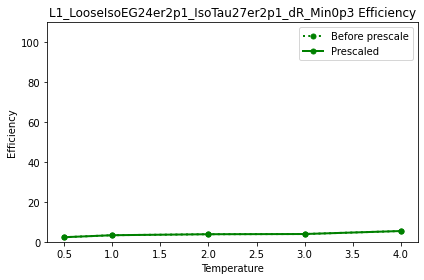

 47%|████▋     | 152/321 [02:36<02:11,  1.28it/s]

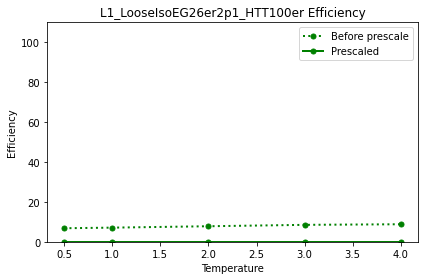

 48%|████▊     | 153/321 [02:37<02:07,  1.31it/s]

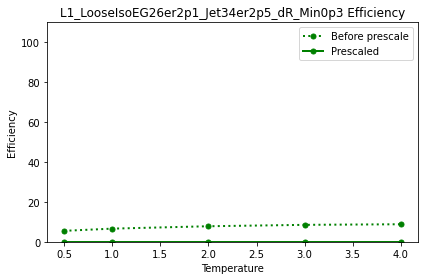

 48%|████▊     | 154/321 [02:38<02:35,  1.07it/s]

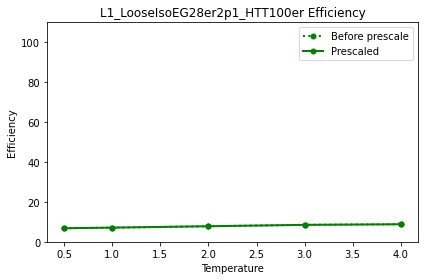

 48%|████▊     | 155/321 [02:39<02:33,  1.08it/s]

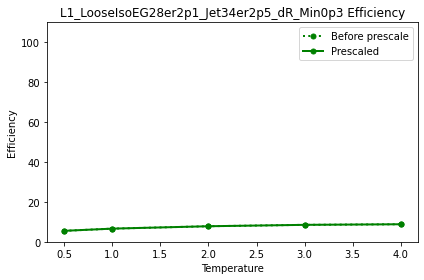

 49%|████▊     | 156/321 [02:40<02:28,  1.11it/s]

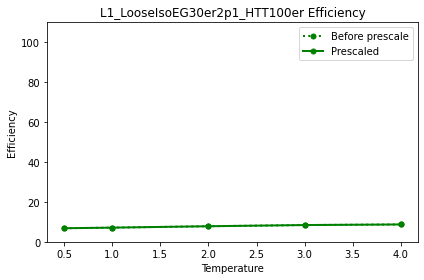

 49%|████▉     | 157/321 [02:41<02:58,  1.09s/it]

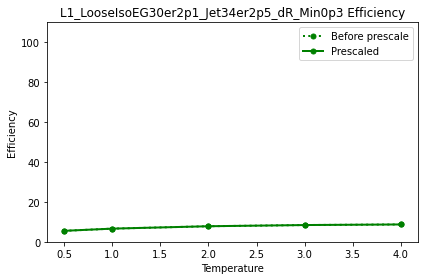

 49%|████▉     | 158/321 [02:42<02:43,  1.01s/it]

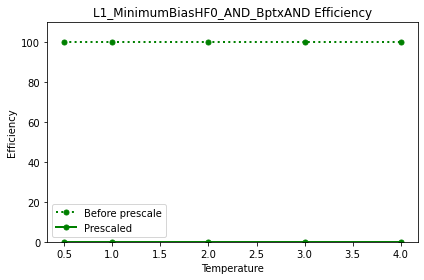

 50%|████▉     | 159/321 [02:43<02:31,  1.07it/s]

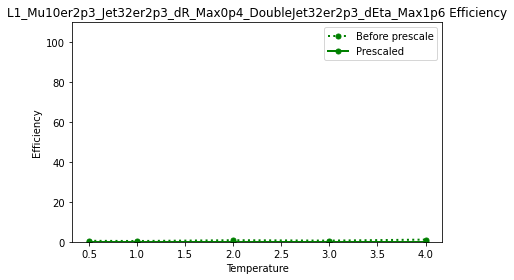

 50%|████▉     | 160/321 [02:44<02:31,  1.06it/s]

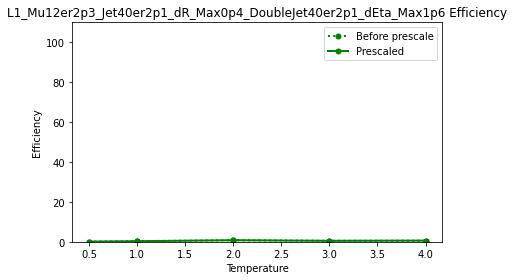

 50%|█████     | 161/321 [02:45<02:28,  1.08it/s]

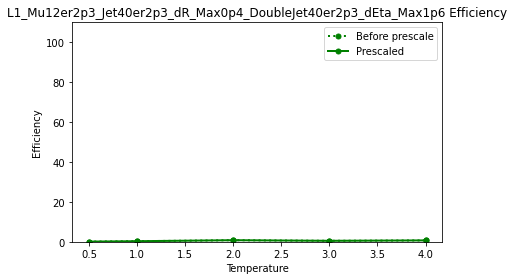

 50%|█████     | 162/321 [02:46<02:17,  1.16it/s]

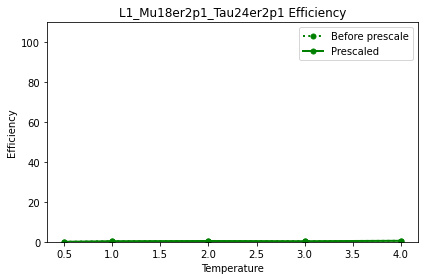

 51%|█████     | 163/321 [02:46<02:13,  1.18it/s]

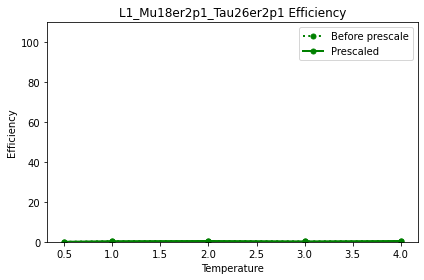

 51%|█████     | 164/321 [02:47<02:09,  1.21it/s]

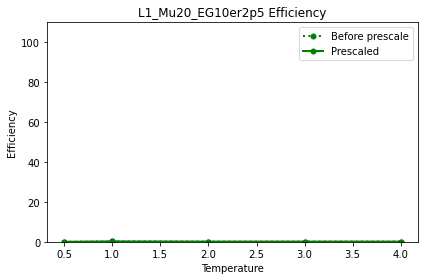

 51%|█████▏    | 165/321 [02:48<02:12,  1.17it/s]

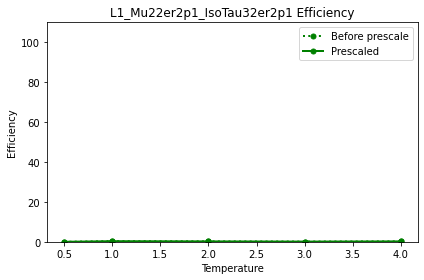

 52%|█████▏    | 166/321 [02:49<02:12,  1.17it/s]

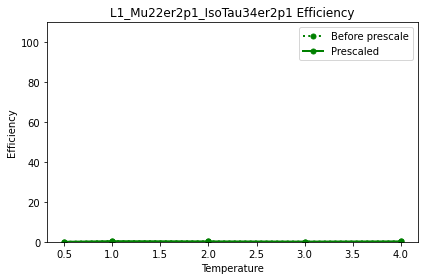

 52%|█████▏    | 167/321 [02:50<02:34,  1.00s/it]

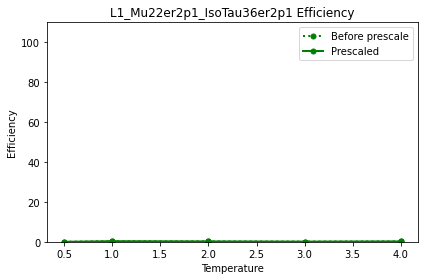

 52%|█████▏    | 168/321 [02:51<02:15,  1.13it/s]

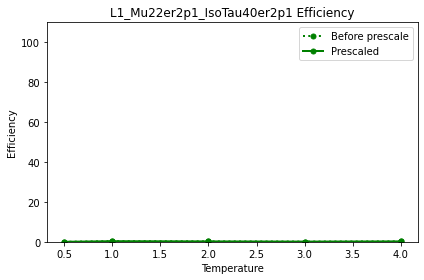

 53%|█████▎    | 169/321 [02:52<02:08,  1.19it/s]

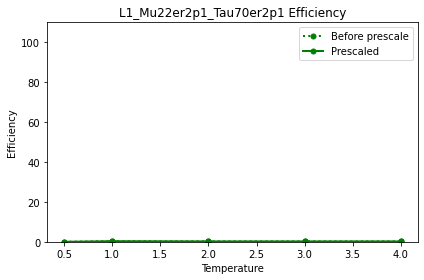

 53%|█████▎    | 170/321 [02:52<01:55,  1.31it/s]

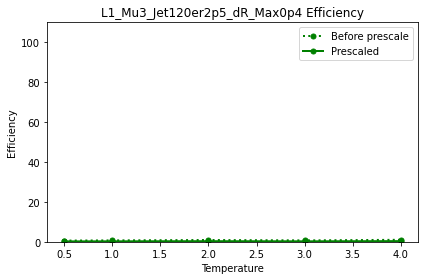

 53%|█████▎    | 171/321 [02:53<01:54,  1.31it/s]

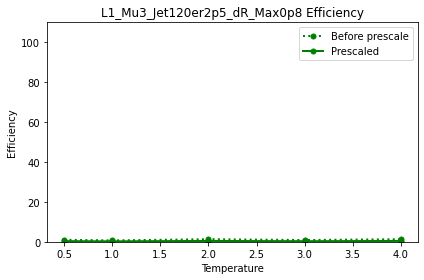

 54%|█████▎    | 172/321 [02:54<01:46,  1.40it/s]

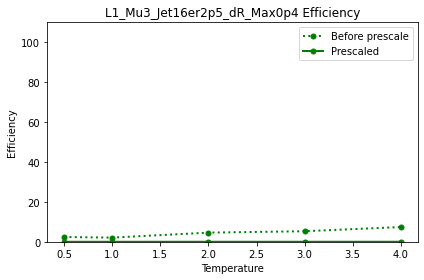

 54%|█████▍    | 173/321 [02:54<01:43,  1.43it/s]

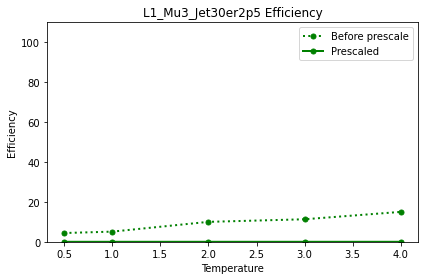

 54%|█████▍    | 174/321 [02:58<03:41,  1.50s/it]

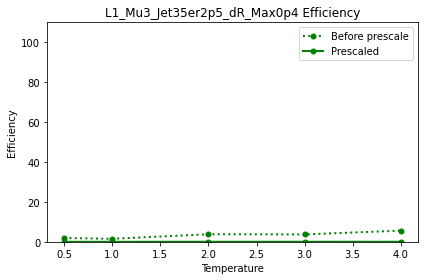

 55%|█████▍    | 175/321 [02:58<02:59,  1.23s/it]

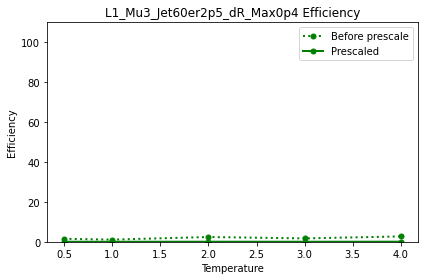

 55%|█████▍    | 176/321 [02:59<02:36,  1.08s/it]

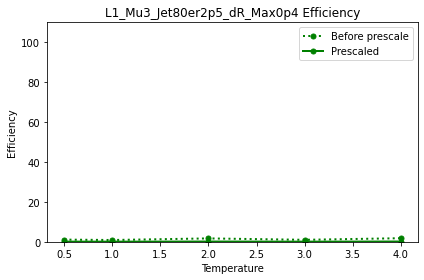

 55%|█████▌    | 177/321 [03:00<02:20,  1.03it/s]

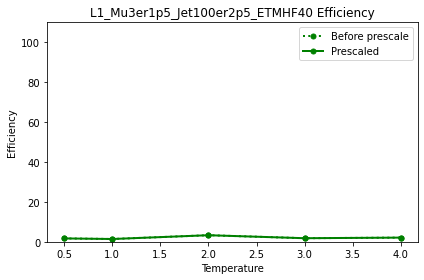

 55%|█████▌    | 178/321 [03:00<02:08,  1.11it/s]

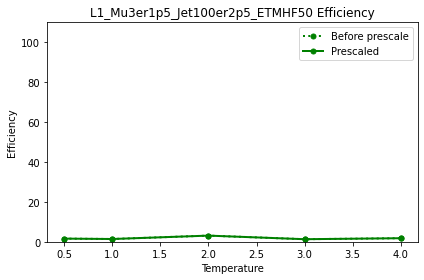

 56%|█████▌    | 179/321 [03:01<02:01,  1.17it/s]

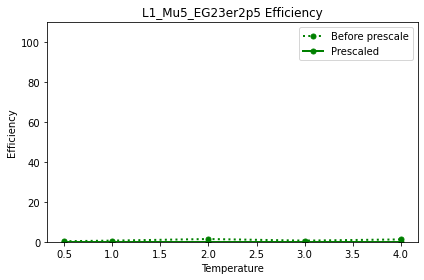

 56%|█████▌    | 180/321 [03:02<01:51,  1.26it/s]

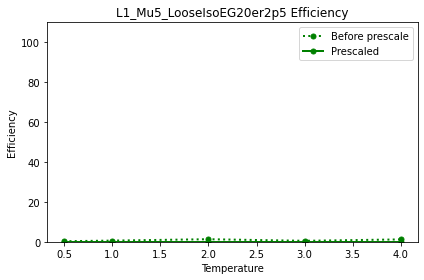

 56%|█████▋    | 181/321 [03:02<01:44,  1.34it/s]

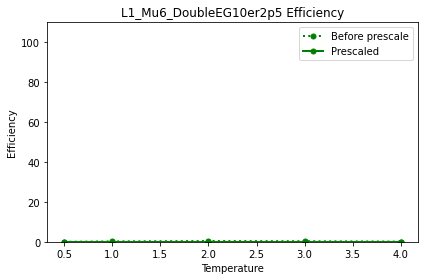

 57%|█████▋    | 182/321 [03:03<01:43,  1.35it/s]

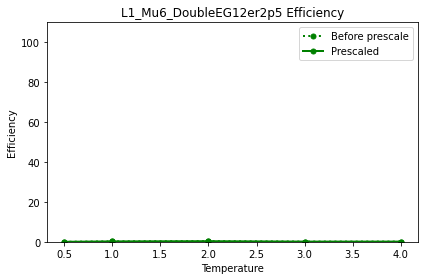

 57%|█████▋    | 183/321 [03:04<01:38,  1.40it/s]

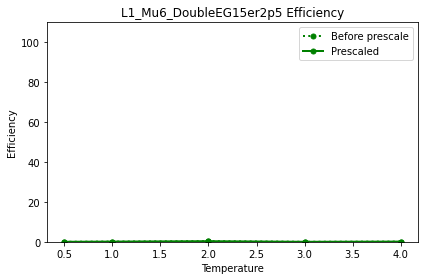

 57%|█████▋    | 184/321 [03:04<01:34,  1.45it/s]

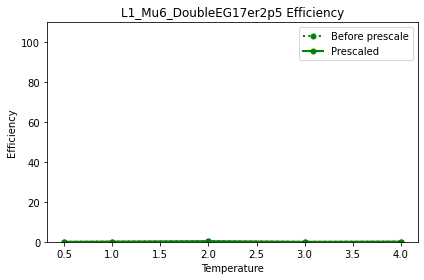

 58%|█████▊    | 185/321 [03:07<02:40,  1.18s/it]

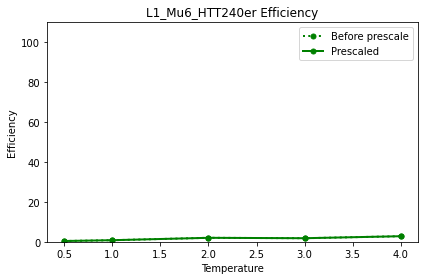

 58%|█████▊    | 186/321 [03:08<02:21,  1.05s/it]

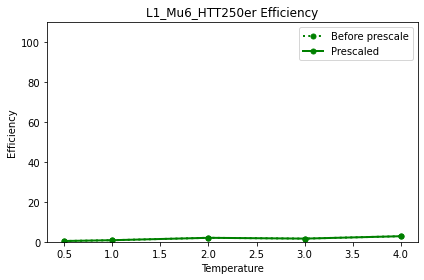

 58%|█████▊    | 187/321 [03:08<02:00,  1.11it/s]

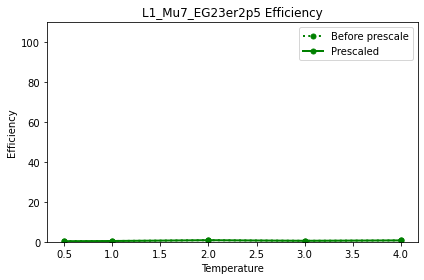

 59%|█████▊    | 188/321 [03:09<02:18,  1.04s/it]

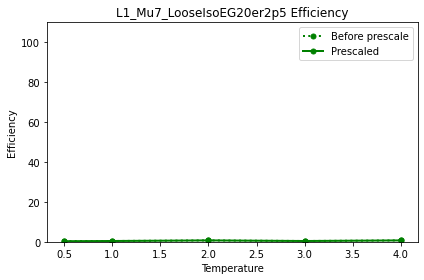

 59%|█████▉    | 189/321 [03:10<02:11,  1.00it/s]

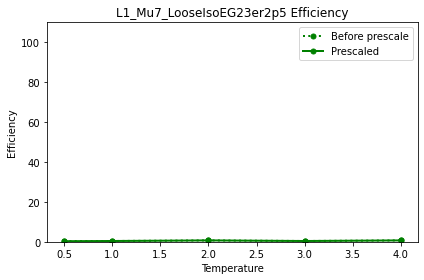

 59%|█████▉    | 190/321 [03:11<02:02,  1.07it/s]

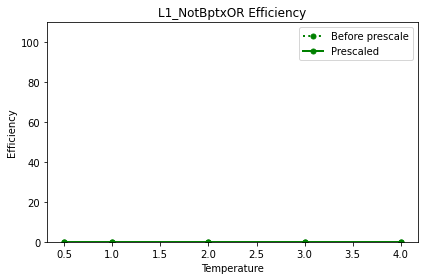

 60%|█████▉    | 191/321 [03:12<01:55,  1.12it/s]

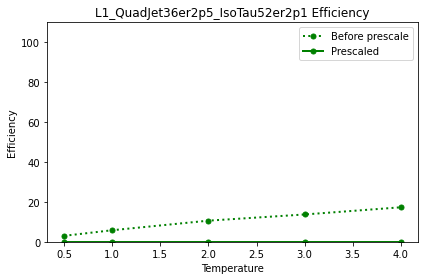

 60%|█████▉    | 192/321 [03:13<01:46,  1.21it/s]

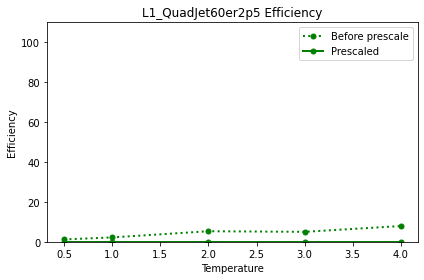

 60%|██████    | 193/321 [03:14<02:14,  1.05s/it]

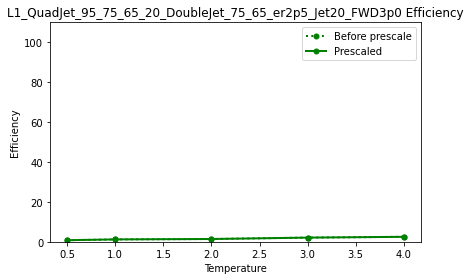

 60%|██████    | 194/321 [03:15<02:00,  1.05it/s]

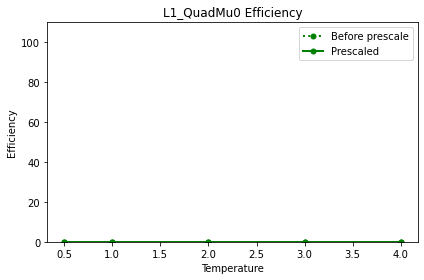

 61%|██████    | 195/321 [03:16<01:49,  1.15it/s]

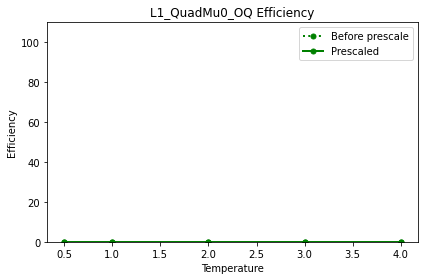

 61%|██████    | 196/321 [03:16<01:40,  1.24it/s]

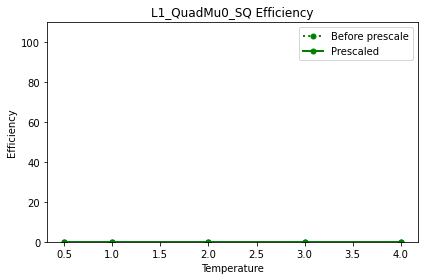

 61%|██████▏   | 197/321 [03:17<01:33,  1.33it/s]

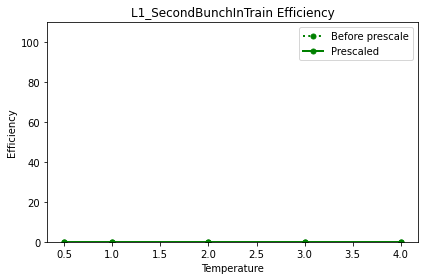

 62%|██████▏   | 198/321 [03:18<01:31,  1.34it/s]

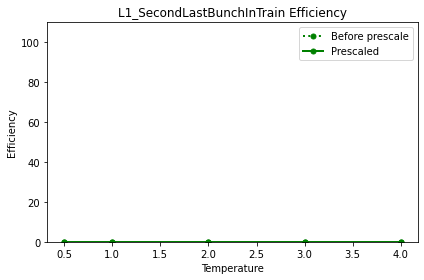

 62%|██████▏   | 199/321 [03:18<01:31,  1.34it/s]

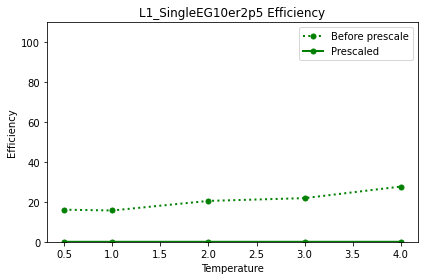

 62%|██████▏   | 200/321 [03:19<01:37,  1.24it/s]

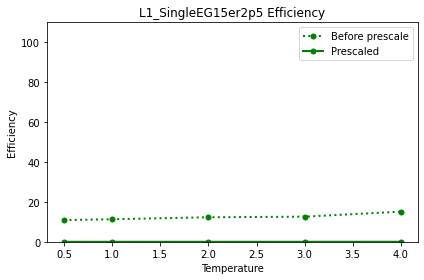

 63%|██████▎   | 201/321 [03:20<01:33,  1.29it/s]

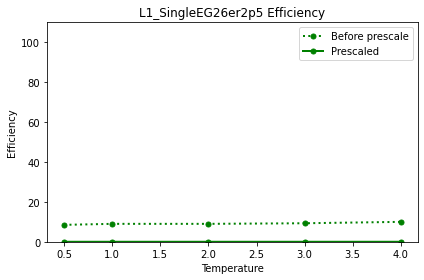

 63%|██████▎   | 202/321 [03:21<01:33,  1.27it/s]

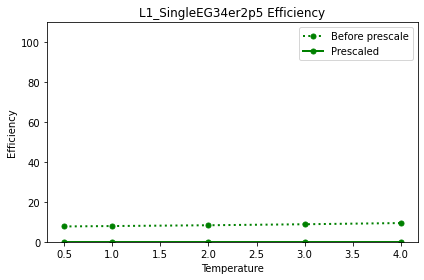

 63%|██████▎   | 203/321 [03:22<01:31,  1.29it/s]

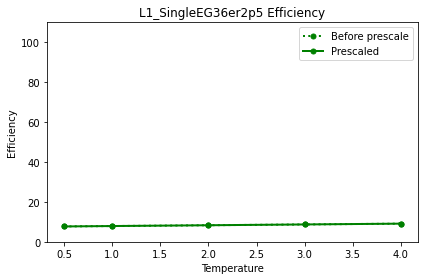

 64%|██████▎   | 204/321 [03:22<01:30,  1.29it/s]

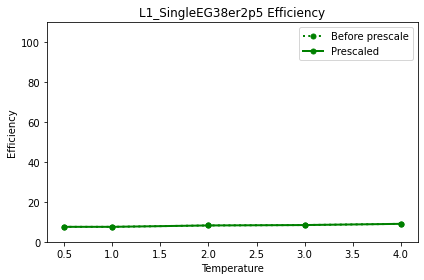

 64%|██████▍   | 205/321 [03:24<02:06,  1.09s/it]

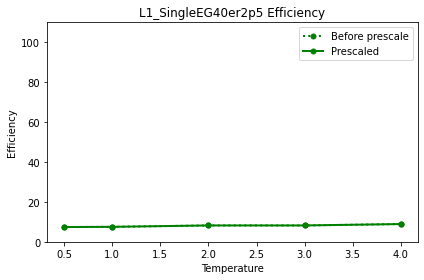

 64%|██████▍   | 206/321 [03:25<01:48,  1.06it/s]

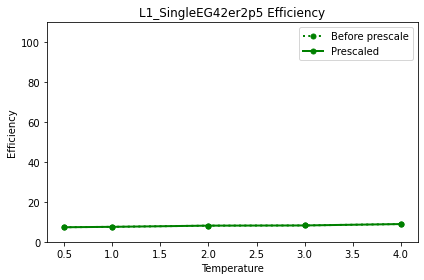

 64%|██████▍   | 207/321 [03:26<01:48,  1.05it/s]

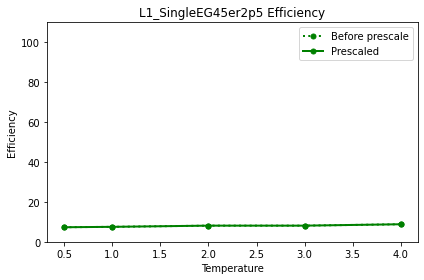

 65%|██████▍   | 208/321 [03:26<01:34,  1.19it/s]

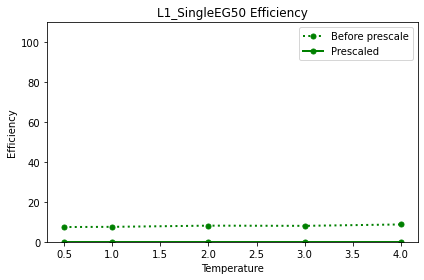

 65%|██████▌   | 209/321 [03:27<01:31,  1.23it/s]

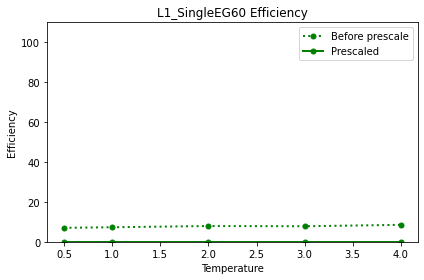

 65%|██████▌   | 210/321 [03:28<01:25,  1.30it/s]

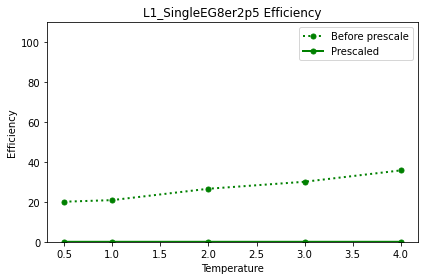

 66%|██████▌   | 211/321 [03:29<01:41,  1.09it/s]

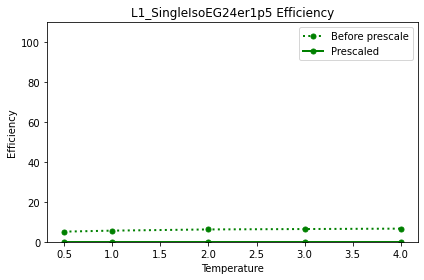

 66%|██████▌   | 212/321 [03:30<01:40,  1.09it/s]

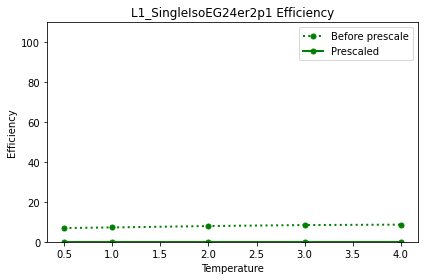

 66%|██████▋   | 213/321 [03:31<01:37,  1.11it/s]

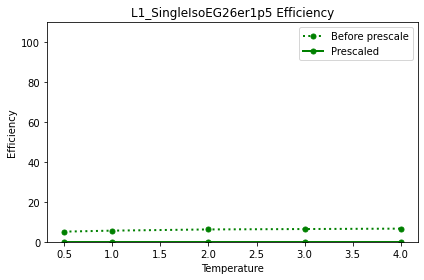

 67%|██████▋   | 214/321 [03:31<01:29,  1.19it/s]

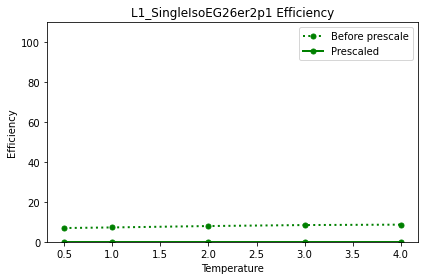

 67%|██████▋   | 215/321 [03:32<01:23,  1.27it/s]

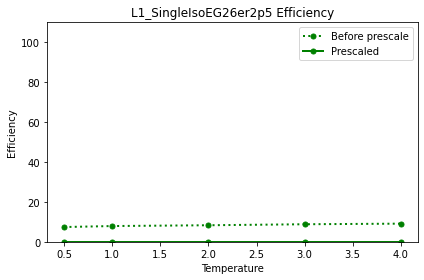

 67%|██████▋   | 216/321 [03:33<01:13,  1.43it/s]

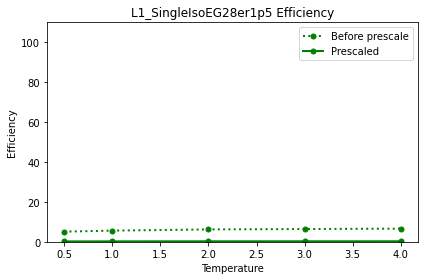

 68%|██████▊   | 217/321 [03:33<01:16,  1.35it/s]

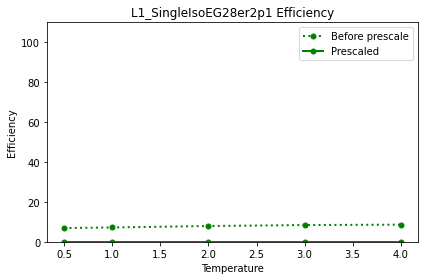

 68%|██████▊   | 218/321 [03:34<01:13,  1.40it/s]

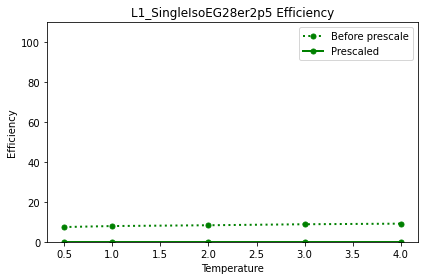

 68%|██████▊   | 219/321 [03:35<01:12,  1.41it/s]

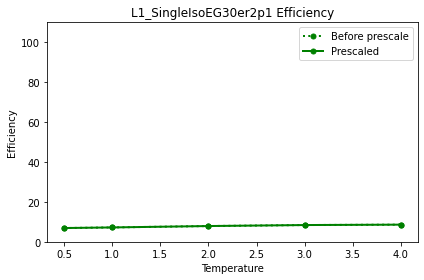

 69%|██████▊   | 220/321 [03:35<01:11,  1.42it/s]

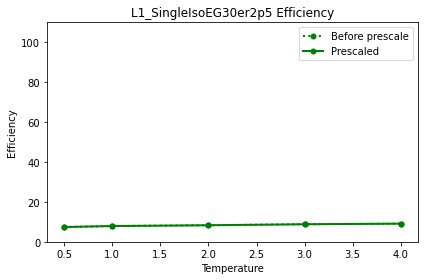

 69%|██████▉   | 221/321 [03:36<01:15,  1.32it/s]

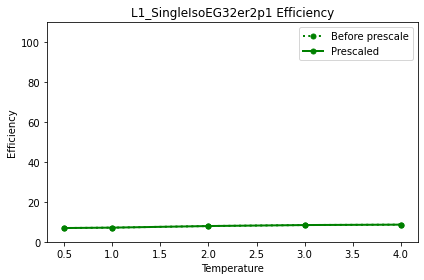

 69%|██████▉   | 222/321 [03:38<01:30,  1.09it/s]

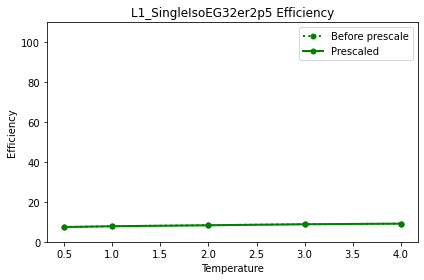

 69%|██████▉   | 223/321 [03:38<01:22,  1.19it/s]

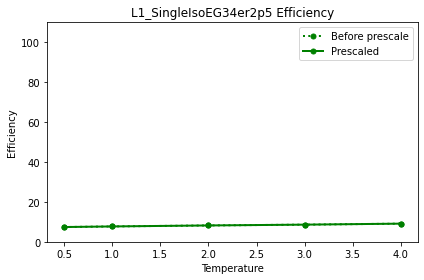

 70%|██████▉   | 224/321 [03:39<01:24,  1.15it/s]

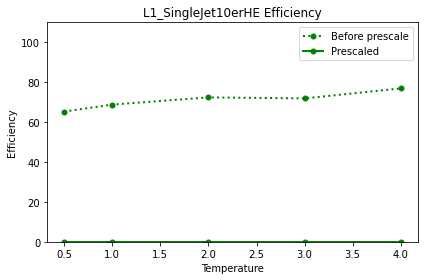

 70%|███████   | 225/321 [03:40<01:25,  1.12it/s]

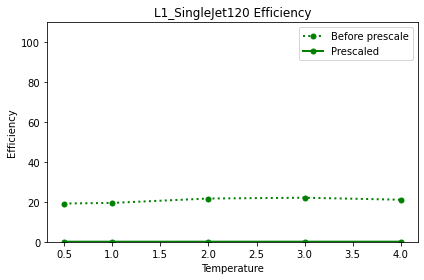

 70%|███████   | 226/321 [03:41<01:18,  1.21it/s]

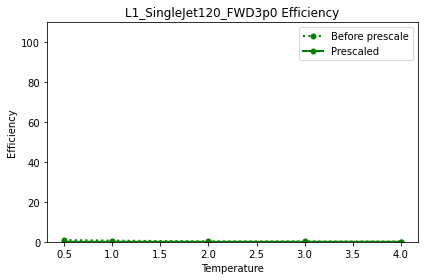

 71%|███████   | 227/321 [03:42<01:15,  1.25it/s]

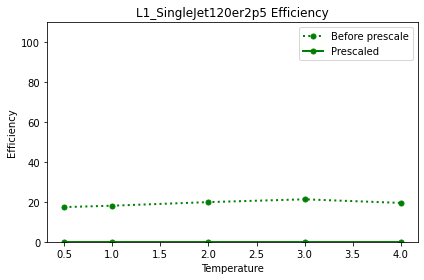

 71%|███████   | 228/321 [03:42<01:07,  1.37it/s]

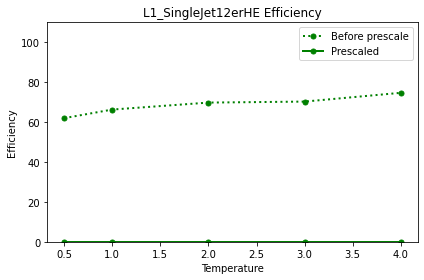

 71%|███████▏  | 229/321 [03:43<01:09,  1.33it/s]

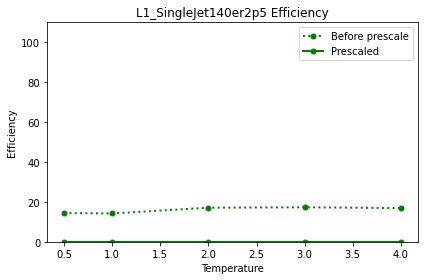

 72%|███████▏  | 230/321 [03:44<01:06,  1.37it/s]

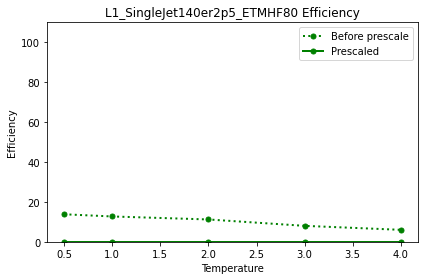

 72%|███████▏  | 231/321 [03:44<01:02,  1.44it/s]

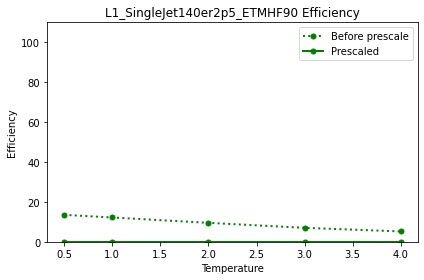

 72%|███████▏  | 232/321 [03:45<01:07,  1.32it/s]

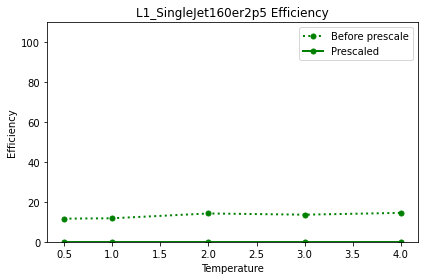

 73%|███████▎  | 233/321 [03:46<01:07,  1.31it/s]

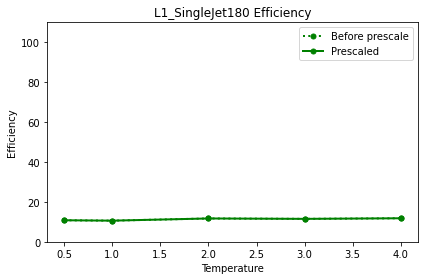

 73%|███████▎  | 234/321 [03:47<01:06,  1.32it/s]

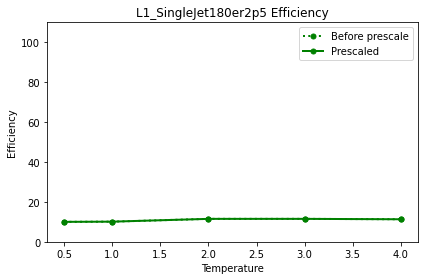

 73%|███████▎  | 235/321 [03:48<01:06,  1.28it/s]

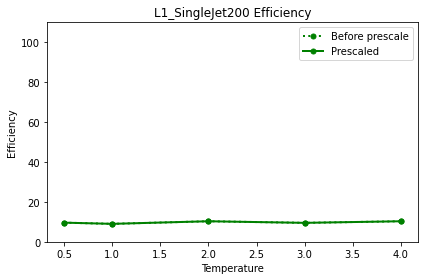

 74%|███████▎  | 236/321 [03:48<01:01,  1.37it/s]

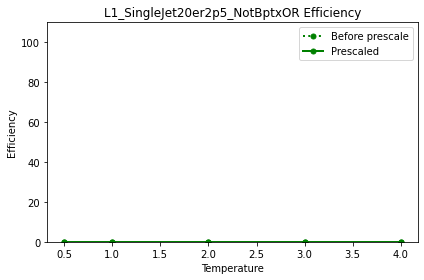

 74%|███████▍  | 237/321 [03:49<01:11,  1.18it/s]

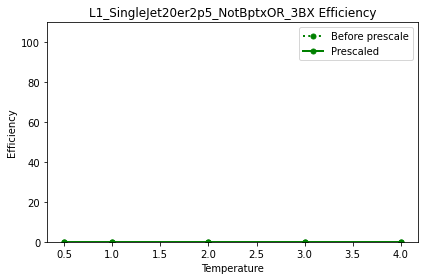

 74%|███████▍  | 238/321 [03:50<01:04,  1.29it/s]

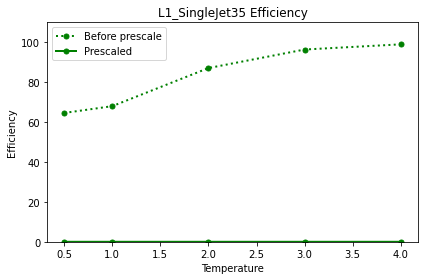

 74%|███████▍  | 239/321 [03:51<01:04,  1.27it/s]

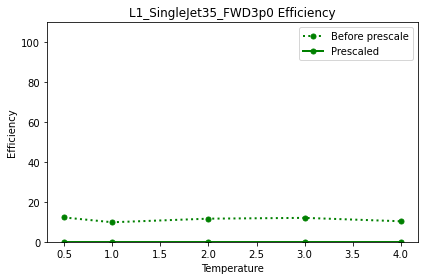

 75%|███████▍  | 240/321 [03:51<01:02,  1.30it/s]

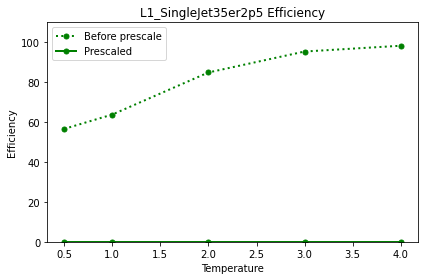

 75%|███████▌  | 241/321 [03:52<01:03,  1.27it/s]

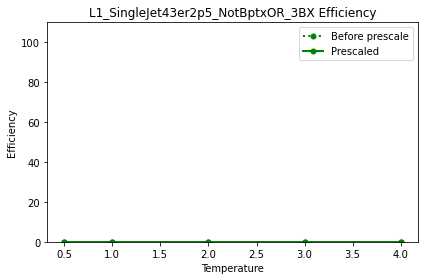

 75%|███████▌  | 242/321 [03:53<01:06,  1.20it/s]

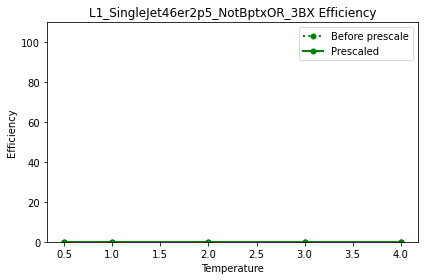

 76%|███████▌  | 243/321 [03:54<01:04,  1.20it/s]

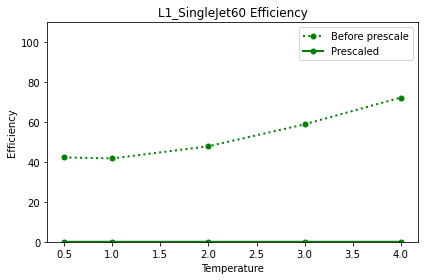

 76%|███████▌  | 244/321 [03:55<00:59,  1.30it/s]

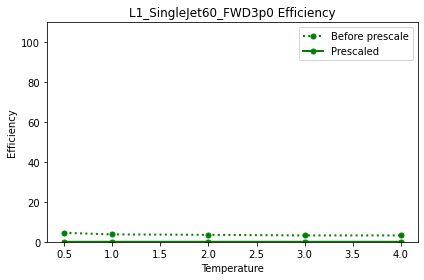

 76%|███████▋  | 245/321 [03:55<00:53,  1.41it/s]

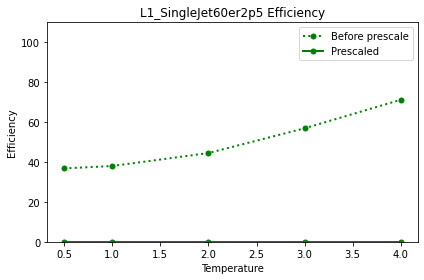

 77%|███████▋  | 246/321 [03:56<00:51,  1.47it/s]

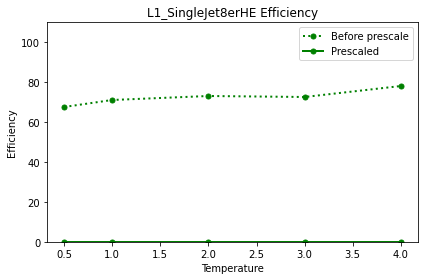

 77%|███████▋  | 247/321 [03:57<00:54,  1.36it/s]

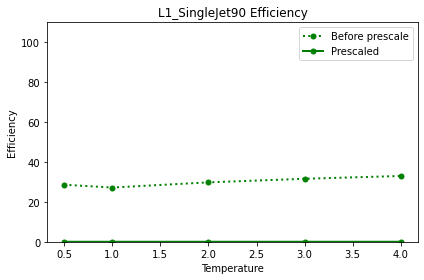

 77%|███████▋  | 248/321 [03:57<00:48,  1.51it/s]

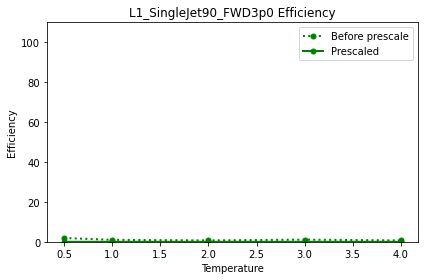

 78%|███████▊  | 249/321 [03:58<00:48,  1.47it/s]

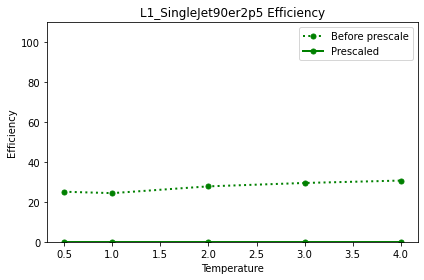

 78%|███████▊  | 250/321 [03:59<00:50,  1.42it/s]

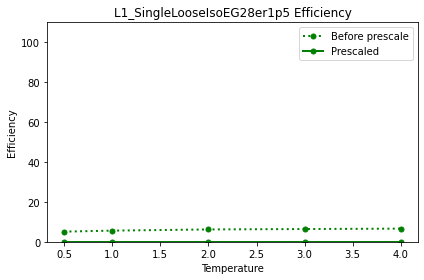

 78%|███████▊  | 251/321 [03:59<00:46,  1.51it/s]

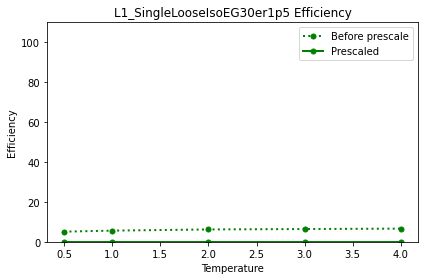

 79%|███████▊  | 252/321 [04:00<00:44,  1.55it/s]

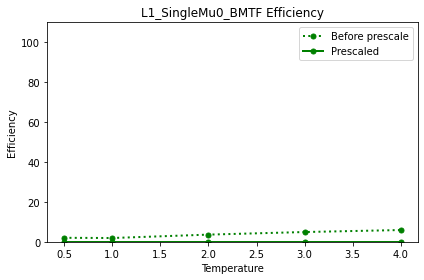

 79%|███████▉  | 253/321 [04:00<00:41,  1.62it/s]

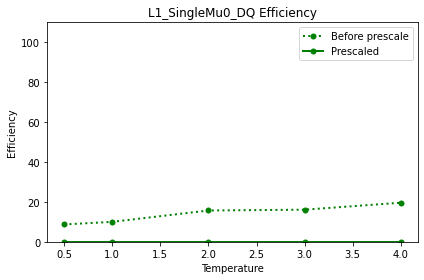

 79%|███████▉  | 254/321 [04:01<00:43,  1.54it/s]

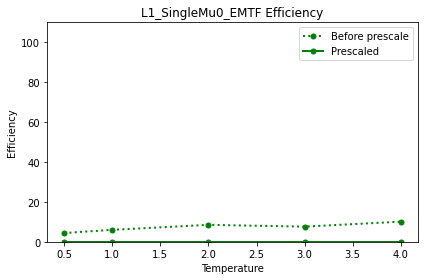

 79%|███████▉  | 255/321 [04:02<00:43,  1.50it/s]

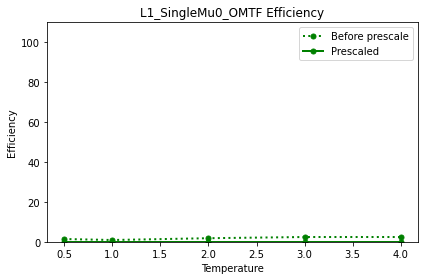

 80%|███████▉  | 256/321 [04:03<00:45,  1.42it/s]

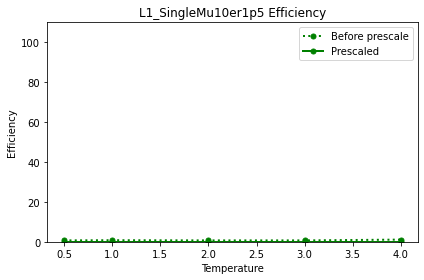

 80%|████████  | 257/321 [04:03<00:44,  1.45it/s]

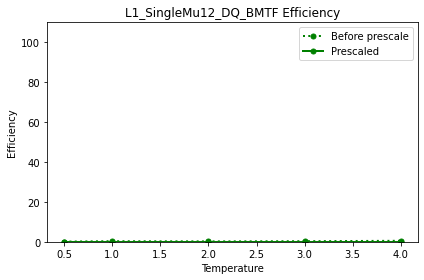

 80%|████████  | 258/321 [04:05<01:02,  1.00it/s]

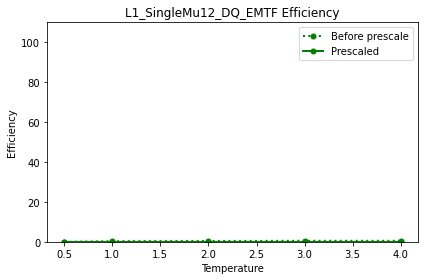

 81%|████████  | 259/321 [04:06<00:57,  1.07it/s]

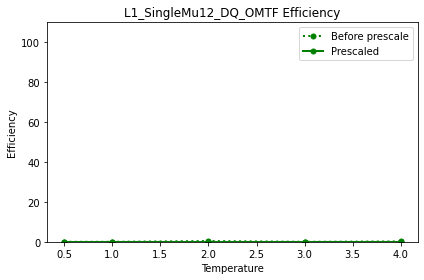

 81%|████████  | 260/321 [04:07<00:57,  1.07it/s]

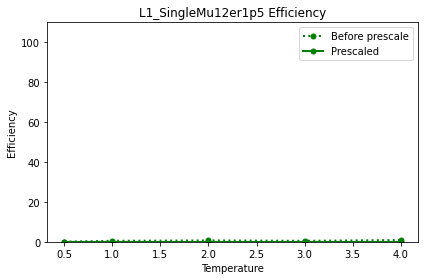

 81%|████████▏ | 261/321 [04:07<00:51,  1.16it/s]

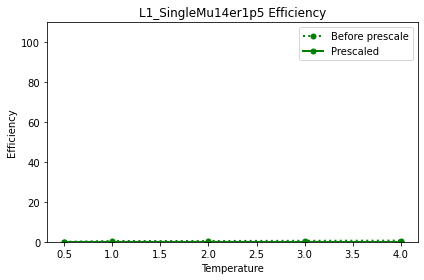

 82%|████████▏ | 262/321 [04:08<00:47,  1.25it/s]

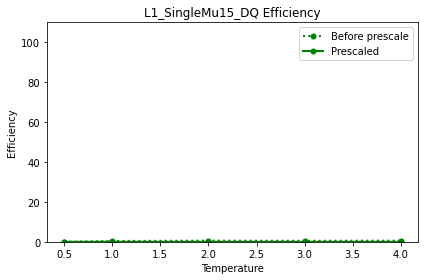

 82%|████████▏ | 263/321 [04:09<00:47,  1.23it/s]

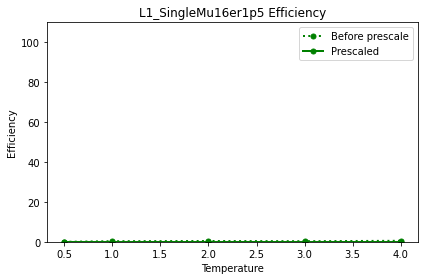

 82%|████████▏ | 264/321 [04:09<00:41,  1.38it/s]

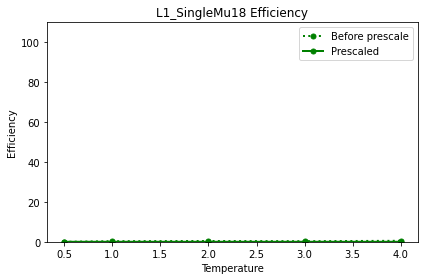

 83%|████████▎ | 265/321 [04:10<00:40,  1.37it/s]

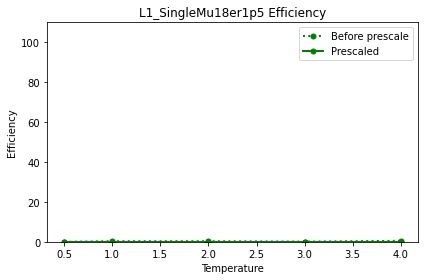

 83%|████████▎ | 266/321 [04:11<00:39,  1.38it/s]

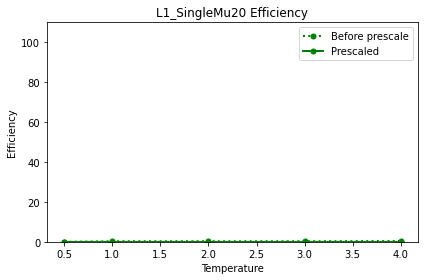

 83%|████████▎ | 267/321 [04:11<00:36,  1.46it/s]

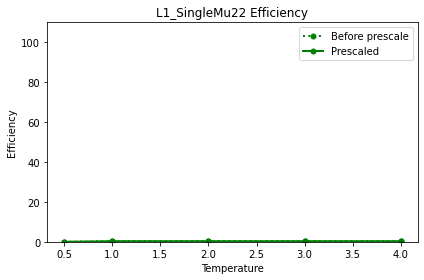

 83%|████████▎ | 268/321 [04:12<00:35,  1.50it/s]

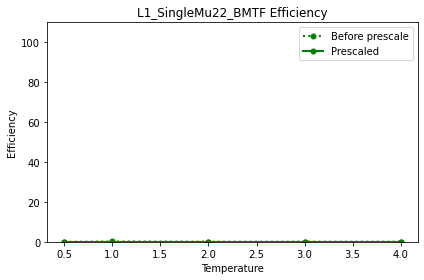

 84%|████████▍ | 269/321 [04:13<00:35,  1.47it/s]

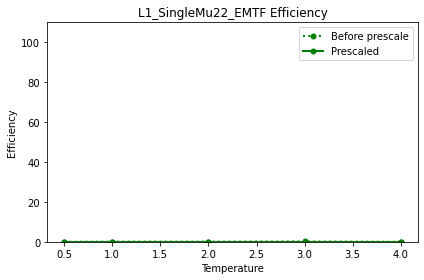

 84%|████████▍ | 270/321 [04:14<00:36,  1.39it/s]

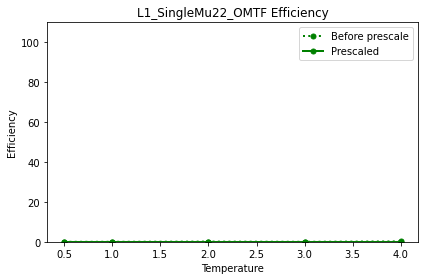

 84%|████████▍ | 271/321 [04:14<00:35,  1.40it/s]

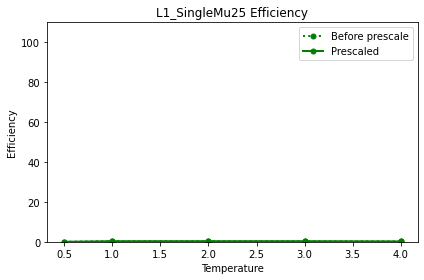

 85%|████████▍ | 272/321 [04:15<00:33,  1.46it/s]

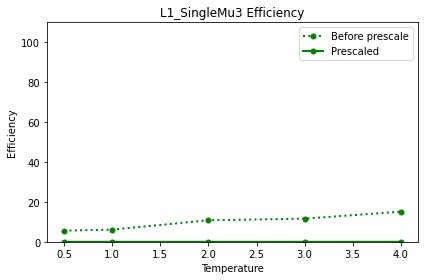

 85%|████████▌ | 273/321 [04:16<00:36,  1.30it/s]

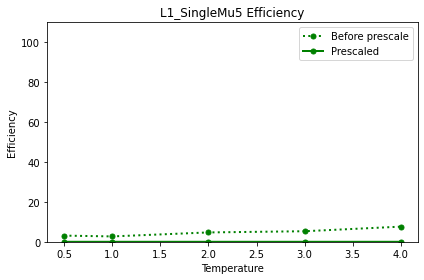

 85%|████████▌ | 274/321 [04:17<00:34,  1.37it/s]

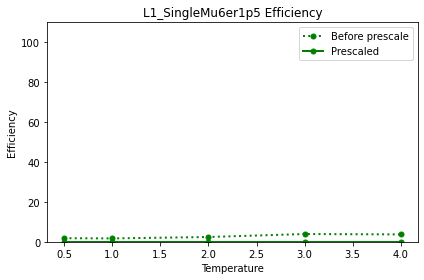

 86%|████████▌ | 275/321 [04:19<00:55,  1.21s/it]

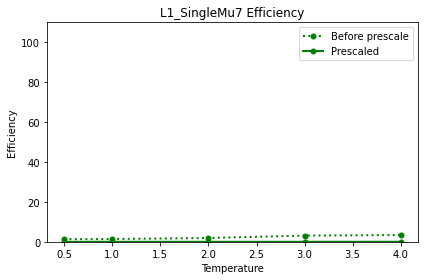

 86%|████████▌ | 276/321 [04:20<00:47,  1.07s/it]

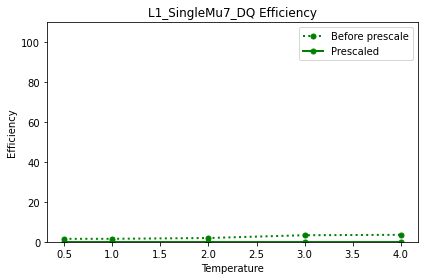

 86%|████████▋ | 277/321 [04:21<00:45,  1.04s/it]

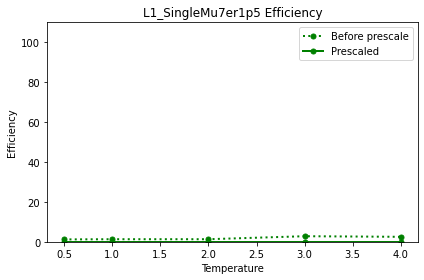

 87%|████████▋ | 278/321 [04:21<00:38,  1.12it/s]

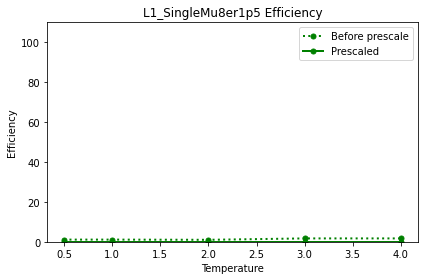

 87%|████████▋ | 279/321 [04:22<00:33,  1.26it/s]

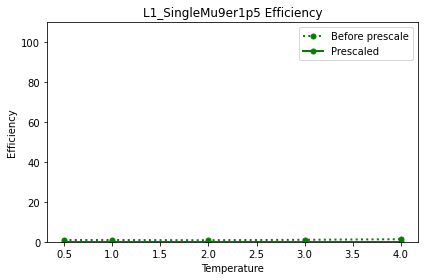

 87%|████████▋ | 280/321 [04:22<00:29,  1.37it/s]

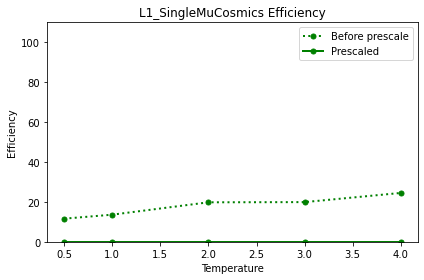

 88%|████████▊ | 281/321 [04:23<00:28,  1.42it/s]

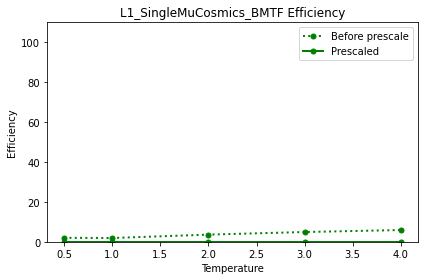

 88%|████████▊ | 282/321 [04:24<00:31,  1.24it/s]

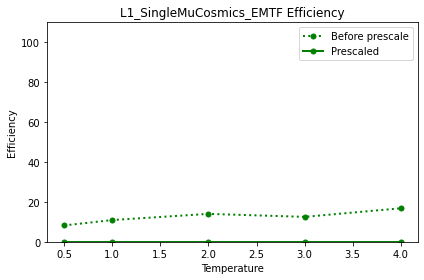

 88%|████████▊ | 283/321 [04:25<00:32,  1.16it/s]

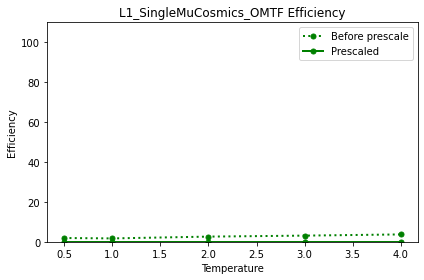

 88%|████████▊ | 284/321 [04:26<00:29,  1.27it/s]

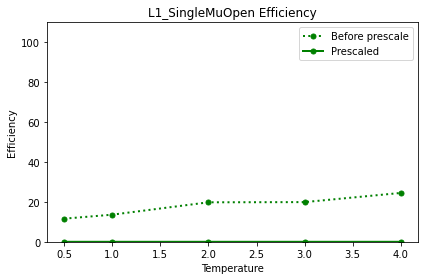

 89%|████████▉ | 285/321 [04:26<00:28,  1.27it/s]

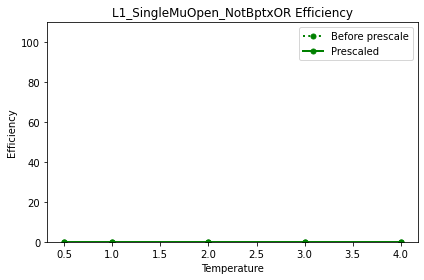

 89%|████████▉ | 286/321 [04:27<00:29,  1.18it/s]

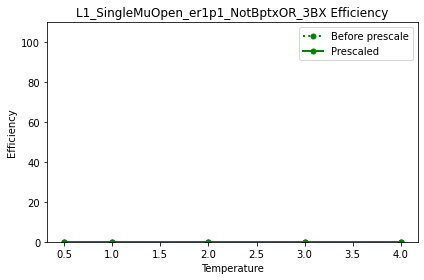

 89%|████████▉ | 287/321 [04:28<00:26,  1.29it/s]

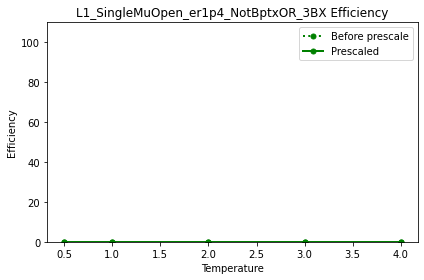

 90%|████████▉ | 288/321 [04:29<00:24,  1.36it/s]

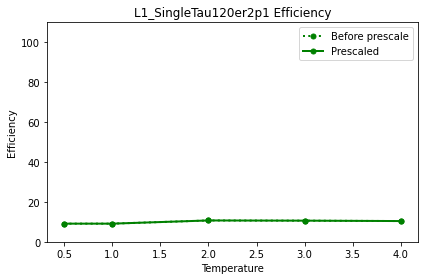

 90%|█████████ | 289/321 [04:29<00:22,  1.42it/s]

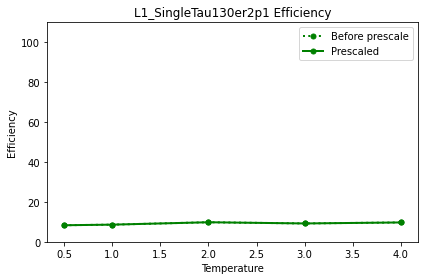

 90%|█████████ | 290/321 [04:30<00:22,  1.40it/s]

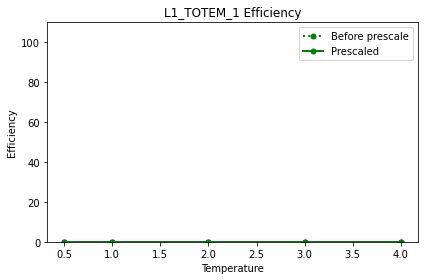

 91%|█████████ | 291/321 [04:30<00:19,  1.51it/s]

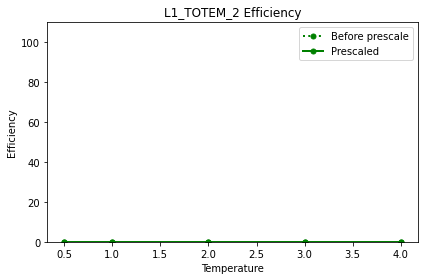

 91%|█████████ | 292/321 [04:31<00:17,  1.63it/s]

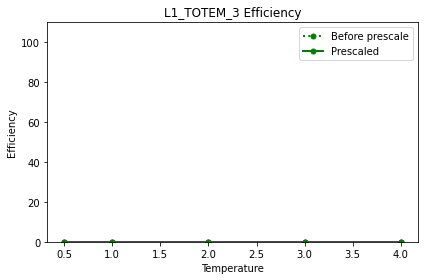

 91%|█████████▏| 293/321 [04:32<00:18,  1.50it/s]

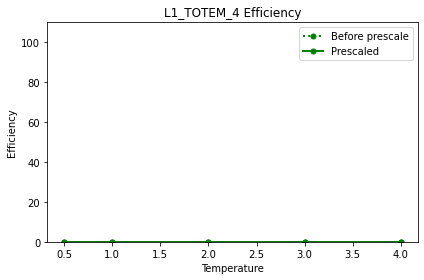

 92%|█████████▏| 294/321 [04:32<00:17,  1.53it/s]

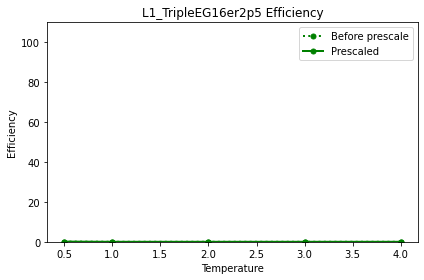

 92%|█████████▏| 295/321 [04:33<00:16,  1.61it/s]

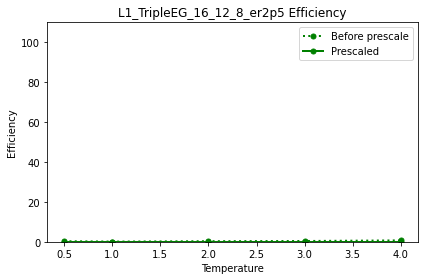

 92%|█████████▏| 296/321 [04:34<00:18,  1.39it/s]

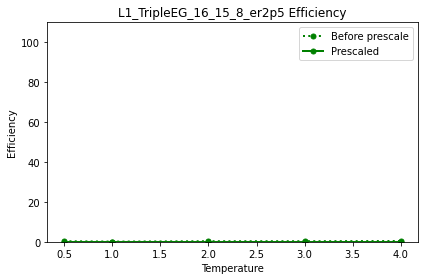

 93%|█████████▎| 297/321 [04:35<00:17,  1.41it/s]

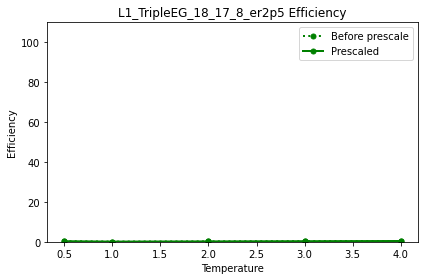

 93%|█████████▎| 298/321 [04:35<00:16,  1.41it/s]

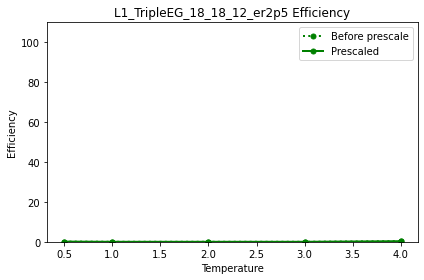

 93%|█████████▎| 299/321 [04:36<00:16,  1.33it/s]

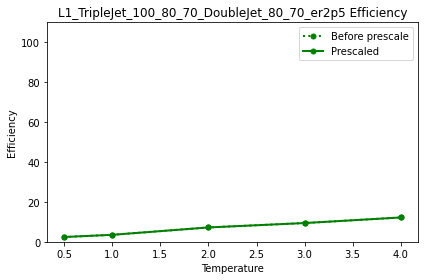

 93%|█████████▎| 300/321 [04:37<00:17,  1.18it/s]

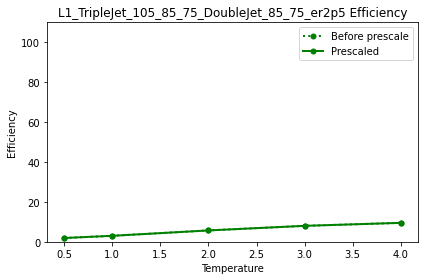

 94%|█████████▍| 301/321 [04:38<00:17,  1.14it/s]

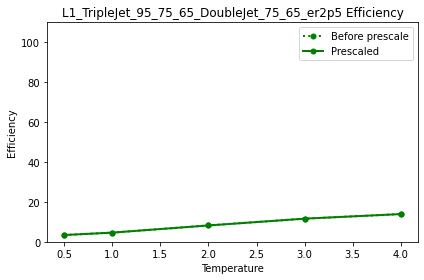

 94%|█████████▍| 302/321 [04:39<00:16,  1.18it/s]

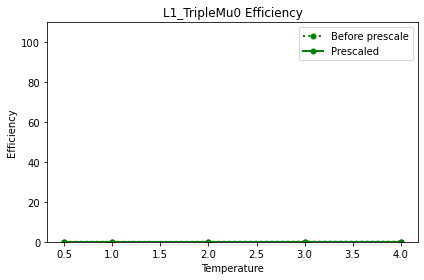

 94%|█████████▍| 303/321 [04:40<00:15,  1.17it/s]

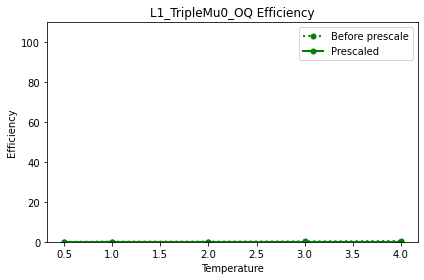

 95%|█████████▍| 304/321 [04:41<00:18,  1.08s/it]

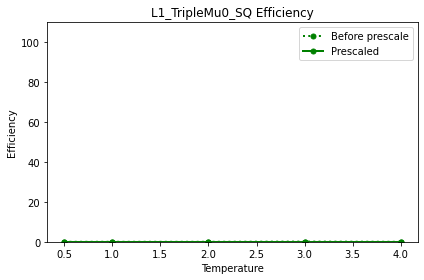

 95%|█████████▌| 305/321 [04:42<00:15,  1.05it/s]

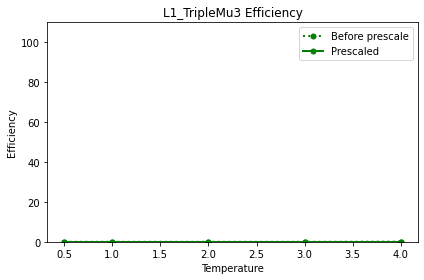

 95%|█████████▌| 306/321 [04:43<00:12,  1.16it/s]

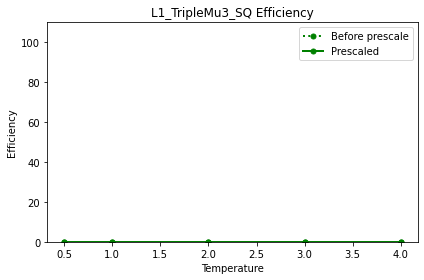

 96%|█████████▌| 307/321 [04:43<00:11,  1.21it/s]

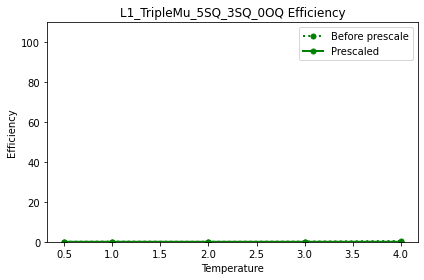

 96%|█████████▌| 308/321 [04:44<00:10,  1.21it/s]

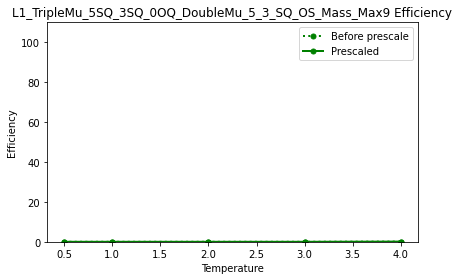

 96%|█████████▋| 309/321 [04:45<00:09,  1.28it/s]

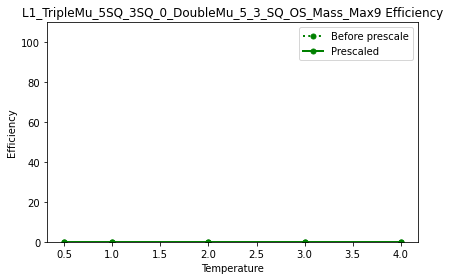

 97%|█████████▋| 310/321 [04:46<00:08,  1.34it/s]

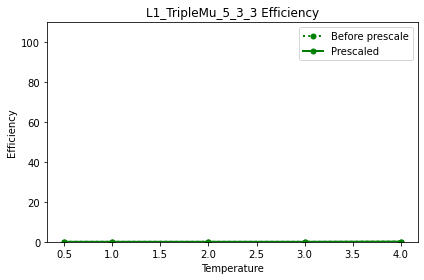

 97%|█████████▋| 311/321 [04:46<00:07,  1.31it/s]

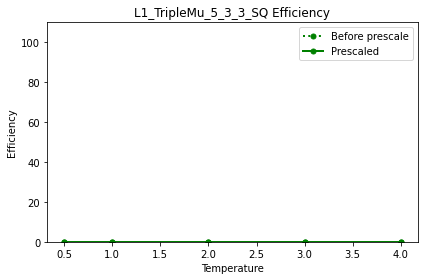

 97%|█████████▋| 312/321 [04:47<00:07,  1.23it/s]

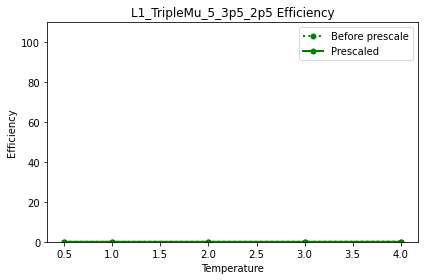

 98%|█████████▊| 313/321 [04:48<00:06,  1.20it/s]

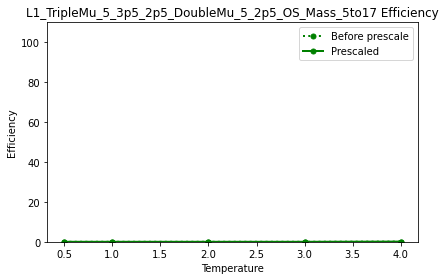

 98%|█████████▊| 314/321 [04:49<00:05,  1.32it/s]

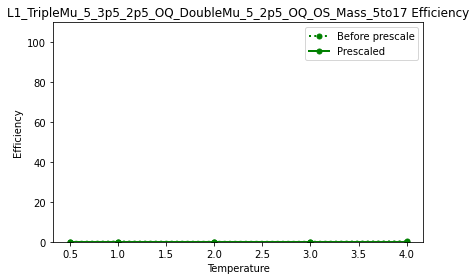

 98%|█████████▊| 315/321 [04:50<00:04,  1.26it/s]

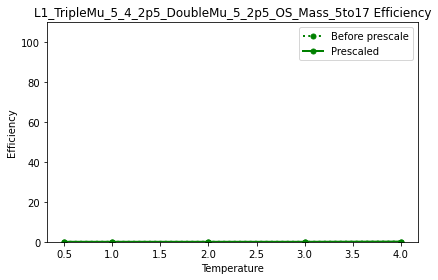

 98%|█████████▊| 316/321 [04:50<00:03,  1.35it/s]

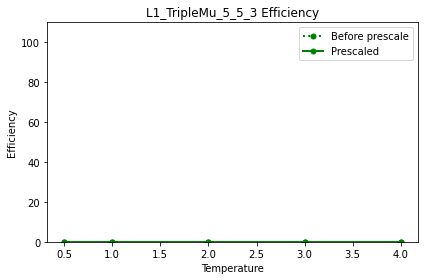

 99%|█████████▉| 317/321 [04:51<00:03,  1.26it/s]

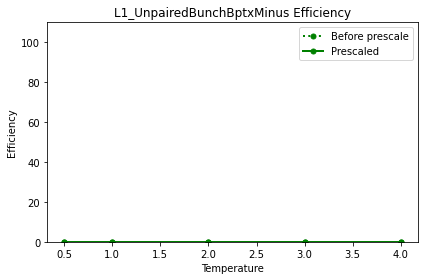

 99%|█████████▉| 318/321 [04:52<00:02,  1.26it/s]

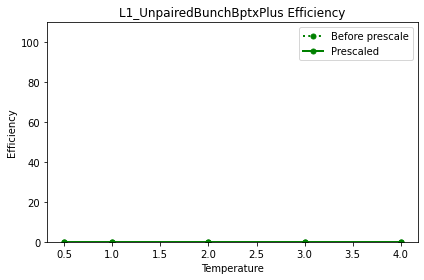

 99%|█████████▉| 319/321 [04:53<00:01,  1.27it/s]

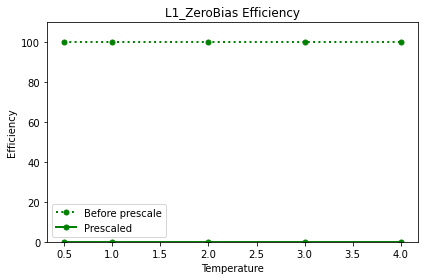

100%|█████████▉| 320/321 [04:53<00:00,  1.36it/s]

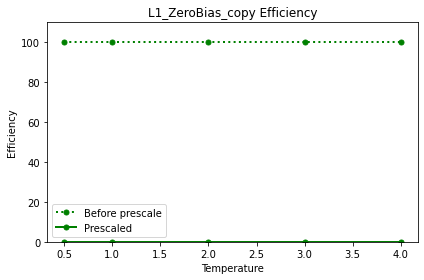

100%|██████████| 321/321 [04:54<00:00,  1.09it/s]


In [43]:
print('creating plots of trigger efficiencies.')
for trigger in tqdm(dic_trigger['0.5']):
    if trigger in list(data['Name']):
        PS = data.loc[data['Name'] == trigger, '2p20E+34'].values[0]
    else:
        PS = 0.0
    is_triggered_t0p5=dic_trigger['0.5'][trigger]
    ratio_t0p5=is_triggered_t0p5.sum()/len(is_triggered_t0p5)*100.0
    ratio_t0p5_prescaled=ratio_t0p5/PS if PS>0 else 0.0
    is_triggered_t1=dic_trigger['1'][trigger]
    ratio_t1=is_triggered_t1.sum()/len(is_triggered_t1)*100.0
    ratio_t1_prescaled=ratio_t1/PS if PS>0 else 0.0
    is_triggered_t2=dic_trigger['2'][trigger]
    ratio_t2=is_triggered_t2.sum()/len(is_triggered_t2)*100.0
    ratio_t2_prescaled=ratio_t2/PS if PS>0 else 0.0
    is_triggered_t3=dic_trigger['3'][trigger]
    ratio_t3=is_triggered_t3.sum()/len(is_triggered_t3)*100.0
    ratio_t3_prescaled=ratio_t3/PS if PS>0 else 0.0
    is_triggered_t4=dic_trigger['4'][trigger]
    ratio_t4=is_triggered_t4.sum()/len(is_triggered_t4)*100.0
    ratio_t4_prescaled=ratio_t4/PS if PS>0 else 0.0
    plt.plot([0.5,1,2,3,4],[ratio_t0p5,ratio_t1,ratio_t2,ratio_t3,ratio_t4],color='green', marker='o', linestyle='dotted',
     linewidth=2, markersize=5,label="Before prescale")
    plt.plot([0.5,1,2,3,4],[ratio_t0p5_prescaled,ratio_t1_prescaled,ratio_t2_prescaled,ratio_t3_prescaled,ratio_t4_prescaled],color='green', marker='o', linestyle='solid',
     linewidth=2, markersize=5,label="Prescaled")
    plt.xlabel('Temperature')
    plt.ylabel('Efficiency')
    plt.ylim([0,110])
    plt.title('{} Efficiency'.format(trigger))
    plt.legend()
    plt.tight_layout()
    plt.savefig('eff_temp_HLT/{}_eff.png'.format(trigger))
    plt.savefig('eff_temp_HLT/{}_eff.pdf'.format(trigger))
    plt.show()

creating plots of trigger efficiencies.


  0%|          | 0/321 [00:00<?, ?it/s]

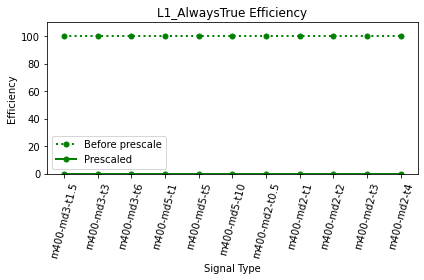

  0%|          | 1/321 [00:00<04:55,  1.08it/s]

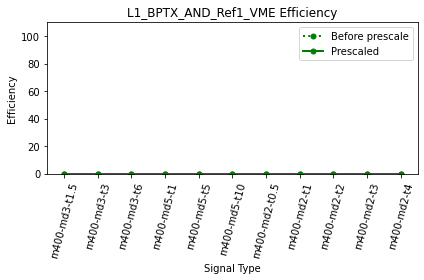

  1%|          | 2/321 [00:01<04:35,  1.16it/s]

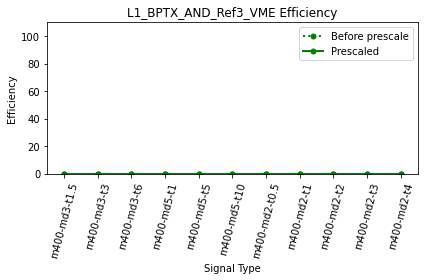

  1%|          | 3/321 [00:02<04:24,  1.20it/s]

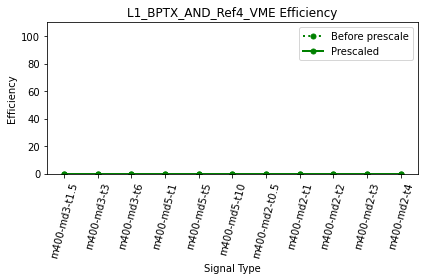

  1%|          | 4/321 [00:07<13:45,  2.61s/it]

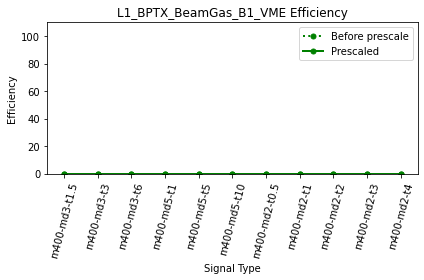

  2%|▏         | 5/321 [00:08<10:01,  1.90s/it]

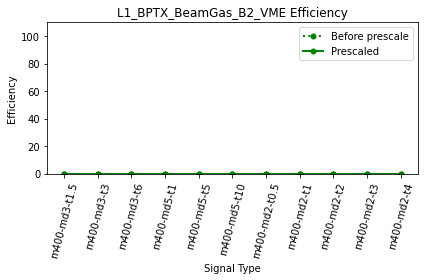

  2%|▏         | 6/321 [00:10<11:00,  2.10s/it]

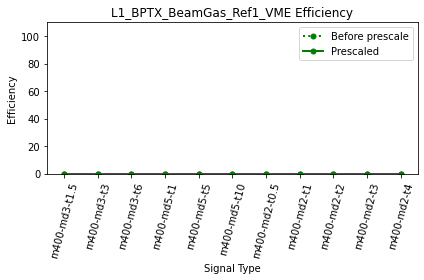

  2%|▏         | 7/321 [00:12<09:19,  1.78s/it]

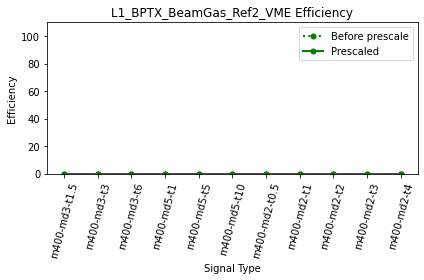

  2%|▏         | 8/321 [00:12<07:37,  1.46s/it]

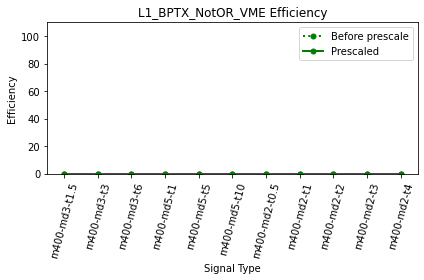

  3%|▎         | 9/321 [00:13<06:58,  1.34s/it]

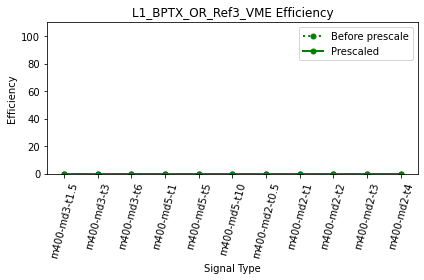

  3%|▎         | 10/321 [00:15<06:29,  1.25s/it]

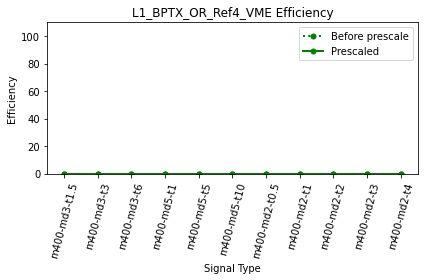

  3%|▎         | 11/321 [00:16<06:00,  1.16s/it]

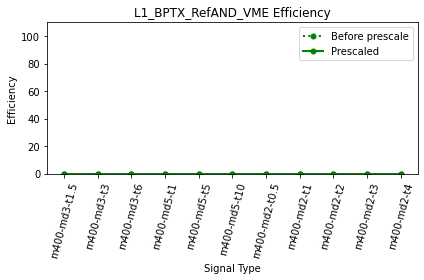

  4%|▎         | 12/321 [00:16<05:20,  1.04s/it]

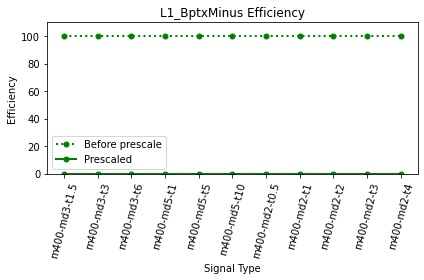

  4%|▍         | 13/321 [00:17<05:22,  1.05s/it]

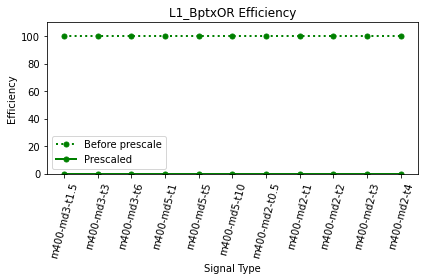

  4%|▍         | 14/321 [00:18<04:47,  1.07it/s]

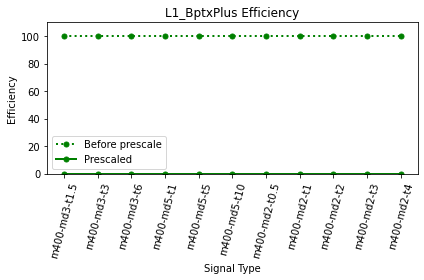

  5%|▍         | 15/321 [00:19<04:31,  1.13it/s]

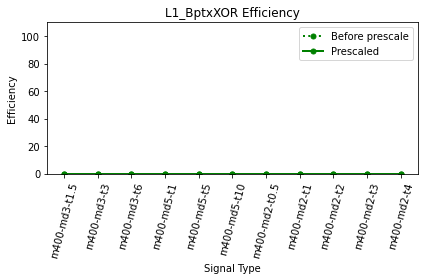

  5%|▍         | 16/321 [00:20<05:19,  1.05s/it]

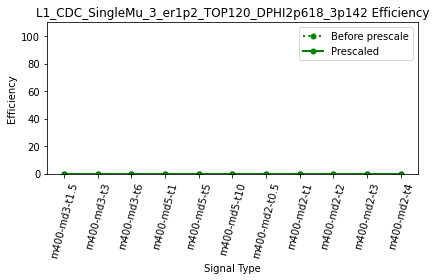

  5%|▌         | 17/321 [00:21<04:59,  1.01it/s]

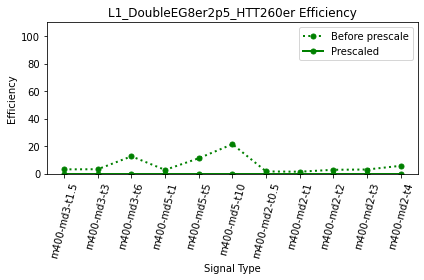

  6%|▌         | 18/321 [00:22<04:27,  1.13it/s]

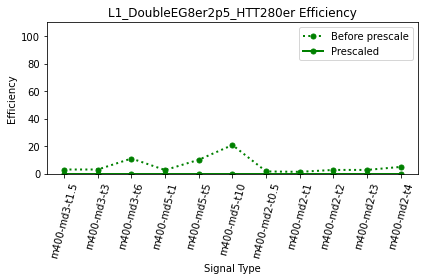

  6%|▌         | 19/321 [00:22<04:18,  1.17it/s]

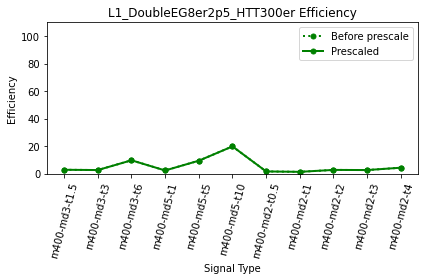

  6%|▌         | 20/321 [00:23<04:07,  1.22it/s]

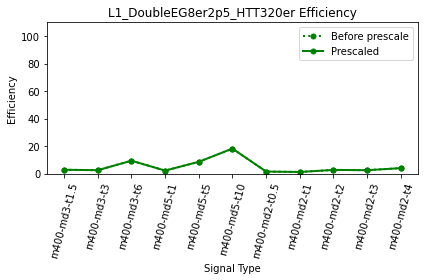

  7%|▋         | 21/321 [00:24<04:08,  1.21it/s]

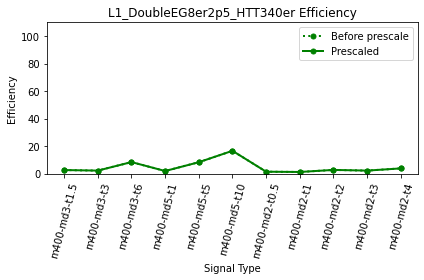

  7%|▋         | 22/321 [00:25<04:07,  1.21it/s]

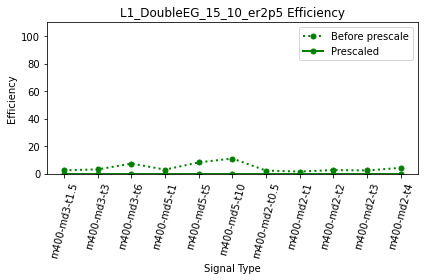

  7%|▋         | 23/321 [00:26<04:28,  1.11it/s]

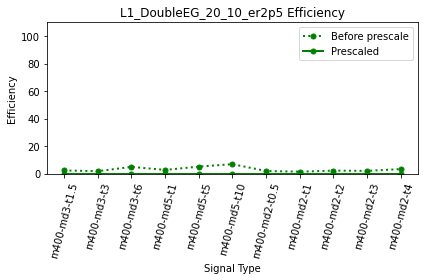

  7%|▋         | 24/321 [00:28<06:23,  1.29s/it]

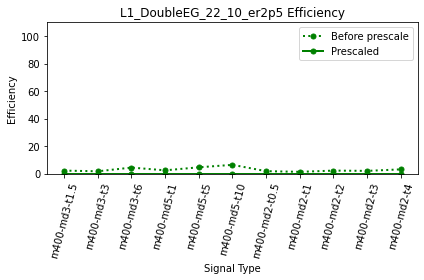

  8%|▊         | 25/321 [00:29<05:18,  1.08s/it]

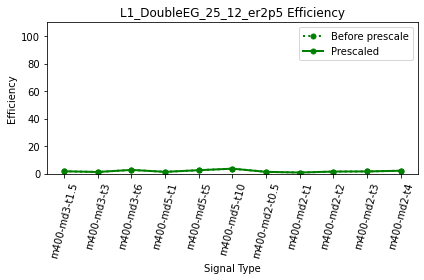

  8%|▊         | 26/321 [00:29<04:42,  1.05it/s]

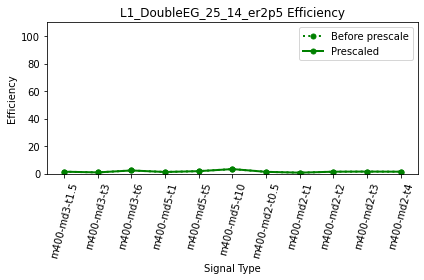

  8%|▊         | 27/321 [00:31<05:44,  1.17s/it]

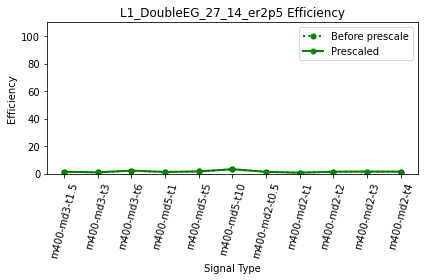

  9%|▊         | 28/321 [00:32<05:07,  1.05s/it]

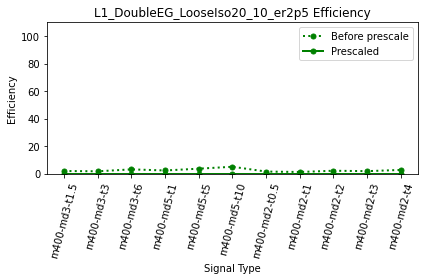

  9%|▉         | 29/321 [00:33<04:51,  1.00it/s]

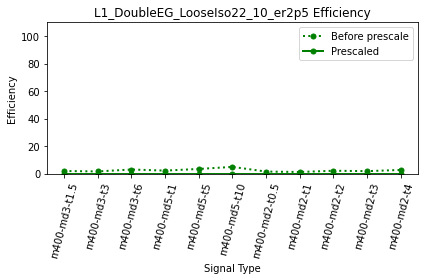

  9%|▉         | 30/321 [00:34<04:44,  1.02it/s]

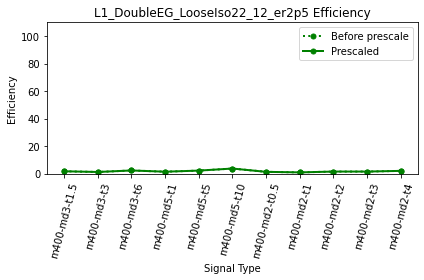

 10%|▉         | 31/321 [00:34<04:17,  1.13it/s]

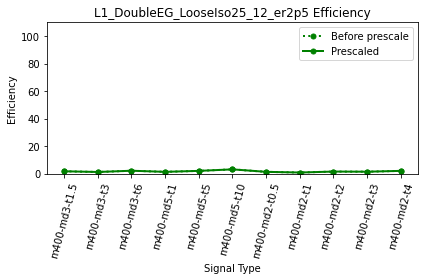

 10%|▉         | 32/321 [00:35<04:15,  1.13it/s]

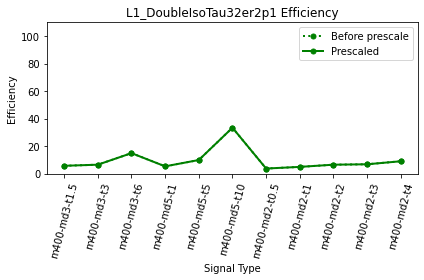

 10%|█         | 33/321 [00:36<04:16,  1.12it/s]

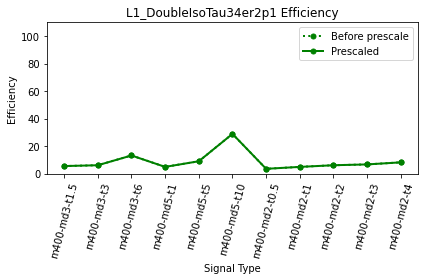

 11%|█         | 34/321 [00:38<05:43,  1.20s/it]

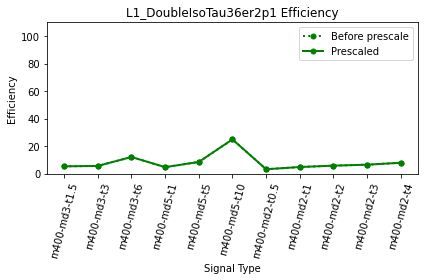

 11%|█         | 35/321 [00:39<05:11,  1.09s/it]

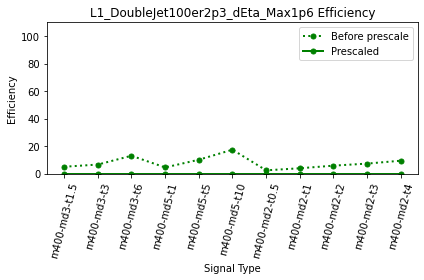

 11%|█         | 36/321 [00:40<05:11,  1.09s/it]

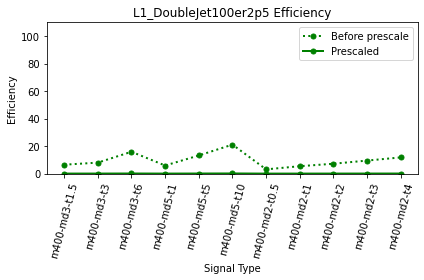

 12%|█▏        | 37/321 [00:41<04:52,  1.03s/it]

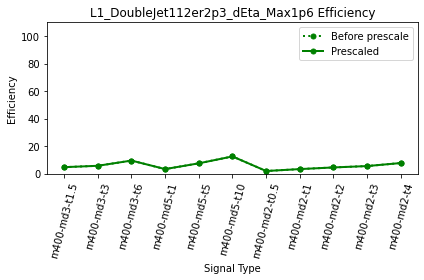

 12%|█▏        | 38/321 [00:42<04:20,  1.09it/s]

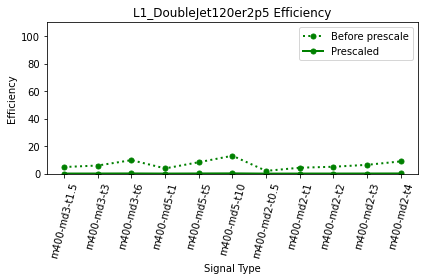

 12%|█▏        | 39/321 [00:43<04:34,  1.03it/s]

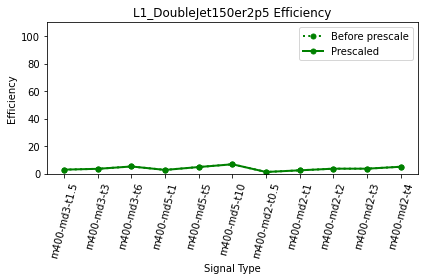

 12%|█▏        | 40/321 [00:43<04:10,  1.12it/s]

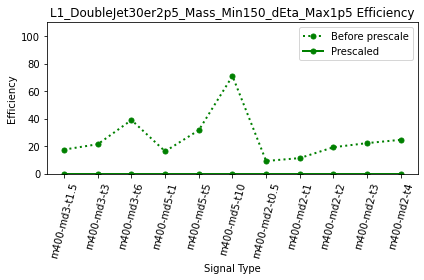

 13%|█▎        | 41/321 [00:45<04:58,  1.07s/it]

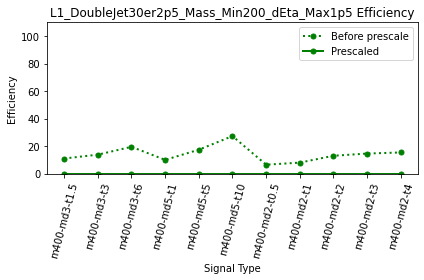

 13%|█▎        | 42/321 [00:46<04:29,  1.04it/s]

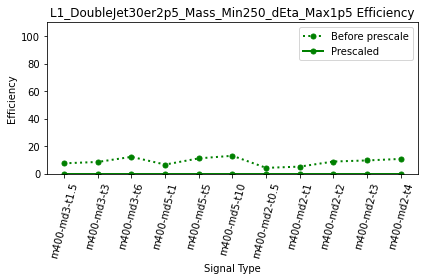

 13%|█▎        | 43/321 [00:55<16:04,  3.47s/it]

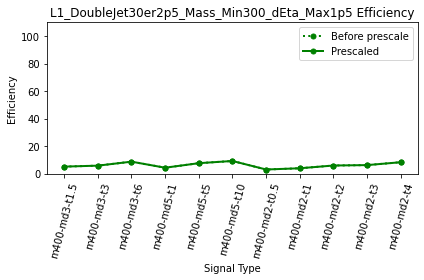

 14%|█▎        | 44/321 [00:56<12:20,  2.67s/it]

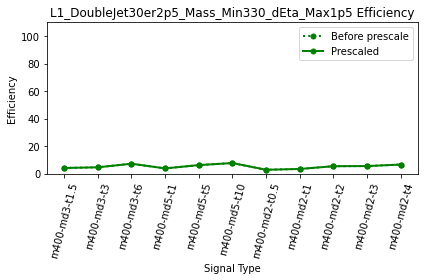

 14%|█▍        | 45/321 [00:56<09:42,  2.11s/it]

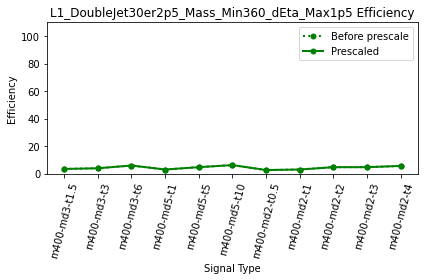

 14%|█▍        | 46/321 [00:57<07:43,  1.69s/it]

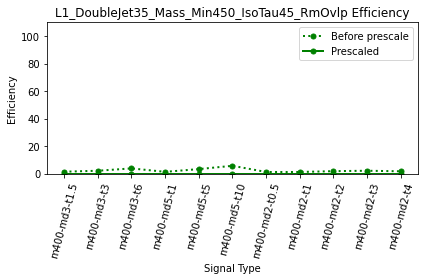

 15%|█▍        | 47/321 [00:58<06:22,  1.40s/it]

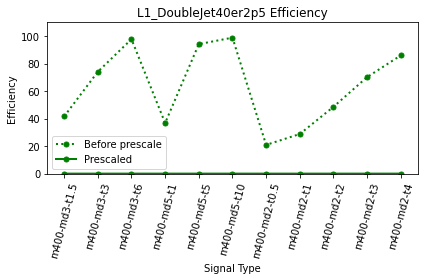

 15%|█▍        | 48/321 [00:59<05:58,  1.31s/it]

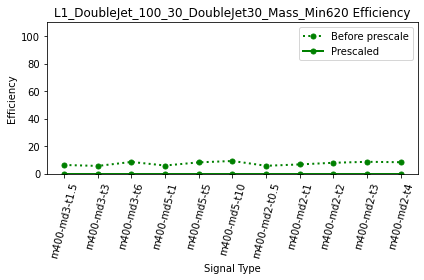

 15%|█▌        | 49/321 [01:00<05:14,  1.16s/it]

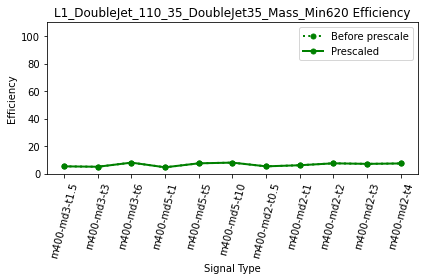

 16%|█▌        | 50/321 [01:00<04:38,  1.03s/it]

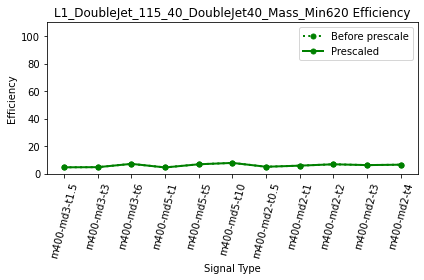

 16%|█▌        | 51/321 [01:01<04:06,  1.10it/s]

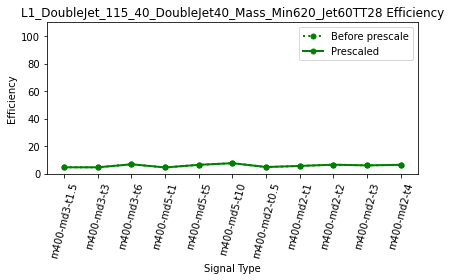

 16%|█▌        | 52/321 [01:02<03:58,  1.13it/s]

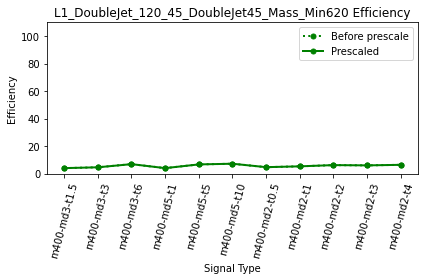

 17%|█▋        | 53/321 [01:03<03:47,  1.18it/s]

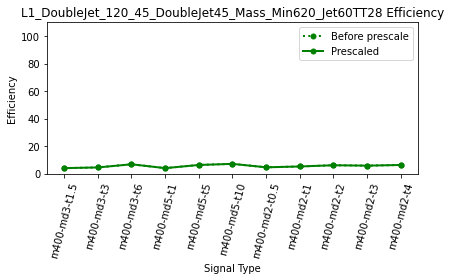

 17%|█▋        | 54/321 [01:04<03:42,  1.20it/s]

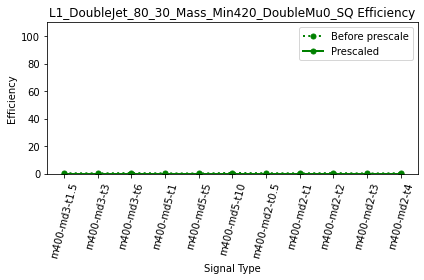

 17%|█▋        | 55/321 [01:04<03:46,  1.18it/s]

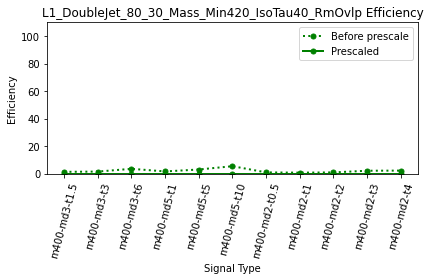

 17%|█▋        | 56/321 [01:05<03:35,  1.23it/s]

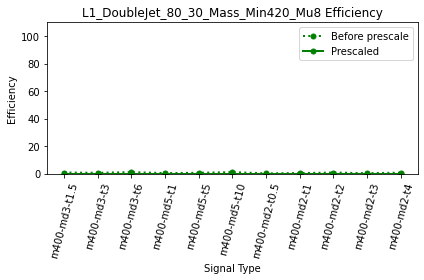

 18%|█▊        | 57/321 [01:06<03:59,  1.10it/s]

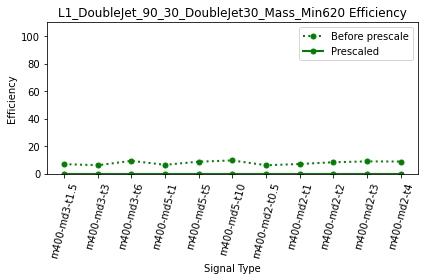

 18%|█▊        | 58/321 [01:07<03:42,  1.18it/s]

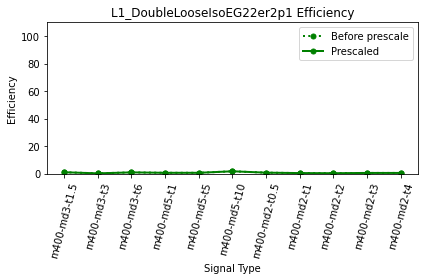

 18%|█▊        | 59/321 [01:08<03:31,  1.24it/s]

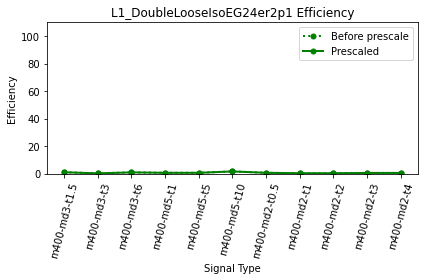

 19%|█▊        | 60/321 [01:09<03:50,  1.13it/s]

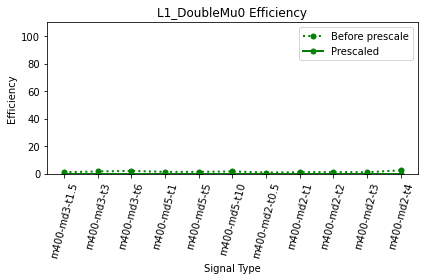

 19%|█▉        | 61/321 [01:10<03:56,  1.10it/s]

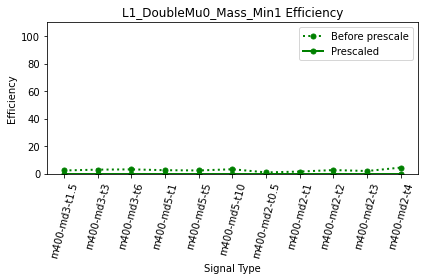

 19%|█▉        | 62/321 [01:10<03:39,  1.18it/s]

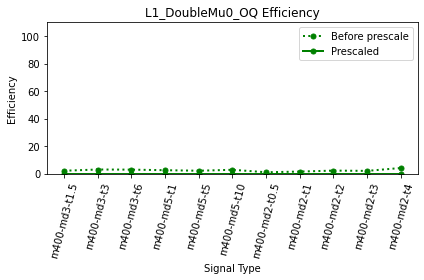

 20%|█▉        | 63/321 [01:11<03:42,  1.16it/s]

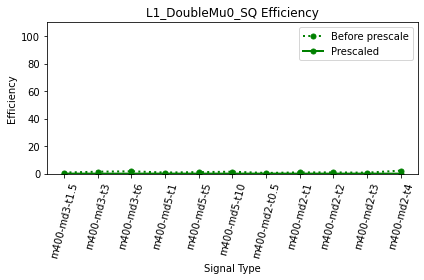

 20%|█▉        | 64/321 [01:27<22:43,  5.31s/it]

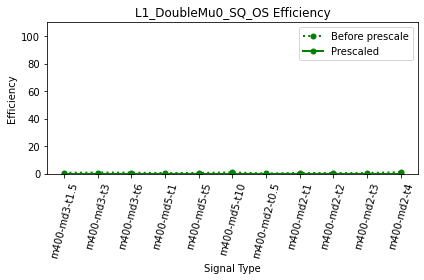

 20%|██        | 65/321 [01:28<17:01,  3.99s/it]

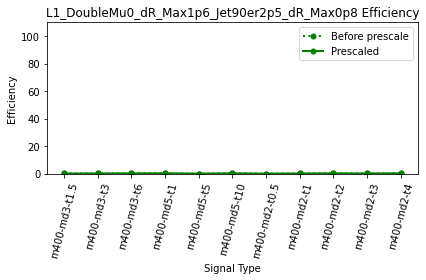

 21%|██        | 66/321 [01:29<13:05,  3.08s/it]

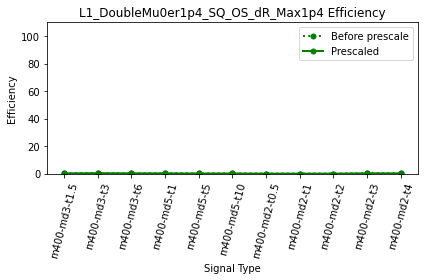

 21%|██        | 67/321 [01:36<17:43,  4.19s/it]

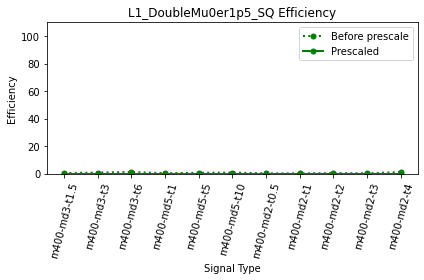

 21%|██        | 68/321 [01:36<13:20,  3.16s/it]

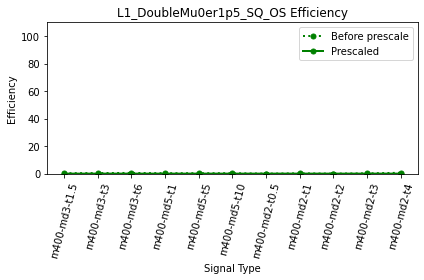

 21%|██▏       | 69/321 [01:38<10:45,  2.56s/it]

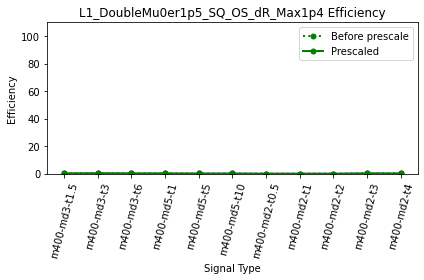

 22%|██▏       | 70/321 [01:38<08:20,  2.00s/it]

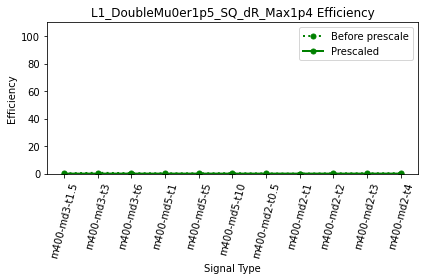

 22%|██▏       | 71/321 [01:39<06:58,  1.68s/it]

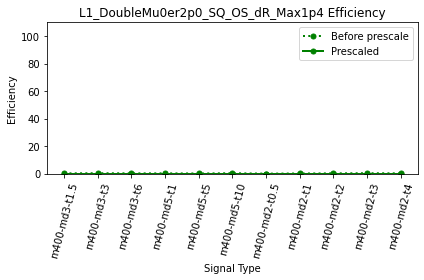

 22%|██▏       | 72/321 [01:40<05:51,  1.41s/it]

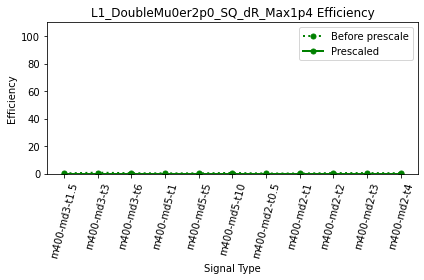

 23%|██▎       | 73/321 [01:41<05:28,  1.32s/it]

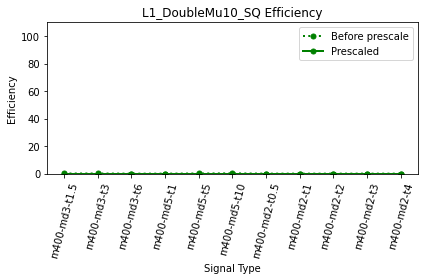

 23%|██▎       | 74/321 [01:42<04:44,  1.15s/it]

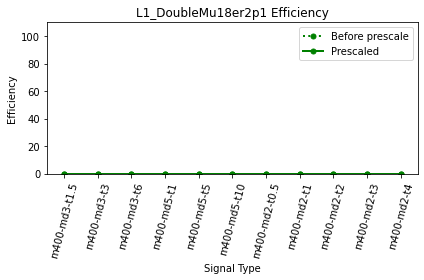

 23%|██▎       | 75/321 [01:43<04:20,  1.06s/it]

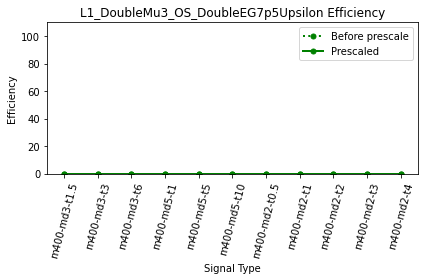

 24%|██▎       | 76/321 [01:43<04:01,  1.01it/s]

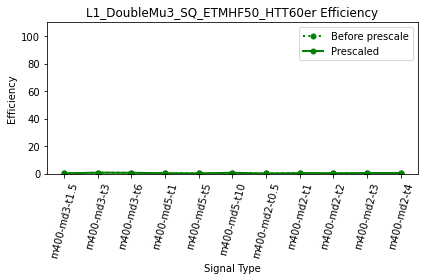

 24%|██▍       | 77/321 [01:45<04:15,  1.05s/it]

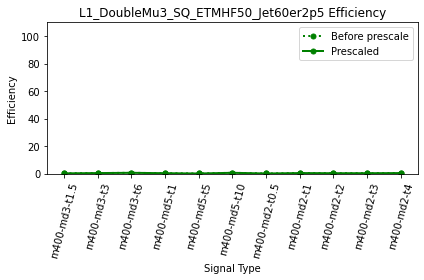

 24%|██▍       | 78/321 [01:45<03:44,  1.08it/s]

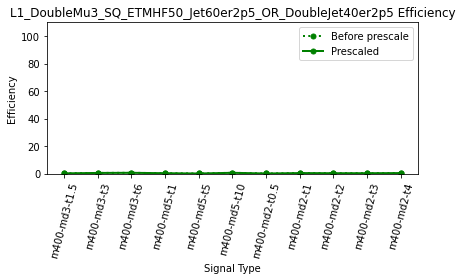

 25%|██▍       | 79/321 [01:46<03:44,  1.08it/s]

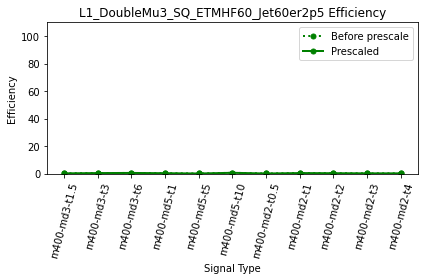

 25%|██▍       | 80/321 [01:47<03:55,  1.02it/s]

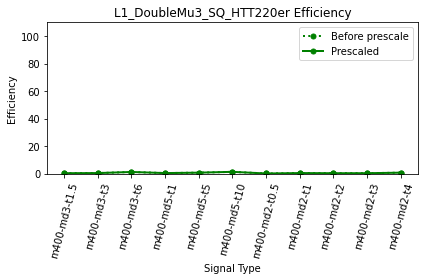

 25%|██▌       | 81/321 [01:49<05:07,  1.28s/it]

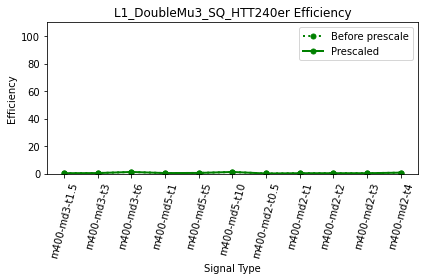

 26%|██▌       | 82/321 [01:50<04:28,  1.12s/it]

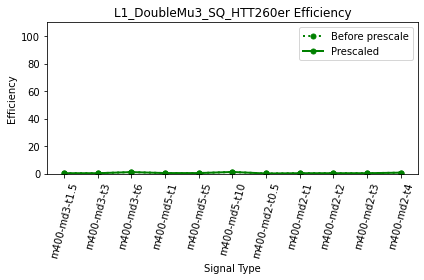

 26%|██▌       | 83/321 [01:51<03:58,  1.00s/it]

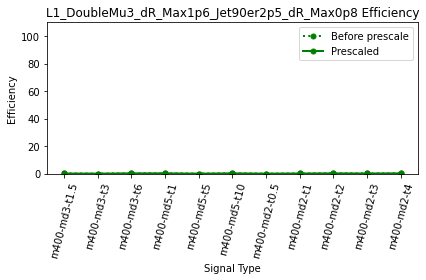

 26%|██▌       | 84/321 [01:51<03:31,  1.12it/s]

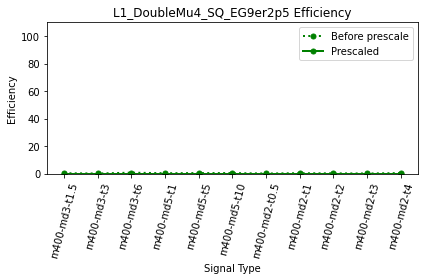

 26%|██▋       | 85/321 [01:52<03:26,  1.14it/s]

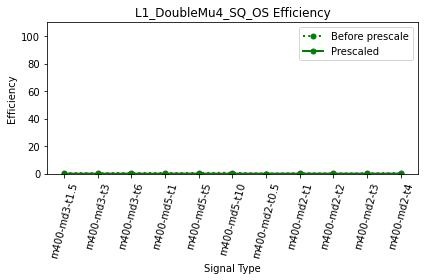

 27%|██▋       | 86/321 [01:53<03:06,  1.26it/s]

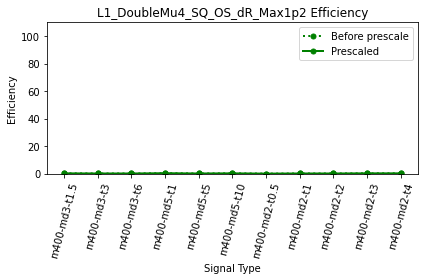

 27%|██▋       | 87/321 [01:54<02:57,  1.32it/s]

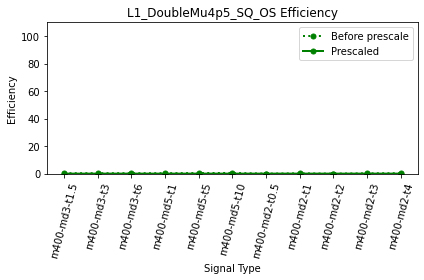

 27%|██▋       | 88/321 [01:54<02:55,  1.33it/s]

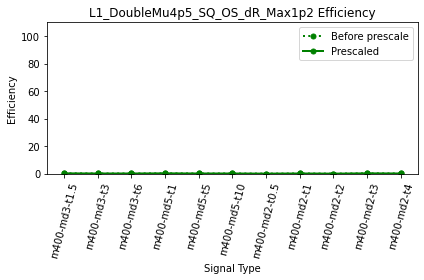

 28%|██▊       | 89/321 [01:55<02:44,  1.41it/s]

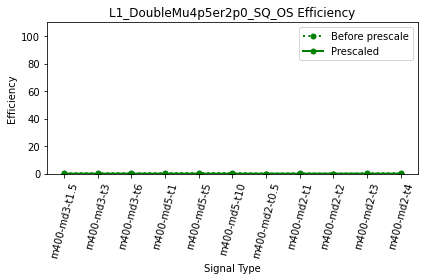

 28%|██▊       | 90/321 [01:57<03:50,  1.00it/s]

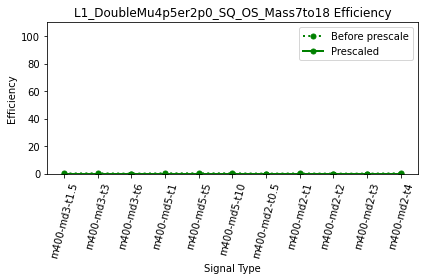

 28%|██▊       | 91/321 [01:57<03:28,  1.10it/s]

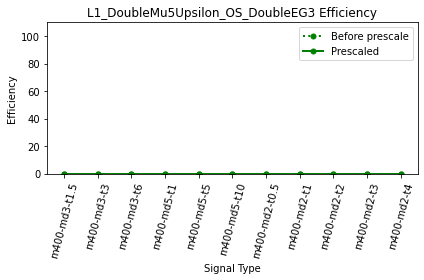

 29%|██▊       | 92/321 [01:58<03:10,  1.20it/s]

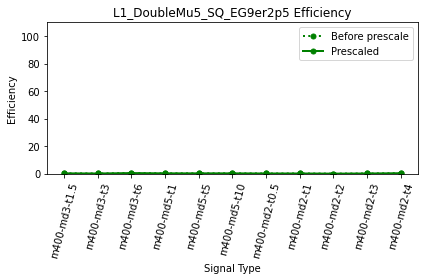

 29%|██▉       | 93/321 [01:59<02:56,  1.29it/s]

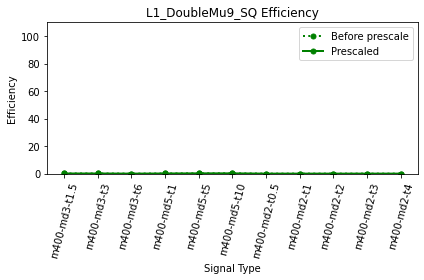

 29%|██▉       | 94/321 [01:59<02:52,  1.32it/s]

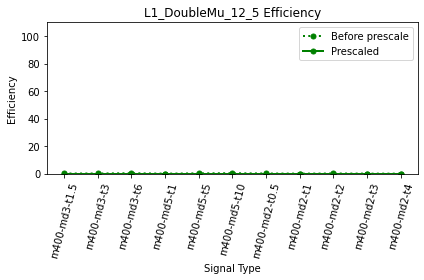

 30%|██▉       | 95/321 [02:00<02:44,  1.38it/s]

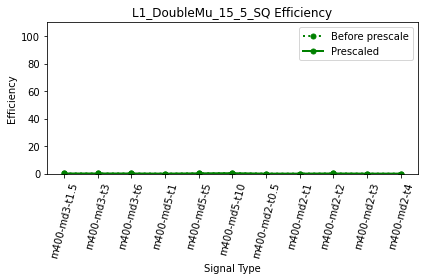

 30%|██▉       | 96/321 [02:01<02:44,  1.37it/s]

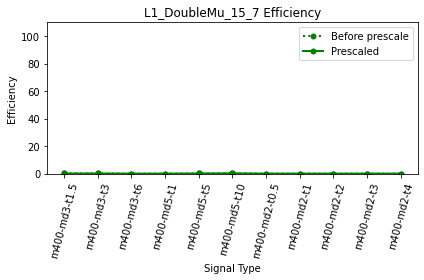

 30%|███       | 97/321 [02:01<02:47,  1.34it/s]

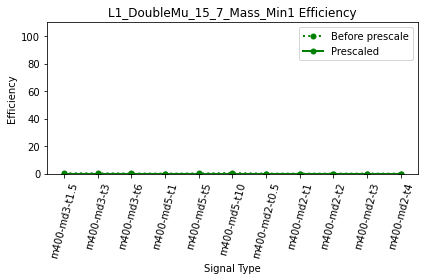

 31%|███       | 98/321 [02:02<02:32,  1.46it/s]

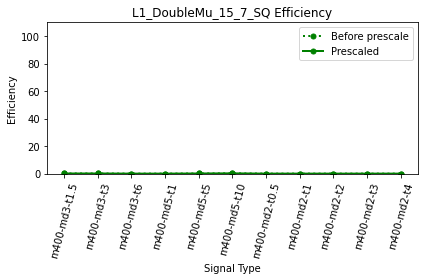

 31%|███       | 99/321 [02:03<02:36,  1.42it/s]

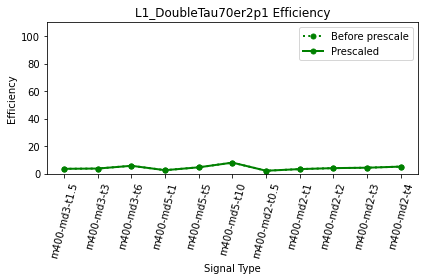

 31%|███       | 100/321 [02:04<02:47,  1.32it/s]

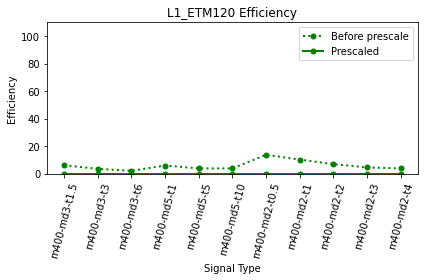

 31%|███▏      | 101/321 [02:05<03:10,  1.16it/s]

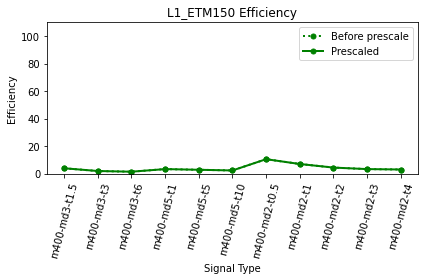

 32%|███▏      | 102/321 [02:05<02:54,  1.26it/s]

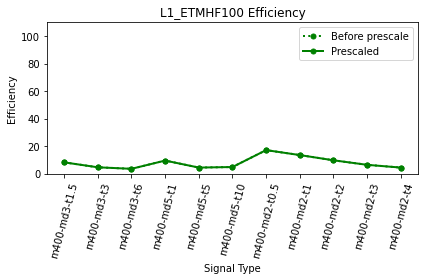

 32%|███▏      | 103/321 [02:06<02:41,  1.35it/s]

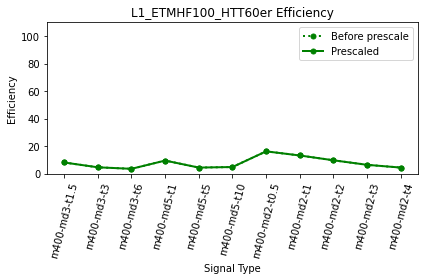

 32%|███▏      | 104/321 [02:07<02:38,  1.37it/s]

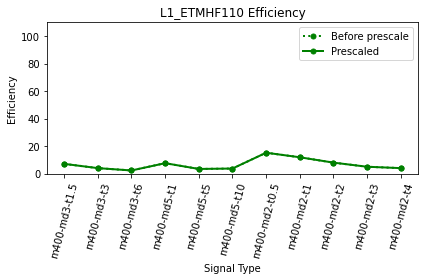

 33%|███▎      | 105/321 [02:08<02:42,  1.33it/s]

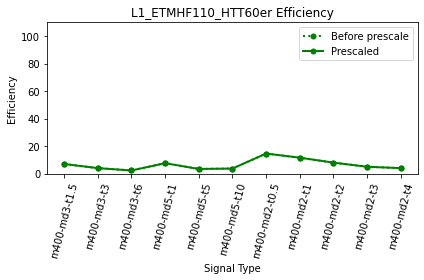

 33%|███▎      | 106/321 [02:08<02:37,  1.37it/s]

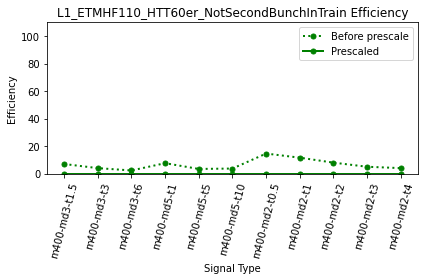

 33%|███▎      | 107/321 [02:09<02:25,  1.47it/s]

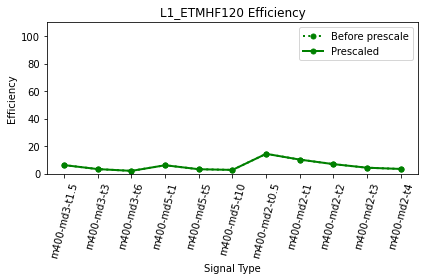

 34%|███▎      | 108/321 [02:09<02:22,  1.50it/s]

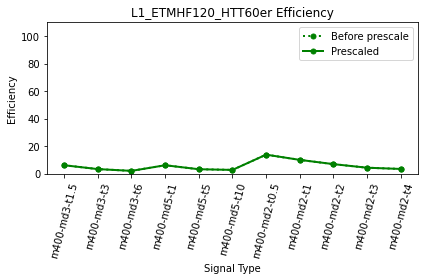

 34%|███▍      | 109/321 [02:10<02:29,  1.41it/s]

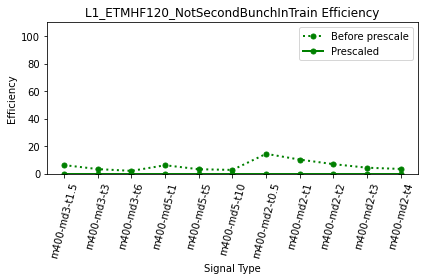

 34%|███▍      | 110/321 [02:11<02:19,  1.51it/s]

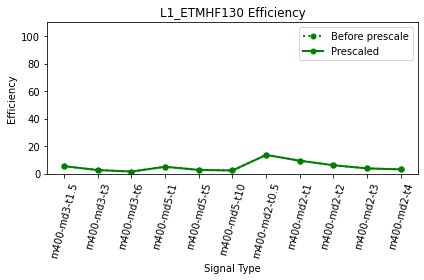

 35%|███▍      | 111/321 [02:12<02:39,  1.32it/s]

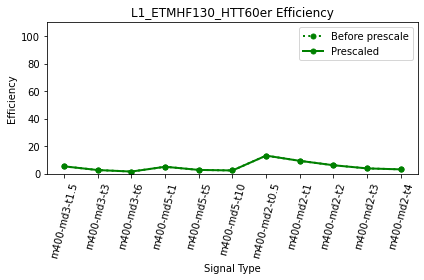

 35%|███▍      | 112/321 [02:12<02:37,  1.33it/s]

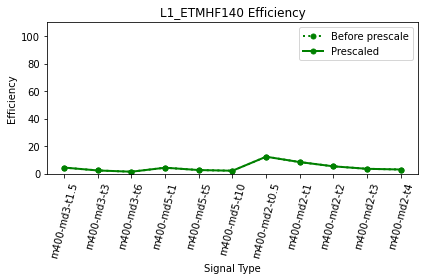

 35%|███▌      | 113/321 [02:13<02:26,  1.42it/s]

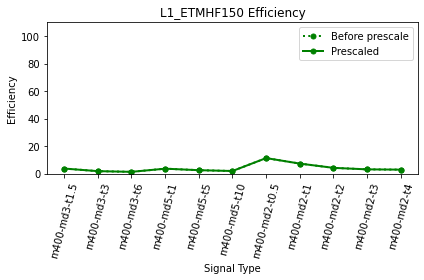

 36%|███▌      | 114/321 [02:14<02:39,  1.30it/s]

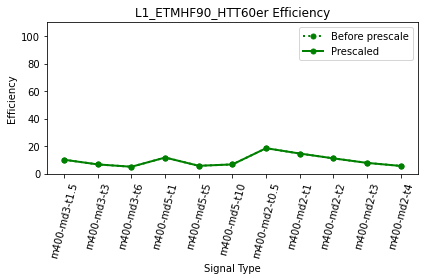

 36%|███▌      | 115/321 [02:15<02:46,  1.24it/s]

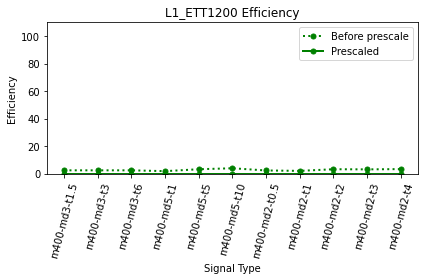

 36%|███▌      | 116/321 [02:16<02:34,  1.32it/s]

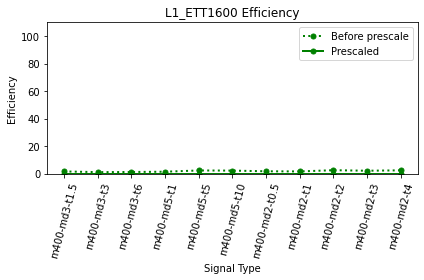

 36%|███▋      | 117/321 [02:18<04:49,  1.42s/it]

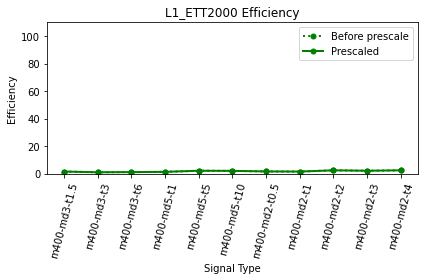

 37%|███▋      | 118/321 [02:19<04:19,  1.28s/it]

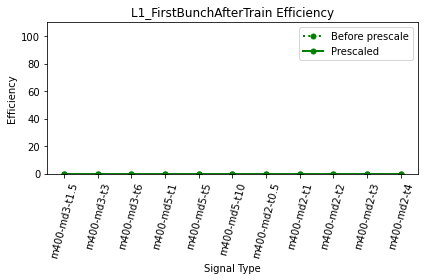

 37%|███▋      | 119/321 [02:20<03:42,  1.10s/it]

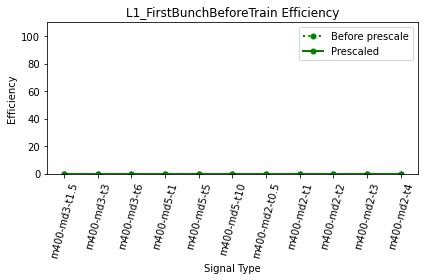

 37%|███▋      | 120/321 [02:21<03:17,  1.02it/s]

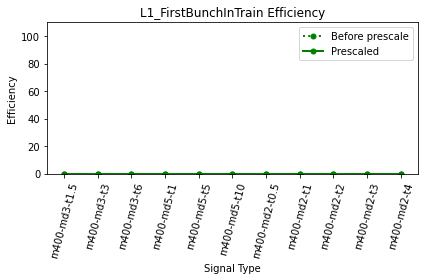

 38%|███▊      | 121/321 [02:21<02:52,  1.16it/s]

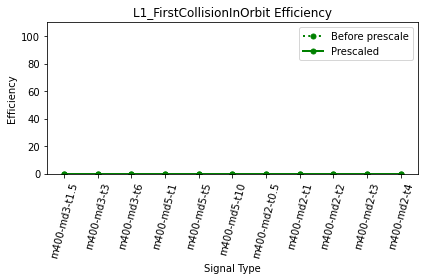

 38%|███▊      | 122/321 [02:22<02:28,  1.34it/s]

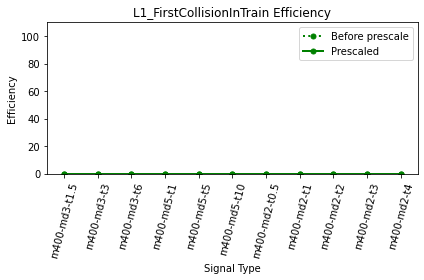

 38%|███▊      | 123/321 [02:23<02:33,  1.29it/s]

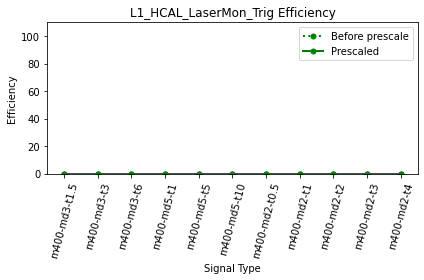

 39%|███▊      | 124/321 [02:23<02:30,  1.31it/s]

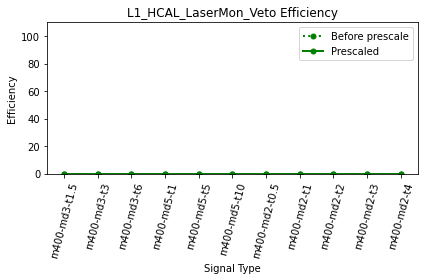

 39%|███▉      | 125/321 [02:24<02:19,  1.41it/s]

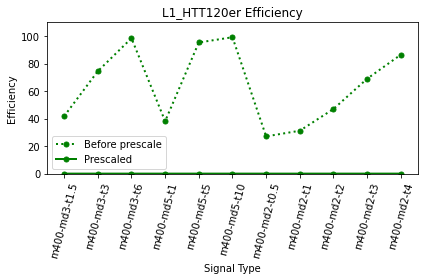

 39%|███▉      | 126/321 [02:25<02:20,  1.39it/s]

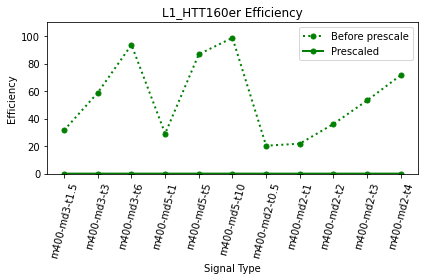

 40%|███▉      | 127/321 [02:25<02:18,  1.41it/s]

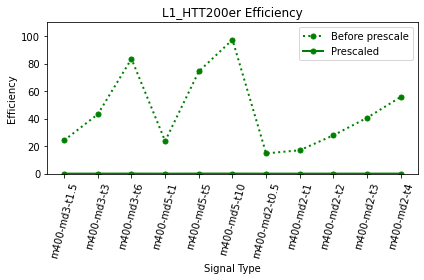

 40%|███▉      | 128/321 [02:26<02:12,  1.45it/s]

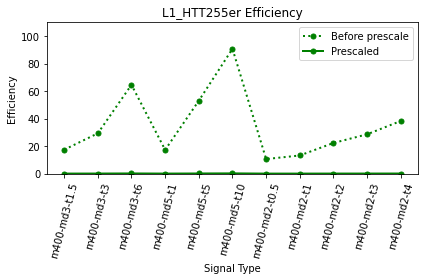

 40%|████      | 129/321 [02:27<02:27,  1.30it/s]

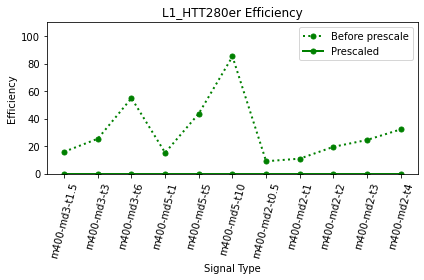

 40%|████      | 130/321 [02:28<02:13,  1.43it/s]

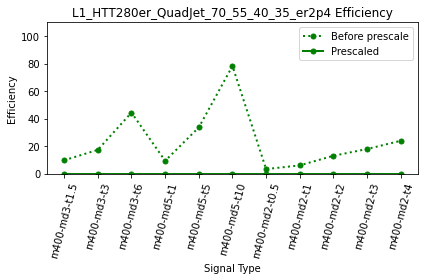

 41%|████      | 131/321 [02:29<02:32,  1.25it/s]

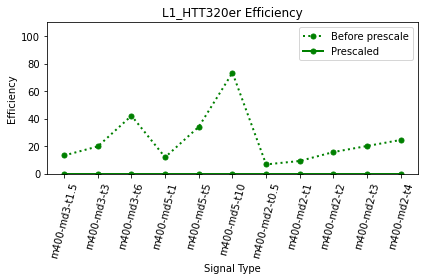

 41%|████      | 132/321 [02:29<02:34,  1.23it/s]

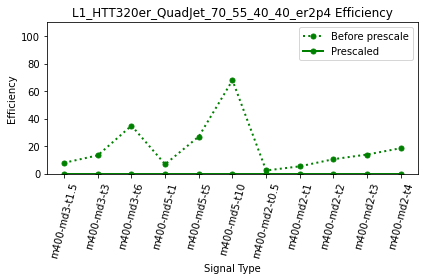

 41%|████▏     | 133/321 [02:30<02:27,  1.28it/s]

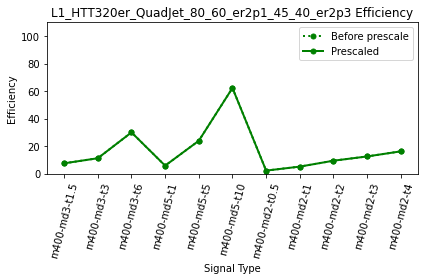

 42%|████▏     | 134/321 [02:31<02:26,  1.28it/s]

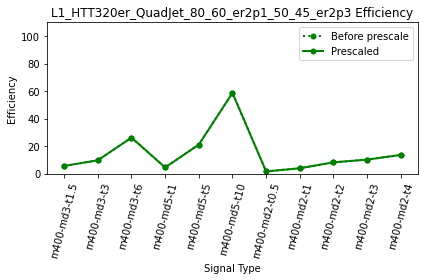

 42%|████▏     | 135/321 [02:32<02:27,  1.26it/s]

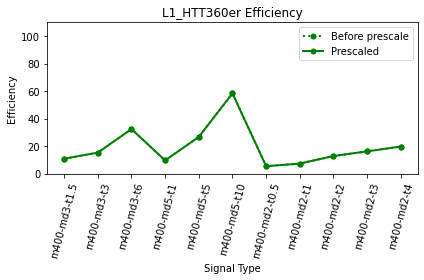

 42%|████▏     | 136/321 [02:33<02:35,  1.19it/s]

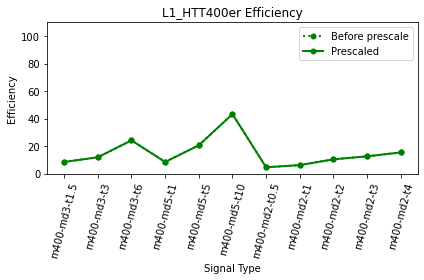

 43%|████▎     | 137/321 [02:35<03:44,  1.22s/it]

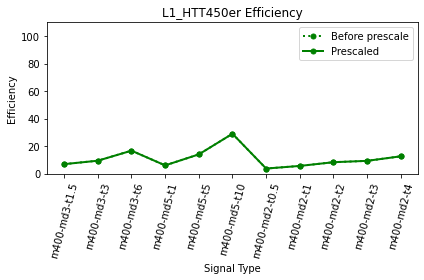

 43%|████▎     | 138/321 [02:37<04:12,  1.38s/it]

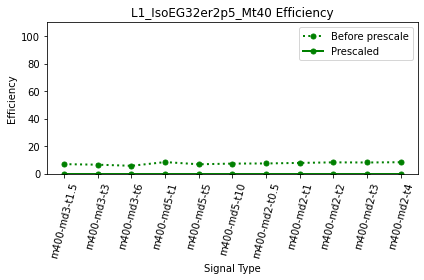

 43%|████▎     | 139/321 [02:38<03:54,  1.29s/it]

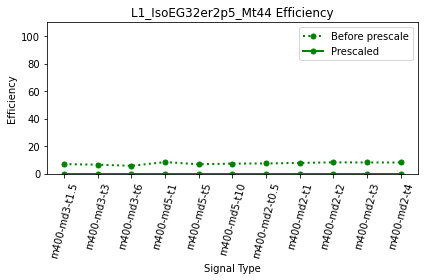

 44%|████▎     | 140/321 [02:39<03:29,  1.16s/it]

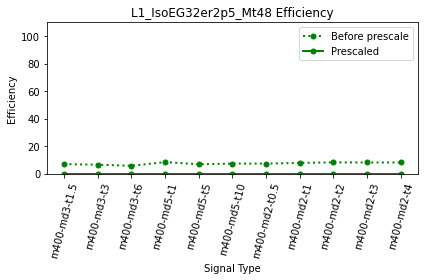

 44%|████▍     | 141/321 [02:39<02:58,  1.01it/s]

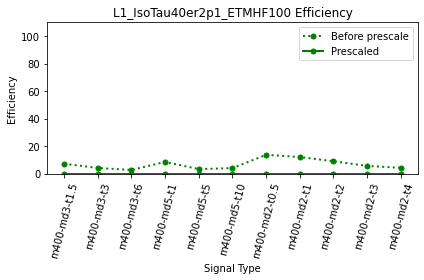

 44%|████▍     | 142/321 [02:40<02:51,  1.05it/s]

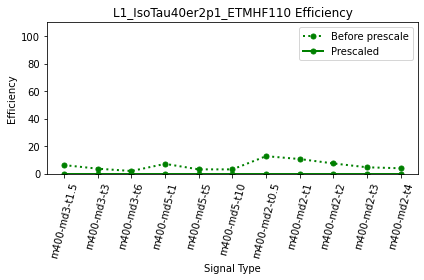

 45%|████▍     | 143/321 [02:41<02:29,  1.19it/s]

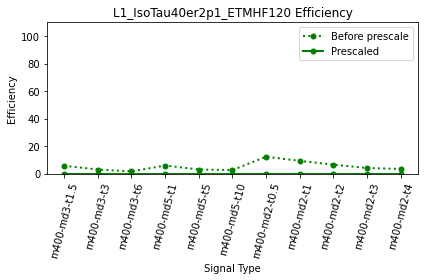

 45%|████▍     | 144/321 [02:41<02:19,  1.27it/s]

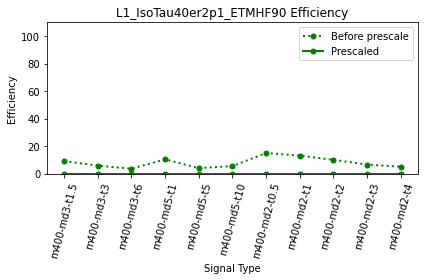

 45%|████▌     | 145/321 [02:42<02:31,  1.16it/s]

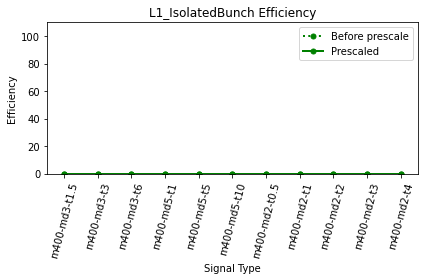

 45%|████▌     | 146/321 [02:43<02:12,  1.32it/s]

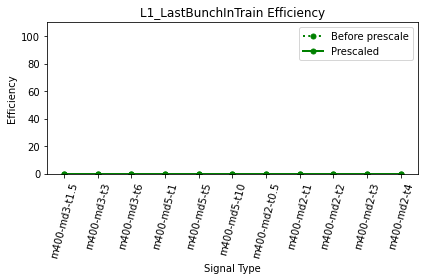

 46%|████▌     | 147/321 [02:44<02:15,  1.28it/s]

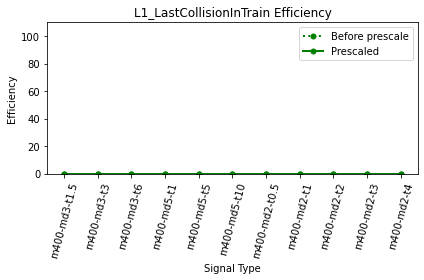

 46%|████▌     | 148/321 [02:44<02:15,  1.28it/s]

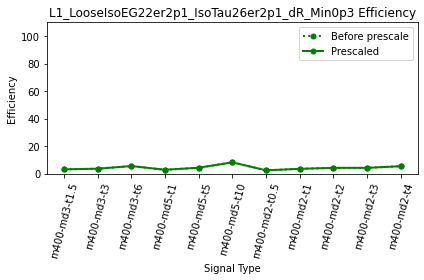

 46%|████▋     | 149/321 [02:45<02:13,  1.29it/s]

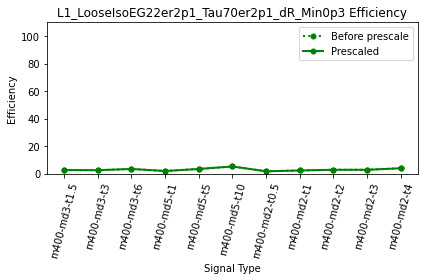

 47%|████▋     | 150/321 [02:46<02:01,  1.41it/s]

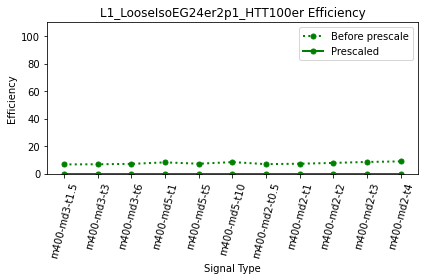

 47%|████▋     | 151/321 [02:46<02:01,  1.39it/s]

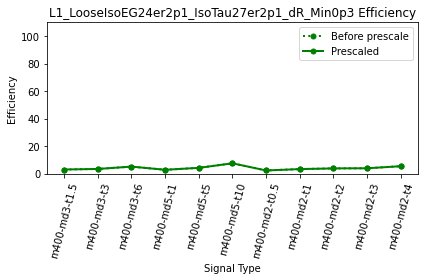

 47%|████▋     | 152/321 [02:47<01:59,  1.41it/s]

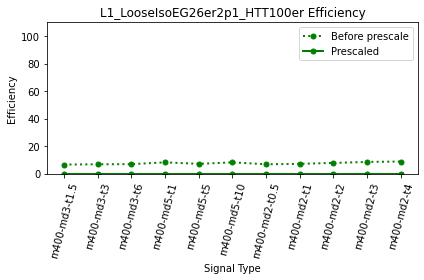

 48%|████▊     | 153/321 [02:48<01:53,  1.48it/s]

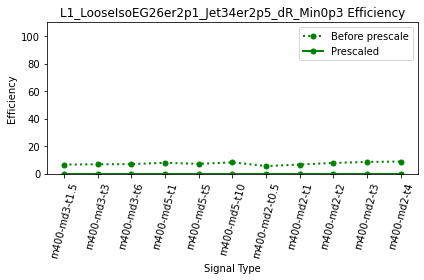

 48%|████▊     | 154/321 [02:48<01:45,  1.58it/s]

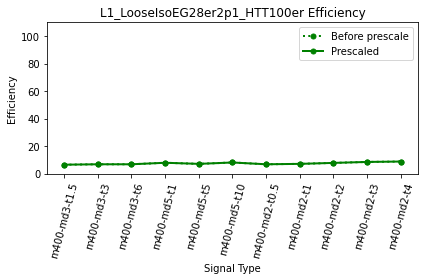

 48%|████▊     | 155/321 [02:49<01:39,  1.67it/s]

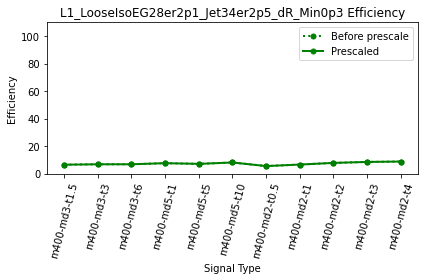

 49%|████▊     | 156/321 [02:50<01:44,  1.58it/s]

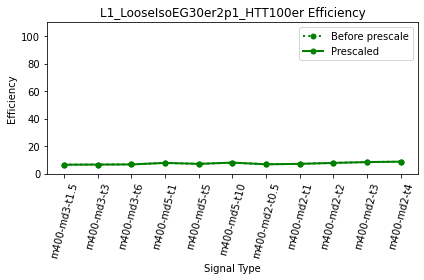

 49%|████▉     | 157/321 [02:50<01:49,  1.49it/s]

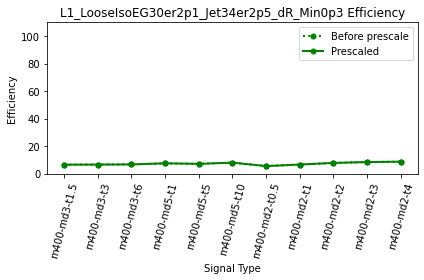

 49%|████▉     | 158/321 [02:51<01:50,  1.48it/s]

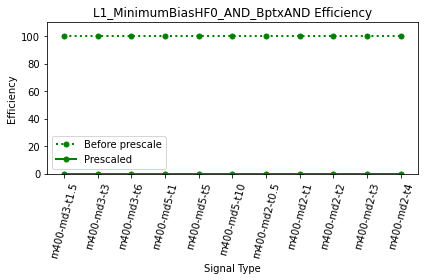

 50%|████▉     | 159/321 [02:52<01:44,  1.54it/s]

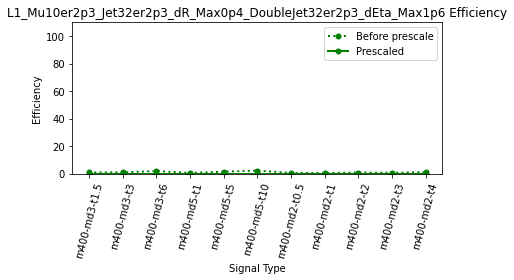

 50%|████▉     | 160/321 [02:52<01:54,  1.40it/s]

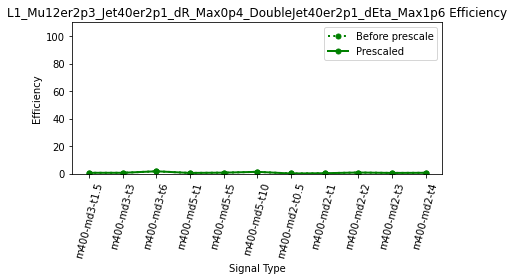

 50%|█████     | 161/321 [02:54<02:28,  1.08it/s]

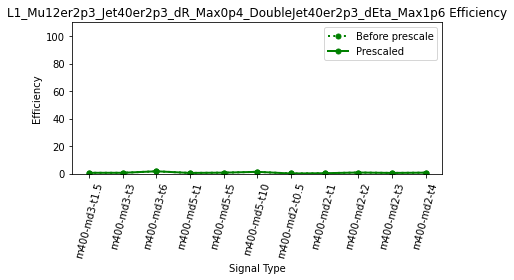

 50%|█████     | 162/321 [02:55<02:18,  1.15it/s]

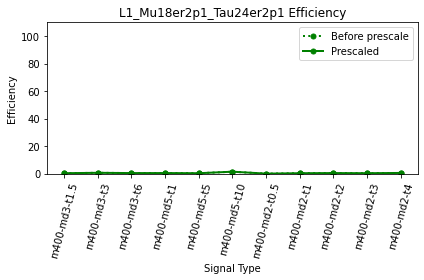

 51%|█████     | 163/321 [02:55<02:05,  1.26it/s]

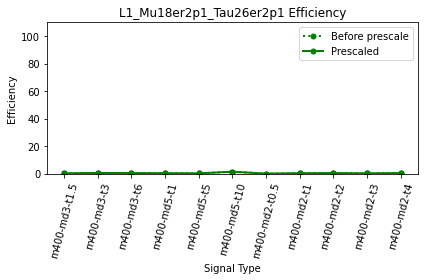

 51%|█████     | 164/321 [02:56<02:04,  1.26it/s]

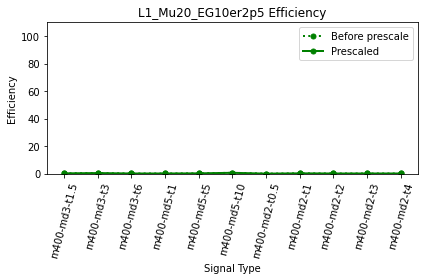

 51%|█████▏    | 165/321 [03:10<12:25,  4.78s/it]

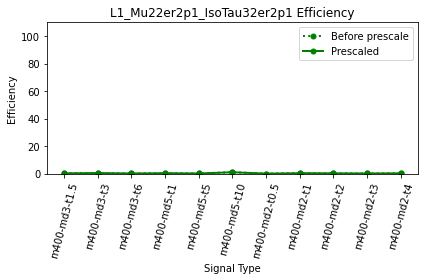

 52%|█████▏    | 166/321 [03:11<09:17,  3.60s/it]

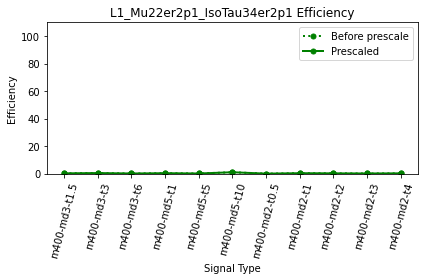

 52%|█████▏    | 167/321 [03:12<07:32,  2.94s/it]

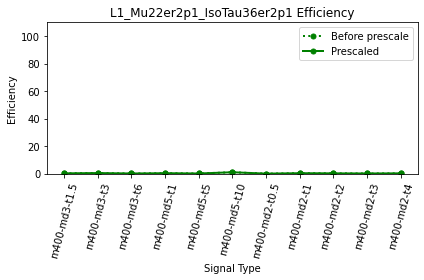

 52%|█████▏    | 168/321 [03:13<06:03,  2.38s/it]

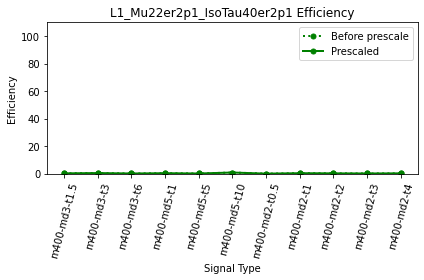

 53%|█████▎    | 169/321 [03:14<04:49,  1.91s/it]

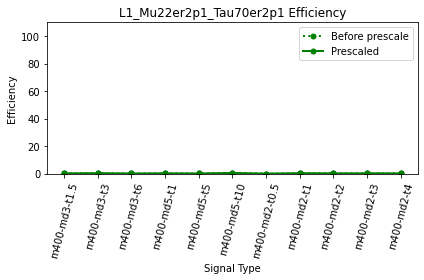

 53%|█████▎    | 170/321 [03:15<03:47,  1.51s/it]

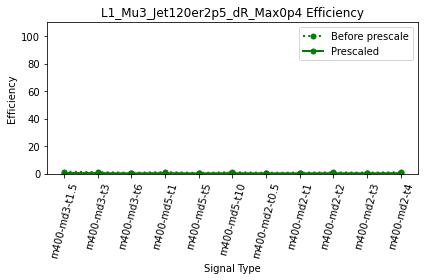

 53%|█████▎    | 171/321 [03:15<03:08,  1.26s/it]

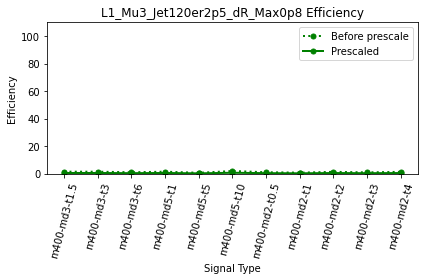

 54%|█████▎    | 172/321 [03:16<02:34,  1.04s/it]

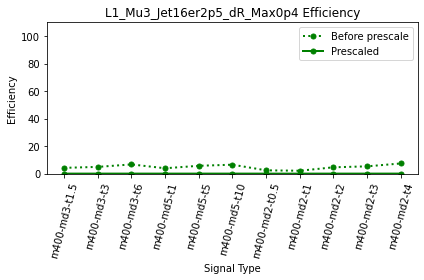

 54%|█████▍    | 173/321 [03:17<02:50,  1.15s/it]

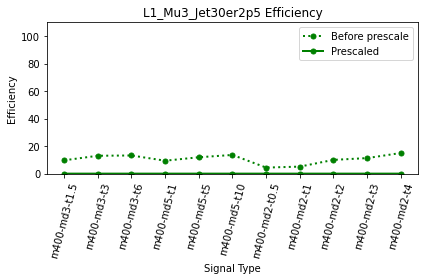

 54%|█████▍    | 174/321 [03:18<02:24,  1.01it/s]

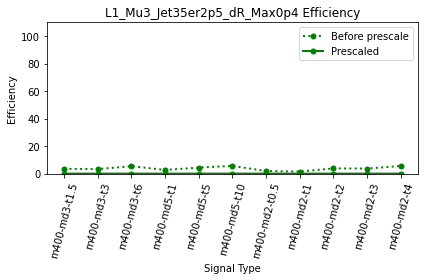

 55%|█████▍    | 175/321 [03:19<02:14,  1.08it/s]

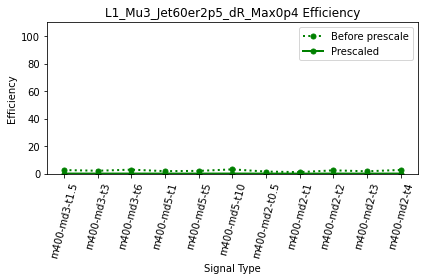

 55%|█████▍    | 176/321 [03:19<02:02,  1.18it/s]

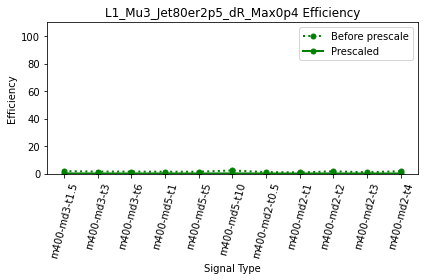

 55%|█████▌    | 177/321 [03:20<01:58,  1.21it/s]

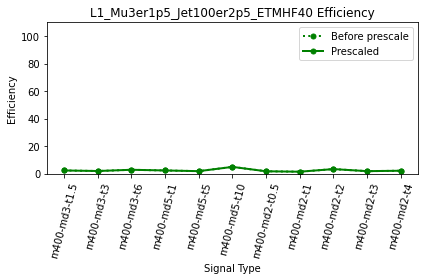

 55%|█████▌    | 178/321 [03:21<01:46,  1.34it/s]

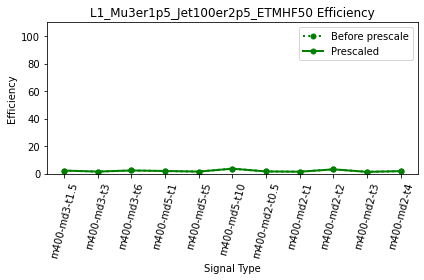

 56%|█████▌    | 179/321 [03:22<01:49,  1.30it/s]

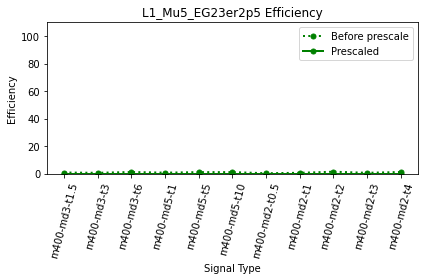

 56%|█████▌    | 180/321 [03:22<01:46,  1.33it/s]

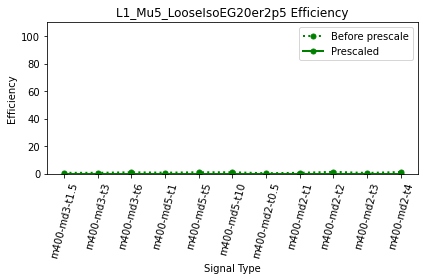

 56%|█████▋    | 181/321 [03:23<01:37,  1.44it/s]

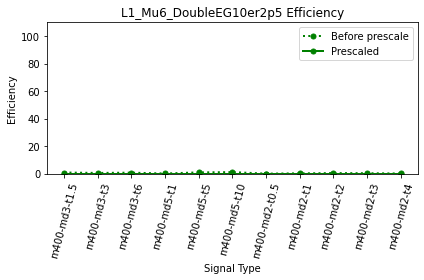

 57%|█████▋    | 182/321 [03:24<01:39,  1.39it/s]

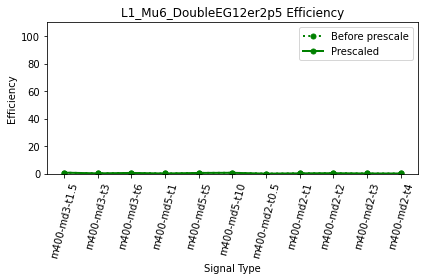

 57%|█████▋    | 183/321 [03:24<01:31,  1.51it/s]

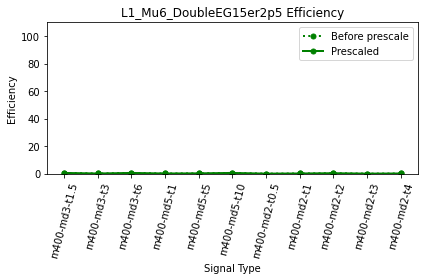

 57%|█████▋    | 184/321 [03:25<01:37,  1.41it/s]

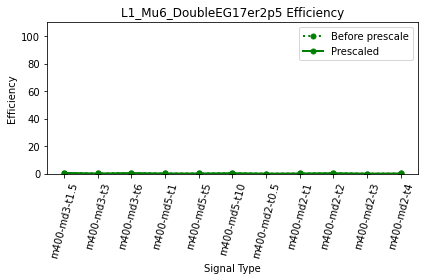

 58%|█████▊    | 185/321 [03:26<01:37,  1.40it/s]

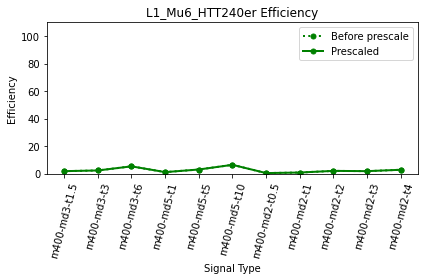

 58%|█████▊    | 186/321 [03:26<01:34,  1.43it/s]

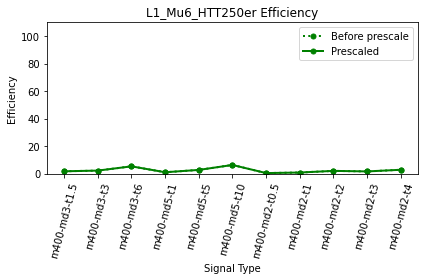

 58%|█████▊    | 187/321 [03:27<01:28,  1.51it/s]

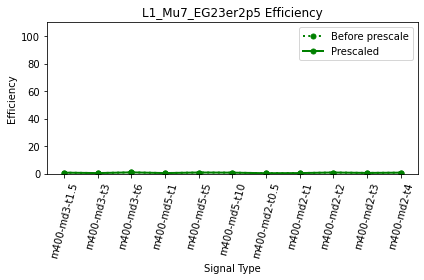

 59%|█████▊    | 188/321 [03:28<01:25,  1.56it/s]

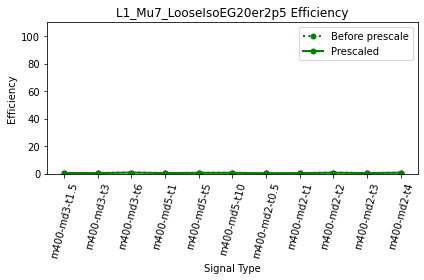

 59%|█████▉    | 189/321 [03:28<01:22,  1.60it/s]

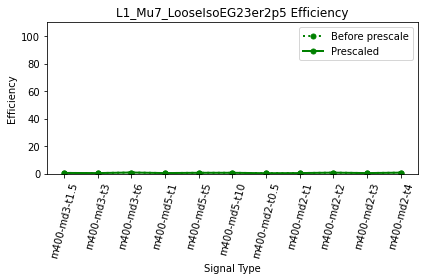

 59%|█████▉    | 190/321 [03:29<01:29,  1.47it/s]

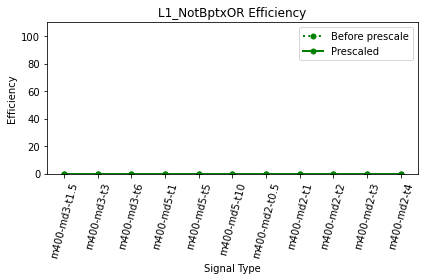

 60%|█████▉    | 191/321 [03:30<01:34,  1.37it/s]

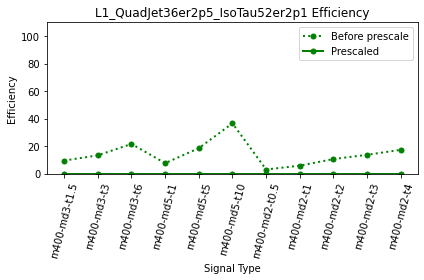

 60%|█████▉    | 192/321 [03:30<01:33,  1.38it/s]

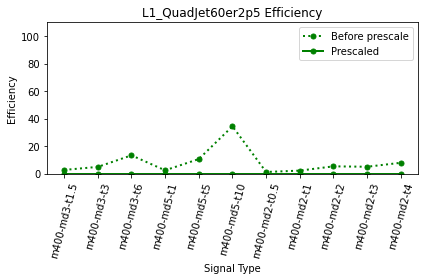

 60%|██████    | 193/321 [03:31<01:32,  1.38it/s]

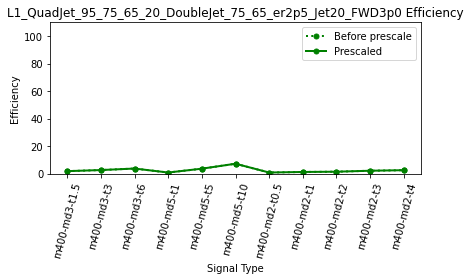

 60%|██████    | 194/321 [03:32<01:23,  1.52it/s]

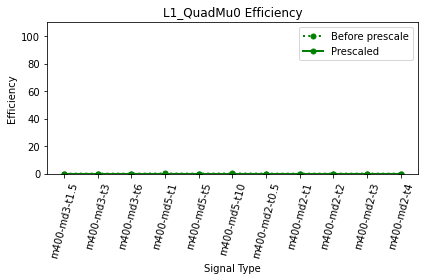

 61%|██████    | 195/321 [03:34<02:31,  1.20s/it]

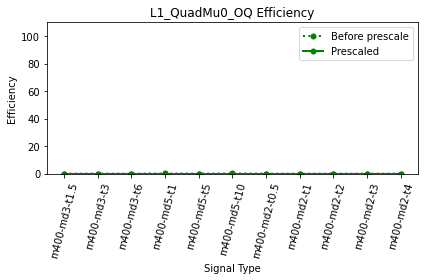

 61%|██████    | 196/321 [03:35<02:03,  1.01it/s]

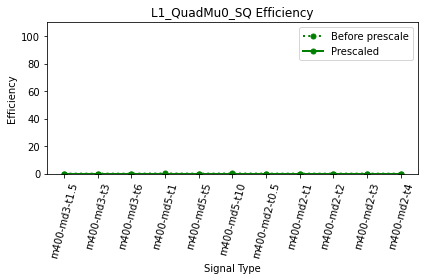

 61%|██████▏   | 197/321 [03:35<01:47,  1.15it/s]

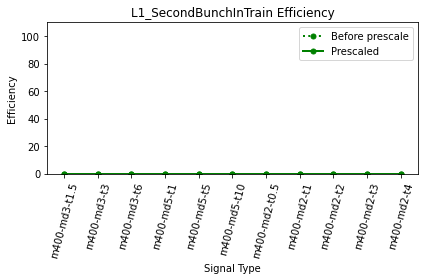

 62%|██████▏   | 198/321 [03:36<01:57,  1.05it/s]

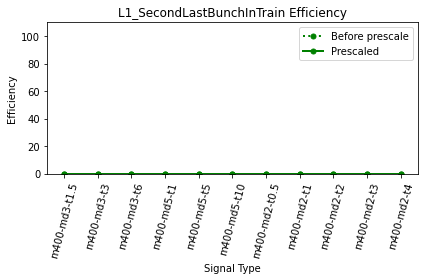

 62%|██████▏   | 199/321 [03:37<01:43,  1.17it/s]

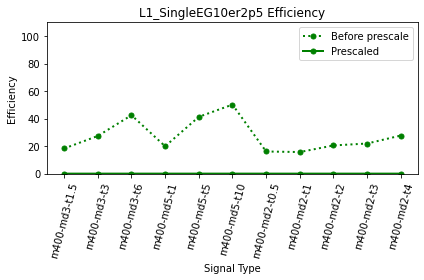

 62%|██████▏   | 200/321 [03:38<01:35,  1.27it/s]

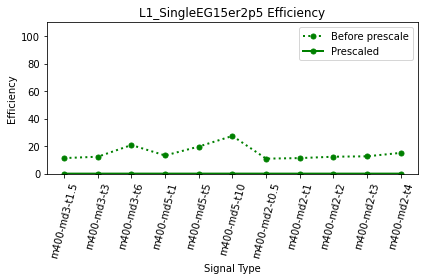

 63%|██████▎   | 201/321 [03:39<01:36,  1.24it/s]

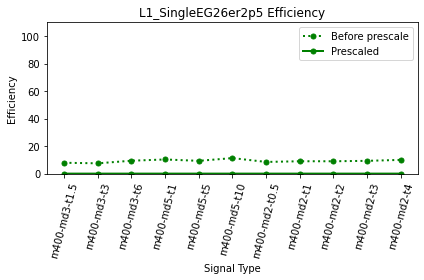

 63%|██████▎   | 202/321 [03:39<01:26,  1.37it/s]

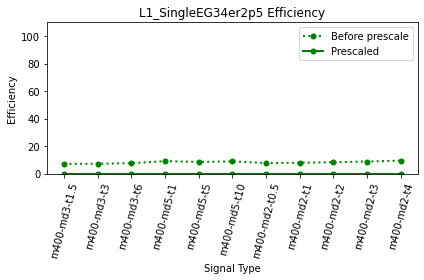

 63%|██████▎   | 203/321 [03:40<01:22,  1.43it/s]

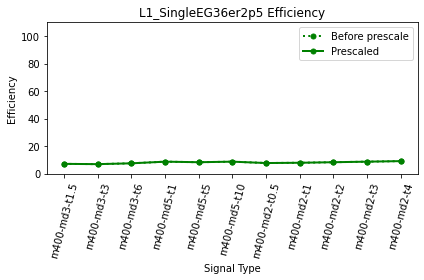

 64%|██████▎   | 204/321 [03:41<01:25,  1.36it/s]

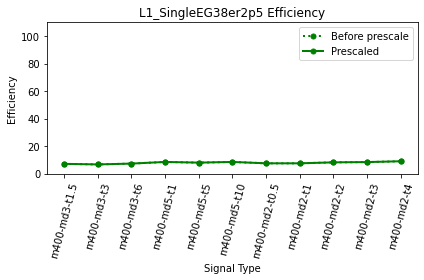

 64%|██████▍   | 205/321 [03:41<01:25,  1.36it/s]

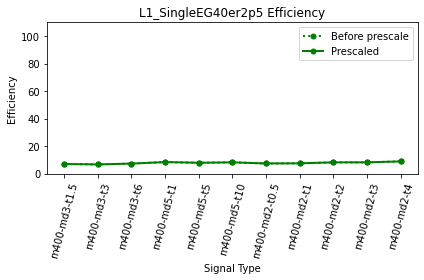

 64%|██████▍   | 206/321 [03:42<01:21,  1.40it/s]

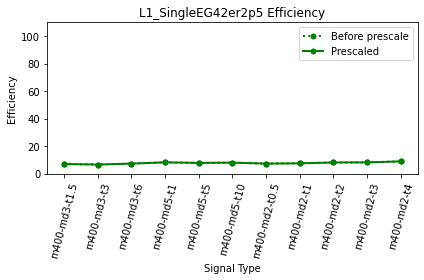

 64%|██████▍   | 207/321 [03:43<01:20,  1.42it/s]

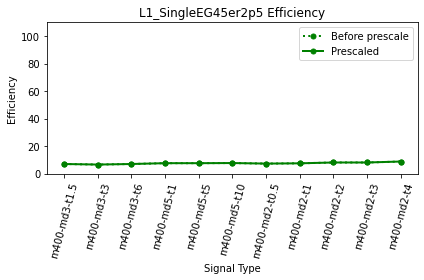

 65%|██████▍   | 208/321 [03:43<01:22,  1.38it/s]

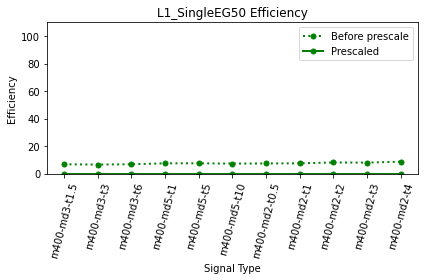

 65%|██████▌   | 209/321 [03:44<01:13,  1.52it/s]

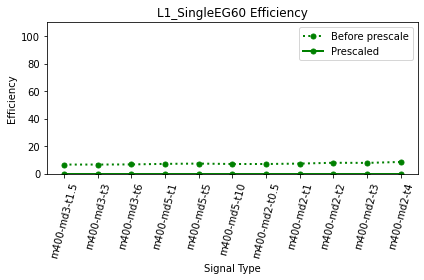

 65%|██████▌   | 210/321 [03:45<01:17,  1.43it/s]

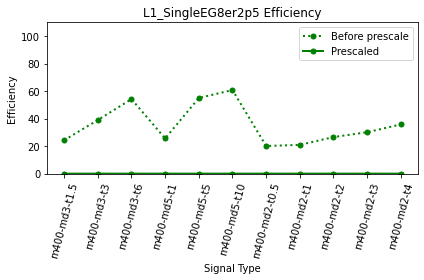

 66%|██████▌   | 211/321 [03:45<01:19,  1.38it/s]

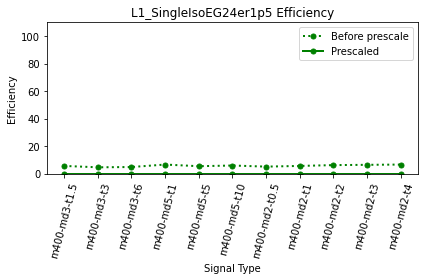

 66%|██████▌   | 212/321 [03:46<01:17,  1.40it/s]

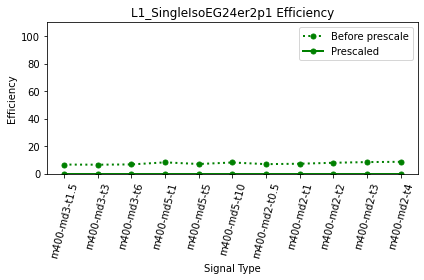

 66%|██████▋   | 213/321 [03:47<01:13,  1.46it/s]

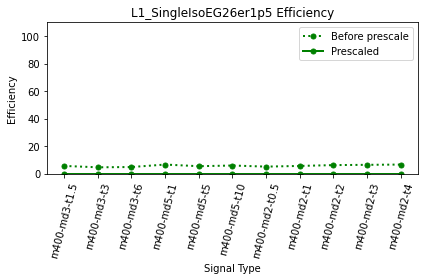

 67%|██████▋   | 214/321 [03:47<01:12,  1.48it/s]

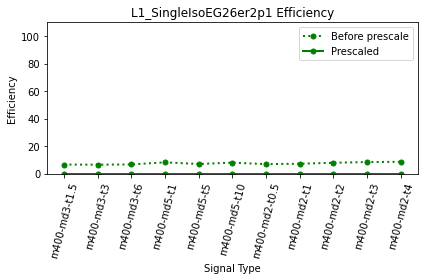

 67%|██████▋   | 215/321 [03:48<01:11,  1.49it/s]

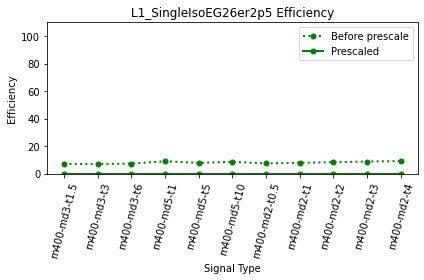

 67%|██████▋   | 216/321 [03:49<01:08,  1.54it/s]

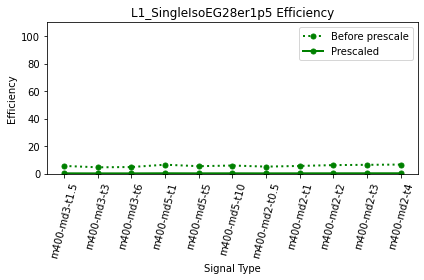

 68%|██████▊   | 217/321 [03:49<01:09,  1.50it/s]

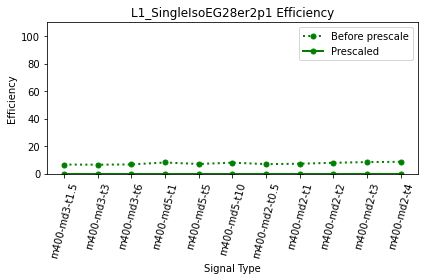

 68%|██████▊   | 218/321 [03:50<01:09,  1.48it/s]

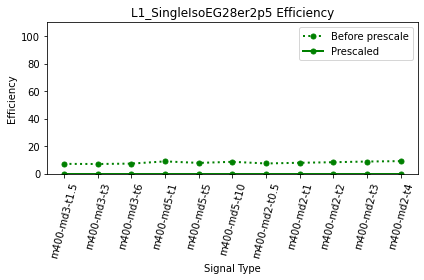

 68%|██████▊   | 219/321 [03:51<01:08,  1.50it/s]

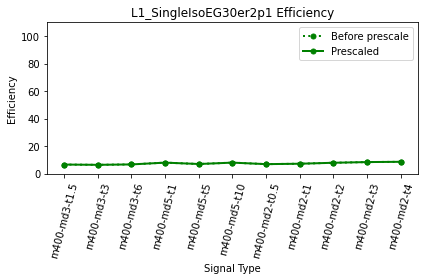

 69%|██████▊   | 220/321 [03:51<01:04,  1.56it/s]

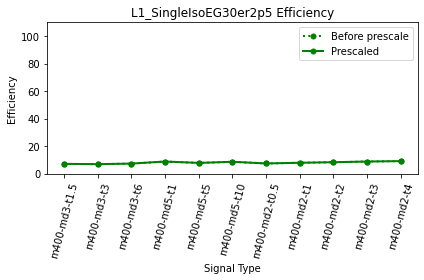

 69%|██████▉   | 221/321 [03:52<01:05,  1.52it/s]

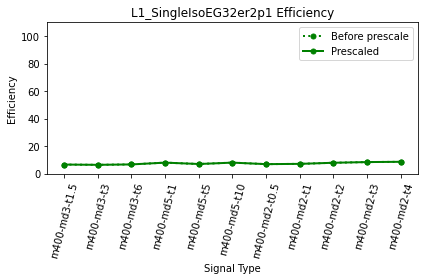

 69%|██████▉   | 222/321 [03:53<01:13,  1.36it/s]

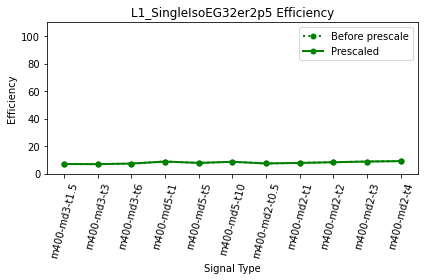

 69%|██████▉   | 223/321 [03:54<01:12,  1.36it/s]

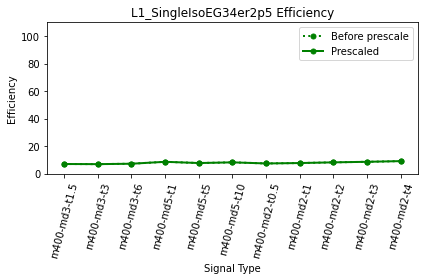

 70%|██████▉   | 224/321 [03:54<01:13,  1.32it/s]

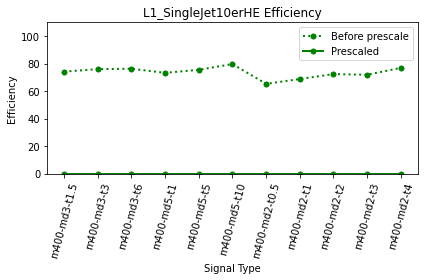

 70%|███████   | 225/321 [04:25<15:26,  9.65s/it]

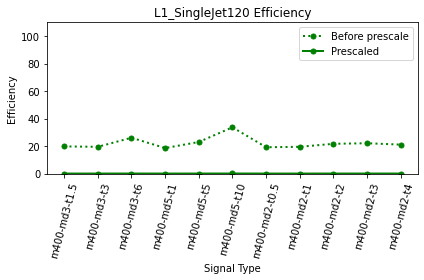

 70%|███████   | 226/321 [04:26<11:04,  6.99s/it]

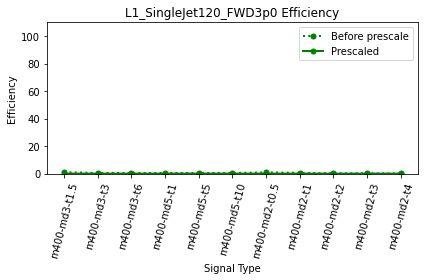

 71%|███████   | 227/321 [04:26<07:56,  5.07s/it]

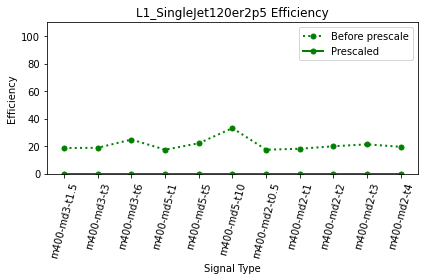

 71%|███████   | 228/321 [04:27<05:47,  3.74s/it]

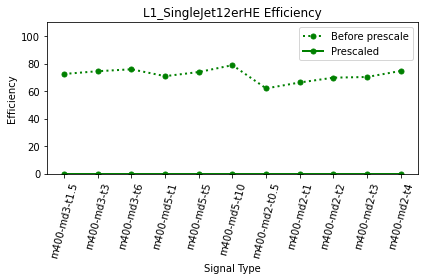

 71%|███████▏  | 229/321 [04:28<04:18,  2.81s/it]

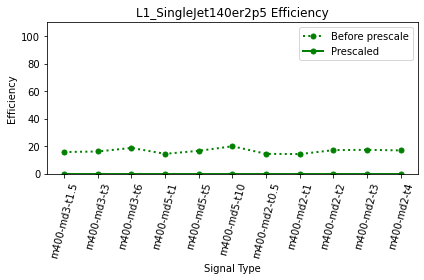

 72%|███████▏  | 230/321 [04:28<03:21,  2.21s/it]

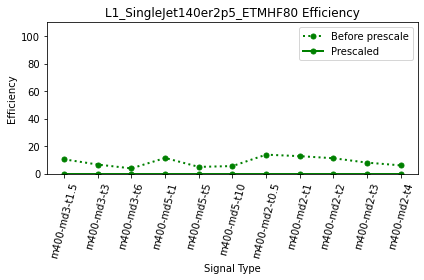

 72%|███████▏  | 231/321 [04:29<02:35,  1.73s/it]

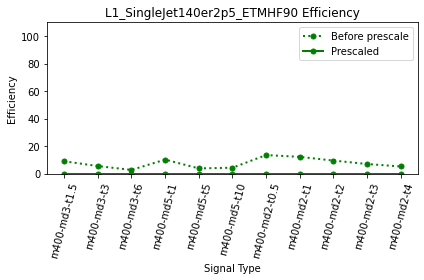

 72%|███████▏  | 232/321 [04:30<02:07,  1.43s/it]

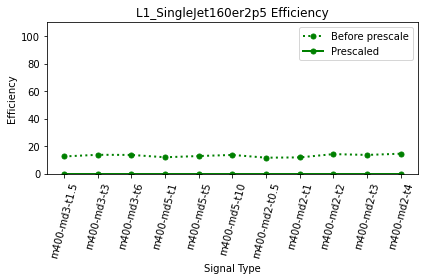

 73%|███████▎  | 233/321 [04:30<01:42,  1.16s/it]

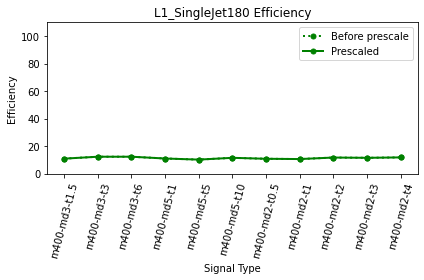

 73%|███████▎  | 234/321 [04:31<01:27,  1.00s/it]

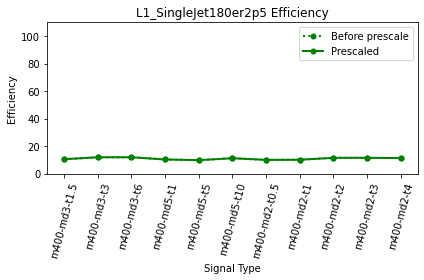

 73%|███████▎  | 235/321 [04:31<01:17,  1.11it/s]

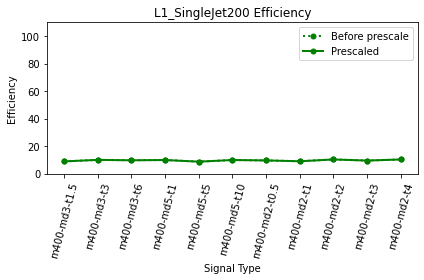

 74%|███████▎  | 236/321 [04:32<01:11,  1.19it/s]

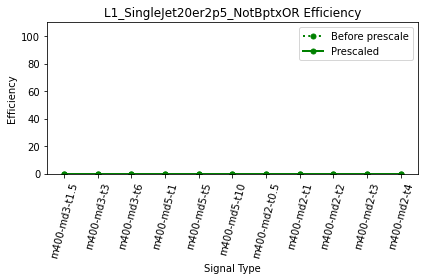

 74%|███████▍  | 237/321 [04:33<01:16,  1.10it/s]

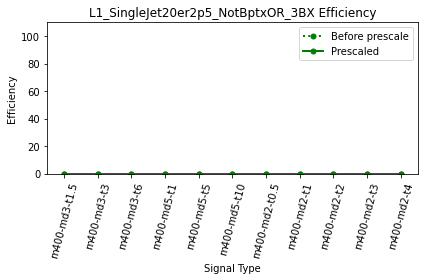

 74%|███████▍  | 238/321 [04:34<01:07,  1.24it/s]

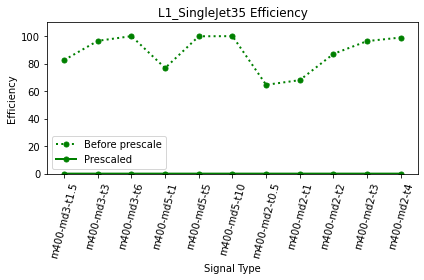

 74%|███████▍  | 239/321 [04:35<01:04,  1.28it/s]

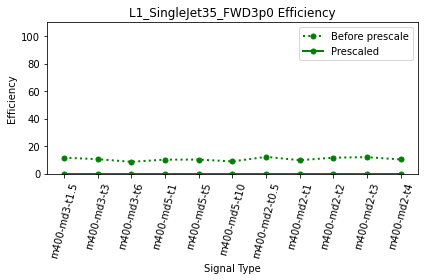

 75%|███████▍  | 240/321 [04:36<01:11,  1.13it/s]

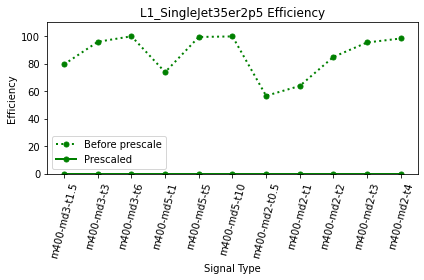

 75%|███████▌  | 241/321 [04:36<01:06,  1.21it/s]

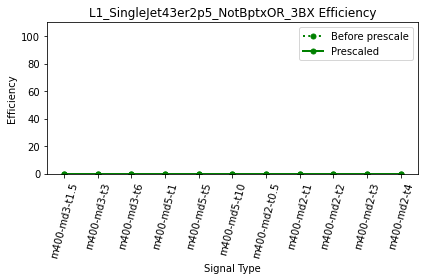

 75%|███████▌  | 242/321 [04:37<00:57,  1.37it/s]

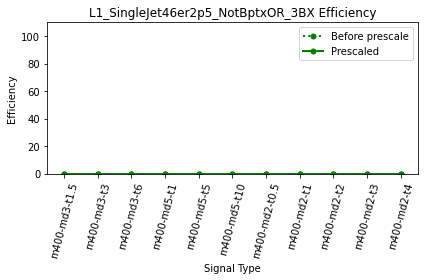

 76%|███████▌  | 243/321 [04:37<00:53,  1.46it/s]

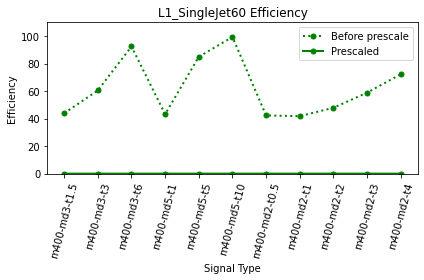

 76%|███████▌  | 244/321 [04:39<01:01,  1.25it/s]

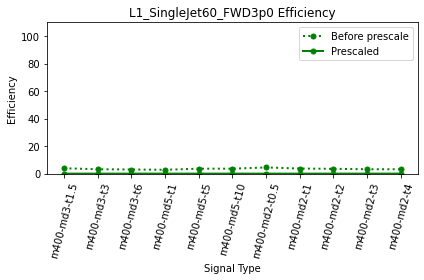

 76%|███████▋  | 245/321 [04:39<00:59,  1.29it/s]

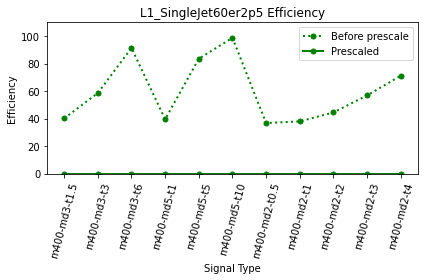

 77%|███████▋  | 246/321 [04:40<00:53,  1.41it/s]

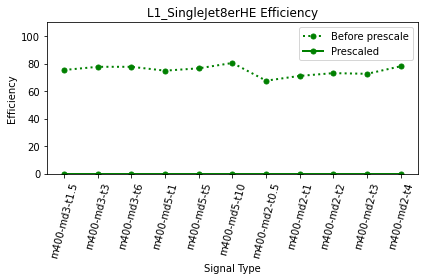

 77%|███████▋  | 247/321 [04:40<00:50,  1.46it/s]

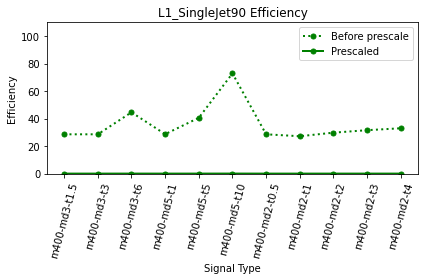

 77%|███████▋  | 248/321 [04:41<00:51,  1.43it/s]

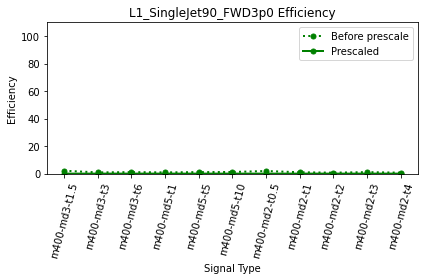

 78%|███████▊  | 249/321 [04:42<00:47,  1.53it/s]

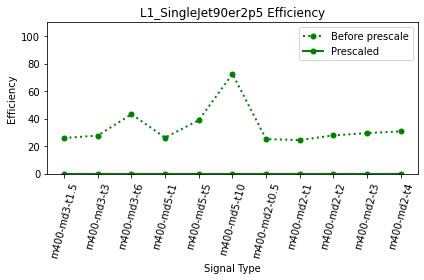

 78%|███████▊  | 250/321 [04:42<00:46,  1.51it/s]

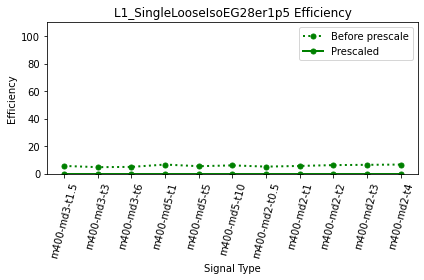

 78%|███████▊  | 251/321 [04:43<00:43,  1.60it/s]

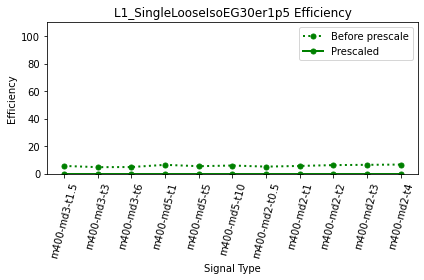

 79%|███████▊  | 252/321 [04:44<00:44,  1.56it/s]

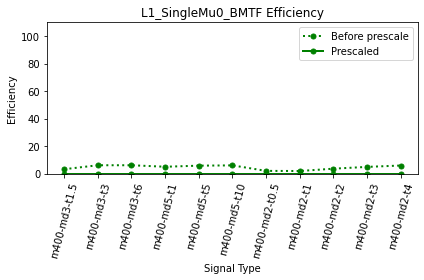

 79%|███████▉  | 253/321 [04:44<00:44,  1.52it/s]

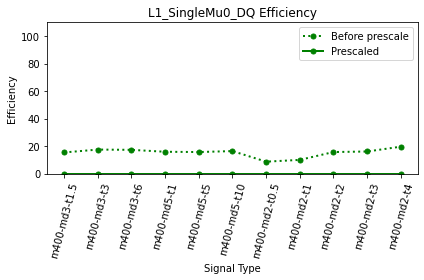

 79%|███████▉  | 254/321 [04:45<00:46,  1.43it/s]

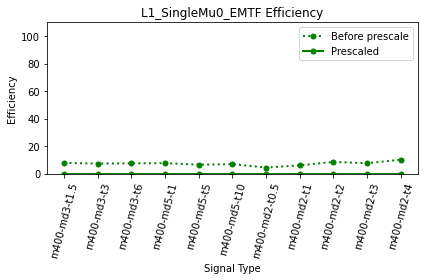

 79%|███████▉  | 255/321 [04:46<00:45,  1.47it/s]

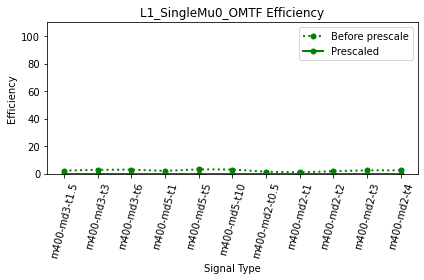

 80%|███████▉  | 256/321 [04:47<00:46,  1.41it/s]

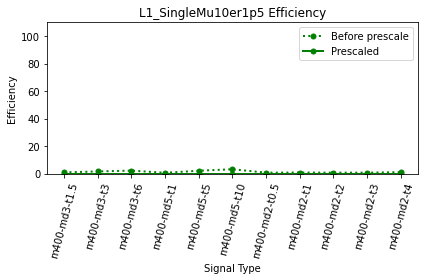

 80%|████████  | 257/321 [04:47<00:47,  1.34it/s]

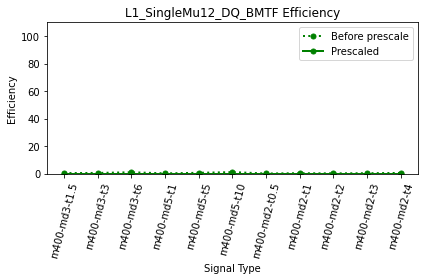

 80%|████████  | 258/321 [04:48<00:42,  1.47it/s]

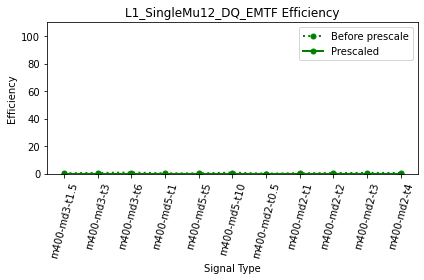

 81%|████████  | 259/321 [04:49<00:47,  1.30it/s]

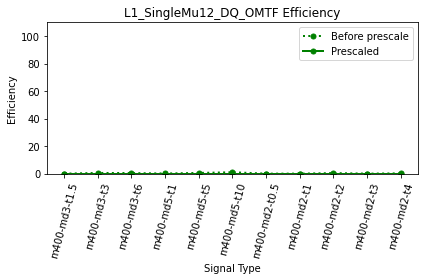

 81%|████████  | 260/321 [04:50<00:44,  1.36it/s]

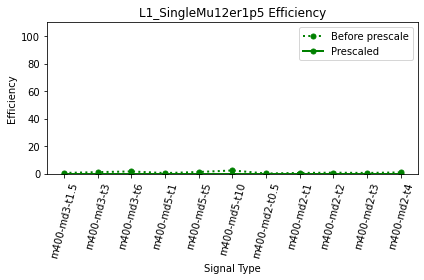

 81%|████████▏ | 261/321 [04:50<00:46,  1.30it/s]

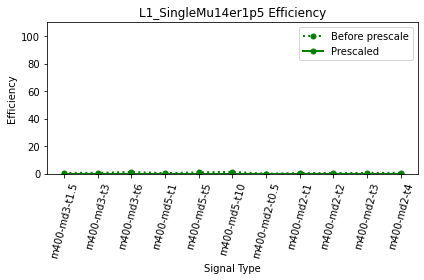

 82%|████████▏ | 262/321 [04:51<00:42,  1.40it/s]

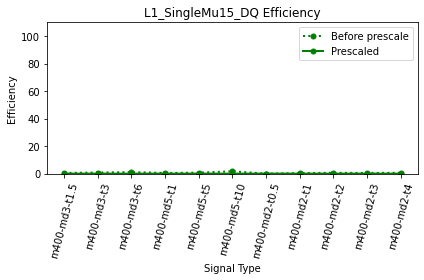

 82%|████████▏ | 263/321 [04:52<00:39,  1.48it/s]

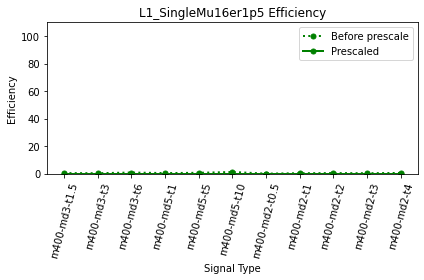

 82%|████████▏ | 264/321 [04:52<00:35,  1.61it/s]

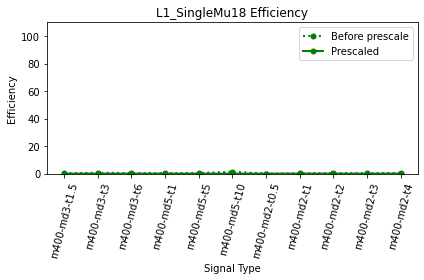

 83%|████████▎ | 265/321 [04:53<00:34,  1.64it/s]

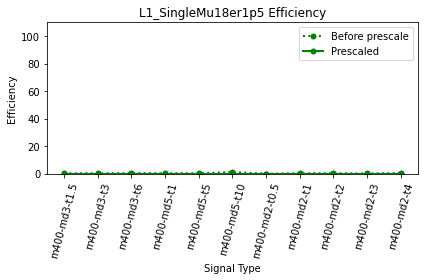

 83%|████████▎ | 266/321 [04:53<00:32,  1.70it/s]

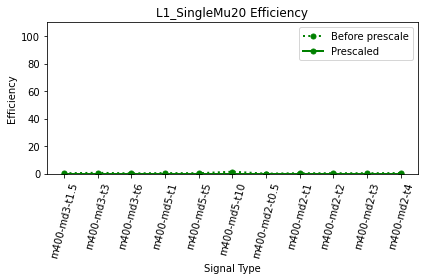

 83%|████████▎ | 267/321 [04:54<00:30,  1.75it/s]

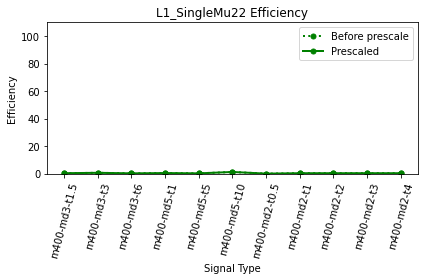

 83%|████████▎ | 268/321 [04:54<00:32,  1.64it/s]

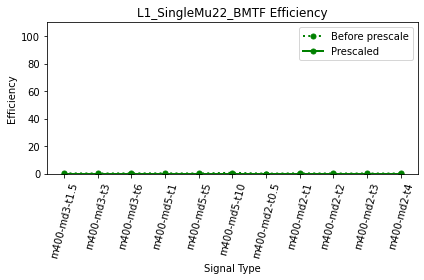

 84%|████████▍ | 269/321 [04:55<00:32,  1.59it/s]

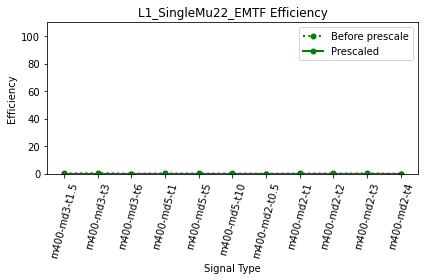

 84%|████████▍ | 270/321 [04:56<00:34,  1.47it/s]

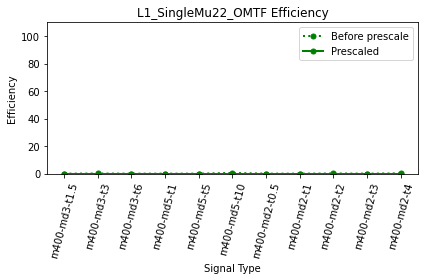

 84%|████████▍ | 271/321 [04:57<00:36,  1.39it/s]

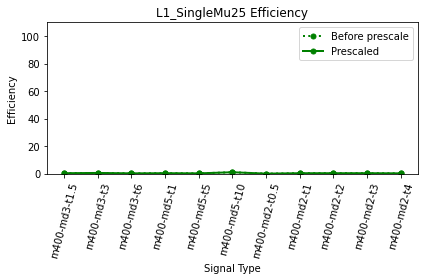

 85%|████████▍ | 272/321 [04:57<00:32,  1.52it/s]

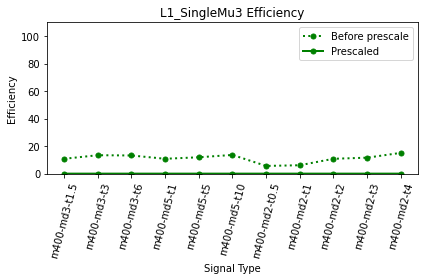

 85%|████████▌ | 273/321 [04:58<00:32,  1.46it/s]

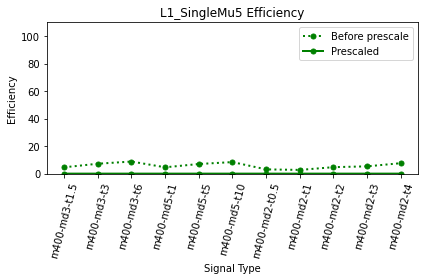

 85%|████████▌ | 274/321 [04:59<00:32,  1.46it/s]

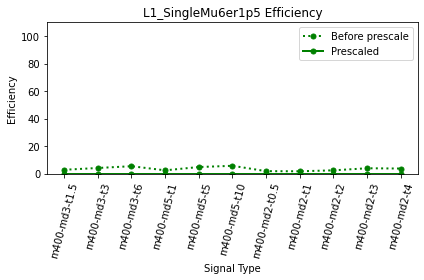

 86%|████████▌ | 275/321 [04:59<00:31,  1.48it/s]

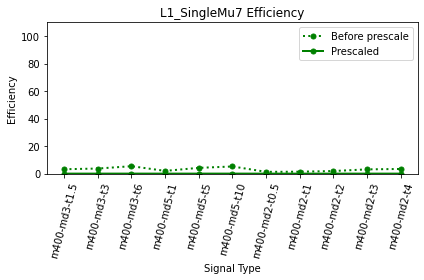

 86%|████████▌ | 276/321 [05:00<00:30,  1.50it/s]

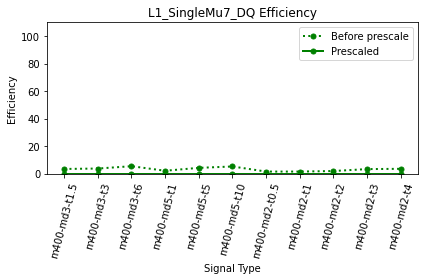

 86%|████████▋ | 277/321 [05:00<00:27,  1.58it/s]

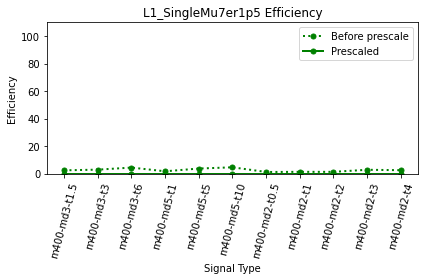

 87%|████████▋ | 278/321 [05:01<00:28,  1.49it/s]

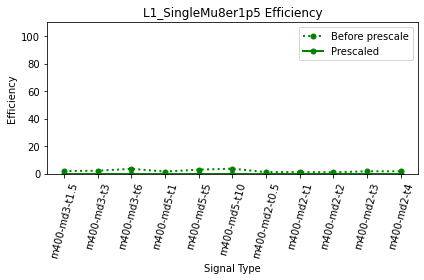

 87%|████████▋ | 279/321 [05:11<02:17,  3.28s/it]

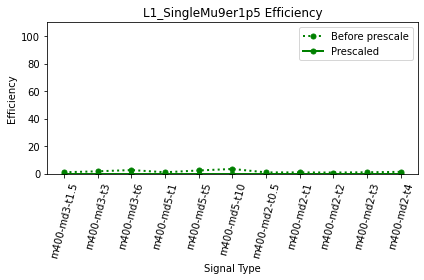

 87%|████████▋ | 280/321 [05:12<01:54,  2.79s/it]

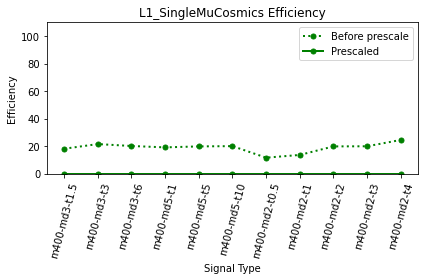

 88%|████████▊ | 281/321 [05:13<01:25,  2.14s/it]

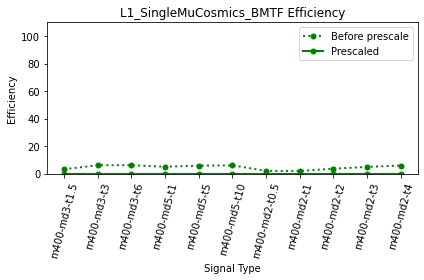

 88%|████████▊ | 282/321 [05:14<01:07,  1.73s/it]

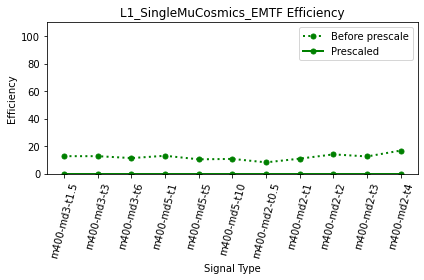

 88%|████████▊ | 283/321 [05:14<00:52,  1.39s/it]

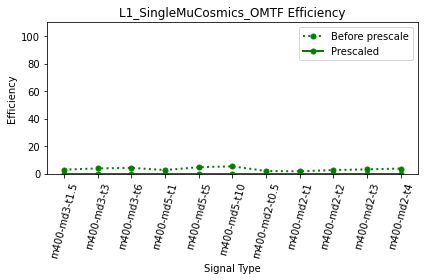

 88%|████████▊ | 284/321 [05:15<00:43,  1.18s/it]

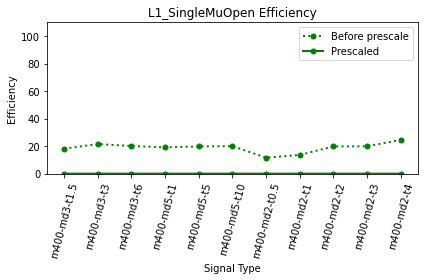

 89%|████████▉ | 285/321 [05:16<00:37,  1.04s/it]

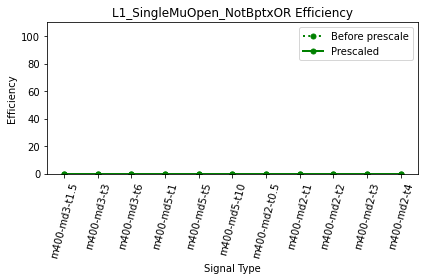

 89%|████████▉ | 286/321 [05:16<00:31,  1.13it/s]

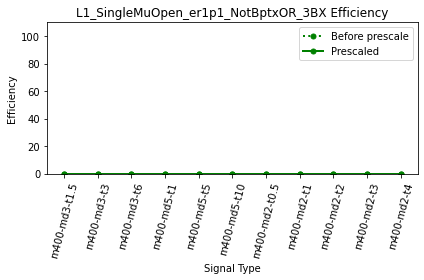

 89%|████████▉ | 287/321 [05:17<00:26,  1.27it/s]

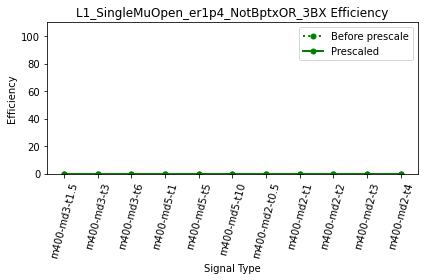

 90%|████████▉ | 288/321 [05:17<00:24,  1.35it/s]

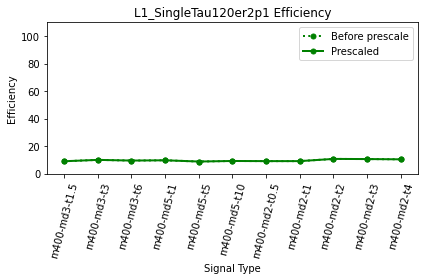

 90%|█████████ | 289/321 [05:18<00:21,  1.48it/s]

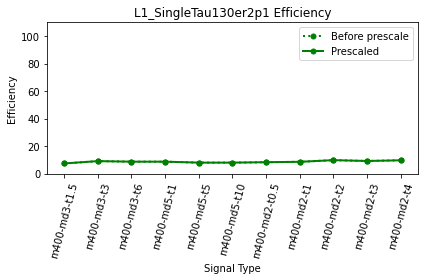

 90%|█████████ | 290/321 [05:19<00:22,  1.39it/s]

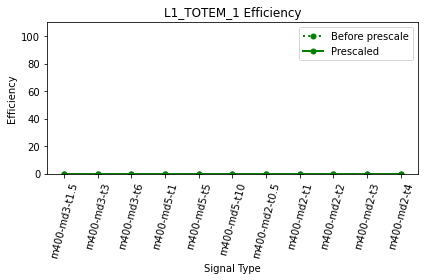

 91%|█████████ | 291/321 [05:19<00:19,  1.52it/s]

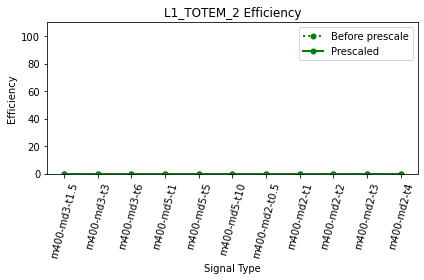

 91%|█████████ | 292/321 [05:20<00:18,  1.56it/s]

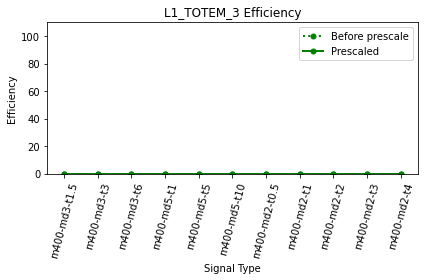

 91%|█████████▏| 293/321 [05:21<00:18,  1.51it/s]

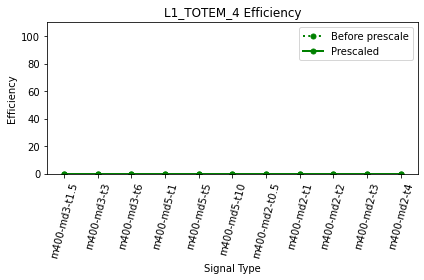

 92%|█████████▏| 294/321 [05:22<00:20,  1.31it/s]

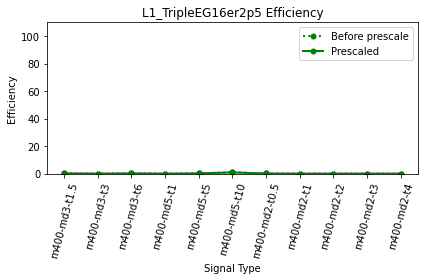

 92%|█████████▏| 295/321 [05:27<01:00,  2.31s/it]

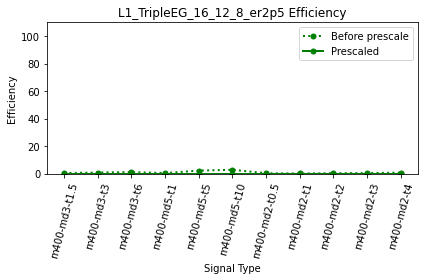

 92%|█████████▏| 296/321 [05:28<00:45,  1.84s/it]

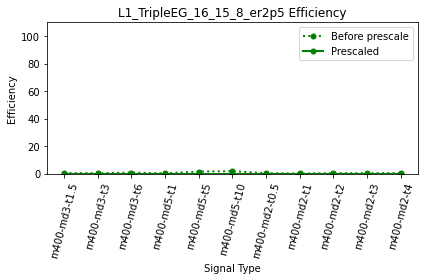

 93%|█████████▎| 297/321 [05:29<00:34,  1.45s/it]

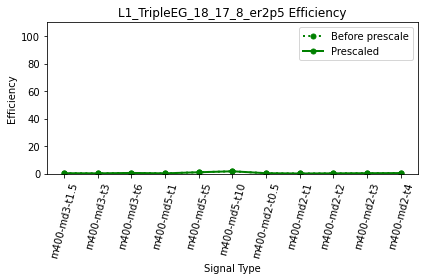

 93%|█████████▎| 298/321 [05:29<00:27,  1.18s/it]

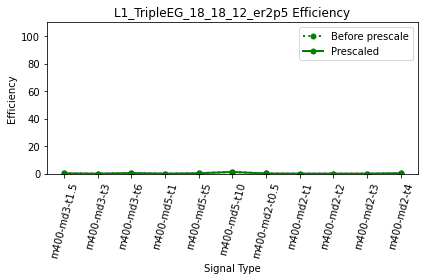

 93%|█████████▎| 299/321 [05:30<00:21,  1.00it/s]

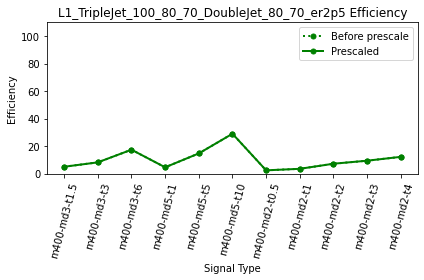

 93%|█████████▎| 300/321 [05:30<00:18,  1.16it/s]

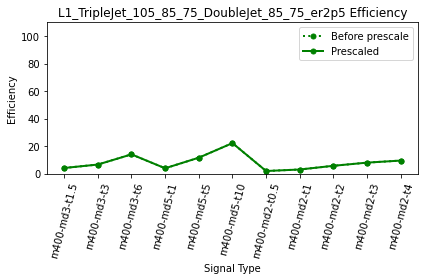

 94%|█████████▍| 301/321 [05:31<00:15,  1.28it/s]

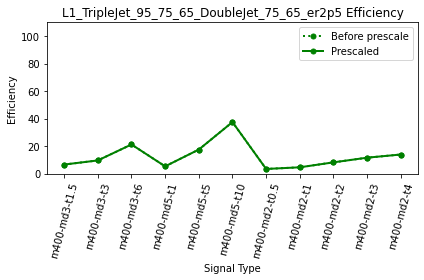

 94%|█████████▍| 302/321 [05:32<00:13,  1.38it/s]

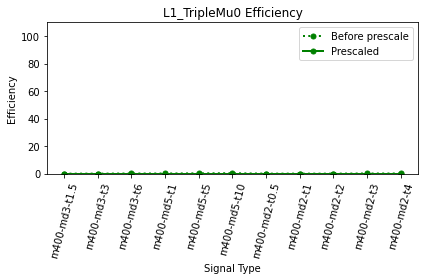

 94%|█████████▍| 303/321 [05:32<00:12,  1.42it/s]

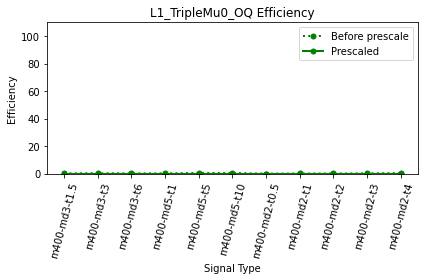

 95%|█████████▍| 304/321 [05:33<00:11,  1.52it/s]

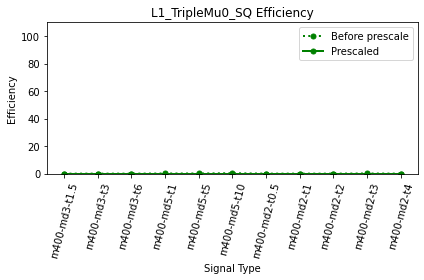

 95%|█████████▌| 305/321 [05:33<00:10,  1.48it/s]

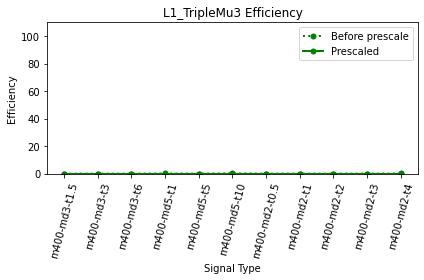

 95%|█████████▌| 306/321 [05:34<00:10,  1.37it/s]

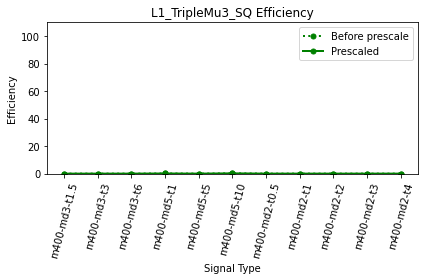

 96%|█████████▌| 307/321 [05:35<00:09,  1.40it/s]

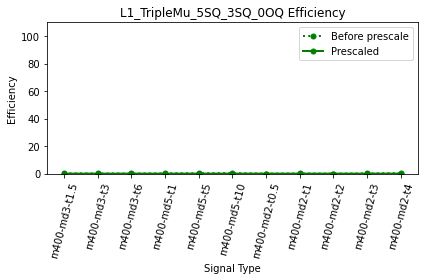

 96%|█████████▌| 308/321 [05:36<00:10,  1.26it/s]

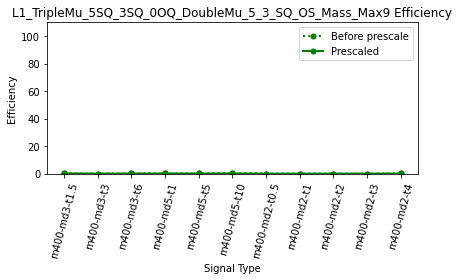

 96%|█████████▋| 309/321 [05:37<00:08,  1.35it/s]

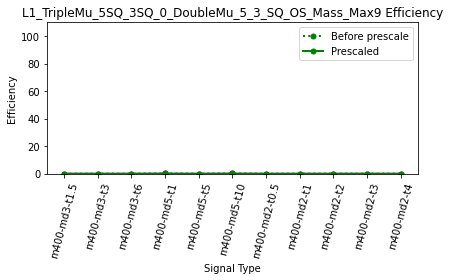

 97%|█████████▋| 310/321 [05:38<00:09,  1.21it/s]

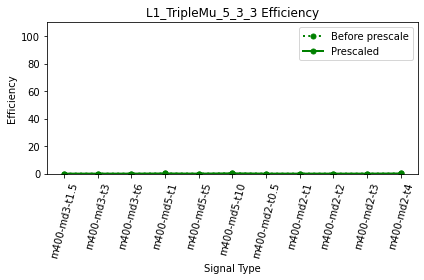

 97%|█████████▋| 311/321 [05:38<00:07,  1.33it/s]

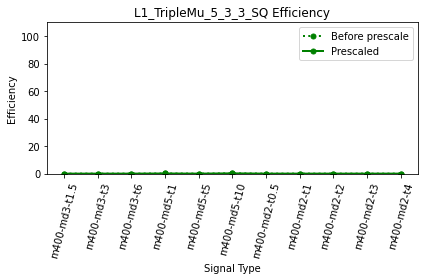

 97%|█████████▋| 312/321 [05:39<00:06,  1.30it/s]

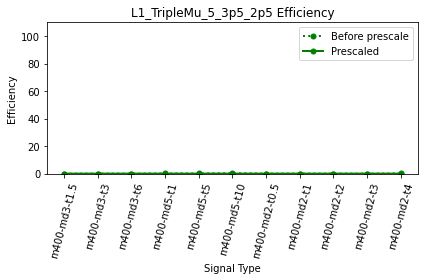

 98%|█████████▊| 313/321 [05:40<00:06,  1.32it/s]

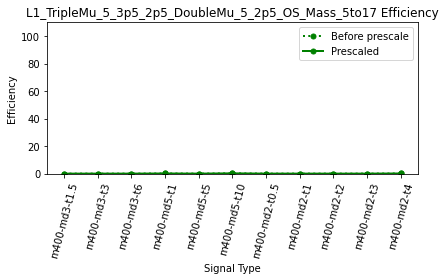

 98%|█████████▊| 314/321 [05:40<00:05,  1.37it/s]

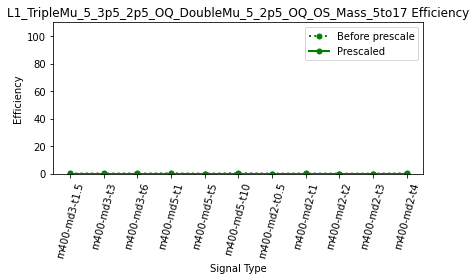

 98%|█████████▊| 315/321 [05:41<00:04,  1.43it/s]

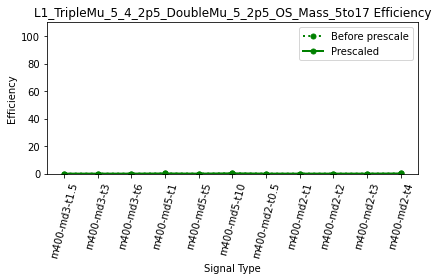

 98%|█████████▊| 316/321 [05:42<00:03,  1.53it/s]

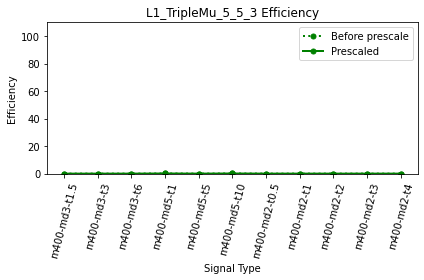

 99%|█████████▉| 317/321 [05:42<00:02,  1.58it/s]

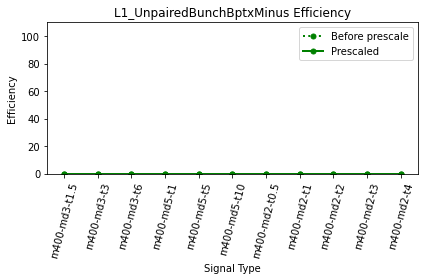

 99%|█████████▉| 318/321 [05:43<00:01,  1.56it/s]

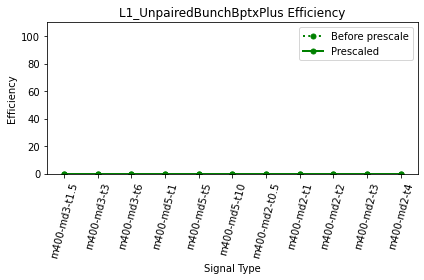

 99%|█████████▉| 319/321 [05:44<00:01,  1.47it/s]

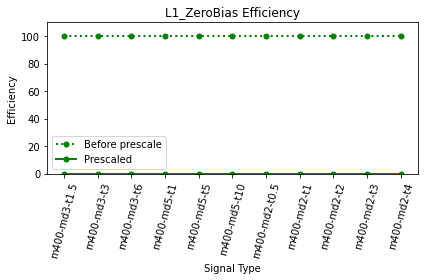

100%|█████████▉| 320/321 [05:44<00:00,  1.54it/s]

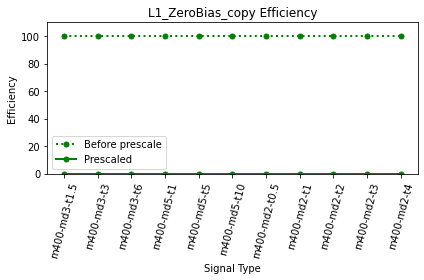

100%|██████████| 321/321 [05:45<00:00,  1.08s/it]


In [41]:
print('creating plots of trigger efficiencies.')
for trigger in tqdm(dic_trigger['0.5']):
    if trigger in list(data['Name']):
        PS = data.loc[data['Name'] == trigger, '2p20E+34'].values[0]
    else:
        PS = 0.0
    
    is_triggered_t0p5=dic_trigger['0.5'][trigger]
    ratio_t0p5=is_triggered_t0p5.sum()/len(is_triggered_t0p5)*100.0
    ratio_t0p5_prescaled=ratio_t0p5/PS if PS>0 else 0.0
    is_triggered_t1=dic_trigger['1'][trigger]
    ratio_t1=is_triggered_t1.sum()/len(is_triggered_t1)*100.0
    ratio_t1_prescaled=ratio_t1/PS if PS>0 else 0.0
    is_triggered_t2=dic_trigger['2'][trigger]
    ratio_t2=is_triggered_t2.sum()/len(is_triggered_t2)*100.0
    ratio_t2_prescaled=ratio_t2/PS if PS>0 else 0.0
    is_triggered_t3=dic_trigger['3'][trigger]
    ratio_t3=is_triggered_t3.sum()/len(is_triggered_t3)*100.0
    ratio_t3_prescaled=ratio_t3/PS if PS>0 else 0.0
    is_triggered_t4=dic_trigger['4'][trigger]
    ratio_t4=is_triggered_t4.sum()/len(is_triggered_t4)*100.0
    ratio_t4_prescaled=ratio_t4/PS if PS>0 else 0.0

    is_triggered_m400_md3_t1p5=dic_trigger_others['m400-md3-t1.5'][trigger]
    ratio_triggered_m400_md3_t1p5=is_triggered_m400_md3_t1p5.sum() / len(is_triggered_m400_md3_t1p5) * 100.0
    ratio_triggered_m400_md3_t1p5_prescaled=ratio_triggered_m400_md3_t1p5/PS if PS>0 else 0.0
    is_triggered_m400_md3_t3=dic_trigger_others['m400-md3-t3'][trigger]
    ratio_triggered_m400_md3_t3=is_triggered_m400_md3_t3.sum() / len(is_triggered_m400_md3_t3) * 100.0
    ratio_triggered_m400_md3_t3_prescaled=ratio_triggered_m400_md3_t3/PS if PS>0 else 0.0
    is_triggered_m400_md3_t6=dic_trigger_others['m400-md3-t6'][trigger]
    ratio_triggered_m400_md3_t6=is_triggered_m400_md3_t6.sum() / len(is_triggered_m400_md3_t6) * 100.0
    ratio_triggered_m400_md3_t6_prescaled=ratio_triggered_m400_md3_t6/PS if PS>0 else 0.0
    is_triggered_m400_md5_t1=dic_trigger_others['m400-md5-t1'][trigger]
    ratio_triggered_m400_md5_t1=is_triggered_m400_md5_t1.sum() / len(is_triggered_m400_md5_t1) * 100.0
    ratio_triggered_m400_md5_t1_prescaled=ratio_triggered_m400_md5_t1/PS if PS>0 else 0.0
    is_triggered_m400_md5_t5=dic_trigger_others['m400-md5-t5'][trigger]
    ratio_triggered_m400_md5_t5=is_triggered_m400_md5_t5.sum() / len(is_triggered_m400_md5_t5) * 100.0
    ratio_triggered_m400_md5_t5_prescaled=ratio_triggered_m400_md5_t5/PS if PS>0 else 0.0
    is_triggered_m400_md5_t10=dic_trigger_others['m400-md5-t10'][trigger]
    ratio_triggered_m400_md5_t10=is_triggered_m400_md5_t10.sum() / len(is_triggered_m400_md5_t10) * 100.0
    ratio_triggered_m400_md5_t10_prescaled=ratio_triggered_m400_md5_t10/PS if PS>0 else 0.0
    x_ticks=range(11)
    x_ticklabels=['m400-md3-t1.5','m400-md3-t3','m400-md3-t6','m400-md5-t1','m400-md5-t5','m400-md5-t10',
                  'm400-md2-t0.5','m400-md2-t1','m400-md2-t2','m400-md2-t3','m400-md2-t4']
    y_values=[ratio_triggered_m400_md3_t1p5,ratio_triggered_m400_md3_t3,ratio_triggered_m400_md3_t6,
              ratio_triggered_m400_md5_t1,ratio_triggered_m400_md5_t5,ratio_triggered_m400_md5_t10,
              ratio_t0p5,ratio_t1,ratio_t2,ratio_t3,ratio_t4]
    y_values_prescaled=[ratio_triggered_m400_md3_t1p5_prescaled,ratio_triggered_m400_md3_t3_prescaled,ratio_triggered_m400_md3_t6_prescaled,
              ratio_triggered_m400_md5_t1_prescaled,ratio_triggered_m400_md5_t5_prescaled,ratio_triggered_m400_md5_t10_prescaled,
              ratio_t0p5_prescaled,ratio_t1_prescaled,ratio_t2_prescaled,ratio_t3_prescaled,ratio_t4_prescaled]
    plt.xticks(x_ticks, x_ticklabels,rotation = 75)
    plt.plot(x_ticks,y_values,color='green', marker='o', linestyle='dotted',
     linewidth=2, markersize=5,label="Before prescale")
    plt.plot(x_ticks,y_values_prescaled,color='green', marker='o', linestyle='solid',
     linewidth=2, markersize=5,label="Prescaled")
    plt.xlabel('Signal Type')
    plt.ylabel('Efficiency')
    plt.ylim([0,110])
    plt.title('{} Efficiency'.format(trigger))
    plt.legend()
    plt.tight_layout()
    plt.savefig('eff_all/{}_eff.png'.format(trigger))
    plt.savefig('eff_all/{}_eff.pdf'.format(trigger))
    plt.show()

creating plots of trigger efficiencies.


  0%|          | 0/321 [00:00<?, ?it/s]

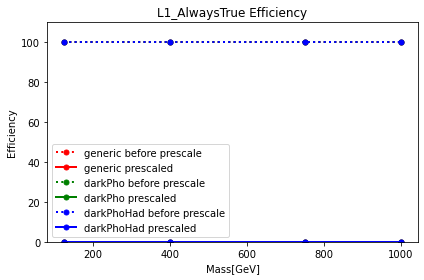

  0%|          | 1/321 [00:00<05:13,  1.02it/s]

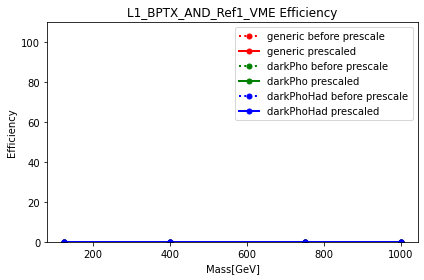

  1%|          | 2/321 [00:01<04:25,  1.20it/s]

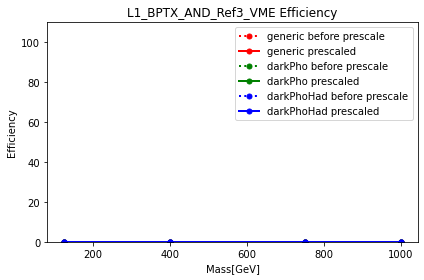

  1%|          | 3/321 [00:02<04:40,  1.13it/s]

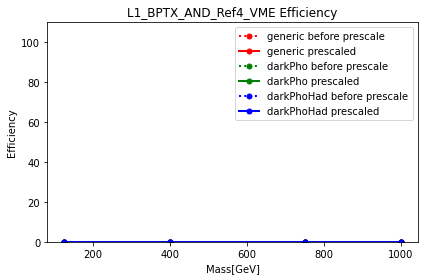

  1%|          | 4/321 [00:03<05:02,  1.05it/s]

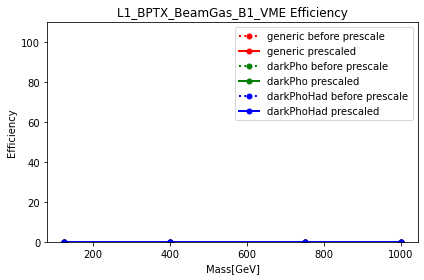

  2%|▏         | 5/321 [00:04<05:16,  1.00s/it]

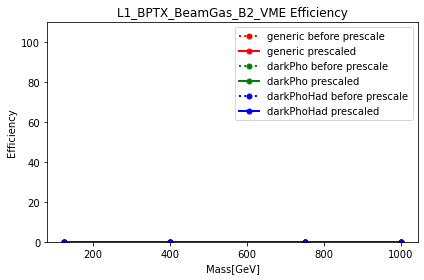

  2%|▏         | 6/321 [00:05<05:16,  1.01s/it]

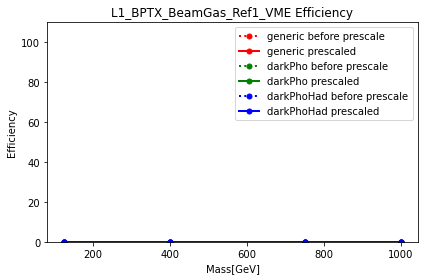

  2%|▏         | 7/321 [00:06<05:05,  1.03it/s]

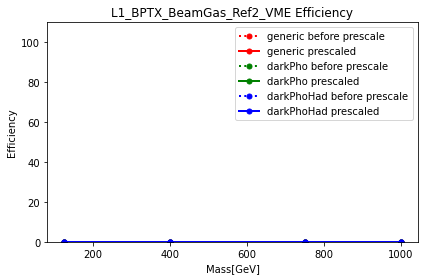

  2%|▏         | 8/321 [00:07<04:46,  1.09it/s]

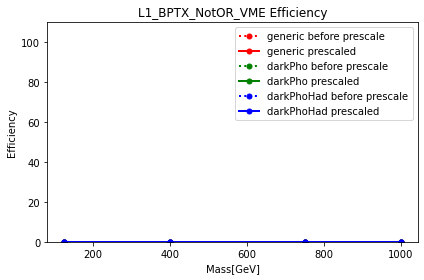

  3%|▎         | 9/321 [00:08<04:24,  1.18it/s]

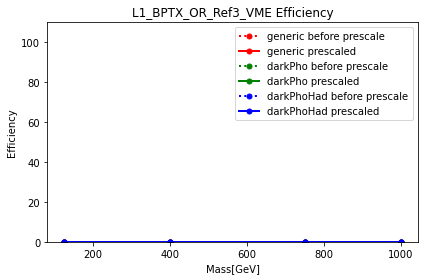

  3%|▎         | 10/321 [00:08<04:06,  1.26it/s]

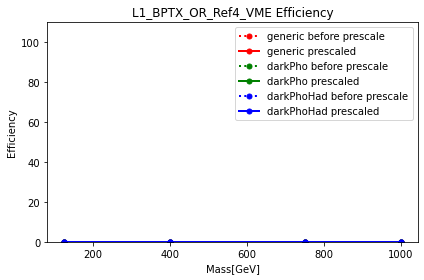

  3%|▎         | 11/321 [00:09<04:18,  1.20it/s]

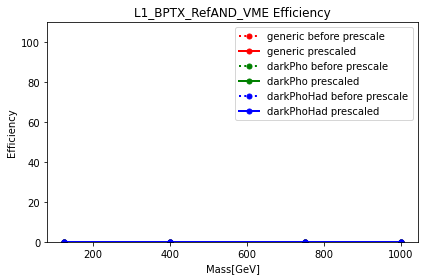

  4%|▎         | 12/321 [00:10<04:23,  1.17it/s]

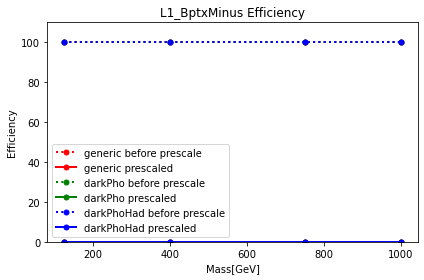

  4%|▍         | 13/321 [00:11<04:12,  1.22it/s]

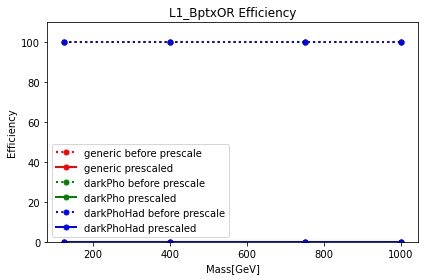

  4%|▍         | 14/321 [00:12<03:58,  1.29it/s]

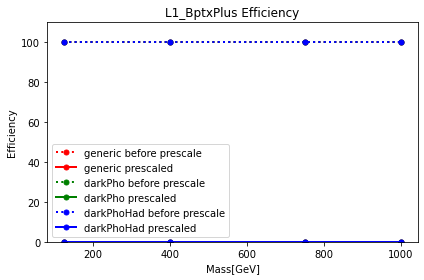

  5%|▍         | 15/321 [00:12<03:55,  1.30it/s]

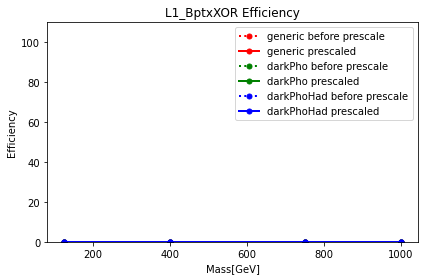

  5%|▍         | 16/321 [00:13<03:51,  1.32it/s]

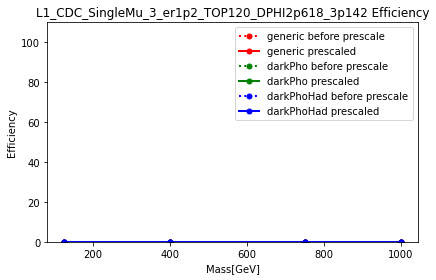

  5%|▌         | 17/321 [00:14<04:39,  1.09it/s]

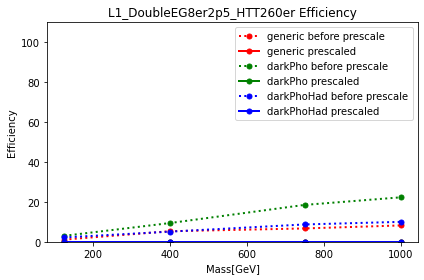

  6%|▌         | 18/321 [00:15<04:25,  1.14it/s]

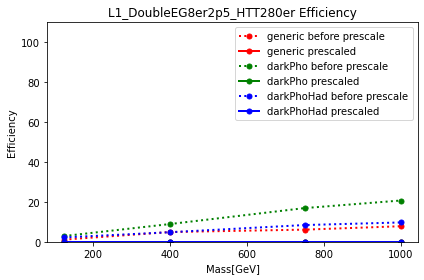

  6%|▌         | 19/321 [00:16<04:19,  1.16it/s]

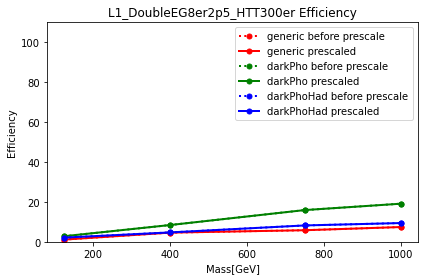

  6%|▌         | 20/321 [00:17<04:14,  1.18it/s]

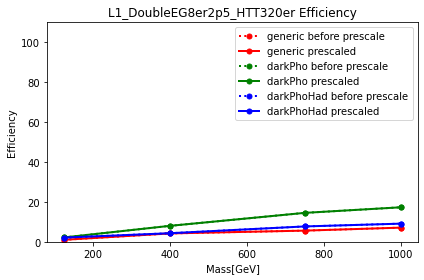

  7%|▋         | 21/321 [00:18<04:13,  1.19it/s]

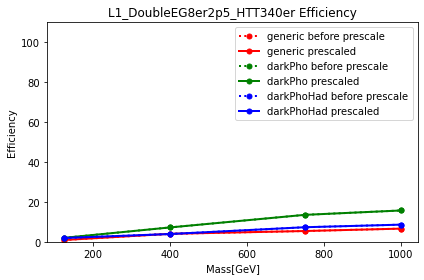

  7%|▋         | 22/321 [00:19<04:28,  1.12it/s]

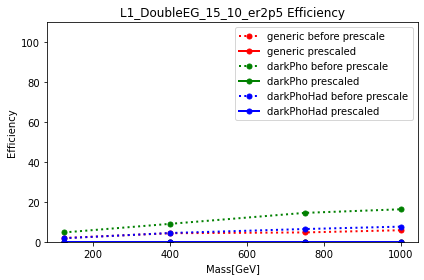

  7%|▋         | 23/321 [00:19<04:20,  1.15it/s]

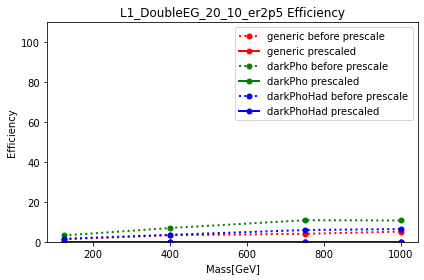

  7%|▋         | 24/321 [00:20<04:22,  1.13it/s]

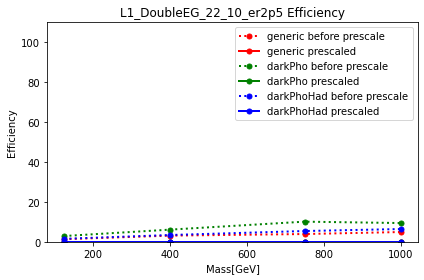

  8%|▊         | 25/321 [00:21<04:03,  1.22it/s]

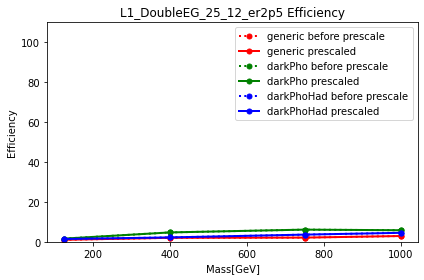

  8%|▊         | 26/321 [00:22<04:23,  1.12it/s]

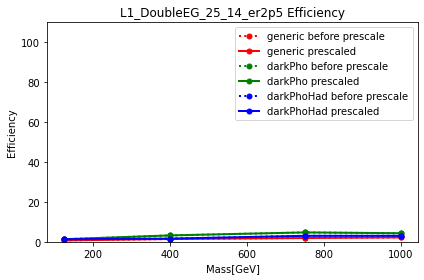

  8%|▊         | 27/321 [00:23<04:15,  1.15it/s]

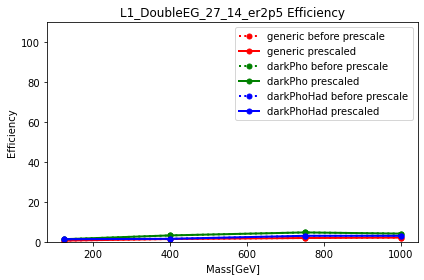

  9%|▊         | 28/321 [00:24<05:09,  1.06s/it]

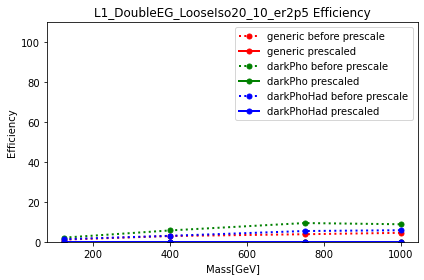

  9%|▉         | 29/321 [00:25<05:06,  1.05s/it]

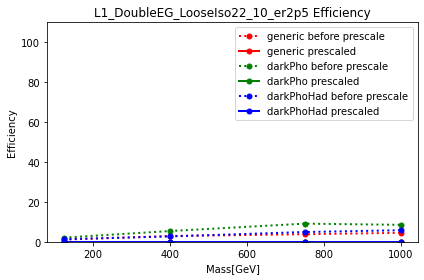

  9%|▉         | 30/321 [00:26<04:49,  1.01it/s]

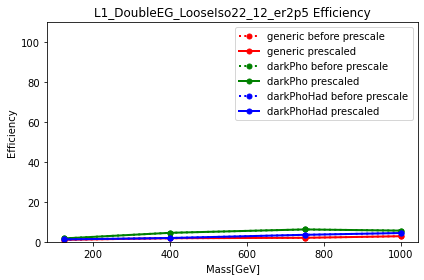

 10%|▉         | 31/321 [00:27<04:51,  1.01s/it]

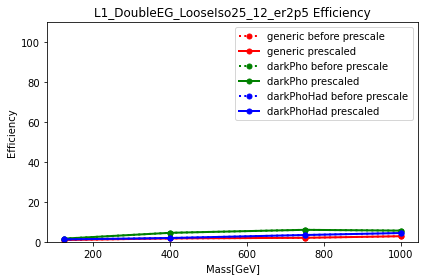

 10%|▉         | 32/321 [00:28<04:43,  1.02it/s]

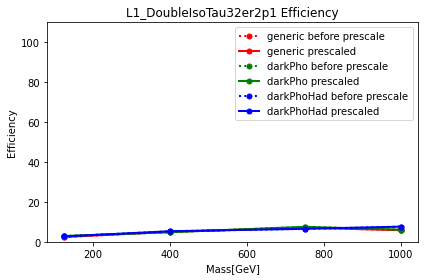

 10%|█         | 33/321 [00:29<04:16,  1.12it/s]

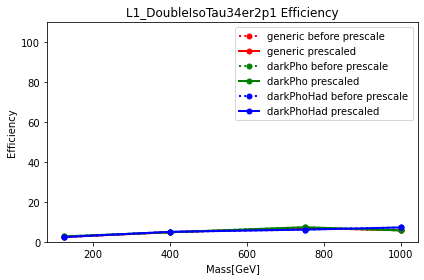

 11%|█         | 34/321 [00:30<04:02,  1.18it/s]

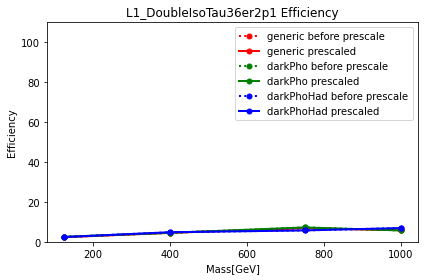

 11%|█         | 35/321 [00:30<03:51,  1.24it/s]

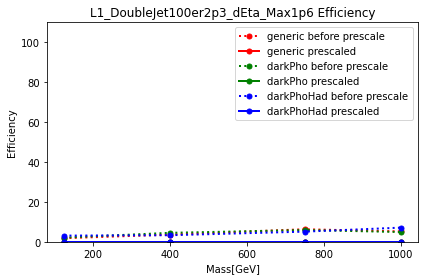

 11%|█         | 36/321 [00:31<03:55,  1.21it/s]

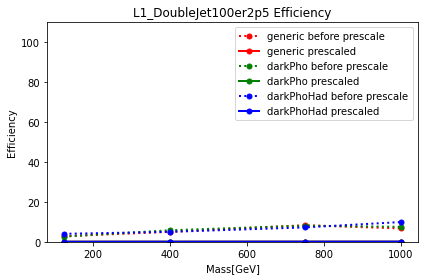

 12%|█▏        | 37/321 [00:32<03:59,  1.19it/s]

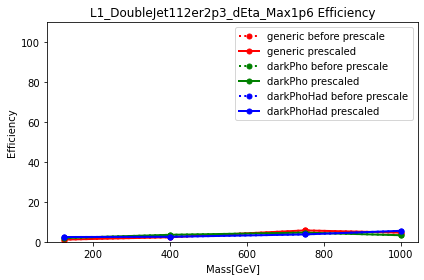

 12%|█▏        | 38/321 [00:33<04:01,  1.17it/s]

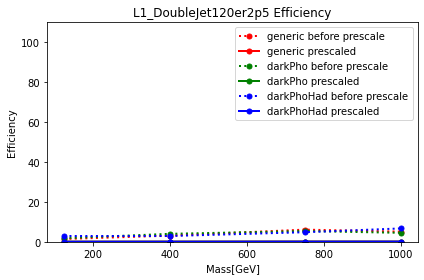

 12%|█▏        | 39/321 [00:34<03:51,  1.22it/s]

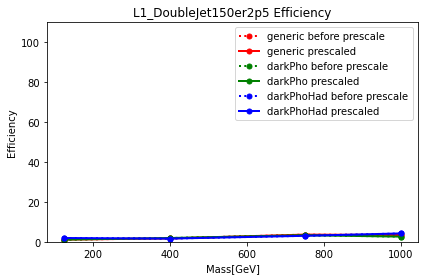

 12%|█▏        | 40/321 [00:35<04:20,  1.08it/s]

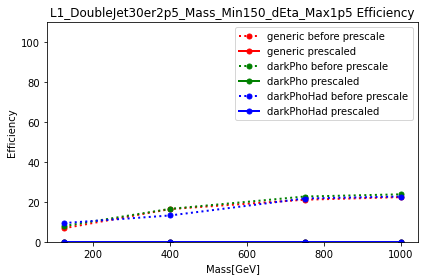

 13%|█▎        | 41/321 [00:36<04:09,  1.12it/s]

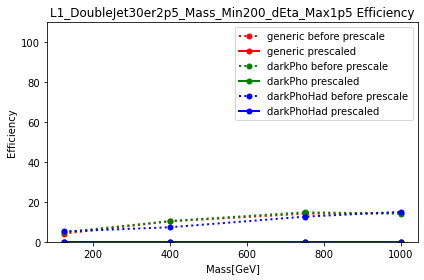

 13%|█▎        | 42/321 [00:37<04:16,  1.09it/s]

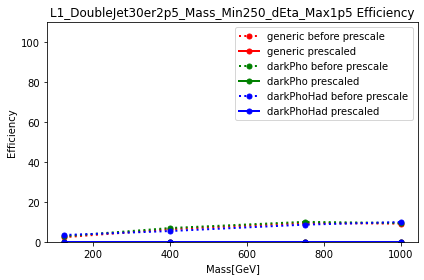

 13%|█▎        | 43/321 [00:38<04:09,  1.12it/s]

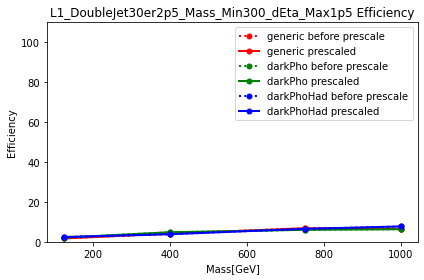

 14%|█▎        | 44/321 [00:39<04:08,  1.11it/s]

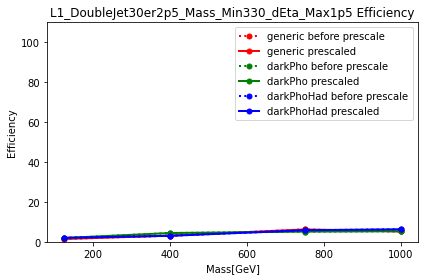

 14%|█▍        | 45/321 [00:39<04:05,  1.13it/s]

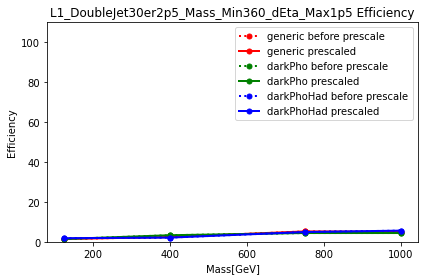

 14%|█▍        | 46/321 [00:40<04:06,  1.12it/s]

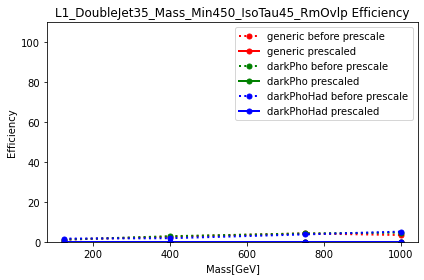

 15%|█▍        | 47/321 [00:41<03:41,  1.24it/s]

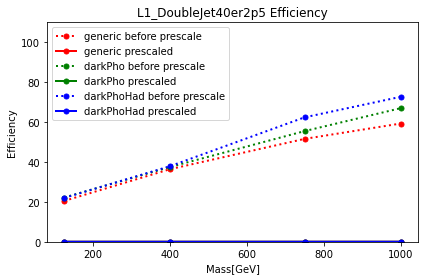

 15%|█▍        | 48/321 [00:42<04:09,  1.09it/s]

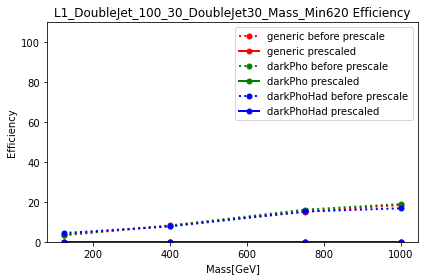

 15%|█▌        | 49/321 [00:43<04:01,  1.13it/s]

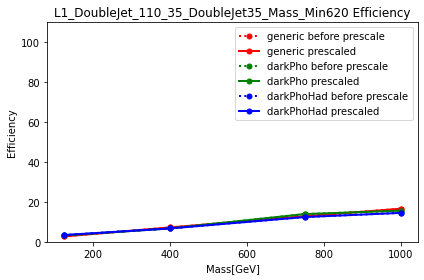

 16%|█▌        | 50/321 [00:44<03:59,  1.13it/s]

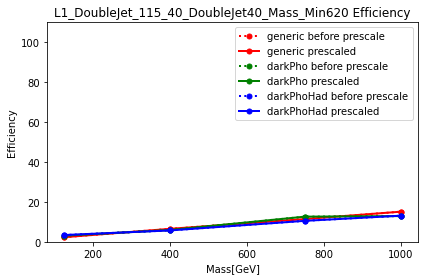

 16%|█▌        | 51/321 [00:45<04:02,  1.11it/s]

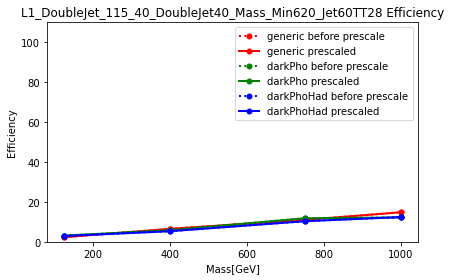

 16%|█▌        | 52/321 [00:46<03:56,  1.14it/s]

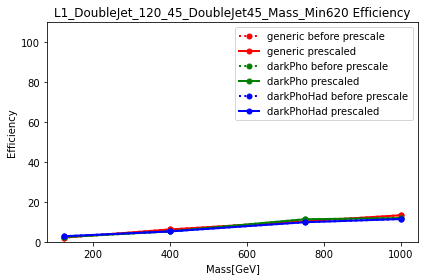

 17%|█▋        | 53/321 [00:46<03:32,  1.26it/s]

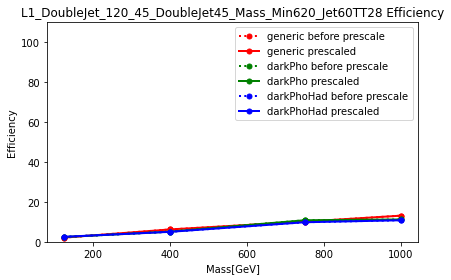

 17%|█▋        | 54/321 [00:47<03:37,  1.23it/s]

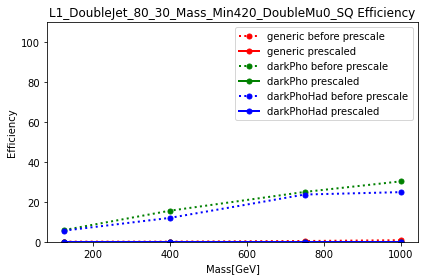

 17%|█▋        | 55/321 [00:48<03:49,  1.16it/s]

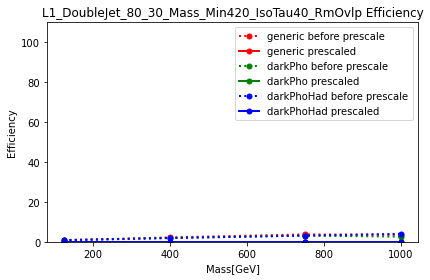

 17%|█▋        | 56/321 [00:49<04:05,  1.08it/s]

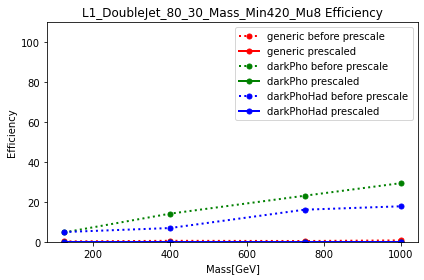

 18%|█▊        | 57/321 [00:50<03:53,  1.13it/s]

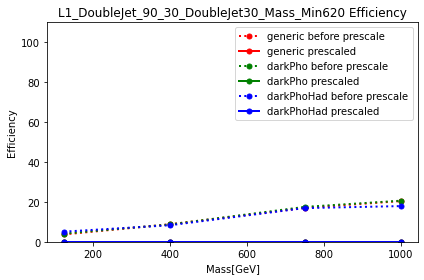

 18%|█▊        | 58/321 [00:51<03:59,  1.10it/s]

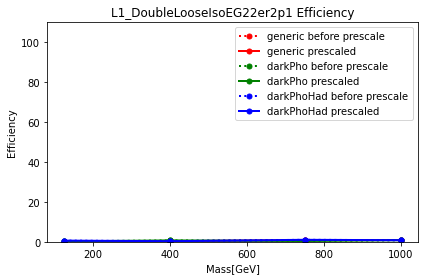

 18%|█▊        | 59/321 [00:52<04:08,  1.05it/s]

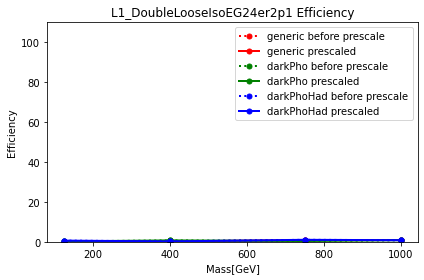

 19%|█▊        | 60/321 [00:53<03:56,  1.10it/s]

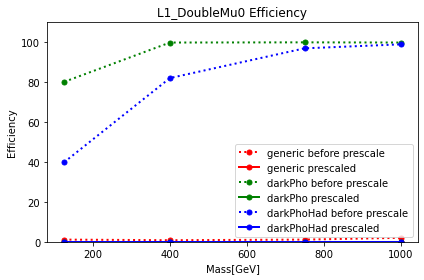

 19%|█▉        | 61/321 [00:53<03:44,  1.16it/s]

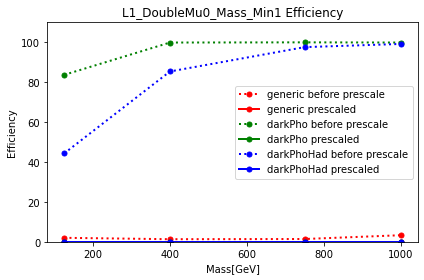

 19%|█▉        | 62/321 [00:54<03:39,  1.18it/s]

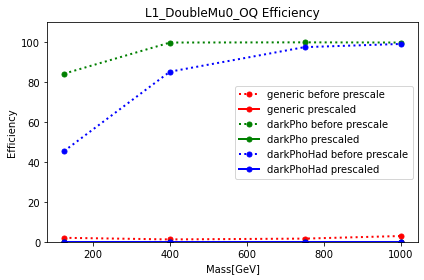

 20%|█▉        | 63/321 [00:55<03:29,  1.23it/s]

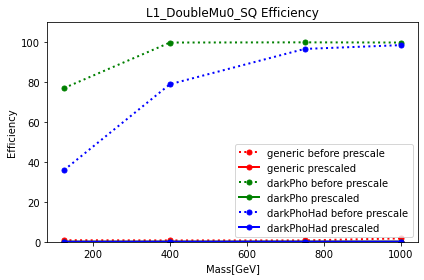

 20%|█▉        | 64/321 [00:56<04:00,  1.07it/s]

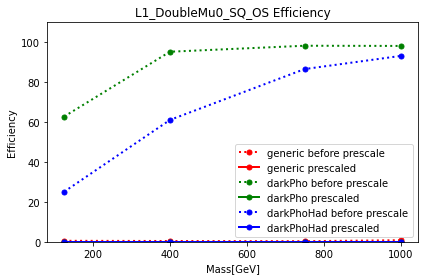

 20%|██        | 65/321 [00:57<03:46,  1.13it/s]

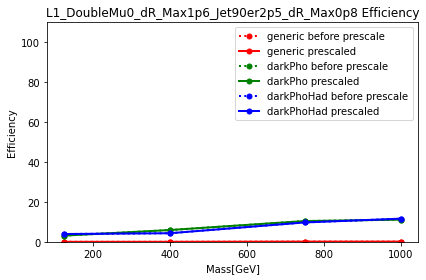

 21%|██        | 66/321 [00:58<03:40,  1.16it/s]

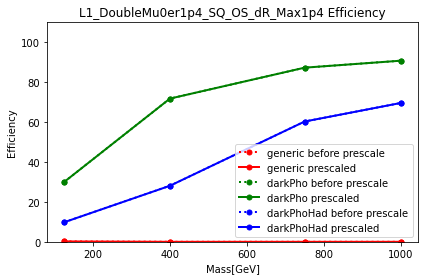

 21%|██        | 67/321 [00:59<03:31,  1.20it/s]

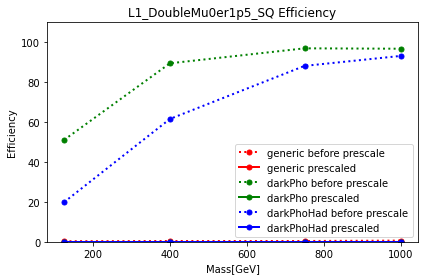

 21%|██        | 68/321 [00:59<03:20,  1.26it/s]

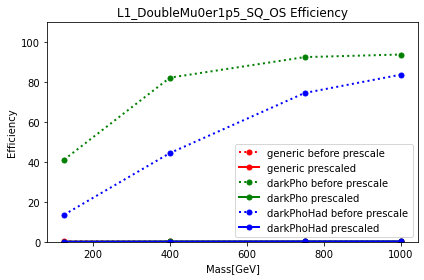

 21%|██▏       | 69/321 [01:00<03:33,  1.18it/s]

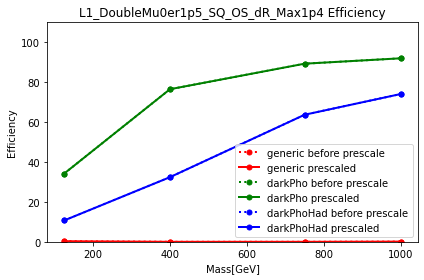

 22%|██▏       | 70/321 [01:02<04:14,  1.01s/it]

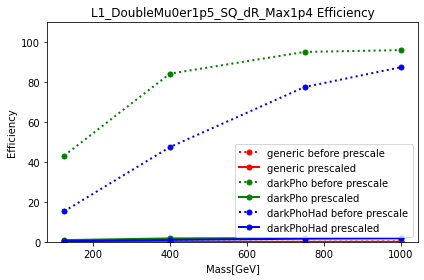

 22%|██▏       | 71/321 [01:02<03:56,  1.06it/s]

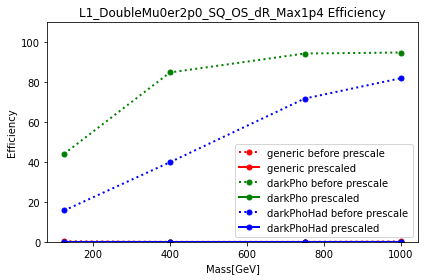

 22%|██▏       | 72/321 [01:03<03:49,  1.09it/s]

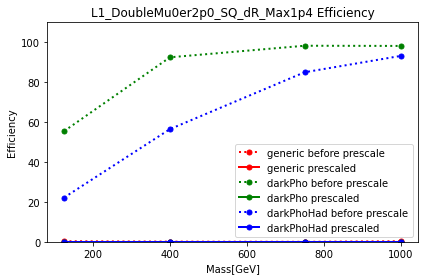

 23%|██▎       | 73/321 [01:04<03:30,  1.18it/s]

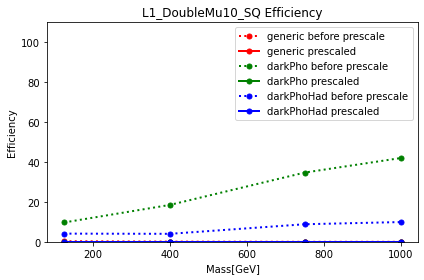

 23%|██▎       | 74/321 [01:05<03:31,  1.17it/s]

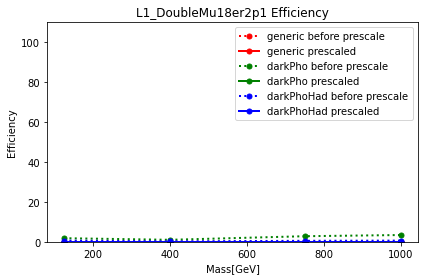

 23%|██▎       | 75/321 [01:05<03:11,  1.29it/s]

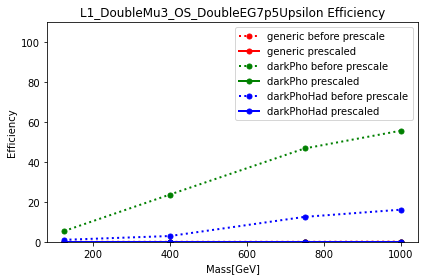

 24%|██▎       | 76/321 [01:06<03:06,  1.31it/s]

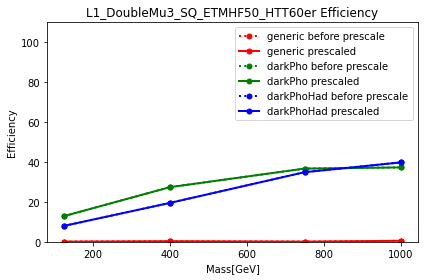

 24%|██▍       | 77/321 [01:07<03:07,  1.30it/s]

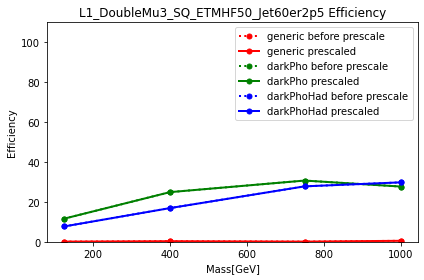

 24%|██▍       | 78/321 [01:08<03:09,  1.28it/s]

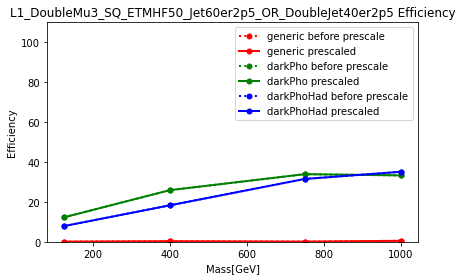

 25%|██▍       | 79/321 [01:08<03:00,  1.34it/s]

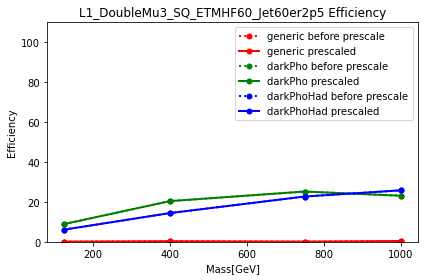

 25%|██▍       | 80/321 [01:09<03:04,  1.31it/s]

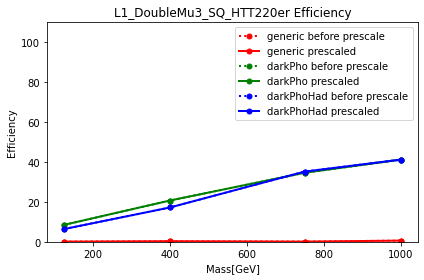

 25%|██▌       | 81/321 [01:10<03:00,  1.33it/s]

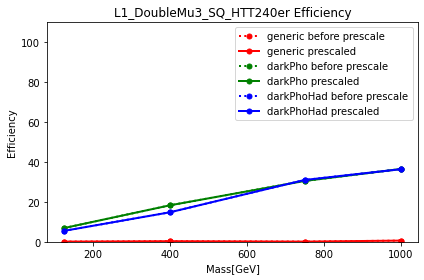

 26%|██▌       | 82/321 [01:11<02:55,  1.36it/s]

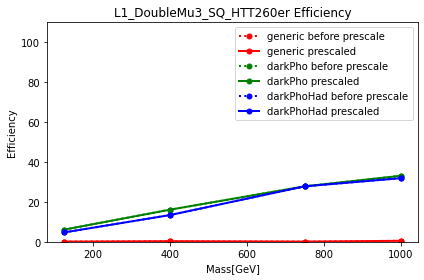

 26%|██▌       | 83/321 [01:12<03:07,  1.27it/s]

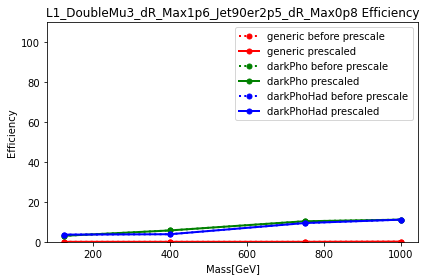

 26%|██▌       | 84/321 [01:12<03:00,  1.31it/s]

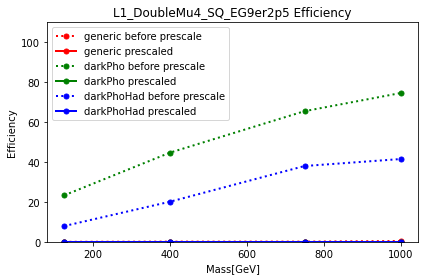

 26%|██▋       | 85/321 [01:13<03:01,  1.30it/s]

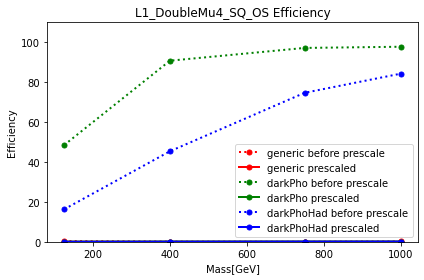

 27%|██▋       | 86/321 [01:14<03:04,  1.28it/s]

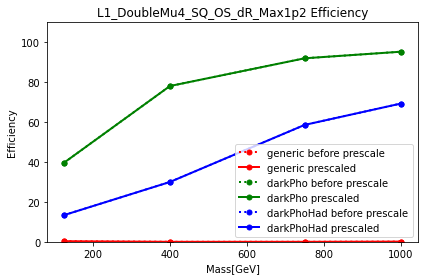

 27%|██▋       | 87/321 [01:15<02:59,  1.30it/s]

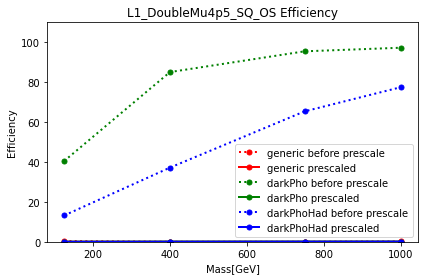

 27%|██▋       | 88/321 [01:15<03:04,  1.26it/s]

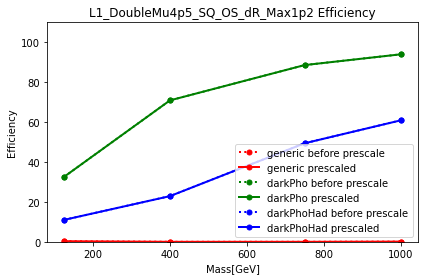

 28%|██▊       | 89/321 [01:16<03:05,  1.25it/s]

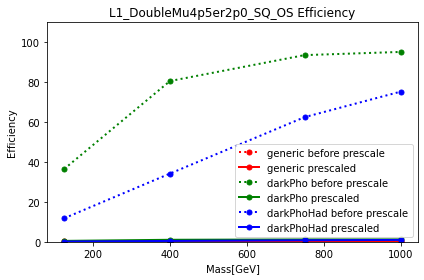

 28%|██▊       | 90/321 [01:17<02:55,  1.31it/s]

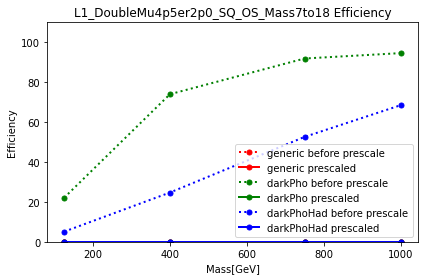

 28%|██▊       | 91/321 [01:18<02:49,  1.35it/s]

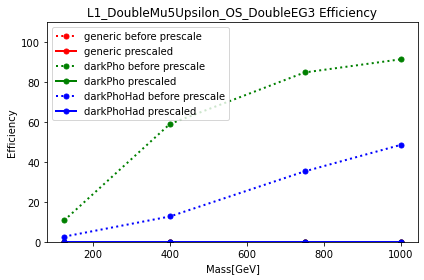

 29%|██▊       | 92/321 [01:18<02:52,  1.33it/s]

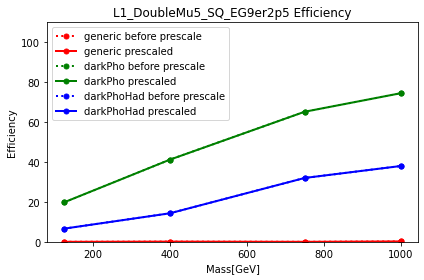

 29%|██▉       | 93/321 [01:19<02:53,  1.32it/s]

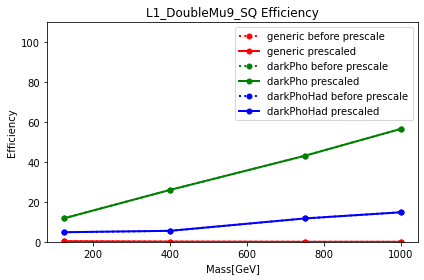

 29%|██▉       | 94/321 [01:20<02:52,  1.31it/s]

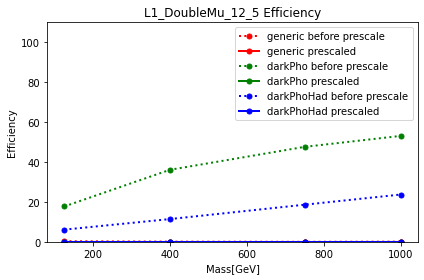

 30%|██▉       | 95/321 [01:21<02:48,  1.34it/s]

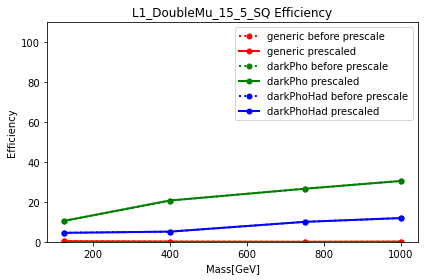

 30%|██▉       | 96/321 [01:22<03:51,  1.03s/it]

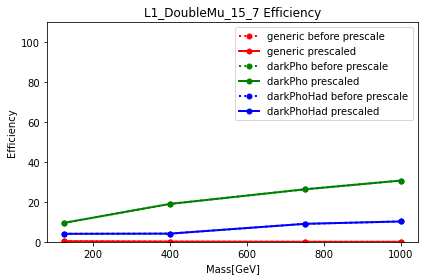

 30%|███       | 97/321 [01:23<03:21,  1.11it/s]

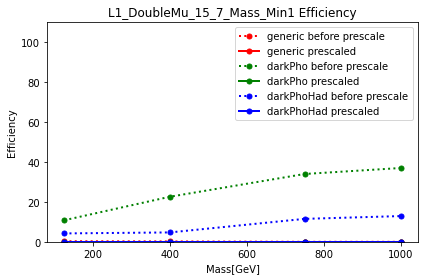

 31%|███       | 98/321 [01:24<03:32,  1.05it/s]

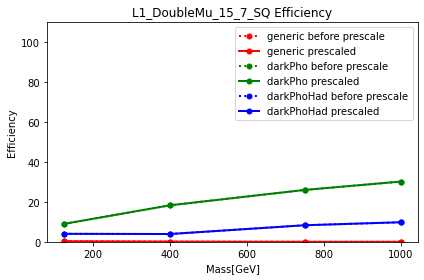

 31%|███       | 99/321 [01:25<03:13,  1.15it/s]

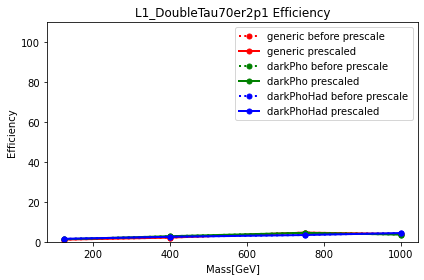

 31%|███       | 100/321 [01:25<02:59,  1.23it/s]

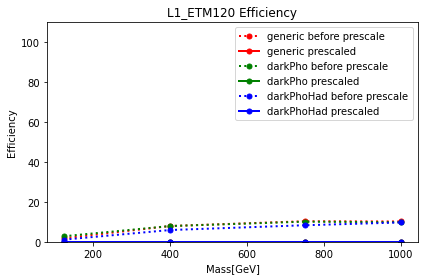

 31%|███▏      | 101/321 [01:26<02:45,  1.33it/s]

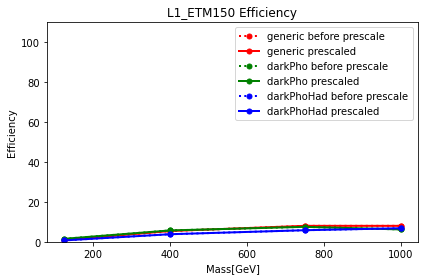

 32%|███▏      | 102/321 [01:27<02:36,  1.40it/s]

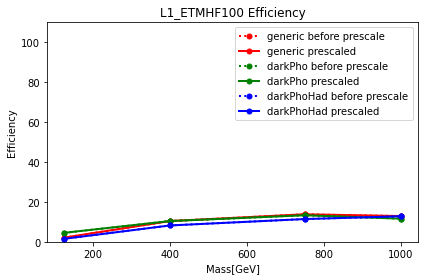

 32%|███▏      | 103/321 [01:27<02:40,  1.35it/s]

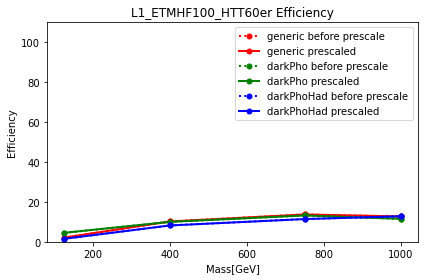

 32%|███▏      | 104/321 [01:28<02:50,  1.27it/s]

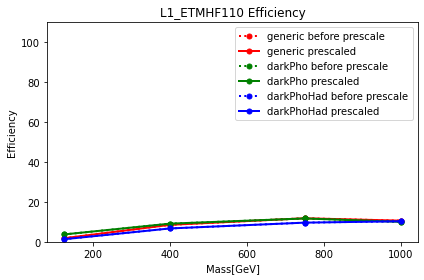

 33%|███▎      | 105/321 [01:29<02:44,  1.31it/s]

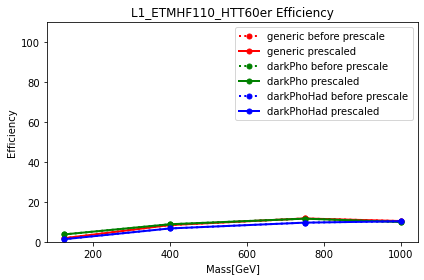

 33%|███▎      | 106/321 [01:30<02:37,  1.36it/s]

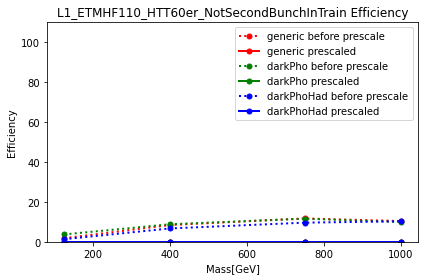

 33%|███▎      | 107/321 [01:31<02:46,  1.29it/s]

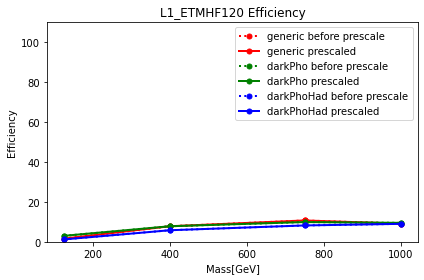

 34%|███▎      | 108/321 [01:31<02:40,  1.33it/s]

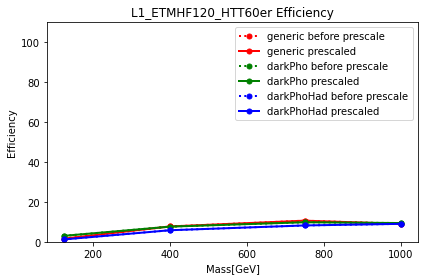

 34%|███▍      | 109/321 [01:32<02:38,  1.34it/s]

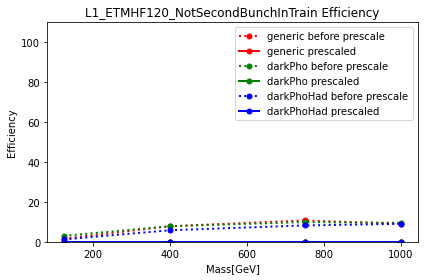

 34%|███▍      | 110/321 [01:33<02:40,  1.31it/s]

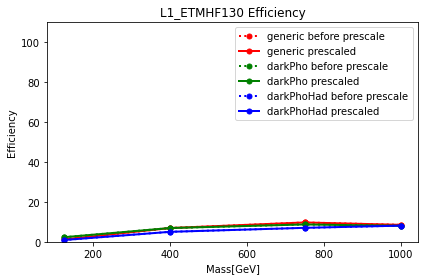

 35%|███▍      | 111/321 [01:33<02:37,  1.33it/s]

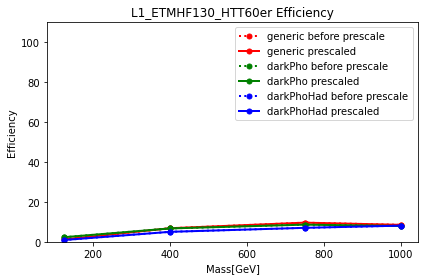

 35%|███▍      | 112/321 [01:34<02:26,  1.43it/s]

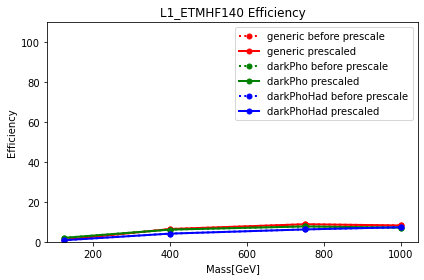

 35%|███▌      | 113/321 [01:35<02:26,  1.42it/s]

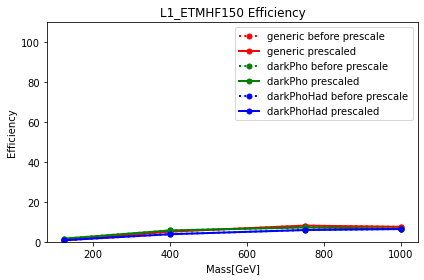

 36%|███▌      | 114/321 [01:35<02:27,  1.41it/s]

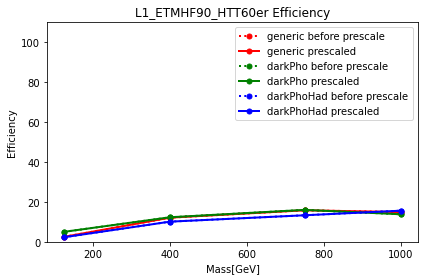

 36%|███▌      | 115/321 [01:36<02:29,  1.38it/s]

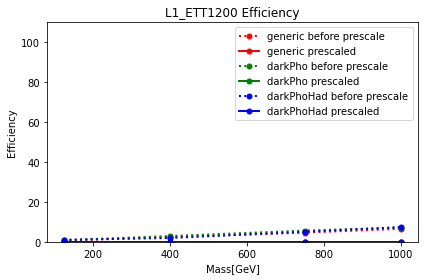

 36%|███▌      | 116/321 [01:37<02:20,  1.45it/s]

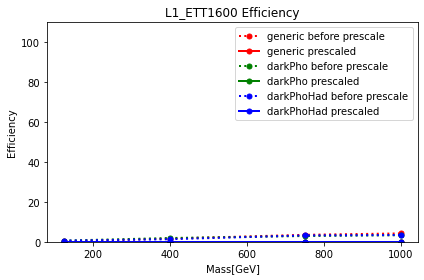

 36%|███▋      | 117/321 [01:37<02:17,  1.48it/s]

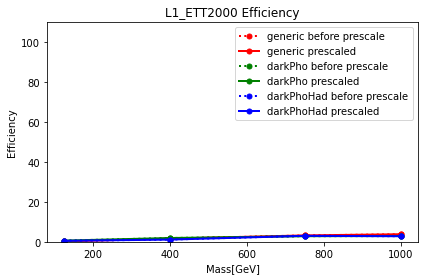

 37%|███▋      | 118/321 [01:38<02:23,  1.41it/s]

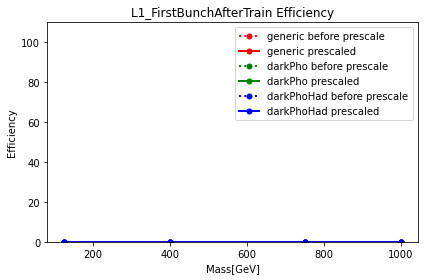

 37%|███▋      | 119/321 [01:39<02:19,  1.45it/s]

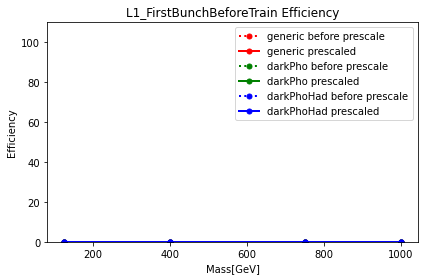

 37%|███▋      | 120/321 [01:40<02:16,  1.47it/s]

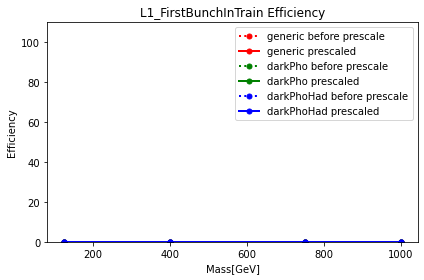

 38%|███▊      | 121/321 [01:40<02:09,  1.54it/s]

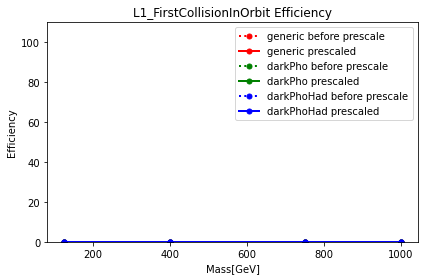

 38%|███▊      | 122/321 [01:41<02:18,  1.44it/s]

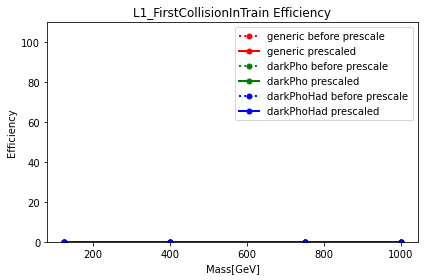

 38%|███▊      | 123/321 [01:41<02:08,  1.55it/s]

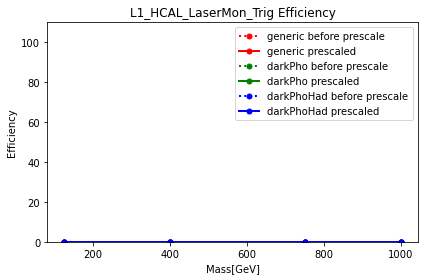

 39%|███▊      | 124/321 [01:43<02:32,  1.30it/s]

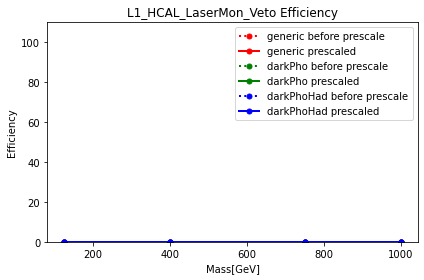

 39%|███▉      | 125/321 [01:43<02:34,  1.27it/s]

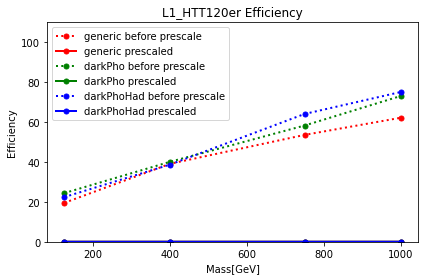

 39%|███▉      | 126/321 [01:44<02:31,  1.29it/s]

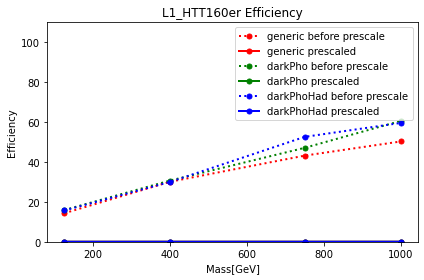

 40%|███▉      | 127/321 [01:45<03:03,  1.06it/s]

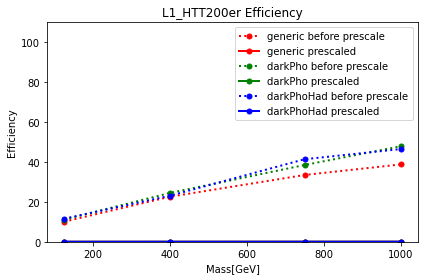

 40%|███▉      | 128/321 [01:46<02:40,  1.20it/s]

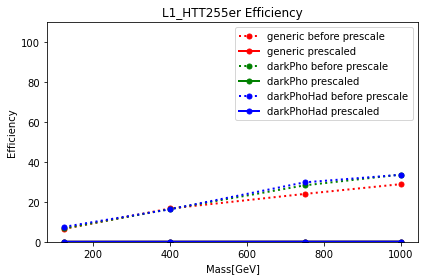

 40%|████      | 129/321 [01:47<02:28,  1.29it/s]

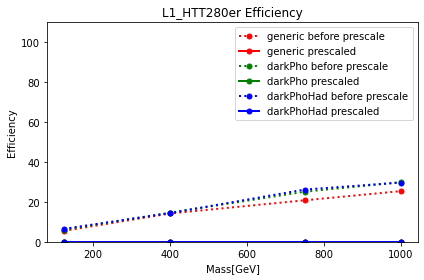

 40%|████      | 130/321 [01:47<02:27,  1.30it/s]

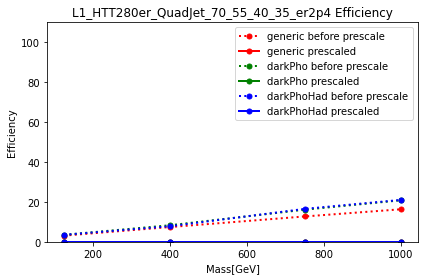

 41%|████      | 131/321 [01:48<02:18,  1.37it/s]

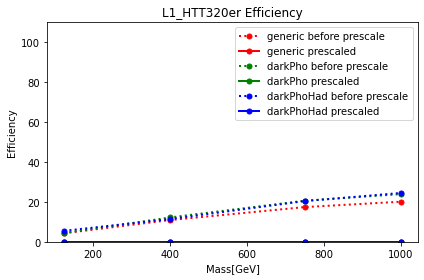

 41%|████      | 132/321 [01:49<02:24,  1.31it/s]

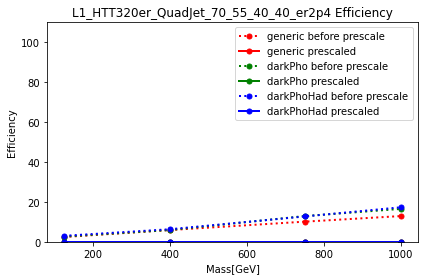

 41%|████▏     | 133/321 [01:50<02:14,  1.40it/s]

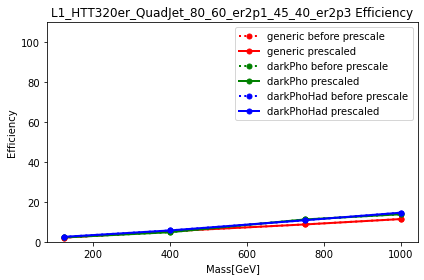

 42%|████▏     | 134/321 [01:50<02:11,  1.42it/s]

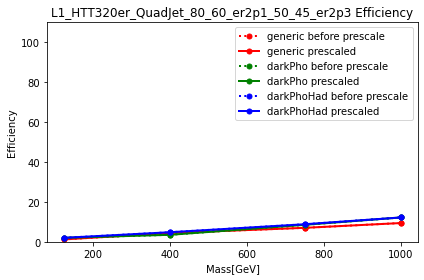

 42%|████▏     | 135/321 [01:51<02:09,  1.43it/s]

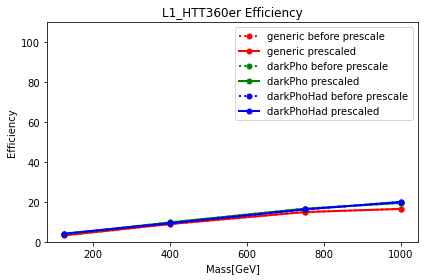

 42%|████▏     | 136/321 [01:52<02:11,  1.40it/s]

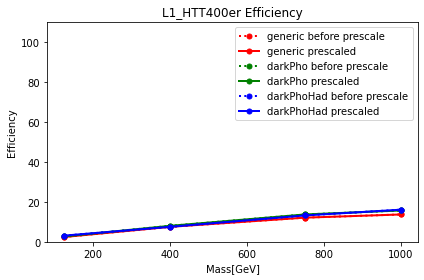

 43%|████▎     | 137/321 [01:53<02:20,  1.31it/s]

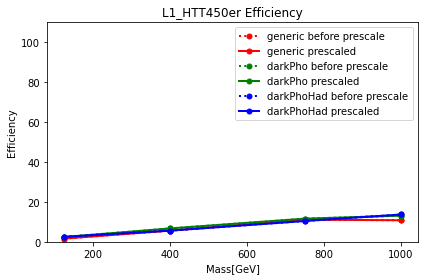

 43%|████▎     | 138/321 [01:53<02:20,  1.30it/s]

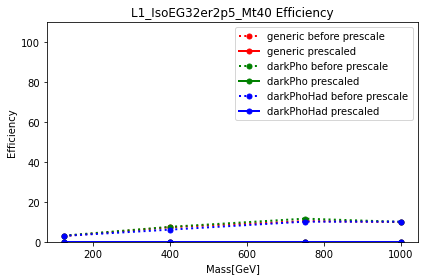

 43%|████▎     | 139/321 [01:54<02:27,  1.24it/s]

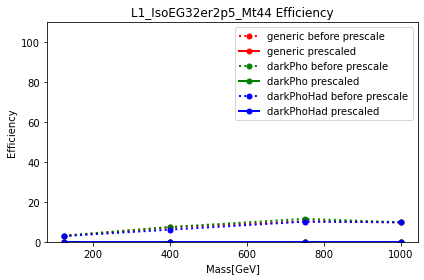

 44%|████▎     | 140/321 [01:55<02:24,  1.26it/s]

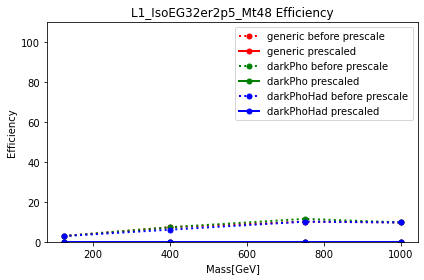

 44%|████▍     | 141/321 [01:56<02:15,  1.33it/s]

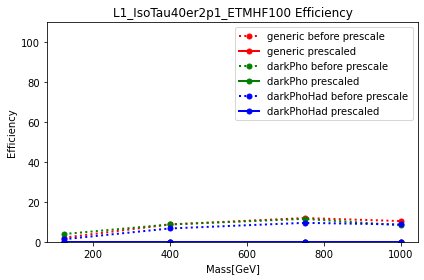

 44%|████▍     | 142/321 [01:56<02:10,  1.37it/s]

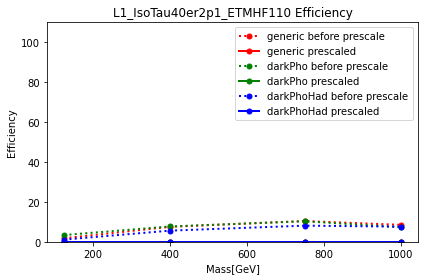

 45%|████▍     | 143/321 [01:57<01:59,  1.49it/s]

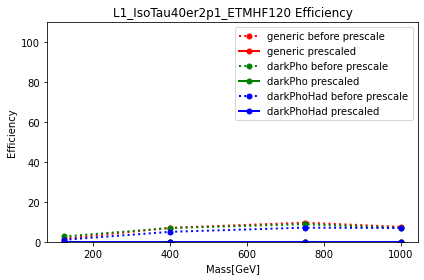

 45%|████▍     | 144/321 [01:57<01:57,  1.50it/s]

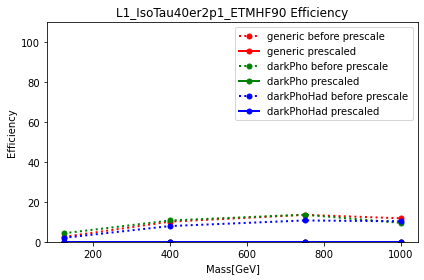

 45%|████▌     | 145/321 [01:58<02:06,  1.40it/s]

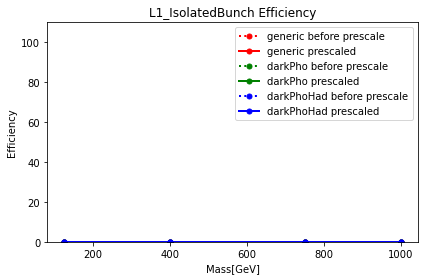

 45%|████▌     | 146/321 [01:59<01:57,  1.49it/s]

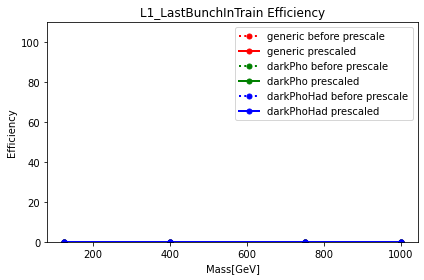

 46%|████▌     | 147/321 [02:00<02:04,  1.40it/s]

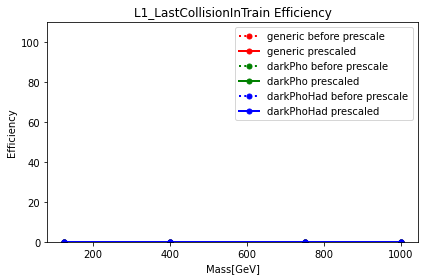

 46%|████▌     | 148/321 [02:00<02:02,  1.42it/s]

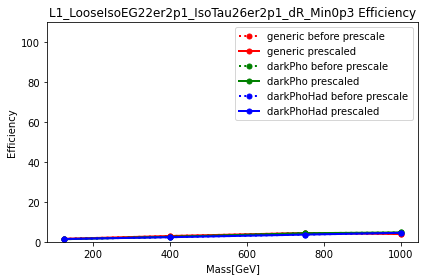

 46%|████▋     | 149/321 [02:01<01:57,  1.46it/s]

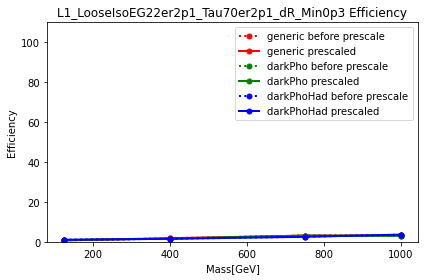

 47%|████▋     | 150/321 [02:03<02:40,  1.06it/s]

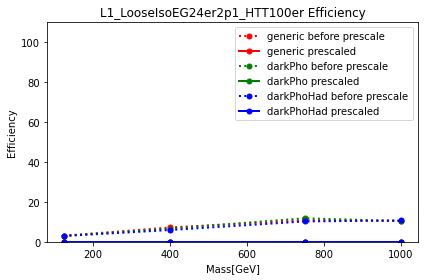

 47%|████▋     | 151/321 [02:03<02:34,  1.10it/s]

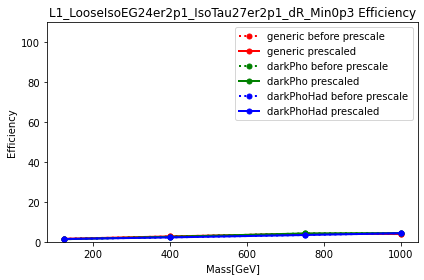

 47%|████▋     | 152/321 [02:04<02:22,  1.18it/s]

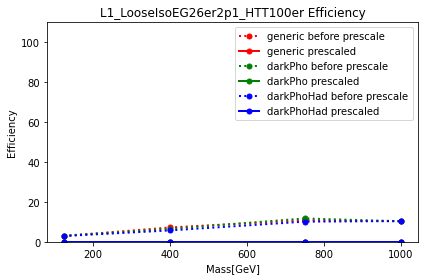

 48%|████▊     | 153/321 [02:05<02:13,  1.26it/s]

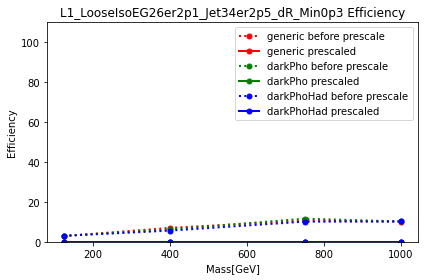

 48%|████▊     | 154/321 [02:06<02:21,  1.18it/s]

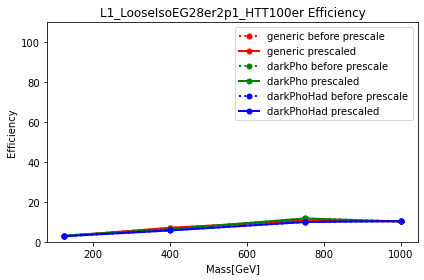

 48%|████▊     | 155/321 [02:09<04:10,  1.51s/it]

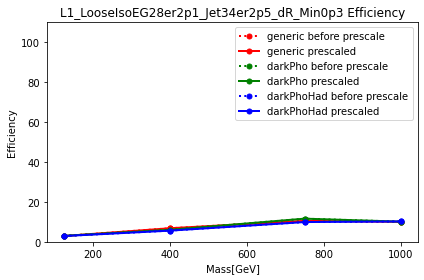

 49%|████▊     | 156/321 [02:10<03:32,  1.29s/it]

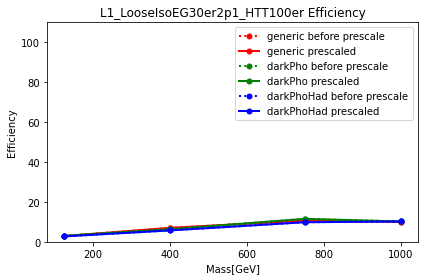

 49%|████▉     | 157/321 [02:20<10:51,  3.97s/it]

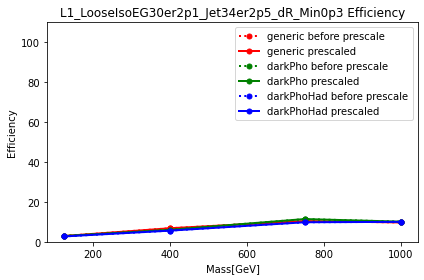

 49%|████▉     | 158/321 [02:22<09:38,  3.55s/it]

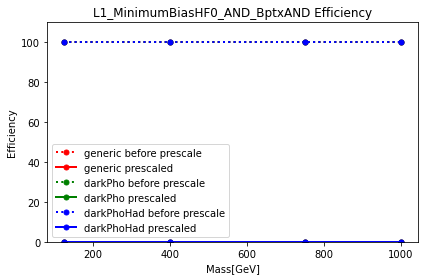

 50%|████▉     | 159/321 [02:23<07:13,  2.68s/it]

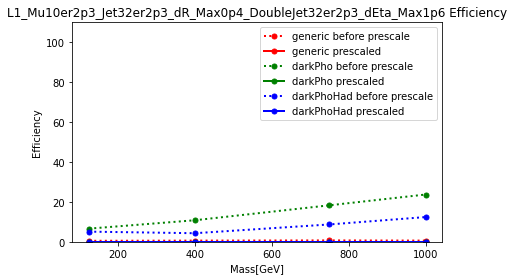

 50%|████▉     | 160/321 [02:24<05:48,  2.17s/it]

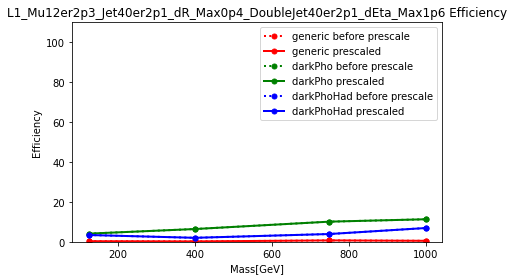

 50%|█████     | 161/321 [02:27<06:31,  2.45s/it]

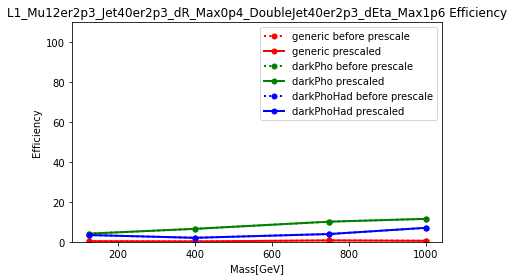

 50%|█████     | 162/321 [02:28<05:05,  1.92s/it]

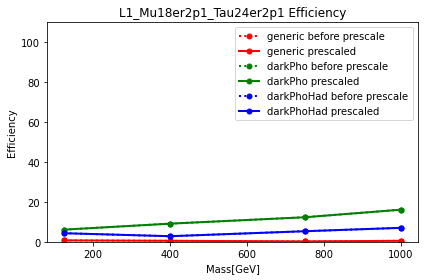

 51%|█████     | 163/321 [02:28<04:06,  1.56s/it]

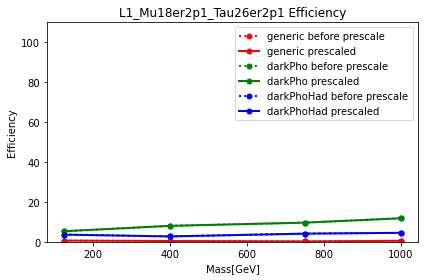

 51%|█████     | 164/321 [02:29<03:22,  1.29s/it]

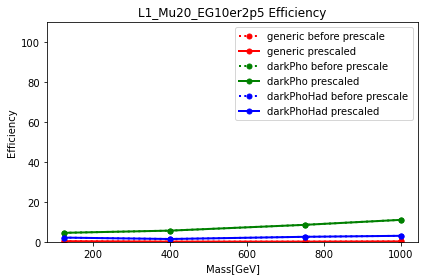

 51%|█████▏    | 165/321 [02:30<02:56,  1.13s/it]

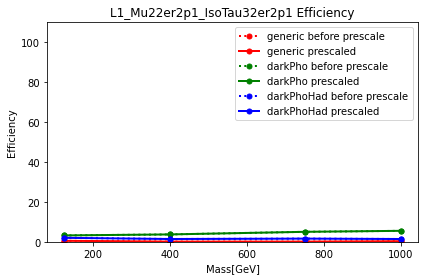

 52%|█████▏    | 166/321 [02:31<02:36,  1.01s/it]

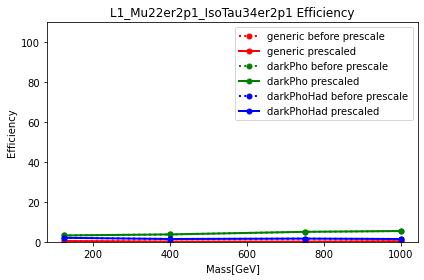

 52%|█████▏    | 167/321 [02:31<02:17,  1.12it/s]

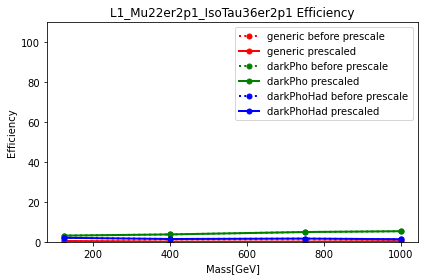

 52%|█████▏    | 168/321 [02:32<02:14,  1.14it/s]

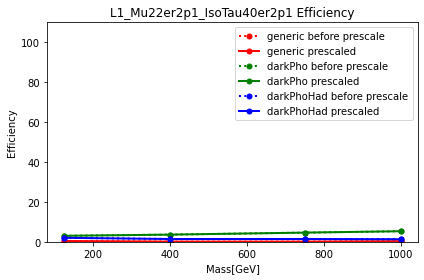

 53%|█████▎    | 169/321 [02:33<02:07,  1.19it/s]

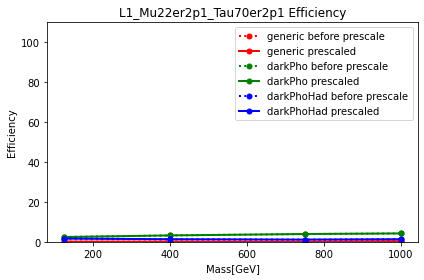

 53%|█████▎    | 170/321 [02:33<01:57,  1.29it/s]

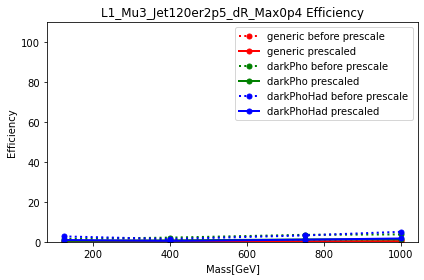

 53%|█████▎    | 171/321 [02:34<01:52,  1.33it/s]

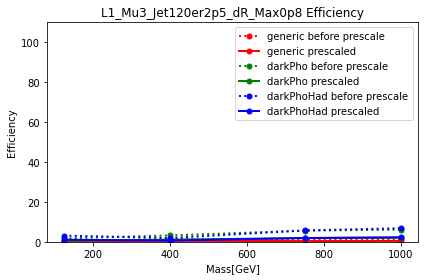

 54%|█████▎    | 172/321 [02:35<01:54,  1.30it/s]

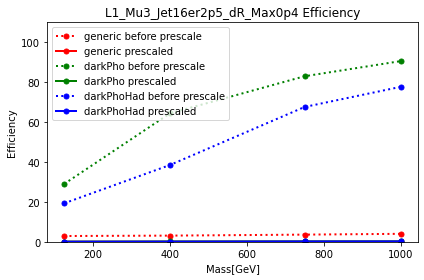

 54%|█████▍    | 173/321 [02:36<01:50,  1.34it/s]

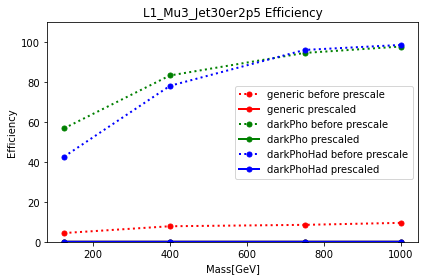

 54%|█████▍    | 174/321 [02:37<01:53,  1.29it/s]

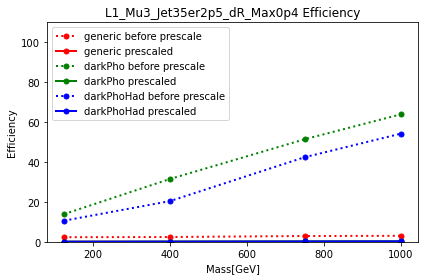

 55%|█████▍    | 175/321 [02:37<01:52,  1.29it/s]

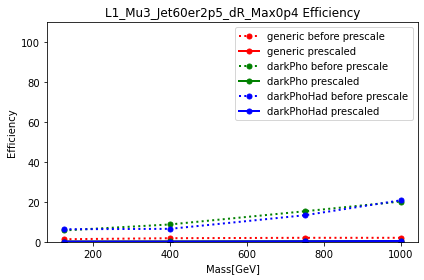

 55%|█████▍    | 176/321 [02:39<02:36,  1.08s/it]

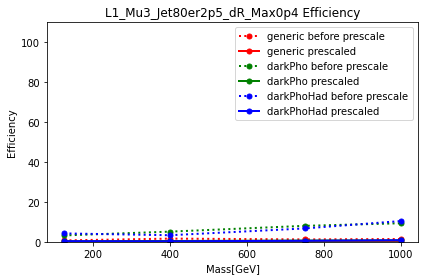

 55%|█████▌    | 177/321 [02:40<02:19,  1.03it/s]

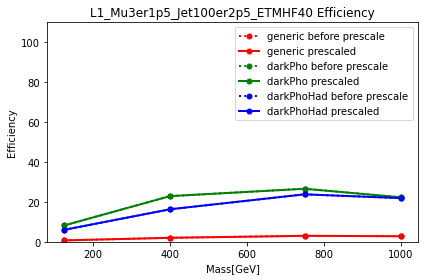

 55%|█████▌    | 178/321 [02:40<02:05,  1.14it/s]

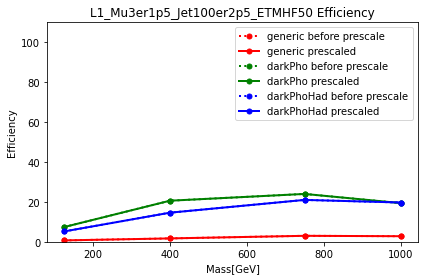

 56%|█████▌    | 179/321 [02:42<02:38,  1.11s/it]

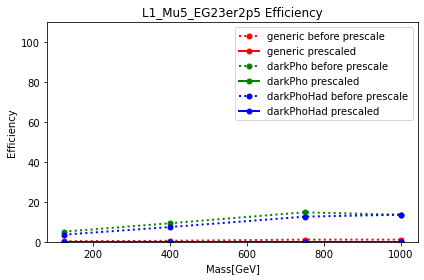

 56%|█████▌    | 180/321 [02:43<02:41,  1.15s/it]

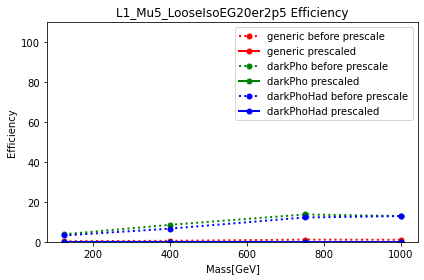

 56%|█████▋    | 181/321 [02:44<02:24,  1.03s/it]

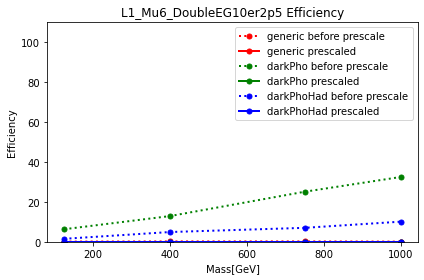

 57%|█████▋    | 182/321 [02:45<02:17,  1.01it/s]

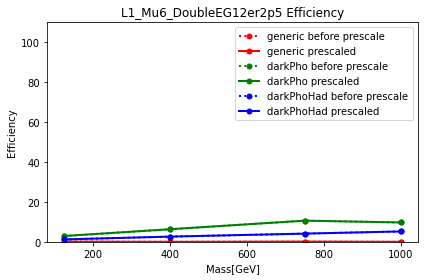

 57%|█████▋    | 183/321 [02:46<02:03,  1.12it/s]

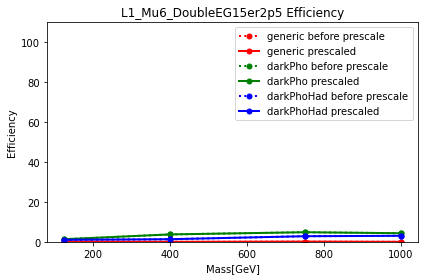

 57%|█████▋    | 184/321 [02:47<02:06,  1.09it/s]

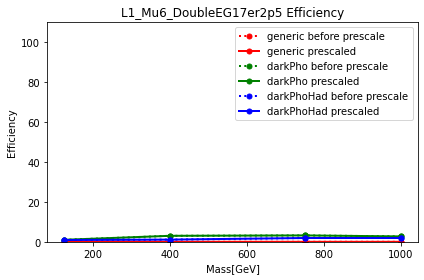

 58%|█████▊    | 185/321 [02:48<02:41,  1.19s/it]

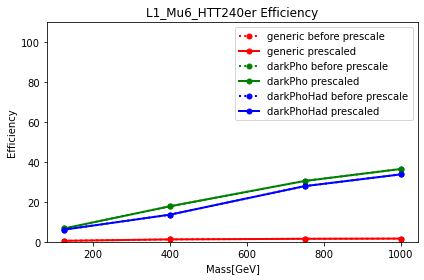

 58%|█████▊    | 186/321 [02:49<02:27,  1.10s/it]

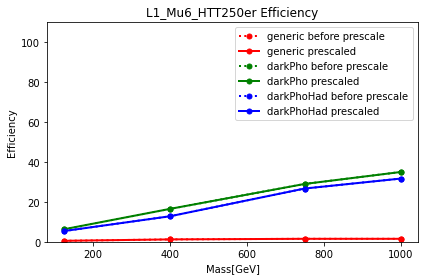

 58%|█████▊    | 187/321 [02:51<02:30,  1.12s/it]

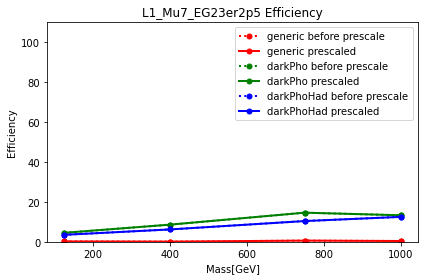

 59%|█████▊    | 188/321 [02:51<02:17,  1.03s/it]

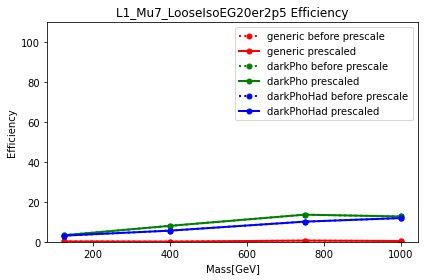

 59%|█████▉    | 189/321 [02:52<02:16,  1.03s/it]

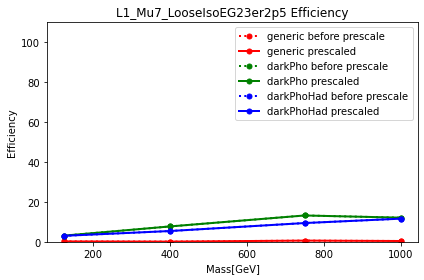

 59%|█████▉    | 190/321 [02:53<02:13,  1.02s/it]

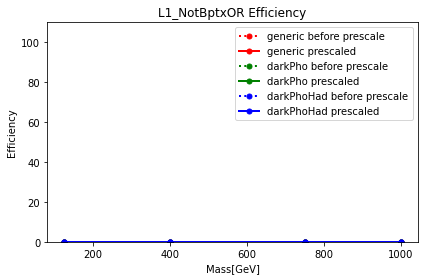

 60%|█████▉    | 191/321 [02:54<02:05,  1.04it/s]

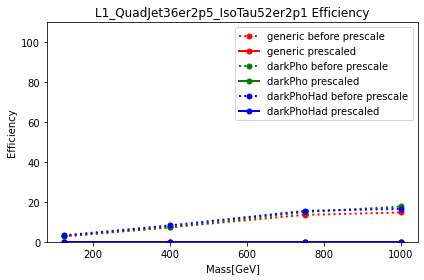

 60%|█████▉    | 192/321 [02:55<01:57,  1.10it/s]

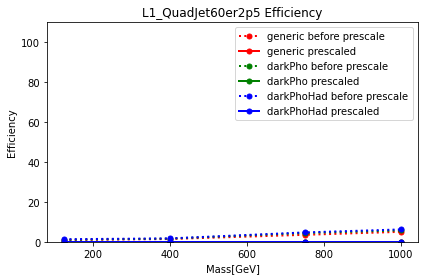

 60%|██████    | 193/321 [02:56<01:53,  1.13it/s]

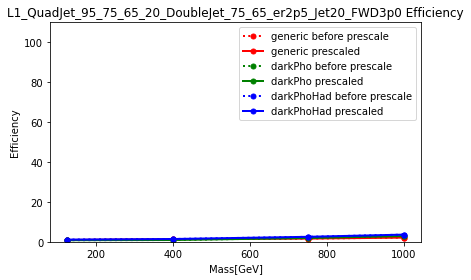

 60%|██████    | 194/321 [02:57<01:49,  1.16it/s]

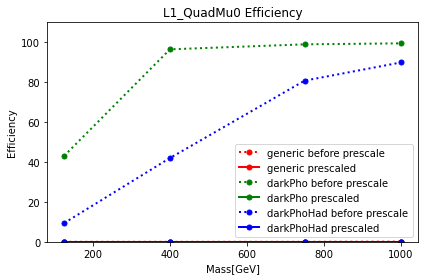

 61%|██████    | 195/321 [02:58<02:01,  1.04it/s]

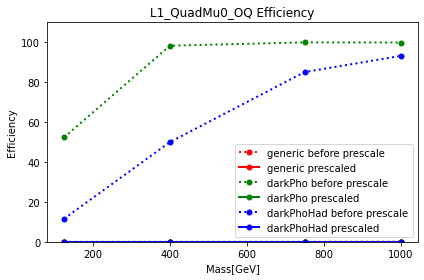

 61%|██████    | 196/321 [02:59<02:06,  1.01s/it]

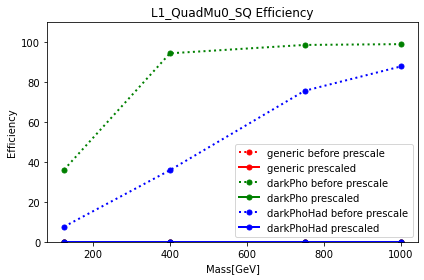

 61%|██████▏   | 197/321 [03:00<02:01,  1.02it/s]

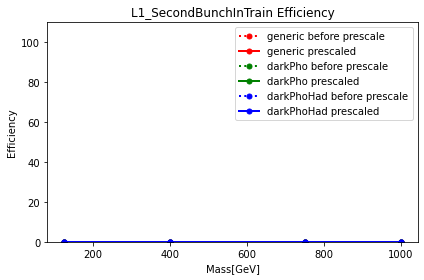

 62%|██████▏   | 198/321 [03:00<01:48,  1.13it/s]

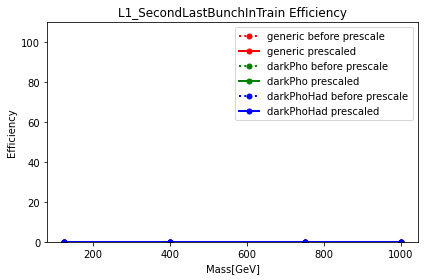

 62%|██████▏   | 199/321 [03:01<01:51,  1.09it/s]

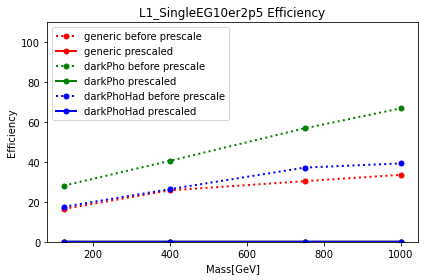

 62%|██████▏   | 200/321 [03:02<01:44,  1.15it/s]

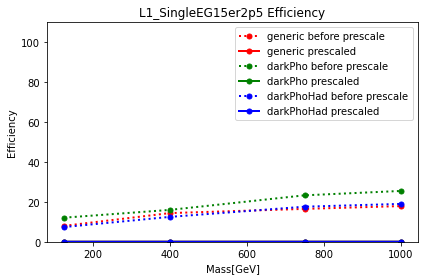

 63%|██████▎   | 201/321 [03:03<01:42,  1.17it/s]

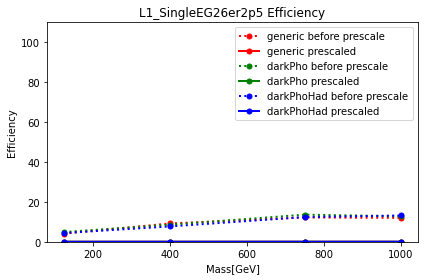

 63%|██████▎   | 202/321 [03:04<02:00,  1.01s/it]

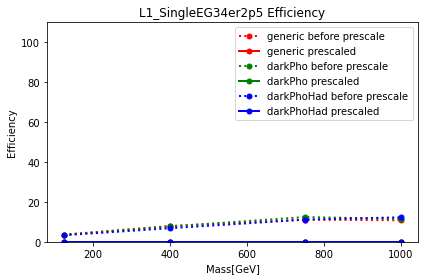

 63%|██████▎   | 203/321 [03:05<01:57,  1.00it/s]

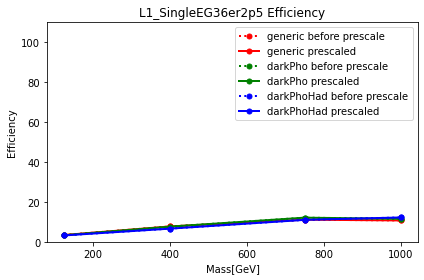

 64%|██████▎   | 204/321 [03:06<01:48,  1.08it/s]

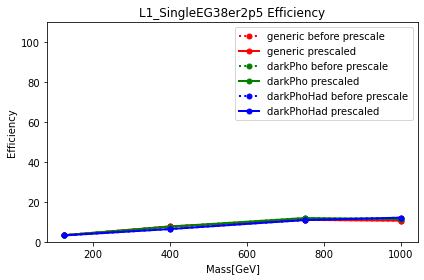

 64%|██████▍   | 205/321 [03:07<01:39,  1.17it/s]

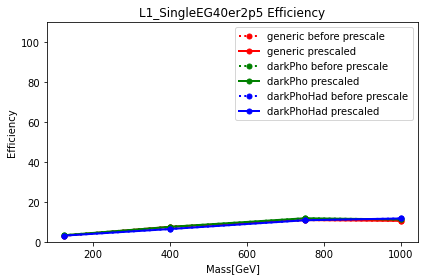

 64%|██████▍   | 206/321 [03:08<01:31,  1.26it/s]

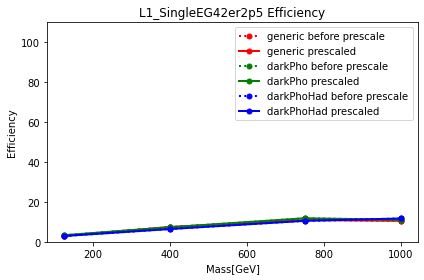

 64%|██████▍   | 207/321 [03:08<01:26,  1.32it/s]

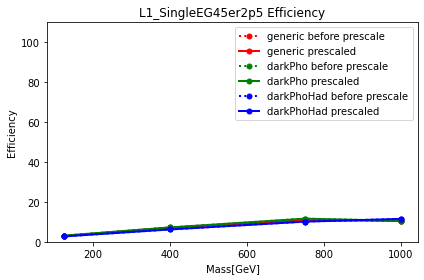

 65%|██████▍   | 208/321 [03:09<01:31,  1.23it/s]

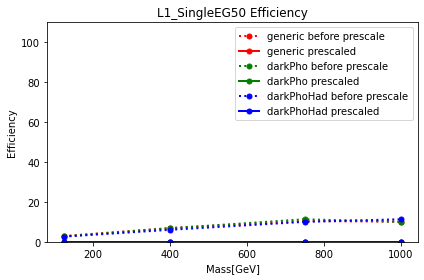

 65%|██████▌   | 209/321 [03:10<01:30,  1.24it/s]

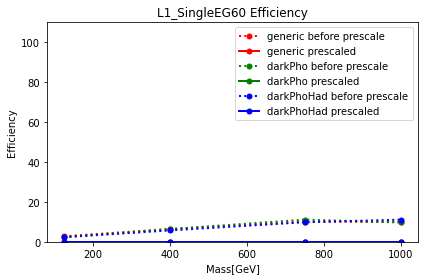

 65%|██████▌   | 210/321 [03:11<01:35,  1.16it/s]

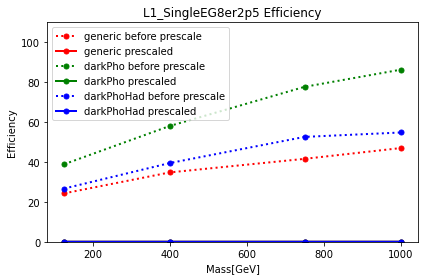

 66%|██████▌   | 211/321 [03:12<01:33,  1.18it/s]

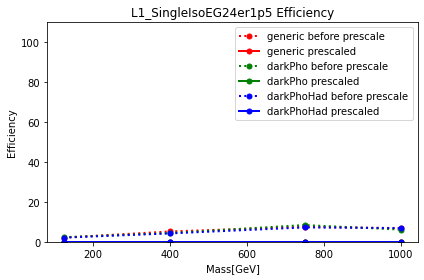

 66%|██████▌   | 212/321 [03:12<01:25,  1.27it/s]

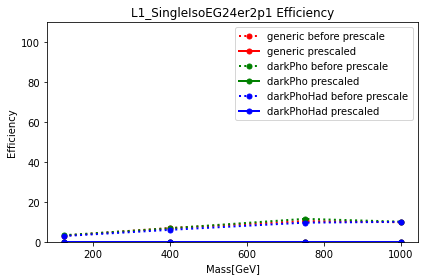

 66%|██████▋   | 213/321 [03:13<01:32,  1.17it/s]

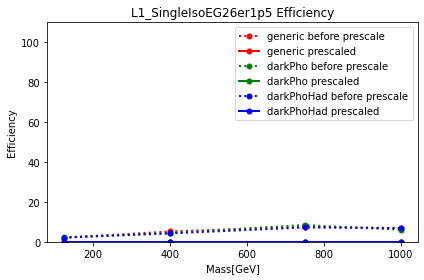

 67%|██████▋   | 214/321 [03:14<01:31,  1.17it/s]

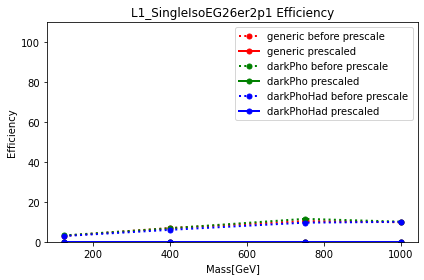

 67%|██████▋   | 215/321 [03:15<01:27,  1.22it/s]

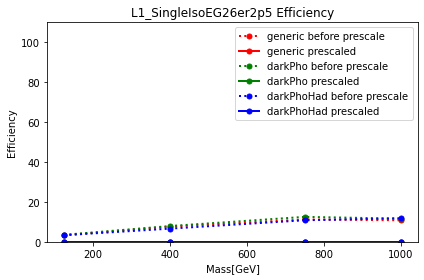

 67%|██████▋   | 216/321 [03:16<01:28,  1.19it/s]

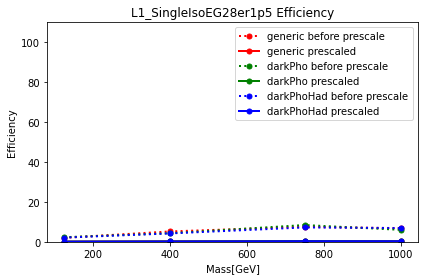

 68%|██████▊   | 217/321 [03:17<01:27,  1.19it/s]

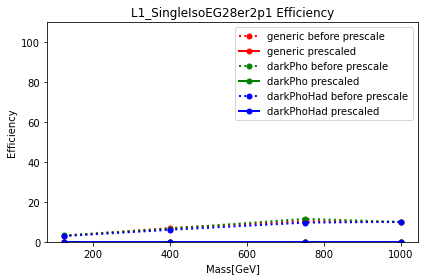

 68%|██████▊   | 218/321 [03:17<01:23,  1.23it/s]

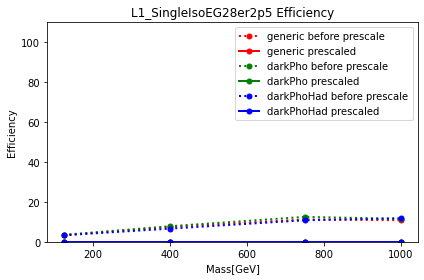

 68%|██████▊   | 219/321 [03:18<01:19,  1.29it/s]

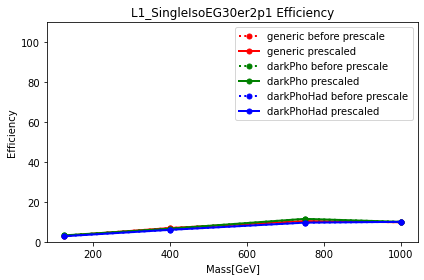

 69%|██████▊   | 220/321 [03:19<01:26,  1.17it/s]

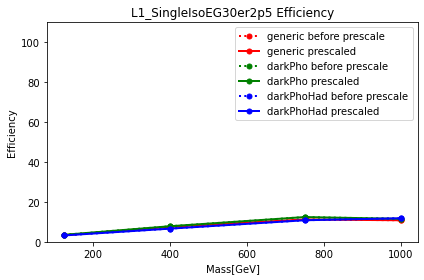

 69%|██████▉   | 221/321 [03:21<01:45,  1.06s/it]

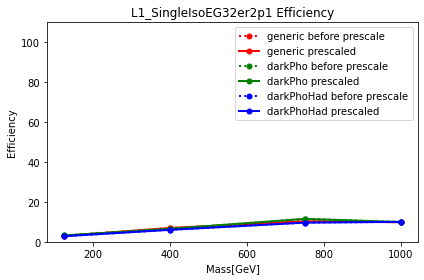

 69%|██████▉   | 222/321 [03:22<01:48,  1.10s/it]

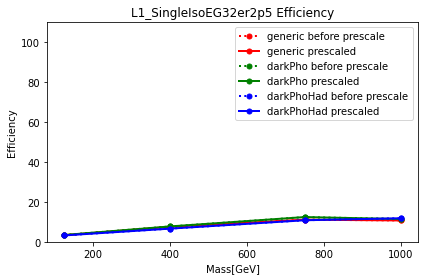

 69%|██████▉   | 223/321 [03:23<01:36,  1.01it/s]

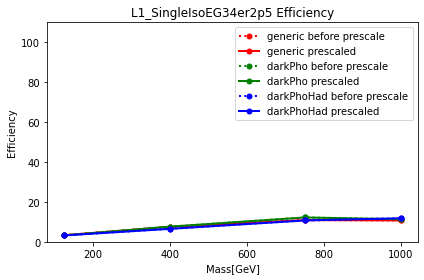

 70%|██████▉   | 224/321 [03:24<01:34,  1.03it/s]

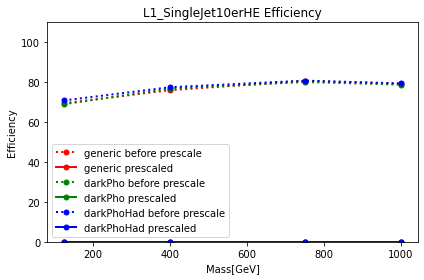

 70%|███████   | 225/321 [03:24<01:24,  1.13it/s]

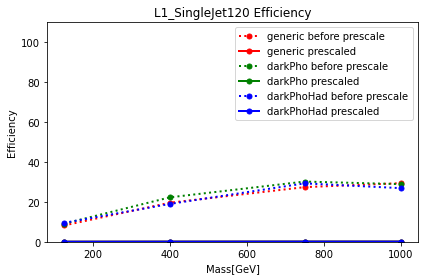

 70%|███████   | 226/321 [03:25<01:21,  1.17it/s]

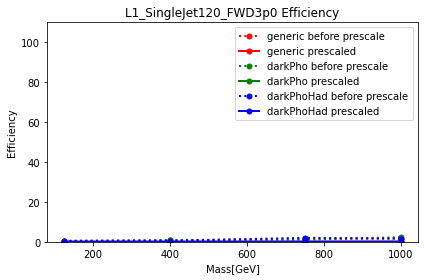

 71%|███████   | 227/321 [03:26<01:20,  1.17it/s]

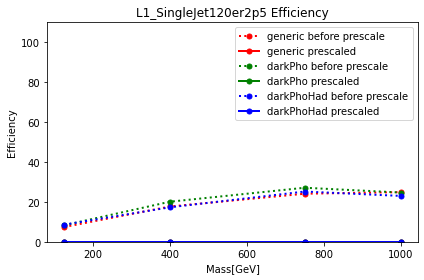

 71%|███████   | 228/321 [03:27<01:21,  1.14it/s]

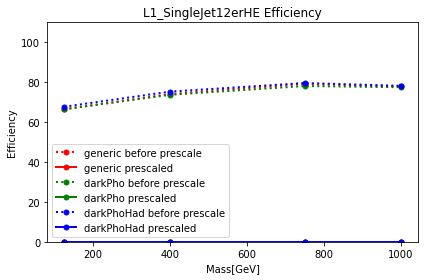

 71%|███████▏  | 229/321 [03:28<01:38,  1.07s/it]

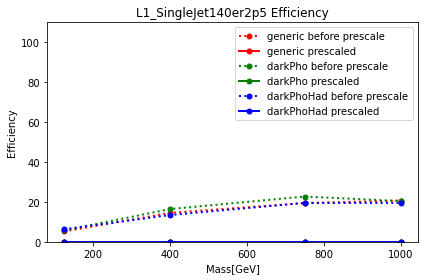

 72%|███████▏  | 230/321 [03:29<01:35,  1.04s/it]

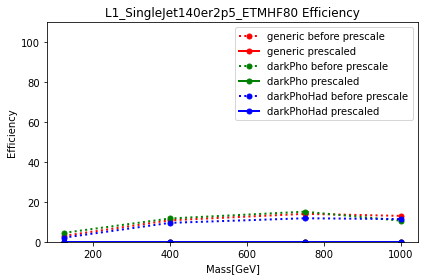

 72%|███████▏  | 231/321 [03:30<01:24,  1.07it/s]

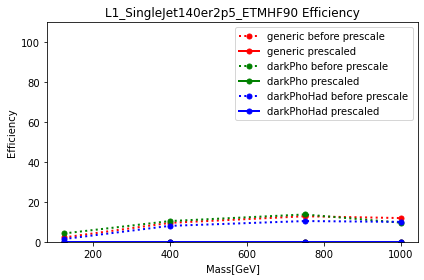

 72%|███████▏  | 232/321 [03:31<01:20,  1.10it/s]

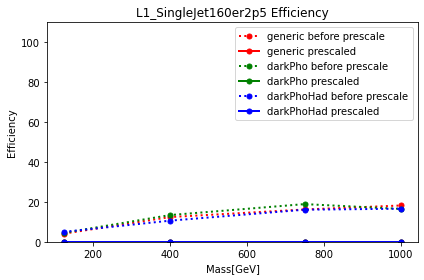

 73%|███████▎  | 233/321 [03:32<01:28,  1.01s/it]

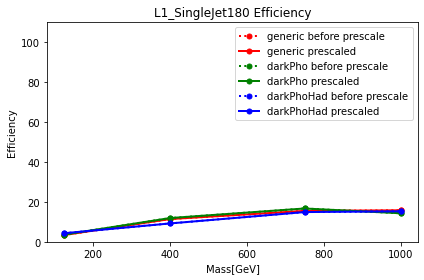

 73%|███████▎  | 234/321 [03:33<01:19,  1.09it/s]

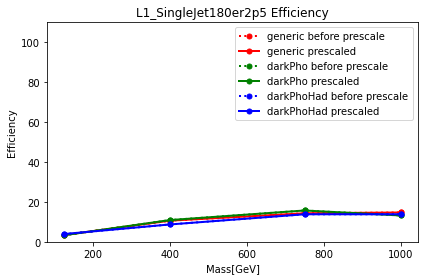

 73%|███████▎  | 235/321 [03:34<01:21,  1.05it/s]

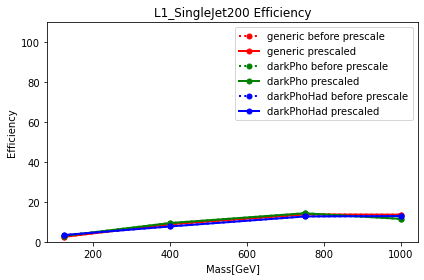

 74%|███████▎  | 236/321 [03:35<01:14,  1.14it/s]

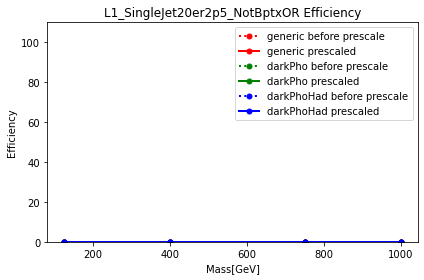

 74%|███████▍  | 237/321 [03:35<01:13,  1.15it/s]

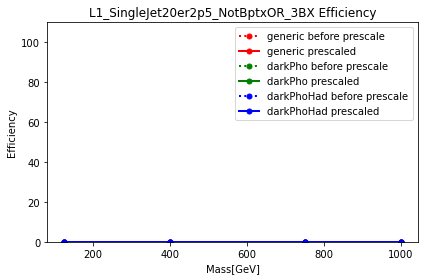

 74%|███████▍  | 238/321 [03:36<01:07,  1.23it/s]

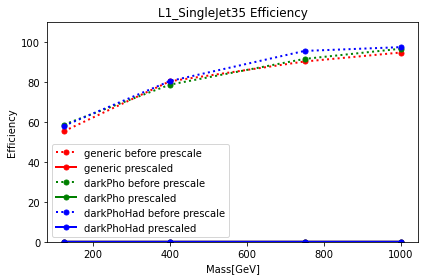

 74%|███████▍  | 239/321 [03:37<01:02,  1.31it/s]

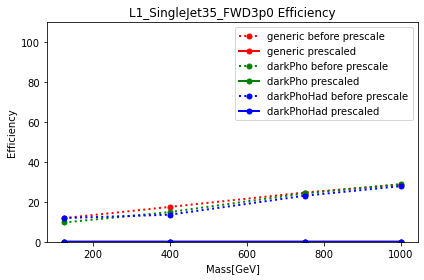

 75%|███████▍  | 240/321 [03:37<01:01,  1.31it/s]

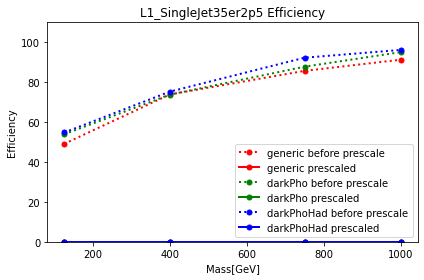

 75%|███████▌  | 241/321 [03:38<00:58,  1.36it/s]

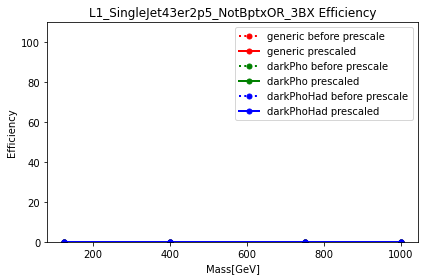

 75%|███████▌  | 242/321 [03:39<00:56,  1.40it/s]

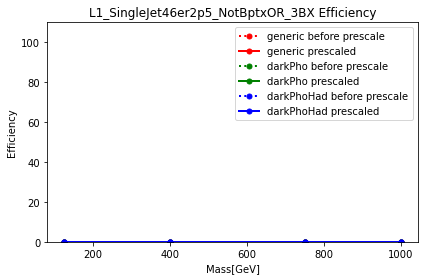

 76%|███████▌  | 243/321 [03:40<00:55,  1.41it/s]

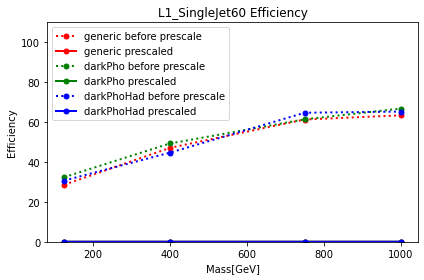

 76%|███████▌  | 244/321 [03:40<00:56,  1.36it/s]

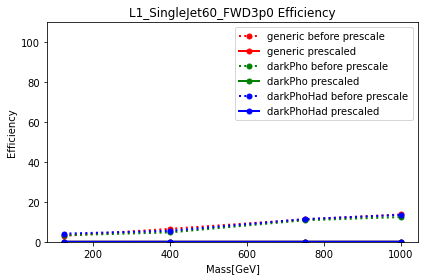

 76%|███████▋  | 245/321 [03:41<01:02,  1.21it/s]

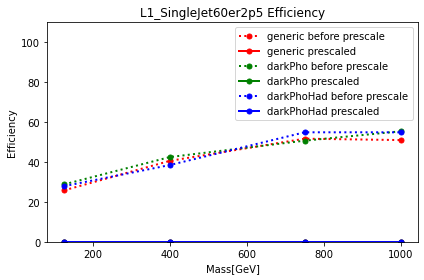

 77%|███████▋  | 246/321 [03:42<01:08,  1.09it/s]

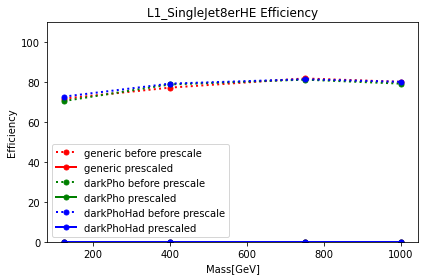

 77%|███████▋  | 247/321 [03:43<01:07,  1.10it/s]

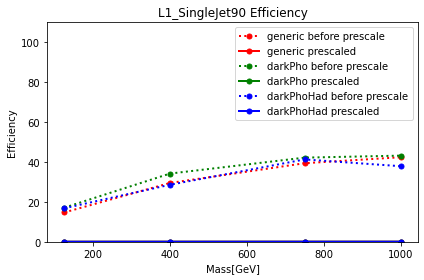

 77%|███████▋  | 248/321 [03:44<01:00,  1.21it/s]

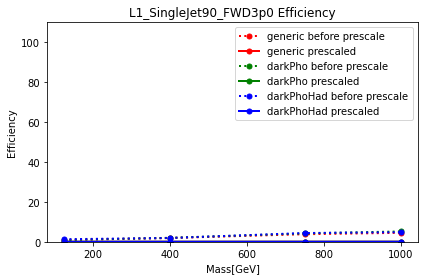

 78%|███████▊  | 249/321 [03:45<01:00,  1.19it/s]

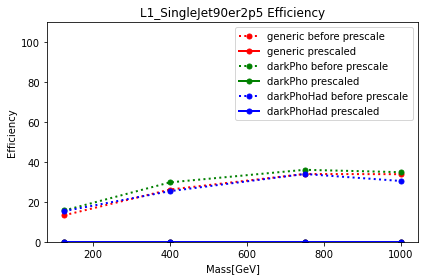

 78%|███████▊  | 250/321 [03:46<00:56,  1.27it/s]

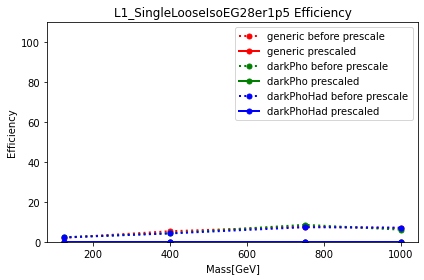

 78%|███████▊  | 251/321 [03:46<00:52,  1.33it/s]

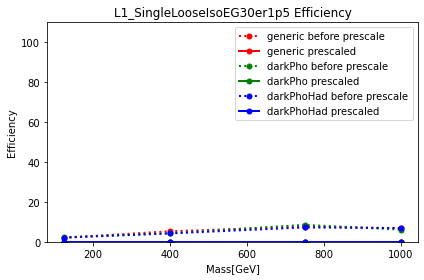

 79%|███████▊  | 252/321 [03:47<00:50,  1.36it/s]

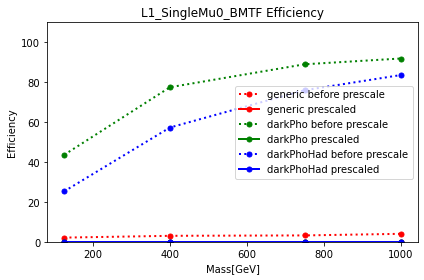

 79%|███████▉  | 253/321 [03:48<00:50,  1.35it/s]

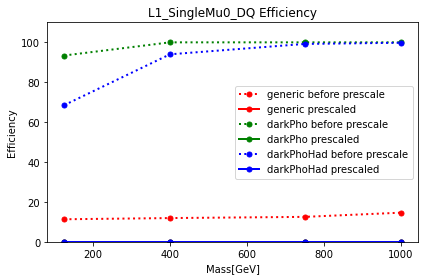

 79%|███████▉  | 254/321 [03:49<00:52,  1.28it/s]

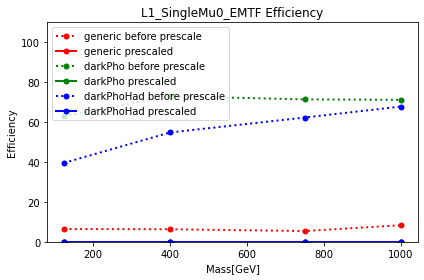

 79%|███████▉  | 255/321 [03:49<00:50,  1.31it/s]

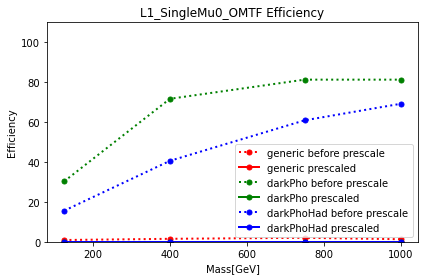

 80%|███████▉  | 256/321 [03:50<00:52,  1.24it/s]

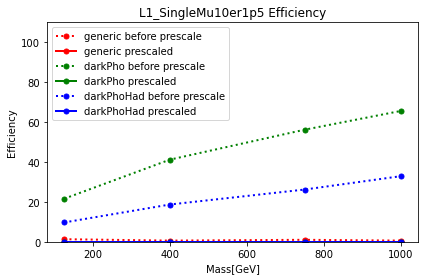

 80%|████████  | 257/321 [03:51<00:54,  1.17it/s]

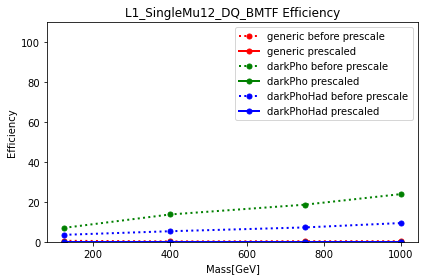

 80%|████████  | 258/321 [03:52<00:55,  1.13it/s]

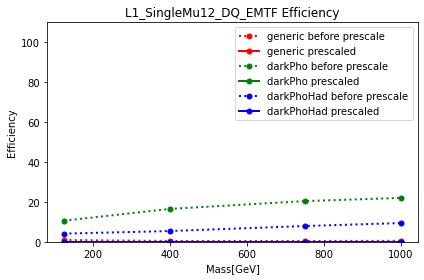

 81%|████████  | 259/321 [03:53<00:53,  1.16it/s]

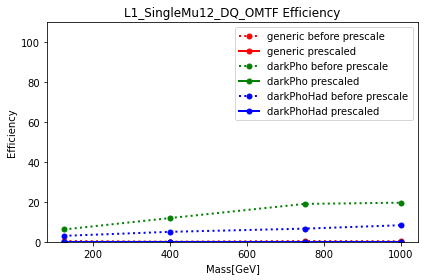

 81%|████████  | 260/321 [03:54<00:49,  1.24it/s]

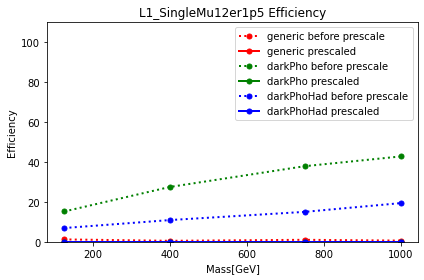

 81%|████████▏ | 261/321 [03:55<00:55,  1.07it/s]

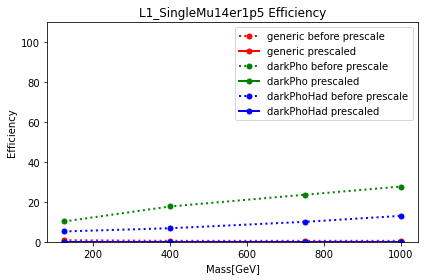

 82%|████████▏ | 262/321 [03:56<00:55,  1.07it/s]

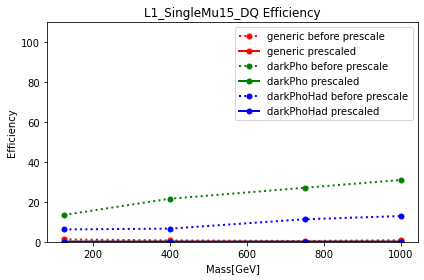

 82%|████████▏ | 263/321 [03:57<00:57,  1.00it/s]

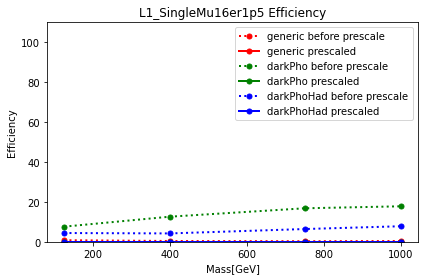

 82%|████████▏ | 264/321 [03:58<00:51,  1.10it/s]

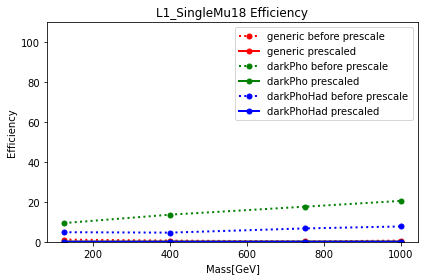

 83%|████████▎ | 265/321 [03:58<00:46,  1.20it/s]

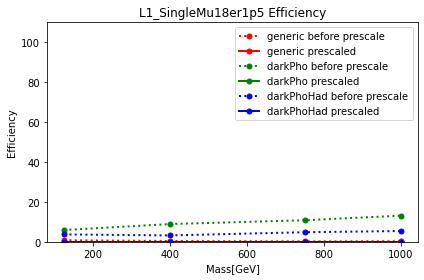

 83%|████████▎ | 266/321 [03:59<00:45,  1.20it/s]

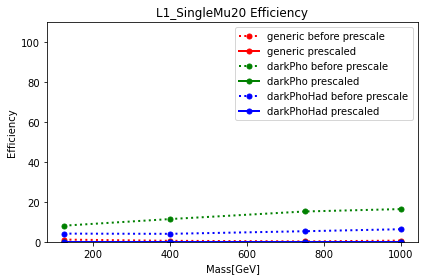

 83%|████████▎ | 267/321 [04:00<00:45,  1.20it/s]

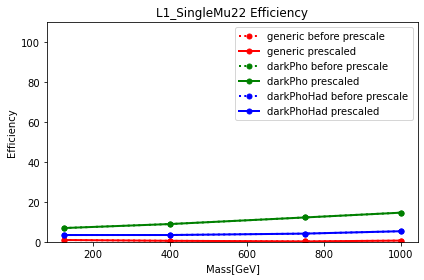

 83%|████████▎ | 268/321 [04:01<00:44,  1.20it/s]

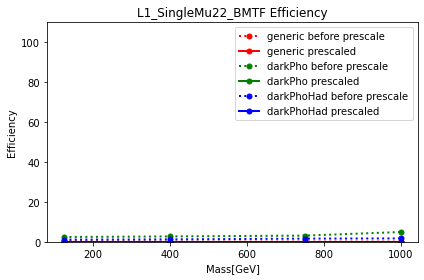

 84%|████████▍ | 269/321 [04:01<00:40,  1.27it/s]

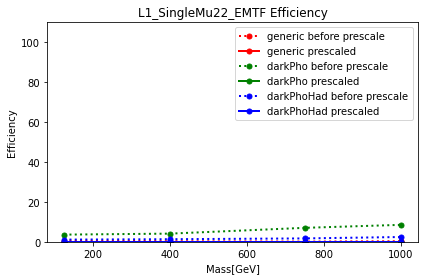

 84%|████████▍ | 270/321 [04:02<00:38,  1.31it/s]

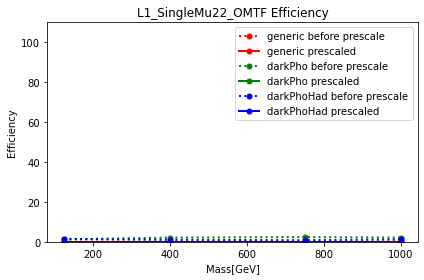

 84%|████████▍ | 271/321 [04:03<00:39,  1.28it/s]

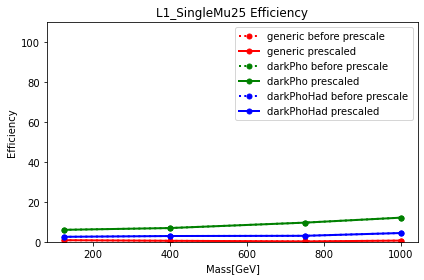

 85%|████████▍ | 272/321 [04:04<00:40,  1.20it/s]

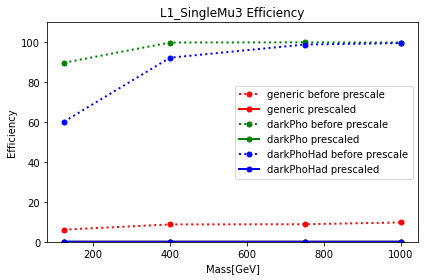

 85%|████████▌ | 273/321 [04:05<00:37,  1.26it/s]

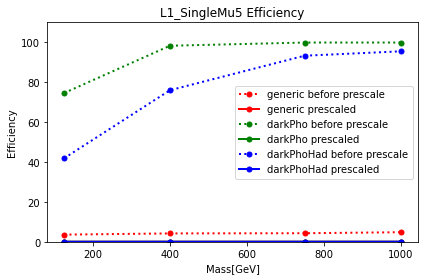

 85%|████████▌ | 274/321 [04:05<00:38,  1.21it/s]

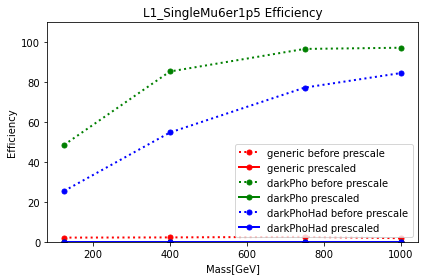

 86%|████████▌ | 275/321 [04:07<00:41,  1.10it/s]

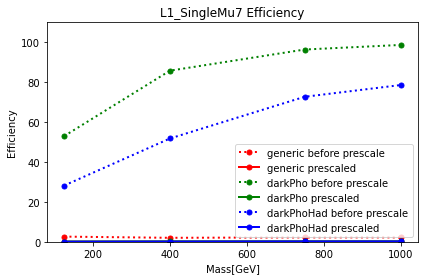

 86%|████████▌ | 276/321 [04:07<00:40,  1.12it/s]

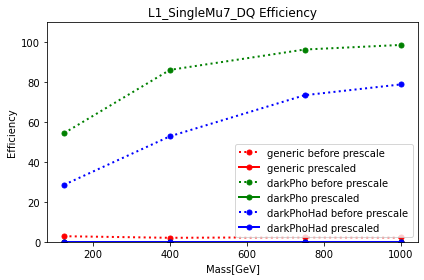

 86%|████████▋ | 277/321 [04:12<01:32,  2.11s/it]

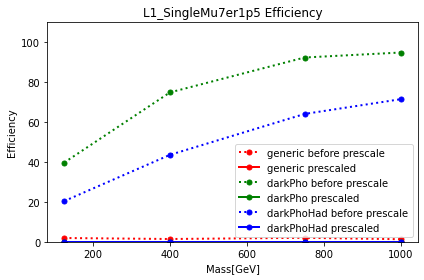

 87%|████████▋ | 278/321 [04:13<01:14,  1.73s/it]

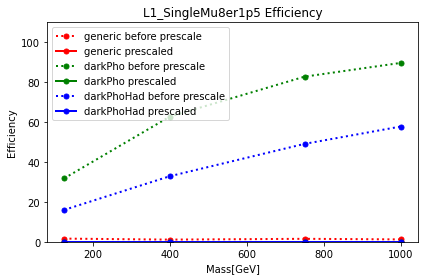

 87%|████████▋ | 279/321 [04:14<01:05,  1.56s/it]

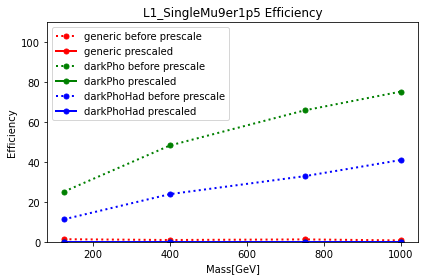

 87%|████████▋ | 280/321 [04:15<00:53,  1.30s/it]

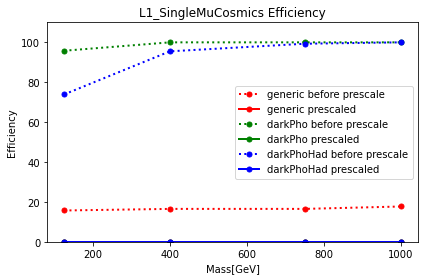

 88%|████████▊ | 281/321 [04:16<00:46,  1.15s/it]

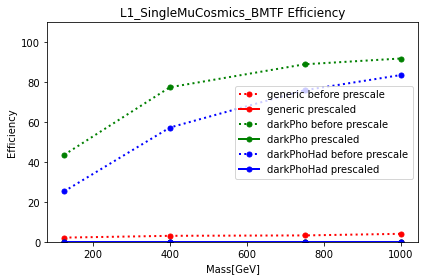

 88%|████████▊ | 282/321 [04:17<00:40,  1.04s/it]

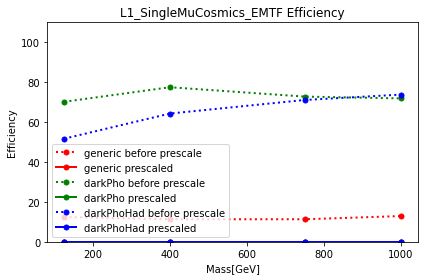

 88%|████████▊ | 283/321 [04:20<01:09,  1.83s/it]

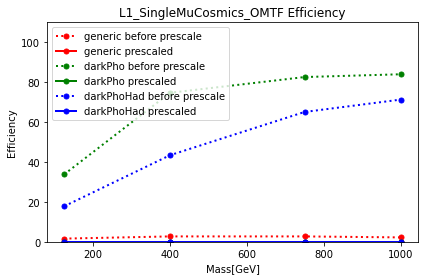

 88%|████████▊ | 284/321 [04:21<00:57,  1.56s/it]

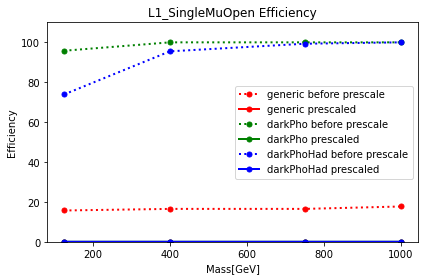

 89%|████████▉ | 285/321 [04:22<00:47,  1.33s/it]

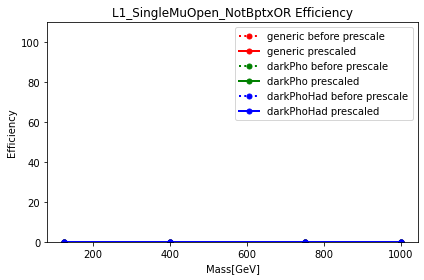

 89%|████████▉ | 286/321 [04:23<00:40,  1.17s/it]

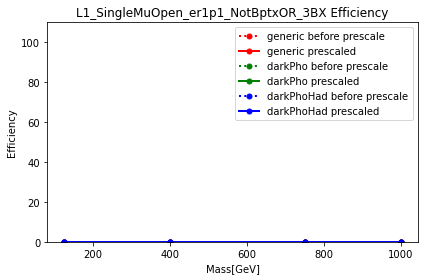

 89%|████████▉ | 287/321 [04:24<00:35,  1.06s/it]

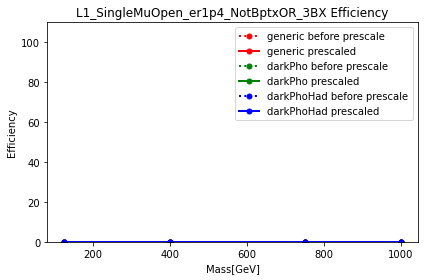

 90%|████████▉ | 288/321 [04:24<00:31,  1.06it/s]

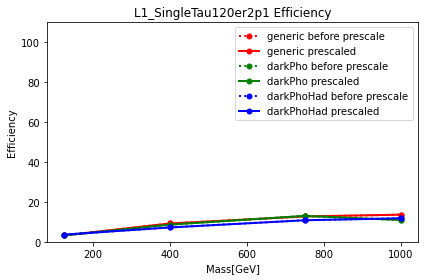

 90%|█████████ | 289/321 [04:25<00:27,  1.16it/s]

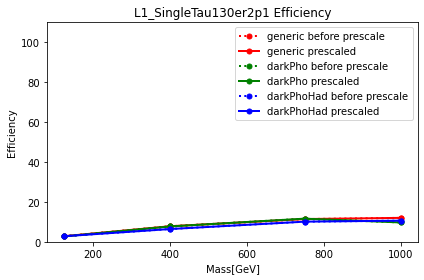

 90%|█████████ | 290/321 [04:26<00:25,  1.20it/s]

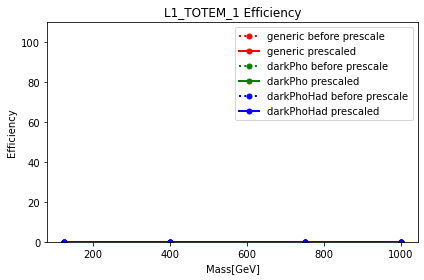

 91%|█████████ | 291/321 [04:26<00:22,  1.31it/s]

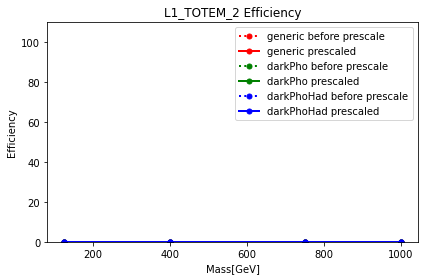

 91%|█████████ | 292/321 [04:27<00:22,  1.27it/s]

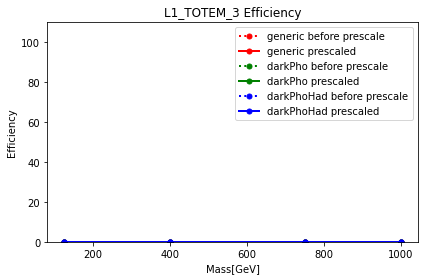

 91%|█████████▏| 293/321 [04:28<00:20,  1.34it/s]

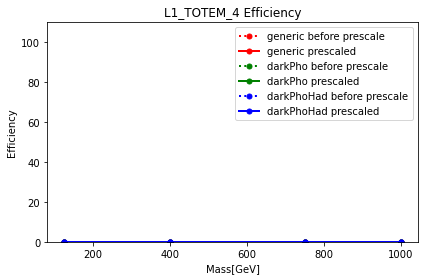

 92%|█████████▏| 294/321 [04:29<00:20,  1.30it/s]

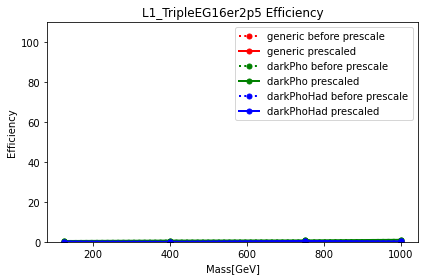

 92%|█████████▏| 295/321 [04:30<00:20,  1.28it/s]

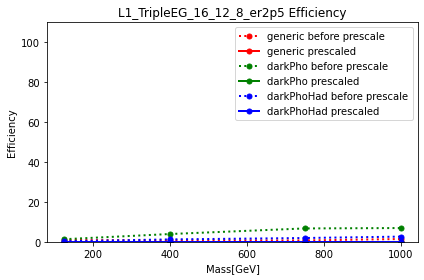

 92%|█████████▏| 296/321 [04:30<00:17,  1.40it/s]

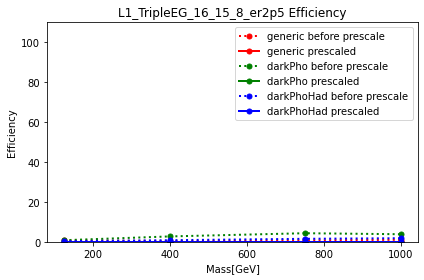

 93%|█████████▎| 297/321 [04:31<00:18,  1.33it/s]

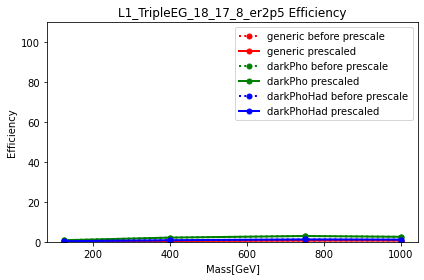

 93%|█████████▎| 298/321 [04:32<00:16,  1.36it/s]

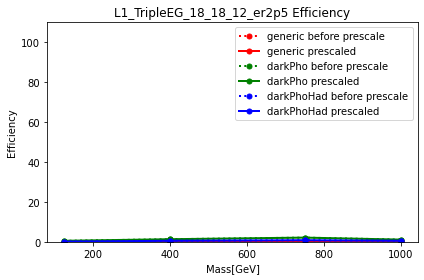

 93%|█████████▎| 299/321 [04:33<00:17,  1.25it/s]

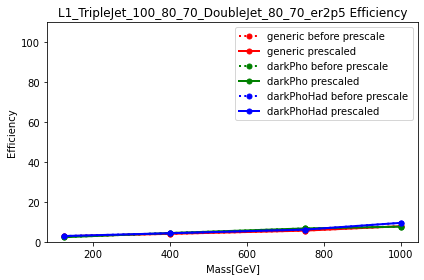

 93%|█████████▎| 300/321 [04:33<00:16,  1.24it/s]

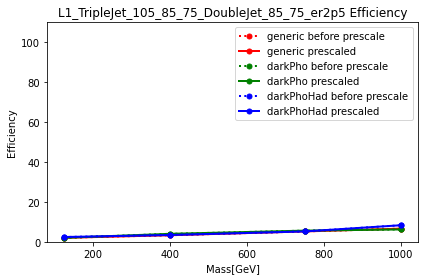

 94%|█████████▍| 301/321 [04:34<00:16,  1.23it/s]

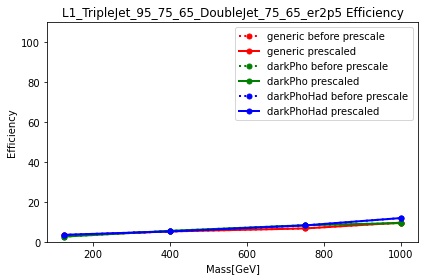

 94%|█████████▍| 302/321 [04:35<00:15,  1.20it/s]

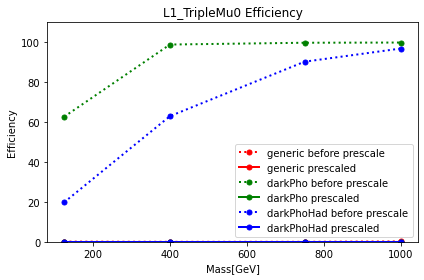

 94%|█████████▍| 303/321 [04:36<00:16,  1.12it/s]

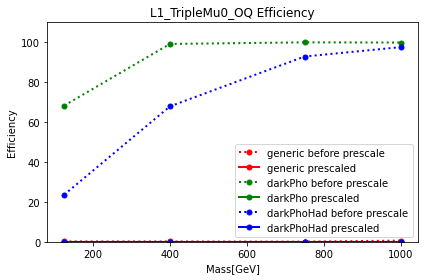

 95%|█████████▍| 304/321 [04:37<00:14,  1.15it/s]

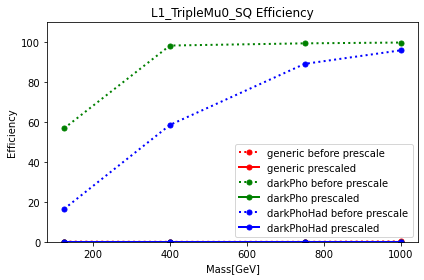

 95%|█████████▌| 305/321 [04:38<00:13,  1.18it/s]

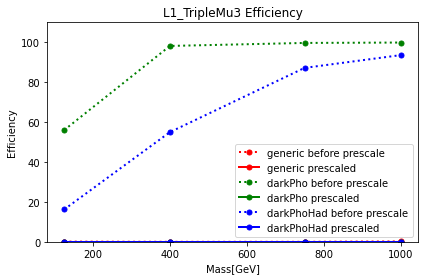

 95%|█████████▌| 306/321 [04:38<00:11,  1.26it/s]

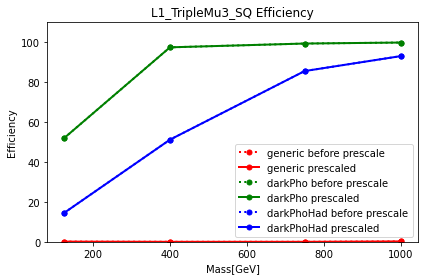

 96%|█████████▌| 307/321 [04:39<00:10,  1.28it/s]

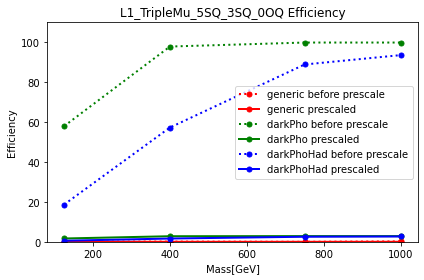

 96%|█████████▌| 308/321 [04:40<00:10,  1.28it/s]

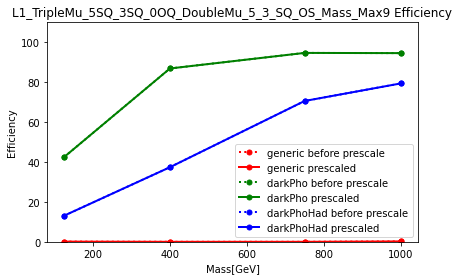

 96%|█████████▋| 309/321 [04:41<00:09,  1.23it/s]

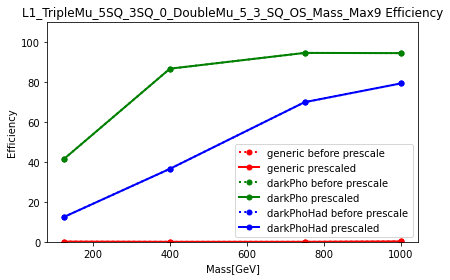

 97%|█████████▋| 310/321 [04:42<00:08,  1.28it/s]

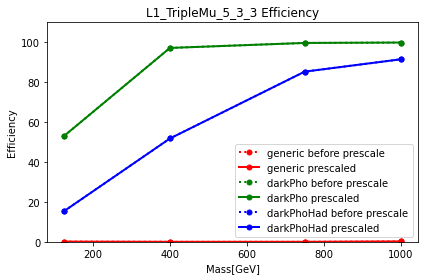

 97%|█████████▋| 311/321 [04:43<00:08,  1.12it/s]

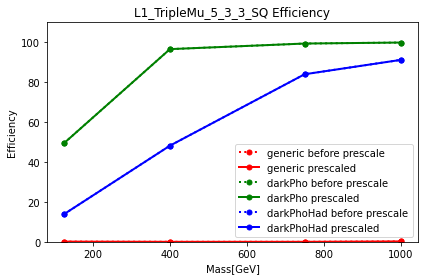

 97%|█████████▋| 312/321 [04:44<00:08,  1.12it/s]

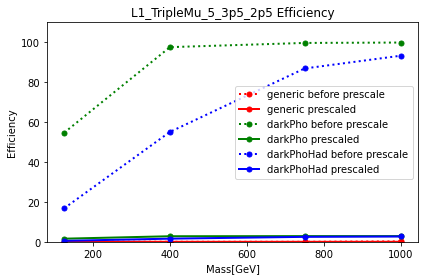

 98%|█████████▊| 313/321 [04:45<00:07,  1.04it/s]

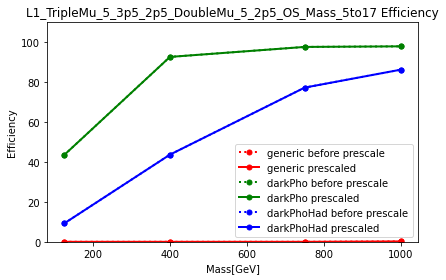

 98%|█████████▊| 314/321 [04:46<00:06,  1.03it/s]

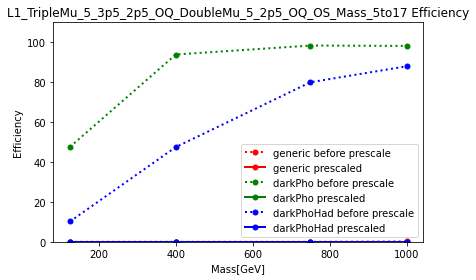

 98%|█████████▊| 315/321 [04:46<00:05,  1.11it/s]

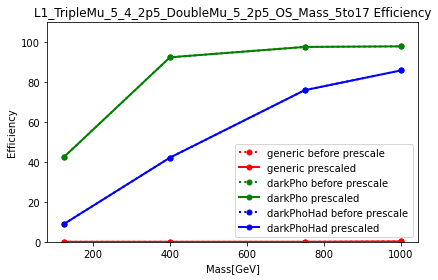

 98%|█████████▊| 316/321 [04:47<00:04,  1.16it/s]

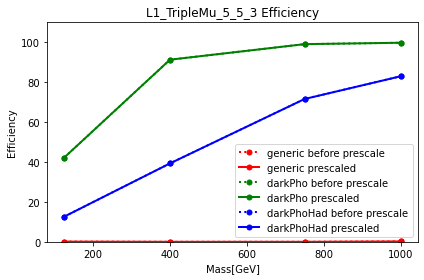

 99%|█████████▉| 317/321 [04:48<00:03,  1.13it/s]

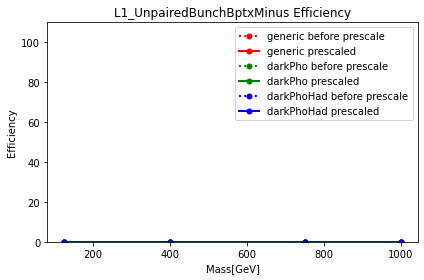

 99%|█████████▉| 318/321 [04:49<00:02,  1.23it/s]

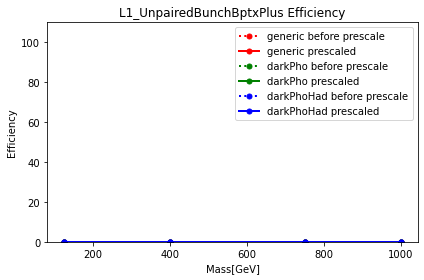

 99%|█████████▉| 319/321 [04:50<00:01,  1.13it/s]

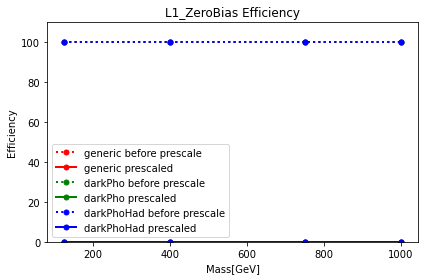

100%|█████████▉| 320/321 [04:51<00:00,  1.09it/s]

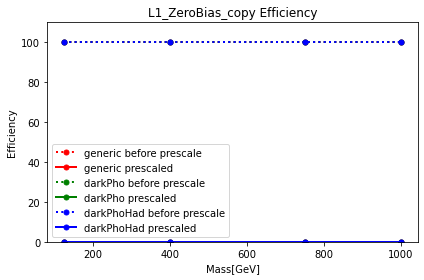

100%|██████████| 321/321 [04:52<00:00,  1.10it/s]


In [42]:
print('creating plots of trigger efficiencies.')
colors=['red','green','blue']
for trigger in tqdm(dic_trigger_decaymodes['generic']['125']):
    if trigger in list(data['Name']):
        PS = data.loc[data['Name'] == trigger, '2p20E+34'].values[0]
    else:
        PS = 0.0
    for decay,color in zip(decays,colors):
        is_triggered_m125=dic_trigger_decaymodes[decay]['125'][trigger]
        ratio_m125=is_triggered_m125.sum()/len(is_triggered_m125)*100.0
        ratio_m125_prescaled=ratio_m125/PS if PS>0 else 0.0
        is_triggered_m400=dic_trigger_decaymodes[decay]['400'][trigger]
        ratio_m400=is_triggered_m400.sum()/len(is_triggered_m400)*100.0
        ratio_m400_prescaled=ratio_m400/PS if PS>0 else 0.0
        is_triggered_m750=dic_trigger_decaymodes[decay]['750'][trigger]
        ratio_m750=is_triggered_m750.sum()/len(is_triggered_m750)*100.0
        ratio_m750_prescaled=ratio_m750/PS if PS>0 else 0.0
        is_triggered_m1000=dic_trigger_decaymodes[decay]['1000'][trigger]
        ratio_m1000=is_triggered_m1000.sum()/len(is_triggered_m1000)*100.0
        ratio_m1000_prescaled=ratio_m1000/PS if PS>0 else 0.0
        plt.plot([125,400,750,1000],[ratio_m125,ratio_m400,ratio_m750,ratio_m1000],color=color, marker='o', linestyle='dotted',
                 linewidth=2, markersize=5,label=decay+" before prescale")
        plt.plot([125,400,750,1000],[ratio_m125_prescaled,ratio_m400_prescaled,ratio_m750_prescaled,ratio_m1000_prescaled],color=color, marker='o', linestyle='solid',
                 linewidth=2, markersize=5,label=decay+" prescaled")
    plt.xlabel('Mass[GeV]')
    plt.ylabel('Efficiency')
    plt.ylim([0,110])
    plt.title('{} Efficiency'.format(trigger))
    plt.legend()
    plt.tight_layout()
    plt.savefig('eff_mass/{}_eff.png'.format(trigger))
    plt.savefig('eff_mass/{}_eff.pdf'.format(trigger))
    plt.show()

creating plots of trigger efficiencies.


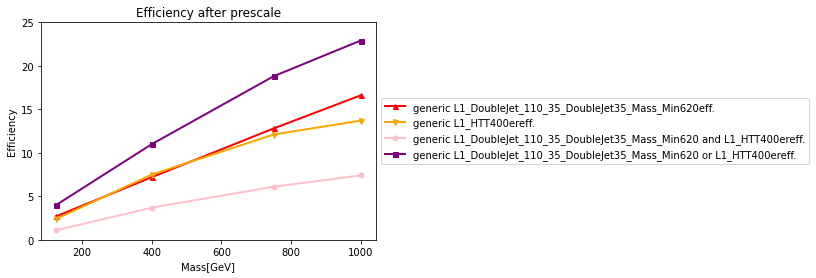

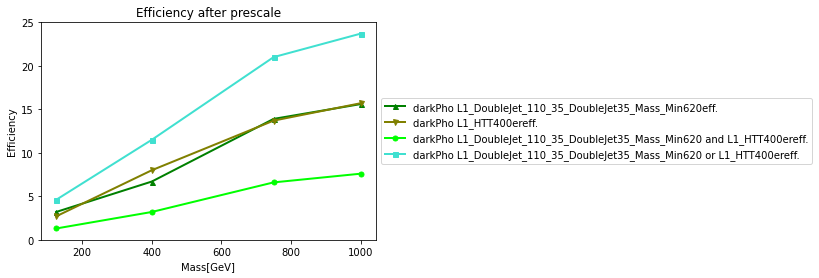

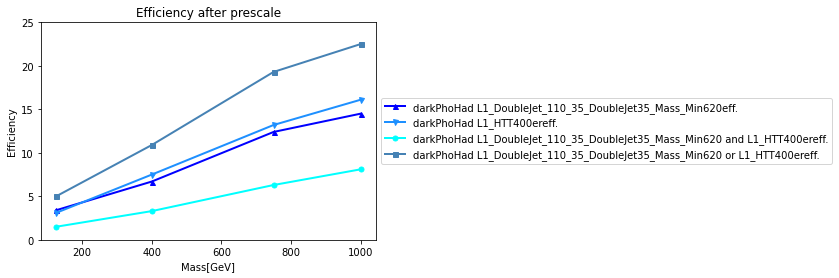

In [17]:
print('creating plots of trigger efficiencies.')
#colors=['red','green','blue']
colors=[['red','orange','pink','purple'],
        ['green','olive','lime','turquoise'],
        ['blue','dodgerblue','cyan','steelblue']]
trigger1='L1_DoubleJet_110_35_DoubleJet35_Mass_Min620'
trigger2='L1_HTT400er'
PS1 = data.loc[data['Name'] == trigger1, '2p20E+34'].values[0]
PS2 = data.loc[data['Name'] == trigger2, '2p20E+34'].values[0]
for decay,color in zip(decays,colors):
    is_triggered_m125_1=dic_trigger_decaymodes[decay]['125'][trigger1]
    ratio_m125_1=is_triggered_m125_1.sum()/len(is_triggered_m125_1)*100.0
    ratio_m125_prescaled_1=ratio_m125_1/PS1 if PS1>0 else 0.0
    is_triggered_m125_2=dic_trigger_decaymodes[decay]['125'][trigger2]
    ratio_m125_2=is_triggered_m125_2.sum()/len(is_triggered_m125_2)*100.0
    ratio_m125_prescaled_2=ratio_m125_2/PS2 if PS2>0 else 0.0
    is_triggered_m125_1and2=dic_trigger_decaymodes[decay]['125'][trigger1] & dic_trigger_decaymodes[decay]['125'][trigger2]
    ratio_m125_1and2=is_triggered_m125_1and2.sum()/len(is_triggered_m125_1and2)*100.0
    ratio_m125_prescaled_1and2=ratio_m125_1and2/PS1/PS2 if PS1>0 and PS2>0 else 0.0
    is_triggered_m125_1or2=dic_trigger_decaymodes[decay]['125'][trigger1] | dic_trigger_decaymodes[decay]['125'][trigger2]
    ratio_m125_1or2=is_triggered_m125_1or2.sum()/len(is_triggered_m125_1or2)*100.0
    ratio_m125_prescaled_1or2=((ratio_m125_1or2-ratio_m125_1)/PS2 if PS2>0 else 0.0)+\
                              ((ratio_m125_1or2-ratio_m125_2)/PS1 if PS1>0 else 0.0)+\
                              (ratio_m125_1and2*(1-(1-(1/PS1 if PS1>0 else 0.0))*(1-(1/PS2 if PS2>0 else 0.0))))
    
    is_triggered_m400_1=dic_trigger_decaymodes[decay]['400'][trigger1]
    ratio_m400_1=is_triggered_m400_1.sum()/len(is_triggered_m400_1)*100.0
    ratio_m400_prescaled_1=ratio_m400_1/PS1 if PS1>0 else 0.0
    is_triggered_m400_2=dic_trigger_decaymodes[decay]['400'][trigger2]
    ratio_m400_2=is_triggered_m400_2.sum()/len(is_triggered_m400_2)*100.0
    ratio_m400_prescaled_2=ratio_m400_2/PS2 if PS2>0 else 0.0
    is_triggered_m400_1and2=dic_trigger_decaymodes[decay]['400'][trigger1] & dic_trigger_decaymodes[decay]['400'][trigger2]
    ratio_m400_1and2=is_triggered_m400_1and2.sum()/len(is_triggered_m400_1and2)*100.0
    ratio_m400_prescaled_1and2=ratio_m400_1and2/PS1/PS2 if PS1>0 and PS2>0 else 0.0
    is_triggered_m400_1or2=dic_trigger_decaymodes[decay]['400'][trigger1] | dic_trigger_decaymodes[decay]['400'][trigger2]
    ratio_m400_1or2=is_triggered_m400_1or2.sum()/len(is_triggered_m400_1or2)*100.0
    ratio_m400_prescaled_1or2=((ratio_m400_1or2-ratio_m400_1)/PS2 if PS2>0 else 0.0)+\
                              ((ratio_m400_1or2-ratio_m400_2)/PS1 if PS1>0 else 0.0)+\
                              (ratio_m400_1and2*(1-(1-(1/PS1 if PS1>0 else 0.0))*(1-(1/PS2 if PS2>0 else 0.0))))
    
    is_triggered_m750_1=dic_trigger_decaymodes[decay]['750'][trigger1]
    ratio_m750_1=is_triggered_m750_1.sum()/len(is_triggered_m750_1)*100.0
    ratio_m750_prescaled_1=ratio_m750_1/PS1 if PS1>0 else 0.0
    is_triggered_m750_2=dic_trigger_decaymodes[decay]['750'][trigger2]
    ratio_m750_2=is_triggered_m750_2.sum()/len(is_triggered_m750_2)*100.0
    ratio_m750_prescaled_2=ratio_m750_2/PS2 if PS2>0 else 0.0
    is_triggered_m750_1and2=dic_trigger_decaymodes[decay]['750'][trigger1] & dic_trigger_decaymodes[decay]['750'][trigger2]
    ratio_m750_1and2=is_triggered_m750_1and2.sum()/len(is_triggered_m750_1and2)*100.0
    ratio_m750_prescaled_1and2=ratio_m750_1and2/PS1/PS2 if PS1>0 and PS2>0 else 0.0
    is_triggered_m750_1or2=dic_trigger_decaymodes[decay]['750'][trigger1] | dic_trigger_decaymodes[decay]['750'][trigger2]
    ratio_m750_1or2=is_triggered_m750_1or2.sum()/len(is_triggered_m750_1or2)*100.0
    ratio_m750_prescaled_1or2=((ratio_m750_1or2-ratio_m750_1)/PS2 if PS2>0 else 0.0)+\
                              ((ratio_m750_1or2-ratio_m750_2)/PS1 if PS1>0 else 0.0)+\
                              (ratio_m750_1and2*(1-(1-(1/PS1 if PS1>0 else 0.0))*(1-(1/PS2 if PS2>0 else 0.0))))
    
    is_triggered_m1000_1=dic_trigger_decaymodes[decay]['1000'][trigger1]
    ratio_m1000_1=is_triggered_m1000_1.sum()/len(is_triggered_m1000_1)*100.0
    ratio_m1000_prescaled_1=ratio_m1000_1/PS1 if PS1>0 else 0.0
    is_triggered_m1000_2=dic_trigger_decaymodes[decay]['1000'][trigger2]
    ratio_m1000_2=is_triggered_m1000_2.sum()/len(is_triggered_m1000_2)*100.0
    ratio_m1000_prescaled_2=ratio_m1000_2/PS2 if PS2>0 else 0.0
    is_triggered_m1000_1and2=dic_trigger_decaymodes[decay]['1000'][trigger1] & dic_trigger_decaymodes[decay]['1000'][trigger2]
    ratio_m1000_1and2=is_triggered_m1000_1and2.sum()/len(is_triggered_m1000_1and2)*100.0
    ratio_m1000_prescaled_1and2=ratio_m1000_1and2/PS1/PS2 if PS1>0 and PS2>0 else 0.0
    is_triggered_m1000_1or2=dic_trigger_decaymodes[decay]['1000'][trigger1] | dic_trigger_decaymodes[decay]['1000'][trigger2]
    ratio_m1000_1or2=is_triggered_m1000_1or2.sum()/len(is_triggered_m1000_1or2)*100.0
    ratio_m1000_prescaled_1or2=((ratio_m1000_1or2-ratio_m1000_1)/PS2 if PS2>0 else 0.0)+\
                              ((ratio_m1000_1or2-ratio_m1000_2)/PS1 if PS1>0 else 0.0)+\
                              (ratio_m1000_1and2*(1-(1-(1/PS1 if PS1>0 else 0.0))*(1-(1/PS2 if PS2>0 else 0.0))))
    plt.figure()
    plt.plot([125,400,750,1000],[ratio_m125_prescaled_1,ratio_m400_prescaled_1,ratio_m750_prescaled_1,ratio_m1000_prescaled_1],color=color[0], marker='^', linestyle='solid',
                 linewidth=2, markersize=5,label=decay+" "+trigger1+"eff.")
    plt.plot([125,400,750,1000],[ratio_m125_prescaled_2,ratio_m400_prescaled_2,ratio_m750_prescaled_2,ratio_m1000_prescaled_2],color=color[1], marker='v', linestyle='solid',
                 linewidth=2, markersize=5,label=decay+" "+trigger2+"eff.")
    plt.plot([125,400,750,1000],[ratio_m125_prescaled_1and2,ratio_m400_prescaled_1and2,ratio_m750_prescaled_1and2,ratio_m1000_prescaled_1and2],color=color[2], marker='o', linestyle='solid',
                 linewidth=2, markersize=5,label=decay+" "+trigger1+" and "+trigger2+"eff.")
    plt.plot([125,400,750,1000],[ratio_m125_prescaled_1or2,ratio_m400_prescaled_1or2,ratio_m750_prescaled_1or2,ratio_m1000_prescaled_1or2],color=color[3], marker='s', linestyle='solid',
                 linewidth=2, markersize=5,label=decay+" "+trigger1+" or "+trigger2+"eff.")
    plt.xlabel('Mass[GeV]')
    plt.ylabel('Efficiency')
    plt.ylim([0,25])
    plt.title('Efficiency after prescale')
    lgd=plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig('eff_mass/{0}_{1}_{2}_eff.png'.format(trigger1,trigger2,decay),bbox_extra_artists=[lgd], bbox_inches='tight')
    plt.savefig('eff_mass/{0}_{1}_{2}_eff.pdf'.format(trigger1,trigger2,decay),bbox_extra_artists=[lgd], bbox_inches='tight')
    plt.show()
    #plt.plot([125,400,750,1000],[ratio_m125_prescaled_1,ratio_m400_prescaled_1,ratio_m750_prescaled_1,ratio_m1000_prescaled_1],color=color, marker='^', linestyle='solid',
    #             linewidth=2, markersize=5,label=decay+" "+trigger1+"eff.")
    #plt.plot([125,400,750,1000],[ratio_m125_prescaled_2,ratio_m400_prescaled_2,ratio_m750_prescaled_2,ratio_m1000_prescaled_2],color=color, marker='v', linestyle='solid',
    #             linewidth=2, markersize=5,label=decay+" "+trigger2+"eff.")
    #plt.plot([125,400,750,1000],[ratio_m125_prescaled_1and2,ratio_m400_prescaled_1and2,ratio_m750_prescaled_1and2,ratio_m1000_prescaled_1and2],color=color, marker='o', linestyle='solid',
    #             linewidth=2, markersize=5,label=decay+" "+trigger1+" and "+trigger2+"eff.")
    #plt.plot([125,400,750,1000],[ratio_m125_prescaled_1or2,ratio_m400_prescaled_1or2,ratio_m750_prescaled_1or2,ratio_m1000_prescaled_1or2],color=color, marker='s', linestyle='solid',
    #             linewidth=2, markersize=5,label=decay+" "+trigger1+" or "+trigger2+"eff.")

#plt.xlabel('Mass[GeV]')
#plt.ylabel('Efficiency')
#plt.ylim([0,110])
#plt.title('Efficiency after prescale')
#lgd=plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.savefig('eff_mass/{0}_{1}_eff.pdf'.format(trigger1,trigger2),bbox_extra_artists=[lgd], bbox_inches='tight')
#plt.savefig('eff_mass/{0}_{1}_eff.png'.format(trigger1,trigger2),bbox_extra_artists=[lgd], bbox_inches='tight')
#plt.show()

In [8]:
with open(decay+'_m125_L1eff.txt','w') as f:
    trigger_list=[]
    eff_list=[]
    for trigger in tqdm(trigger_dict_125):
        x_125 = trigger_dict_125[trigger]
        ratio_125 = x_125.sum() / len(x_125) * 100.0
        print(trigger+' '+str(ratio_125))
        trigger_list.append(trigger)
        eff_list.append(ratio_125)
    eff_list,trigger_list=zip(*sorted(zip(eff_list,trigger_list),reverse=True))
    for i in range(len(trigger_list)):
        f.write(trigger_list[i]+' '+str(eff_list[i])+'\n')

100%|██████████| 321/321 [00:00<00:00, 10513.11it/s]

L1_AlwaysTrue 100.0
L1_BPTX_AND_Ref1_VME 0.0
L1_BPTX_AND_Ref3_VME 0.0
L1_BPTX_AND_Ref4_VME 0.0
L1_BPTX_BeamGas_B1_VME 0.0
L1_BPTX_BeamGas_B2_VME 0.0
L1_BPTX_BeamGas_Ref1_VME 0.0
L1_BPTX_BeamGas_Ref2_VME 0.0
L1_BPTX_NotOR_VME 0.0
L1_BPTX_OR_Ref3_VME 0.0
L1_BPTX_OR_Ref4_VME 0.0
L1_BPTX_RefAND_VME 0.0
L1_BptxMinus 100.0
L1_BptxOR 100.0
L1_BptxPlus 100.0
L1_BptxXOR 0.0
L1_CDC_SingleMu_3_er1p2_TOP120_DPHI2p618_3p142 0.0
L1_DoubleEG8er2p5_HTT260er 1.92
L1_DoubleEG8er2p5_HTT280er 1.72
L1_DoubleEG8er2p5_HTT300er 1.6099999999999999
L1_DoubleEG8er2p5_HTT320er 1.51
L1_DoubleEG8er2p5_HTT340er 1.4200000000000002
L1_DoubleEG_15_10_er2p5 2.33
L1_DoubleEG_20_10_er2p5 1.8499999999999999
L1_DoubleEG_22_10_er2p5 1.6500000000000001
L1_DoubleEG_25_12_er2p5 1.1400000000000001
L1_DoubleEG_25_14_er2p5 0.9199999999999999
L1_DoubleEG_27_14_er2p5 0.89
L1_DoubleEG_LooseIso20_10_er2p5 1.37
L1_DoubleEG_LooseIso22_10_er2p5 1.32
L1_DoubleEG_LooseIso22_12_er2p5 1.02
L1_DoubleEG_LooseIso25_12_er2p5 1.0
L1_DoubleIsoTau3

In [9]:
f0=uproot.open(filelist_125[0])

In [11]:
[hlt for hlt in f0.keys() if 'HLT' in hlt]

['HLTriggerFirstPath',
 'HLT_AK8PFJet360_TrimMass30',
 'HLT_AK8PFJet380_TrimMass30',
 'HLT_AK8PFJet400_TrimMass30',
 'HLT_AK8PFJet420_TrimMass30',
 'HLT_AK8PFHT750_TrimMass50',
 'HLT_AK8PFHT800_TrimMass50',
 'HLT_AK8PFHT850_TrimMass50',
 'HLT_AK8PFHT900_TrimMass50',
 'HLT_CaloJet500_NoJetID',
 'HLT_CaloJet550_NoJetID',
 'HLT_DoubleMu5_Upsilon_DoubleEle3_CaloIdL_TrackIdL',
 'HLT_DoubleMu3_DoubleEle7p5_CaloIdL_TrackIdL_Upsilon',
 'HLT_Trimuon5_3p5_2_Upsilon_Muon',
 'HLT_TrimuonOpen_5_3p5_2_Upsilon_Muon',
 'HLT_DoubleEle25_CaloIdL_MW',
 'HLT_DoubleEle27_CaloIdL_MW',
 'HLT_DoubleEle33_CaloIdL_MW',
 'HLT_DoubleEle24_eta2p1_WPTight_Gsf',
 'HLT_DoubleEle8_CaloIdM_TrackIdM_Mass8_DZ_PFHT350',
 'HLT_DoubleEle8_CaloIdM_TrackIdM_Mass8_PFHT350',
 'HLT_Ele27_Ele37_CaloIdL_MW',
 'HLT_Mu27_Ele37_CaloIdL_MW',
 'HLT_Mu37_Ele27_CaloIdL_MW',
 'HLT_Mu37_TkMu27',
 'HLT_DoubleMu4_3_Bs',
 'HLT_DoubleMu4_3_Jpsi',
 'HLT_DoubleMu4_JpsiTrk_Displaced',
 'HLT_DoubleMu4_LowMassNonResonantTrk_Displaced',
 'HLT_Double

In [16]:
np.array(f0['HLTriggerFinalPath'])

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False])